In [1]:
# Import required packages
import pandas as pd    
import numpy as np
from datetime import datetime
import yfinance as yf
from fredapi import Fred
import pandasdmx
from pandasdmx import Request
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
import statsmodels.tsa.stattools as ts
from statsmodels.tsa.api import VAR
from statsmodels.tools.eval_measures import bic, aic
from statsmodels.tsa.stattools import grangercausalitytests
from sklearn.model_selection import train_test_split
from statsmodels.tsa.seasonal import seasonal_decompose
from sklearn.linear_model import LinearRegression
from statsmodels.tsa.vector_ar.vecm import coint_johansen
from scipy import stats
from statsmodels.stats.stattools import durbin_watson

## Part One: US Indices VS. US Indicators

### 1. US Indices

* SP500
* Russel 1000
* Russel 1000 Value
* Russel 1000 Growth

[*********************100%***********************]  4 of 4 downloaded


,R1000,R1000G,R1000V,SP500
Date,,,,
2002-09-30,342.06,433.22,420.44,815.28
2002-10-01,355.43,449.66,435.90,847.91
2002-10-02,348.65,438.90,423.27,827.91
2002-10-03,344.95,433.83,417.96,818.95
2002-10-04,337.07,423.77,408.11,800.58
2002-10-07,331.59,415.53,398.79,785.28
2002-10-08,338.91,422.01,402.26,798.55
2002-10-09,331.77,410.52,388.64,776.76
2002-10-10,341.41,425.11,405.20,803.92


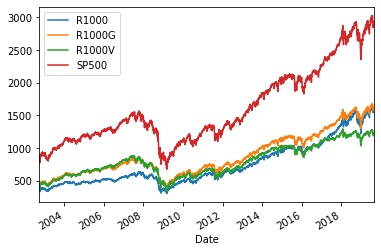

In [9]:
# Download US Indices from Yahoo API
# S&P 500, Russel 1000, R1000V, R1000G
US_Indices = ["^GSPC","^RUI",'^RLV','^RLG']
US_data = yf.download(US_Indices)
Indice_1 = US_data['Adj Close'].dropna()
Indice_1 = Indice_1.rename(columns={'^GSPC':'SP500','^RUI':'R1000G','^RLV':'R1000V','^RLG':'R1000'})
Indice_1 = Indice_1.sort_index(axis=1)
Indice_1
Indice_1.plot()

,R1000,R1000G,R1000V,SP500
Date,,,,
2002-10-01,0.038342,0.037246,0.036111,0.039243
2002-10-02,-0.019260,-0.024220,-0.029403,-0.023870
2002-10-03,-0.010669,-0.011619,-0.012625,-0.010881
2002-10-04,-0.023109,-0.023462,-0.023849,-0.022687
2002-10-07,-0.016391,-0.019636,-0.023102,-0.019296
2002-10-08,0.021835,0.015474,0.008664,0.016757
2002-10-09,-0.021293,-0.027604,-0.034445,-0.027666
2002-10-10,0.028642,0.034923,0.041727,0.034368
2002-10-11,0.036439,0.037717,0.039107,0.038315


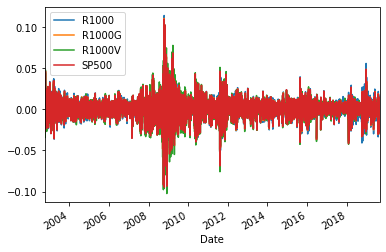

In [10]:
# Take log difference --> Return
TR_1 = np.log(Indice_1).diff().dropna()
TR_1
TR_1.plot()

,R1000,R1000G,R1000V,SP500
Date,,,,
2002-10-01,8.710151,7.831176,6.907849,8.291442
2002-11-01,5.192548,5.500032,5.822577,5.550058
2002-12-01,-7.291105,-5.998594,-4.650805,-6.222928
2003-01-01,-2.530097,-2.581405,-2.636353,-2.779749
2003-02-01,-0.593941,-1.760957,-2.971919,-1.714984
2003-03-01,1.749153,0.887685,-0.025528,0.832287
2003-04-01,7.076132,7.636873,8.234498,7.792735
2003-05-01,4.777050,5.372610,5.996177,4.964567
2003-06-01,1.251348,1.166838,1.079230,1.125863


,R1000,R1000G,R1000V,SP500
Date,,,,
2002-12-31,6.611595,7.332614,8.079621,7.618573
2003-03-31,-1.374886,-3.454677,-5.633799,-3.662446
2003-06-30,13.104530,14.176321,15.309905,13.883164
2003-09-30,3.592342,2.513713,1.406037,2.179262
2003-12-31,9.606756,11.089623,12.608335,11.012639
2004-03-31,0.542353,1.479184,2.413217,1.276976
2004-06-30,1.661797,0.971370,0.285172,1.290682
2004-09-30,-5.620782,-2.265713,0.920815,-2.328718
2004-12-31,8.511727,8.882425,9.223042,8.372823


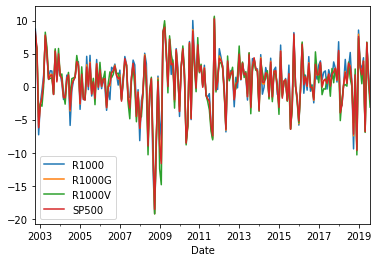

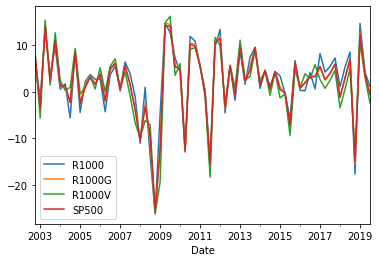

In [11]:
# Calculate Monthly Return
TR_1_M = TR_1.resample('MS').sum()*100
# Calculate Quarterly Return
TR_1_Q = TR_1.resample('Q').sum()*100
TR_1_M
TR_1_M.plot()
TR_1_Q
TR_1_Q.plot()

### 2. US Indicators

### 2.1 Leading Indicators

* Manufacturers' New Orders: Durable Goods (DGORDER)
* Consumer Opinion Surveys: Confidence Indicators: Composite Indicators: OECD Indicator for the United States (CSCICP03USM665S)
* New Private Housing Units Authorized by Building Permits (PERMIT)
* 10-Year Treasury Constant Maturity Minus 3-Month Treasury Constant Maturity (T10Y3M)
* Initial Claims (ICSA)
* Average Weekly Hours of All Employees: Manufacturing (AWHAEMAN)

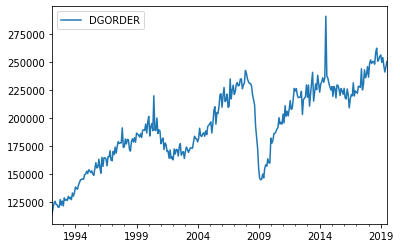

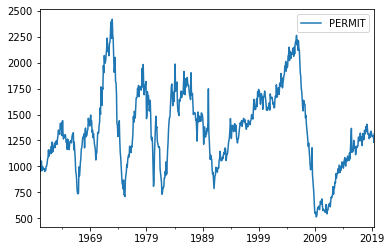

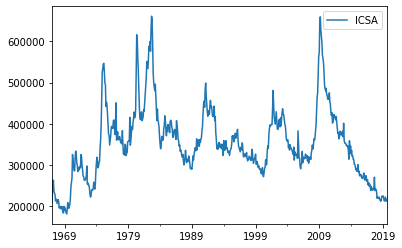

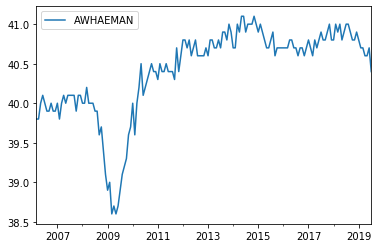

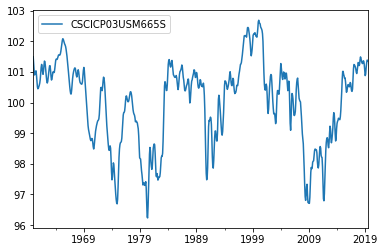

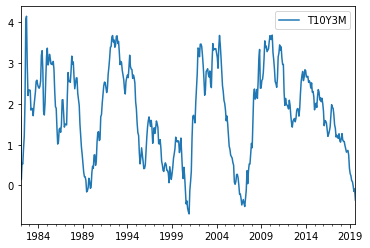

In [3]:
# Get Indicators Data through Fred API
fred = Fred(api_key='c61f0bb859e22e163419d6e5cf28655b')
leading_fred = ['DGORDER','PERMIT','ICSA','AWHAEMAN','CSCICP03USM665S','T10Y3M']
leading_df = {}
for i in range(0,len(leading_fred)):
    data = fred.get_series(leading_fred[i]).dropna()
    data_series = pd.DataFrame(data,columns=[leading_fred[i]])
    data_series = data_series.resample('MS').mean().dropna()
    data_series.plot()
    leading_df[leading_fred[i]] = data_series

In [12]:
# Seasonally Adjusted
for i in range(0,len(leading_fred)):
    leading_df[leading_fred[i]] = leading_df[leading_fred[i]].diff(periods=12).dropna()

# Merge all Indicators and TRs
def Merge(df,fred):
    merge = df[fred[0]]
    for i in range(0,len(fred)-1):
        merge = pd.concat([merge,df[fred[i+1]]],join='inner',axis=1)
    merge1 = pd.concat([TR_1_M,merge],join='inner',axis=1)
    merge1 = merge1.dropna().reset_index()
    
    return merge1
merge1 = Merge(leading_df,leading_fred)
merge1

,Date,R1000,R1000G,R1000V,SP500,DGORDER,PERMIT,ICSA,AWHAEMAN,CSCICP03USM665S,T10Y3M
0,2008-03-01,-0.723745,-0.843280,-0.972388,-0.597741,-376.0,-107.0,46350.0,0.000000e+00,-2.693950,3.353496
1,2008-04-01,5.051552,4.838550,4.606064,4.645094,-17967.0,66.0,22600.0,-4.000000e-01,-3.117468,3.257843
2,2008-05-01,3.463409,1.607319,-0.449713,1.061759,-10603.0,-86.0,91050.0,0.000000e+00,-3.647546,2.632078
3,2008-06-01,-7.581258,-8.848446,-10.320302,-8.988355,-8460.0,233.0,58350.0,-1.000000e-01,-3.705136,1.675779
4,2008-07-01,-1.983120,-1.309697,-0.583980,-0.990830,-38848.0,-38.0,90300.0,-3.000000e-01,-3.425237,2.277061
5,2008-08-01,0.919754,1.160272,1.420719,1.211680,-42851.0,-62.0,107250.0,-4.000000e-01,-2.627501,1.203292
6,2008-09-01,-12.663713,-10.319972,-7.893354,-9.518079,-5665.0,-70.0,153400.0,-7.000000e-01,-1.743996,1.273787
7,2008-10-01,-19.213874,-19.240826,-19.266675,-18.563649,-48934.0,-78.0,134250.0,-1.000000e-01,-1.101385,1.761039
8,2008-11-01,-8.524662,-8.180672,-7.839137,-7.779835,-55180.0,-287.0,174050.0,-9.000000e-01,-0.566517,1.266683
9,2008-12-01,1.585869,1.308314,1.029820,0.779114,-82770.0,-106.0,191600.0,-1.200000e+00,-0.131192,-0.088227


In [13]:
# ADF Test: test whether the series is stationary or not, take the difference if not stationary
# drop the indicator if not stationary after taking difference three times
def ADF_Test(df_diff):
    index_remove2 = []
    for i in range(4,df_diff.shape[1]):
        k = 0
        for j in range(0,3):
            pValue = ts.adfuller(df_diff.iloc[:,i].values)[1]
            # If p-value>0.05, do not reject null hypothesis that the series is non-stationary
            if pValue>0.05:
                k = k + 1
                df_diff.iloc[:,i] = df_diff.iloc[:,i].diff()
                df_diff = df_diff.dropna()
        df_diff.iloc[:,i].plot()
        if k == 3:
            index_remove2.append(i) 
            
        print(k)
    df_diff = df_diff.drop(df_diff.columns[index_remove2],axis=1) # drop columns whose p-value>0.05
    df_diff = df_diff.reset_index(drop=True)
    
    return index_remove2,df_diff

0
0
1
0
0
0
1


C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


[]

,Date,R1000,R1000G,R1000V,SP500,DGORDER,PERMIT,ICSA,AWHAEMAN,CSCICP03USM665S,T10Y3M
0,2008-05-01,3.463409,1.607319,-0.449713,1.061759,-10603.0,-152.0,91050.0,0.000000e+00,-3.647546,-0.625766
1,2008-06-01,-7.581258,-8.848446,-10.320302,-8.988355,-8460.0,319.0,58350.0,-1.000000e-01,-3.705136,-0.956299
2,2008-07-01,-1.983120,-1.309697,-0.583980,-0.990830,-38848.0,-271.0,90300.0,-3.000000e-01,-3.425237,0.601281
3,2008-08-01,0.919754,1.160272,1.420719,1.211680,-42851.0,-24.0,107250.0,-4.000000e-01,-2.627501,-1.073769
4,2008-09-01,-12.663713,-10.319972,-7.893354,-9.518079,-5665.0,-8.0,153400.0,-7.000000e-01,-1.743996,0.070495
5,2008-10-01,-19.213874,-19.240826,-19.266675,-18.563649,-48934.0,-8.0,134250.0,-1.000000e-01,-1.101385,0.487252
6,2008-11-01,-8.524662,-8.180672,-7.839137,-7.779835,-55180.0,-209.0,174050.0,-9.000000e-01,-0.566517,-0.494356
7,2008-12-01,1.585869,1.308314,1.029820,0.779114,-82770.0,181.0,191600.0,-1.200000e+00,-0.131192,-1.354910
8,2009-01-01,-4.990750,-8.656976,-12.439555,-8.954989,-103291.0,89.0,211750.0,-1.100000e+00,0.223984,0.281942
9,2009-02-01,-8.058801,-11.278515,-14.847023,-11.645654,-99926.0,145.0,273250.0,-1.200000e+00,0.742148,-1.186504


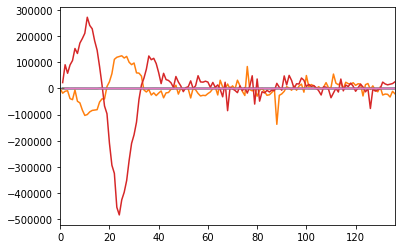

In [14]:
merge1_diff = merge1.copy()
[index_remove2,merge1_differenced] = ADF_Test(merge1_diff)
index_remove2
merge1_differenced

In [15]:
# Testing Causation using Granger’s Causality Test
# Granger’s causality tests the null hypothesis that the past values of time series (X) do not cause the other series (Y). 
# So, if the p-value obtained from the test is lesser than the significance level of 0.05, then, you can safely reject the null hypothesis.
maxlag = 12
test = 'ssr_chi2test'
def grangers_causation_matrix(data, variables, test='ssr_chi2test', verbose=False):    
    df = pd.DataFrame(np.zeros((len(variables), len(variables))), columns=variables, index=variables)
    for c in df.columns:
        for r in df.index:
            test_result = grangercausalitytests(data[[r, c]], maxlag=maxlag, verbose=False)
            p_values = [round(test_result[i+1][0][test][1],4) for i in range(maxlag)]
            if verbose: print(f'Y = {r}, X = {c}, P Values = {p_values}')
            min_p_value = np.min(p_values)
            df.loc[r, c] = min_p_value
    df.columns = [var + '_x' for var in variables]
    df.index = [var + '_y' for var in variables]
    return df

#### 2.1.1 Forecast the returns for SP500

In [16]:
# Grangers Causation Test, drop the indicator that do not pass the test
def causation_test(df_differenced,n,m):
    df_select = df_differenced.copy()
    df_select = pd.concat([df_select.iloc[:,n],df_select.iloc[:,m:]], axis=1)
    print(df_select)
    causation_matrix = grangers_causation_matrix(df_select, variables = df_select.columns)
    index_remove=[]
    for i in causation_matrix.iloc[0,1:]:
        if i>0.05:
            index_remove.append(causation_matrix.columns.get_loc((causation_matrix == i).idxmax(axis=1)[0])+m-1) 
            # get column index of indicators whose p-value>0.05
    df_differenced = df_differenced.drop(df_differenced.columns[index_remove],axis=1) # drop columns whose p-value>0.05
    return causation_matrix,index_remove,df_differenced

[causation_matrix,index_remove,merge1_tested] = causation_test(merge1_differenced,4,5)
causation_matrix
index_remove
merge1_tested

         SP500   DGORDER  PERMIT      ICSA      AWHAEMAN  CSCICP03USM665S  \
0     1.061759  -10603.0  -152.0   91050.0  0.000000e+00        -3.647546   
1    -8.988355   -8460.0   319.0   58350.0 -1.000000e-01        -3.705136   
2    -0.990830  -38848.0  -271.0   90300.0 -3.000000e-01        -3.425237   
3     1.211680  -42851.0   -24.0  107250.0 -4.000000e-01        -2.627501   
4    -9.518079   -5665.0    -8.0  153400.0 -7.000000e-01        -1.743996   
5   -18.563649  -48934.0    -8.0  134250.0 -1.000000e-01        -1.101385   
6    -7.779835  -55180.0  -209.0  174050.0 -9.000000e-01        -0.566517   
7     0.779114  -82770.0   181.0  191600.0 -1.200000e+00        -0.131192   
8    -8.954989 -103291.0    89.0  211750.0 -1.100000e+00         0.223984   
9   -11.645654  -99926.0   145.0  273250.0 -1.200000e+00         0.742148   
10    8.195274  -89712.0    47.0  241850.0 -1.800000e+00         1.592856   
11    8.977221  -84084.0  -200.0  229000.0 -1.200000e+00         2.897668   

,SP500_x,DGORDER_x,PERMIT_x,ICSA_x,AWHAEMAN_x,CSCICP03USM665S_x,T10Y3M_x
SP500_y,1.0000,0.0880,0.2595,0.4460,0.2126,0.0427,0.0691
DGORDER_y,0.0233,1.0000,0.1116,0.0000,0.0000,0.0000,0.0605
PERMIT_y,0.0001,0.0000,1.0000,0.0000,0.0000,0.0133,0.0000
ICSA_y,0.0197,0.0011,0.0004,1.0000,0.0017,0.0000,0.0031
AWHAEMAN_y,0.0122,0.0000,0.0006,0.0000,1.0000,0.0000,0.0000
CSCICP03USM665S_y,0.0221,0.0005,0.0005,0.0000,0.0003,1.0000,0.0000
T10Y3M_y,0.0047,0.0000,0.0000,0.0304,0.0129,0.0238,1.0000


[5, 6, 7, 8, 10]

,Date,R1000,R1000G,R1000V,SP500,CSCICP03USM665S
0,2008-05-01,3.463409,1.607319,-0.449713,1.061759,-3.647546
1,2008-06-01,-7.581258,-8.848446,-10.320302,-8.988355,-3.705136
2,2008-07-01,-1.983120,-1.309697,-0.583980,-0.990830,-3.425237
3,2008-08-01,0.919754,1.160272,1.420719,1.211680,-2.627501
4,2008-09-01,-12.663713,-10.319972,-7.893354,-9.518079,-1.743996
5,2008-10-01,-19.213874,-19.240826,-19.266675,-18.563649,-1.101385
6,2008-11-01,-8.524662,-8.180672,-7.839137,-7.779835,-0.566517
7,2008-12-01,1.585869,1.308314,1.029820,0.779114,-0.131192
8,2009-01-01,-4.990750,-8.656976,-12.439555,-8.954989,0.223984
9,2009-02-01,-8.058801,-11.278515,-14.847023,-11.645654,0.742148


In [17]:
# Build VAR Model
def VAR_Model(df_differenced,n,m,test_size):
    # Split the data into trainset and testset
    df = df_differenced.copy()
    date = df.Date
    df = pd.concat([df.iloc[:,n],df.iloc[:,m:]], axis=1)
    df_train, df_test = train_test_split(df, test_size=test_size,shuffle=False)
    
    # Build the Vector Autoregressive Model
    model = VAR(df_train)
    aic = []
    bic = []
    for i in range(0,7):
        try:
            result = model.fit(i)
            aic.append(result.aic)
            bic.append(result.bic)
        except:
            break
    lag1 = aic.index(min(aic))
    lag2 = bic.index(min(bic))

    if lag1>6:
        lag = lag2
    else:
        lag = lag1 

    model_fitted = model.fit(lag)
    print(model_fitted.summary())

    # Check for Serial Correlation of Residuals (Errors) using Durbin Watson Statistic
    # The closer to 0, there is a positive serial correlation, and the closer it is to 4 implies negative serial correlation.
    out = durbin_watson(model_fitted.resid)

    for col, val in zip(df.columns, out):
        def adjust(val, length= 6): return str(val).ljust(length)
        print(adjust(col), ':', round(val, 2))
    
    return model_fitted,df,df_train,df_test,date

In [18]:
# Forecast and Plot
def forecast_plot(model_fitted,df,df_train,df_test,date,m):
    lag_order = model_fitted.k_ar
    nobs = df_test.shape[0]
    fc = model_fitted.forecast(y=df_train.values[-lag_order:],steps=nobs)
    df_forecast = pd.DataFrame(fc, index=df_test.index, columns=df.columns + '_forecast')
    col = df_test.columns[0]
    
    fig, ax = plt.subplots(dpi=150, figsize=(10,10))
    plt.plot(date[:-nobs], df_train[col])
    plt.plot(date[-nobs:], df_forecast[col+'_forecast'])
    plt.plot(date[-nobs:], df_test[col])
    plt.gca().legend((col+'_train',col+'_forecast',col+'_actual'))
    myFmt = mdates.DateFormatter('%Y-%m-%d')
    ax.xaxis.set_major_formatter(myFmt)
    plt.xticks(rotation=30)
    plt.xlabel('Date')
    plt.ylabel('Returns(%)')
    plt.title(col + ": Forecast vs Actuals Expected Returns, Train Set = "+ "%.2f%%"% m)
    plt.show()
    return df_forecast,lag_order


  Summary of Regression Results   
Model:                         VAR
Method:                        OLS
Date:           Fri, 30, Aug, 2019
Time:                     10:17:52
--------------------------------------------------------------------
No. of Equations:         2.00000    BIC:                   0.703730
Nobs:                     122.000    HQIC:                  0.348869
Log likelihood:          -326.696    FPE:                    1.11380
AIC:                     0.106152    Det(Omega_mle):        0.909617
--------------------------------------------------------------------
Results for equation SP500
                        coefficient       std. error           t-stat            prob
-------------------------------------------------------------------------------------
const                      0.676252         0.379624            1.781           0.075
L1.SP500                   0.038769         0.090404            0.429           0.668
L1.CSCICP03USM665S         1.376226     

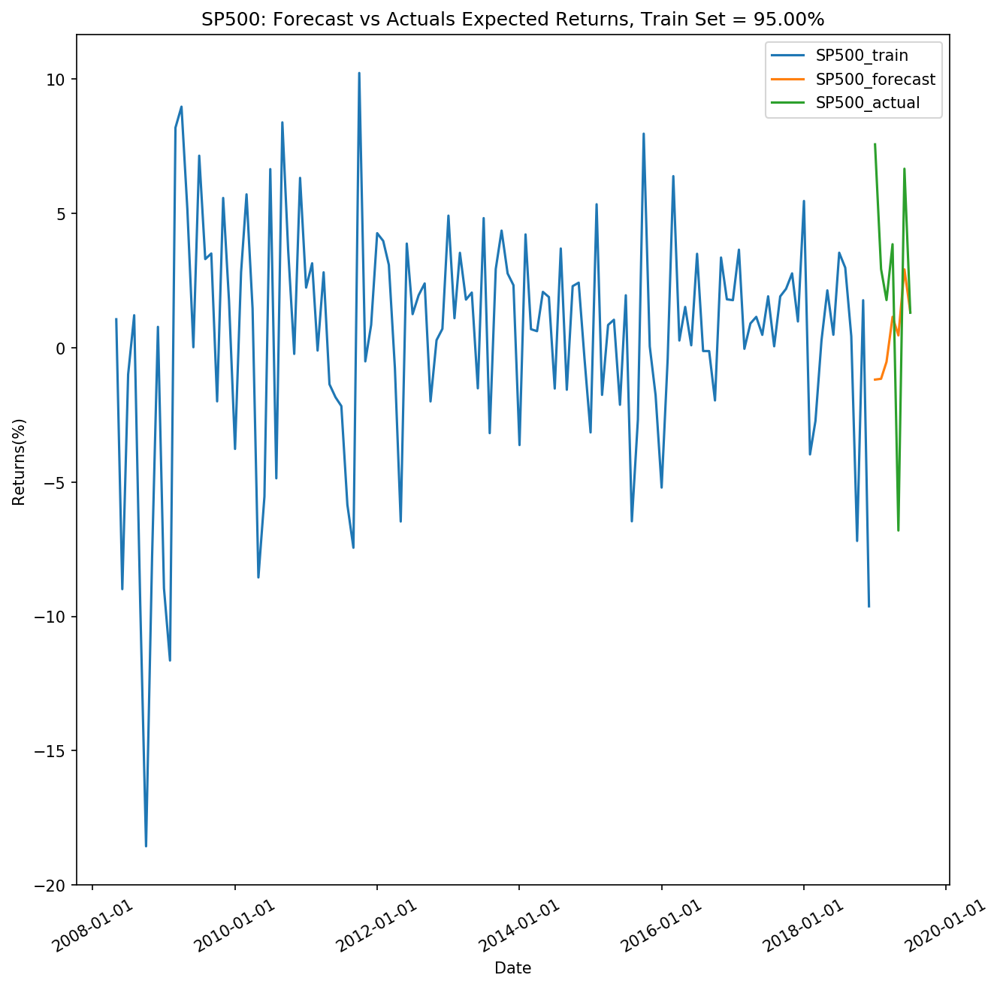

Forecast Accuracy of: SP500
mape   :  1.0296
me     :  -2.3889
mae    :  4.8103
mpe    :  -1.0296
rmse   :  5.3672
corr   :  0.0743


In [19]:
# Test the Accuracy
def forecast_accuracy(forecast, actual):
    mape = np.mean(np.abs(forecast - actual)/np.abs(actual))  # MAPE
    me = np.mean(forecast - actual)             # ME
    mae = np.mean(np.abs(forecast - actual))    # MAE
    mpe = np.mean((forecast - actual)/actual)   # MPE
    rmse = np.mean((forecast - actual)**2)**.5  # RMSE
    corr = np.corrcoef(forecast, actual)[0,1]   # corr
    
    return({'mape':mape, 'me':me, 'mae': mae, 
            'mpe': mpe, 'rmse':rmse, 'corr':corr})

def adjust(val, length= 6): return str(val).ljust(length)

# Train Set = 95%
[model1_fitted,df1,df1_train,df1_test,date1] = VAR_Model(merge1_tested,4,5,0.05)
[df1_forecast,lag_order1] = forecast_plot(model1_fitted,df1,df1_train,df1_test,date1,95)

print('Forecast Accuracy of: SP500')
accuracy_prod = forecast_accuracy(df1_forecast.iloc[:lag_order1,0].values, df1_test.iloc[:lag_order1,0])

for k, v in accuracy_prod.items():
    print(adjust(k), ': ', round(v,4))    

  Summary of Regression Results   
Model:                         VAR
Method:                        OLS
Date:           Fri, 30, Aug, 2019
Time:                     10:17:54
--------------------------------------------------------------------
No. of Equations:         2.00000    BIC:                   0.657394
Nobs:                     115.000    HQIC:                  0.288697
Log likelihood:          -302.472    FPE:                    1.03950
AIC:                    0.0368011    Det(Omega_mle):        0.839076
--------------------------------------------------------------------
Results for equation SP500
                        coefficient       std. error           t-stat            prob
-------------------------------------------------------------------------------------
const                      0.761752         0.376669            2.022           0.043
L1.SP500                   0.055708         0.089212            0.624           0.532
L1.CSCICP03USM665S         2.430672     

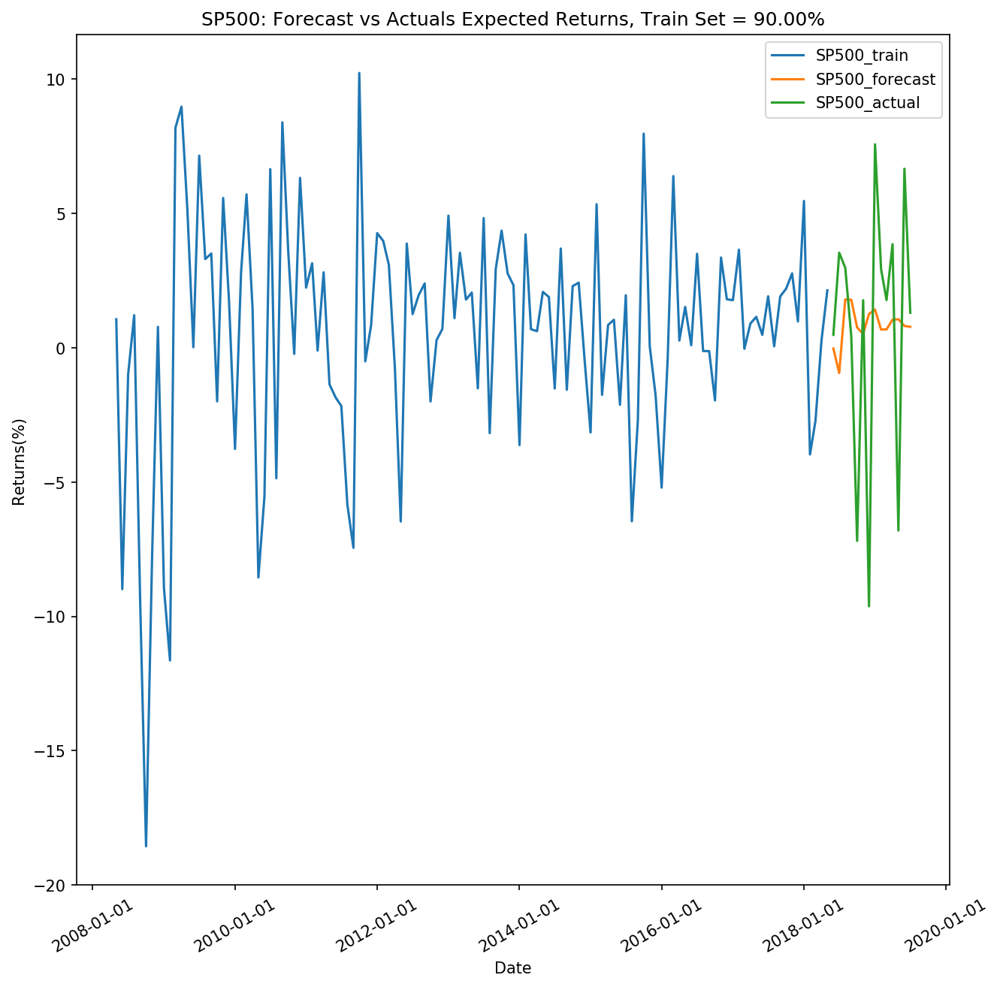

Forecast Accuracy of: SP500
mape   :  1.2829
me     :  0.3136
mae    :  2.7884
mpe    :  -0.2271
rmse   :  3.8367
corr   :  -0.147


In [20]:
# Train Set = 90%
[model1_fitted,df1,df1_train,df1_test,date1] = VAR_Model(merge1_tested,4,5,0.1)
[df1_forecast,lag_order1] = forecast_plot(model1_fitted,df1,df1_train,df1_test,date1,90)

print('Forecast Accuracy of: SP500')
accuracy_prod = forecast_accuracy(df1_forecast.iloc[:lag_order1,0].values, df1_test.iloc[:lag_order1,0])

for k, v in accuracy_prod.items():
    print(adjust(k), ': ', round(v,4)) 

  Summary of Regression Results   
Model:                         VAR
Method:                        OLS
Date:           Wed, 28, Aug, 2019
Time:                     09:23:47
--------------------------------------------------------------------
No. of Equations:         4.00000    BIC:                    39.6261
Nobs:                     112.000    HQIC:                   38.8760
Log likelihood:          -2732.06    FPE:                4.60322e+16
AIC:                      38.3639    Det(Omega_mle):     2.96684e+16
--------------------------------------------------------------------
Results for equation SP500
                        coefficient       std. error           t-stat            prob
-------------------------------------------------------------------------------------
const                      0.328871         0.413138            0.796           0.426
L1.SP500                   0.071107         0.103169            0.689           0.491
L1.DGORDER                 0.000061     

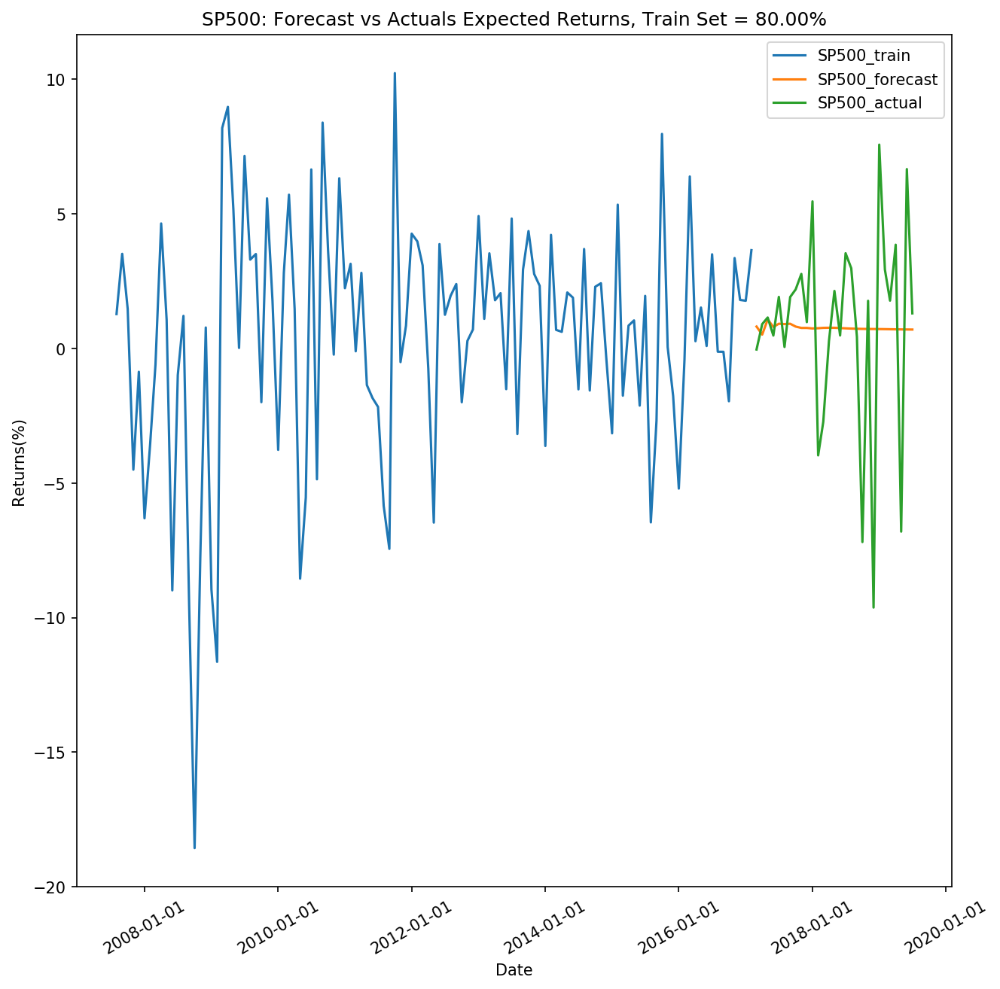

Forecast Accuracy of: SP500
mape   :  7.4731
me     :  0.13
mae    :  0.4391
mpe    :  -7.4731
rmse   :  0.5434
corr   :  0.1585


In [15]:
# Train Set = 80%
[model1_fitted,df1,df1_train,df1_test,date1] = VAR_Model(merge1_tested,4,5,0.2)
[df1_forecast,lag_order1] = forecast_plot(model1_fitted,df1,df1_train,df1_test,date1,80)

print('Forecast Accuracy of: SP500')
accuracy_prod = forecast_accuracy(df1_forecast.iloc[:lag_order1,0].values, df1_test.iloc[:lag_order1,0])

for k, v in accuracy_prod.items():
    print(adjust(k), ': ', round(v,4)) 

  Summary of Regression Results   
Model:                         VAR
Method:                        OLS
Date:           Wed, 28, Aug, 2019
Time:                     09:23:48
--------------------------------------------------------------------
No. of Equations:         4.00000    BIC:                    40.1776
Nobs:                     97.0000    HQIC:                   39.3554
Log likelihood:          -2380.22    FPE:                7.11676e+16
AIC:                      38.7973    Det(Omega_mle):     4.30327e+16
--------------------------------------------------------------------
Results for equation SP500
                        coefficient       std. error           t-stat            prob
-------------------------------------------------------------------------------------
const                      0.250082         0.463797            0.539           0.590
L1.SP500                   0.074430         0.110758            0.672           0.502
L1.DGORDER                 0.000070     

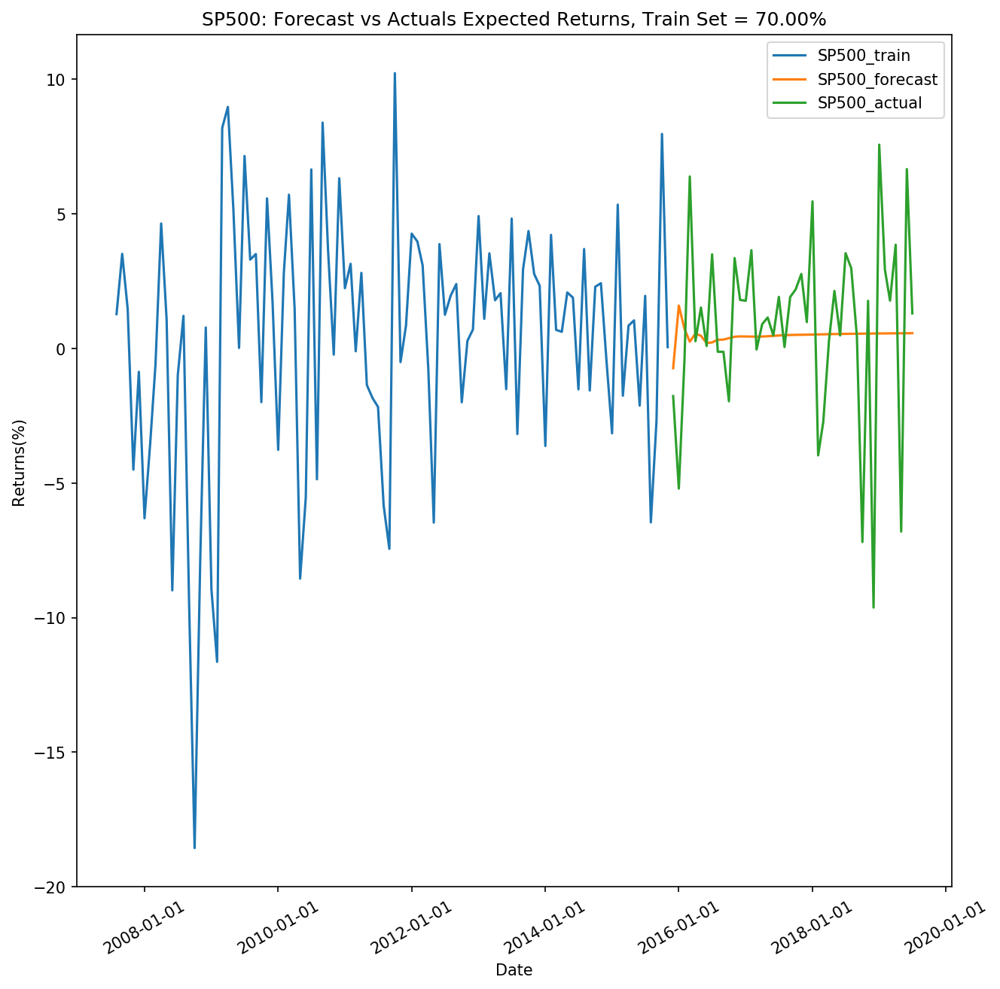

Forecast Accuracy of: SP500
mape   :  1.5492
me     :  2.9925
mae    :  2.9925
mpe    :  -1.5492
rmse   :  4.0261
corr   :  -0.5843


In [16]:
# Train Set = 70%
[model1_fitted,df1,df1_train,df1_test,date1] = VAR_Model(merge1_tested,4,5,0.3)
[df1_forecast,lag_order1] = forecast_plot(model1_fitted,df1,df1_train,df1_test,date1,70)

print('Forecast Accuracy of: SP500')
accuracy_prod = forecast_accuracy(df1_forecast.iloc[:lag_order1,0].values, df1_test.iloc[:lag_order1,0])

for k, v in accuracy_prod.items():
    print(adjust(k), ': ', round(v,4)) 

  Summary of Regression Results   
Model:                         VAR
Method:                        OLS
Date:           Wed, 28, Aug, 2019
Time:                     11:48:49
--------------------------------------------------------------------
No. of Equations:         4.00000    BIC:                    40.1213
Nobs:                     69.0000    HQIC:                   39.1056
Log likelihood:          -1665.73    FPE:                5.02547e+16
AIC:                      38.4377    Det(Omega_mle):     2.51952e+16
--------------------------------------------------------------------
Results for equation SP500
                        coefficient       std. error           t-stat            prob
-------------------------------------------------------------------------------------
const                      0.393227         0.622372            0.632           0.528
L1.SP500                   0.115397         0.135781            0.850           0.395
L1.DGORDER                 0.000039     

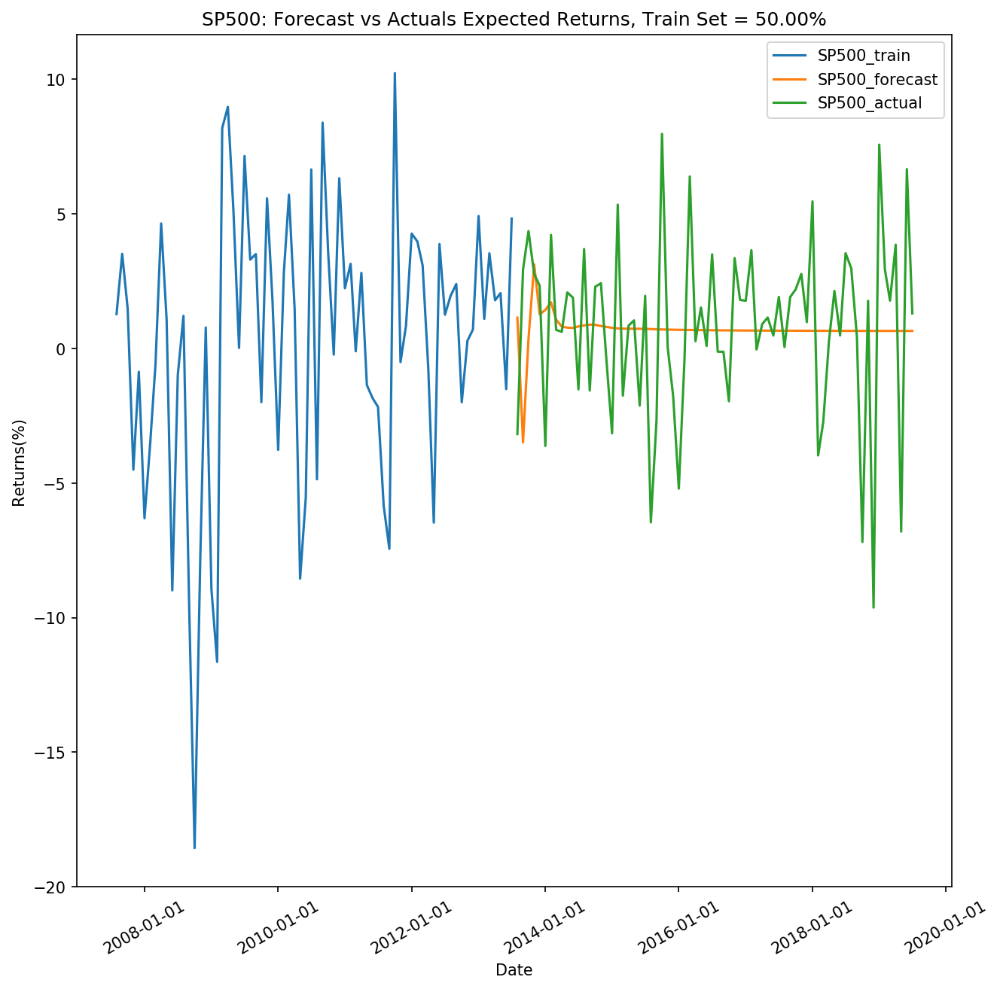

Forecast Accuracy of: SP500
mape   :  1.4896
me     :  -2.0342
mae    :  4.9167
mpe    :  -1.4896
rmse   :  5.0331
corr   :  -0.4809


In [67]:
# Train Set = 50%
[model1_fitted,df1,df1_train,df1_test,date1] = VAR_Model(merge1_tested,4,5,0.5)
[df1_forecast,lag_order1] = forecast_plot(model1_fitted,df1,df1_train,df1_test,date1,50)

print('Forecast Accuracy of: SP500')
accuracy_prod = forecast_accuracy(df1_forecast.iloc[:lag_order1,0].values, df1_test.iloc[:lag_order1,0])

for k, v in accuracy_prod.items():
    print(adjust(k), ': ', round(v,4)) 

#### 2.1.2 Forecast the returns for R1000

         R1000  DGORDER  PERMIT     ICSA      AWHAEMAN  CSCICP03USM665S  \
0     1.451094   -722.0     1.0  11300.0  1.000000e-01         0.089706   
1     4.013039 -33032.0     7.0  -8550.0  0.000000e+00        -0.469253   
2     3.287222  21007.0    16.0  15550.0 -3.000000e-01        -1.169357   
3    -3.887221  -5756.0    67.0  -3000.0  3.000000e-01        -1.675790   
4    -0.469530   6528.0  -178.0  14450.0  0.000000e+00        -1.953669   
5    -8.177504   5531.0   -43.0  -2700.0 -2.000000e-01        -2.143401   
6    -2.147421  -7137.0   -52.0   2500.0  2.000000e-01        -2.305934   
7    -0.723745  -9163.0   -45.0  30000.0  0.000000e+00        -2.499122   
8     5.051552  -3303.0   167.0 -14750.0 -3.000000e-01        -2.846579   
9     3.463409   3094.0   -36.0  23300.0  1.000000e-01        -3.159378   
10   -7.581258  -2748.0   271.0   5500.0 -1.000000e-01        -3.236472   
11   -1.983120 -13147.0  -213.0  16700.0 -1.000000e-01        -3.014665   
12    0.919754  -4725.0  

,R1000_x,DGORDER_x,PERMIT_x,ICSA_x,AWHAEMAN_x,CSCICP03USM665S_x,T10Y3M_x
R1000_y,1.0000,0.0759,0.1270,0.0730,0.4217,0.0073,0.1622
DGORDER_y,0.0016,1.0000,0.0895,0.0000,0.0000,0.0037,0.5878
PERMIT_y,0.0036,0.0000,1.0000,0.0000,0.0017,0.0049,0.0001
ICSA_y,0.0110,0.0535,0.0216,1.0000,0.1471,0.0001,0.0050
AWHAEMAN_y,0.0001,0.0000,0.0001,0.0000,1.0000,0.0100,0.0003
CSCICP03USM665S_y,0.1313,0.1197,0.0075,0.2277,0.0574,1.0000,0.0000
T10Y3M_y,0.0029,0.0001,0.0000,0.1609,0.0978,0.0445,1.0000


[5, 6, 7, 8, 10]

,Date,R1000,R1000G,R1000V,SP500,CSCICP03USM665S
0,2007-08-01,1.451094,1.343026,0.824544,1.278156,0.089706
1,2007-09-01,4.013039,3.400576,3.169563,3.516828,-0.469253
2,2007-10-01,3.287222,1.625314,-0.139933,1.471356,-1.169357
3,2007-11-01,-3.887221,-4.575993,-5.321445,-4.504279,-1.675790
4,2007-12-01,-0.469530,-0.824280,-1.214891,-0.866593,-1.953669
5,2008-01-01,-8.177504,-6.302100,-4.271911,-6.311391,-2.143401
6,2008-02-01,-2.147421,-3.323734,-4.587407,-3.537971,-2.305934
7,2008-03-01,-0.723745,-0.843280,-0.972388,-0.597741,-2.499122
8,2008-04-01,5.051552,4.838550,4.606064,4.645094,-2.846579
9,2008-05-01,3.463409,1.607319,-0.449713,1.061759,-3.159378


  Summary of Regression Results   
Model:                         VAR
Method:                        OLS
Date:           Wed, 28, Aug, 2019
Time:                     11:58:54
--------------------------------------------------------------------
No. of Equations:         2.00000    BIC:                  -0.323506
Nobs:                     130.000    HQIC:                 -0.663978
Log likelihood:          -284.618    FPE:                   0.408333
AIC:                    -0.897013    Det(Omega_mle):        0.337466
--------------------------------------------------------------------
Results for equation R1000
                        coefficient       std. error           t-stat            prob
-------------------------------------------------------------------------------------
const                      0.746340         0.388100            1.923           0.054
L1.R1000                   0.067839         0.088685            0.765           0.444
L1.CSCICP03USM665S         4.650893     

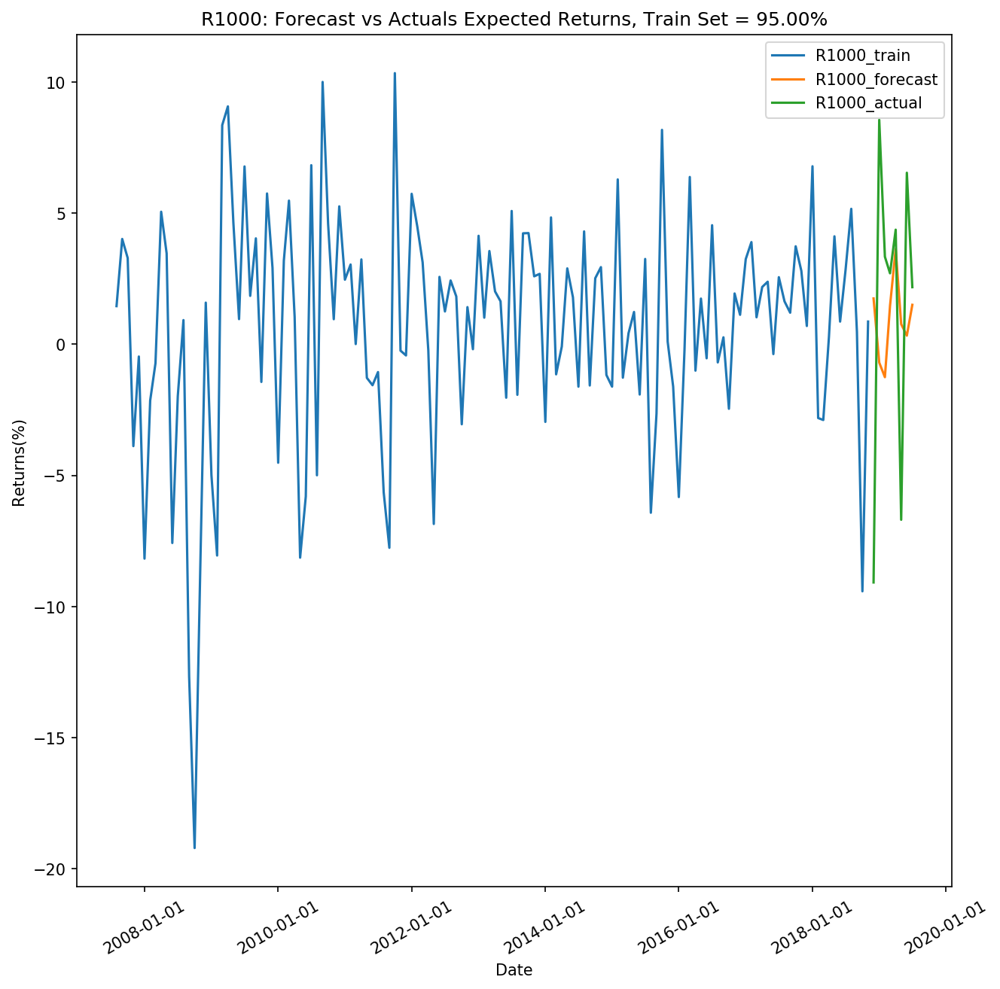

Forecast Accuracy of: R1000
mape   :  0.8988
me     :  0.4108
mae    :  5.6864
mpe    :  -0.8988
rmse   :  6.8536
corr   :  -0.2356


In [68]:
[causation_matrix,index_remove,merge1_tested_R1000] = causation_test(merge1_differenced,1,5)
causation_matrix
index_remove
merge1_tested_R1000

# Train Set = 95%
[model1_fitted_R1000,df1_R1000,df1_train_R1000,df1_test_R1000,date1] = VAR_Model(merge1_tested_R1000,1,5,0.05)
[df1_forecast_R1000,lag_order1_R1000] = forecast_plot(model1_fitted_R1000,df1_R1000,df1_train_R1000,df1_test_R1000,date1,95)

print('Forecast Accuracy of: R1000')
accuracy_prod = forecast_accuracy(df1_forecast_R1000.iloc[:lag_order1_R1000,0].values, df1_test_R1000.iloc[:lag_order1_R1000,0])

for k, v in accuracy_prod.items():
    print(adjust(k), ': ', round(v,4)) 

  Summary of Regression Results   
Model:                         VAR
Method:                        OLS
Date:           Wed, 28, Aug, 2019
Time:                     11:58:55
--------------------------------------------------------------------
No. of Equations:         2.00000    BIC:                  -0.278126
Nobs:                     123.000    HQIC:                 -0.631109
Log likelihood:          -269.396    FPE:                   0.418538
AIC:                    -0.872572    Det(Omega_mle):        0.342348
--------------------------------------------------------------------
Results for equation R1000
                        coefficient       std. error           t-stat            prob
-------------------------------------------------------------------------------------
const                      0.721196         0.394330            1.829           0.067
L1.R1000                   0.071572         0.090504            0.791           0.429
L1.CSCICP03USM665S         4.948390     

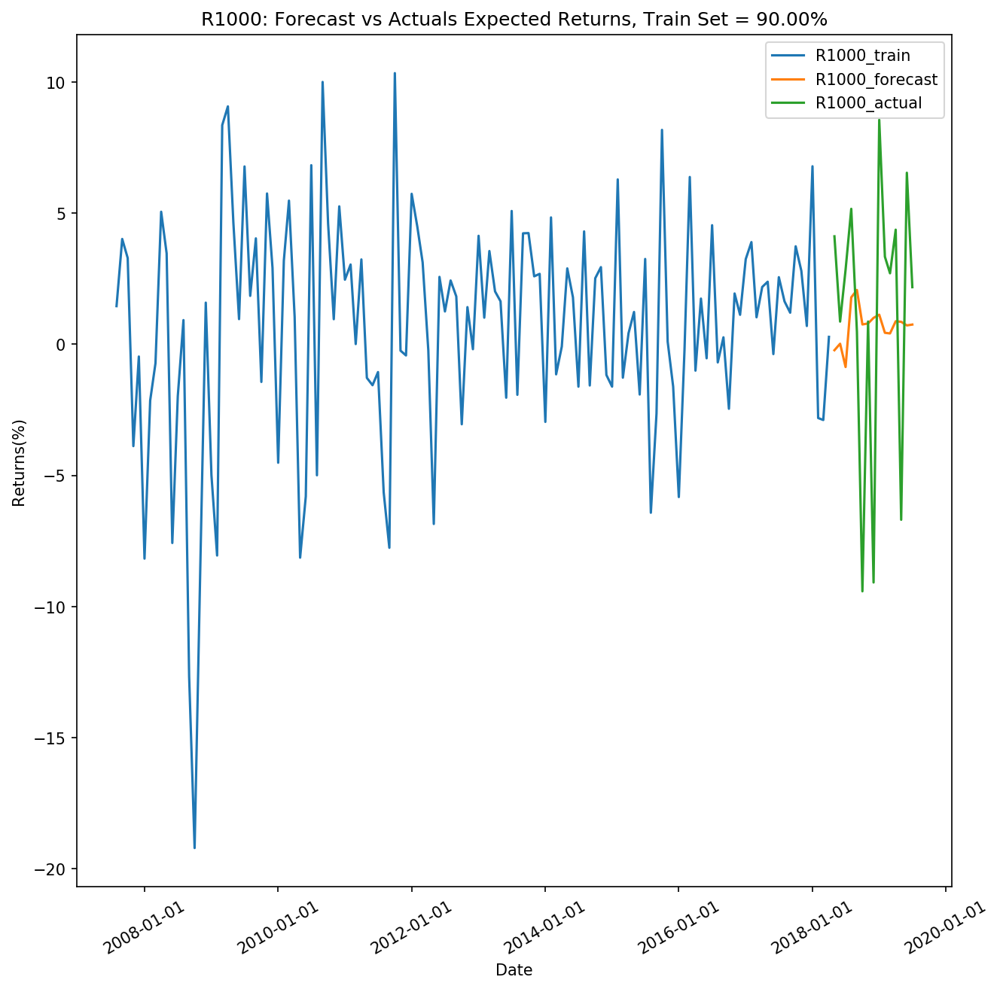

Forecast Accuracy of: R1000
mape   :  1.4068
me     :  -0.0844
mae    :  4.0078
mpe    :  -0.2849
rmse   :  5.0142
corr   :  -0.087


In [69]:
# Train Set = 90%
[model1_fitted_R1000,df1_R1000,df1_train_R1000,df1_test_R1000,date1] = VAR_Model(merge1_tested_R1000,1,5,0.1)
[df1_forecast_R1000,lag_order1_R1000] = forecast_plot(model1_fitted_R1000,df1_R1000,df1_train_R1000,df1_test_R1000,date1,90)

print('Forecast Accuracy of: R1000')
accuracy_prod = forecast_accuracy(df1_forecast_R1000.iloc[:lag_order1_R1000,0].values, df1_test_R1000.iloc[:lag_order1_R1000,0])

for k, v in accuracy_prod.items():
    print(adjust(k), ': ', round(v,4)) 

  Summary of Regression Results   
Model:                         VAR
Method:                        OLS
Date:           Wed, 28, Aug, 2019
Time:                     11:58:56
--------------------------------------------------------------------
No. of Equations:         2.00000    BIC:                 -0.0850364
Nobs:                     109.000    HQIC:                 -0.466666
Log likelihood:          -243.707    FPE:                   0.484456
AIC:                    -0.727009    Det(Omega_mle):        0.386712
--------------------------------------------------------------------
Results for equation R1000
                        coefficient       std. error           t-stat            prob
-------------------------------------------------------------------------------------
const                      0.678344         0.428276            1.584           0.113
L1.R1000                   0.073139         0.096390            0.759           0.448
L1.CSCICP03USM665S         4.866455     

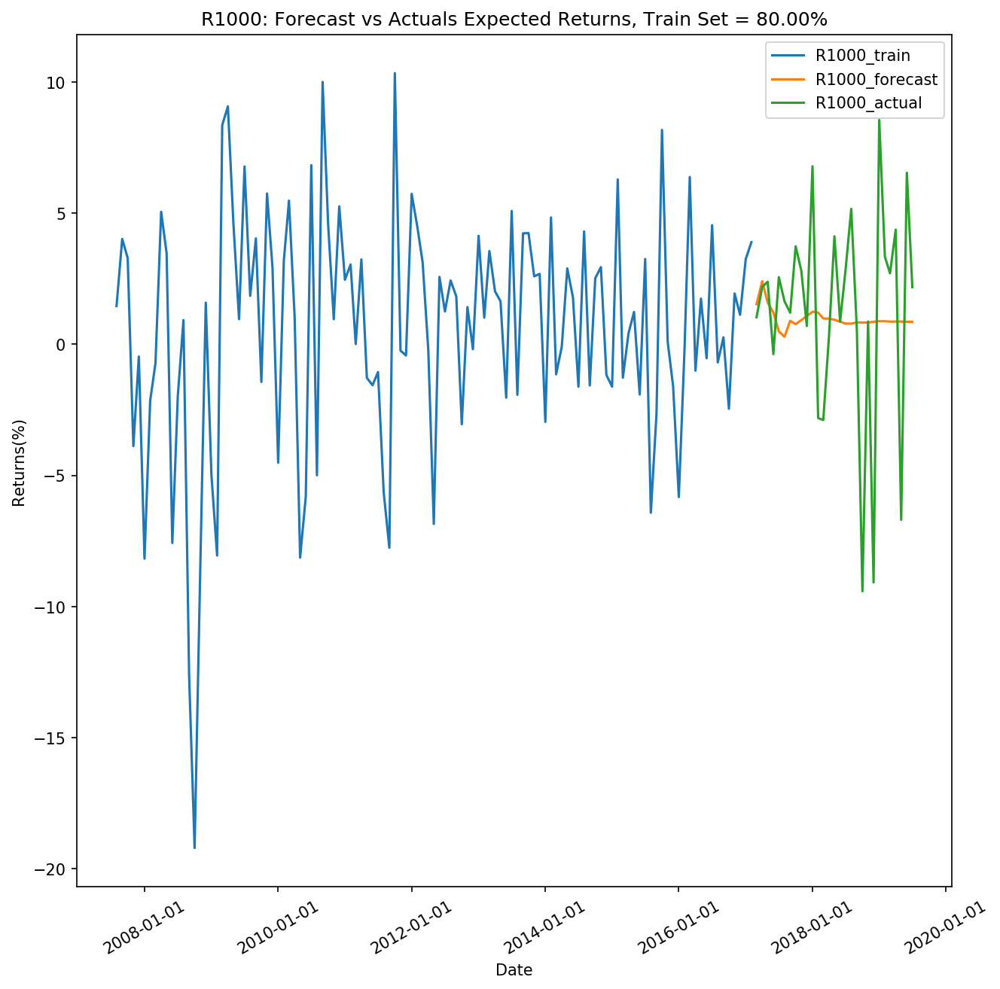

Forecast Accuracy of: R1000
mape   :  1.1272
me     :  -0.3182
mae    :  1.0865
mpe    :  -0.9322
rmse   :  1.2618
corr   :  0.0209


In [70]:
# Train Set = 80%
[model1_fitted_R1000,df1_R1000,df1_train_R1000,df1_test_R1000,date1] = VAR_Model(merge1_tested_R1000,1,5,0.2)
[df1_forecast_R1000,lag_order1_R1000] = forecast_plot(model1_fitted_R1000,df1_R1000,df1_train_R1000,df1_test_R1000,date1,80)

print('Forecast Accuracy of: R1000')
accuracy_prod = forecast_accuracy(df1_forecast_R1000.iloc[:lag_order1_R1000,0].values, df1_test_R1000.iloc[:lag_order1_R1000,0])

for k, v in accuracy_prod.items():
    print(adjust(k), ': ', round(v,4)) 

  Summary of Regression Results   
Model:                         VAR
Method:                        OLS
Date:           Wed, 28, Aug, 2019
Time:                     11:58:59
--------------------------------------------------------------------
No. of Equations:         2.00000    BIC:                   0.123415
Nobs:                     94.0000    HQIC:                 -0.295901
Log likelihood:          -213.498    FPE:                   0.561872
AIC:                    -0.580049    Det(Omega_mle):        0.433636
--------------------------------------------------------------------
Results for equation R1000
                        coefficient       std. error           t-stat            prob
-------------------------------------------------------------------------------------
const                      0.684248         0.479975            1.426           0.154
L1.R1000                   0.072467         0.104264            0.695           0.487
L1.CSCICP03USM665S         5.412435     

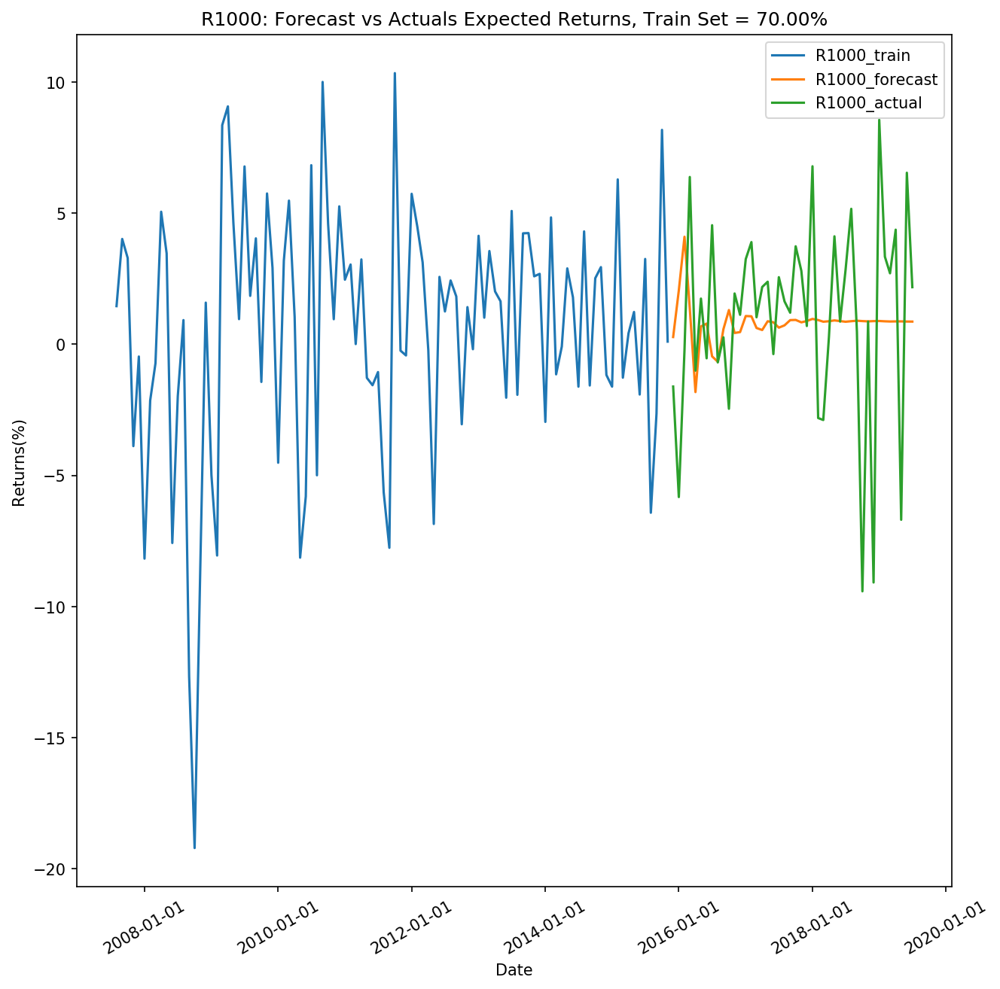

Forecast Accuracy of: R1000
mape   :  3.8798
me     :  1.2002
mae    :  3.4996
mpe    :  -3.6098
rmse   :  4.309
corr   :  -0.0263


In [71]:
# Train Set = 70%
[model1_fitted_R1000,df1_R1000,df1_train_R1000,df1_test_R1000,date1] = VAR_Model(merge1_tested_R1000,1,5,0.3)
[df1_forecast_R1000,lag_order1_R1000] = forecast_plot(model1_fitted_R1000,df1_R1000,df1_train_R1000,df1_test_R1000,date1,70)

print('Forecast Accuracy of: R1000')
accuracy_prod = forecast_accuracy(df1_forecast_R1000.iloc[:lag_order1_R1000,0].values, df1_test_R1000.iloc[:lag_order1_R1000,0])

for k, v in accuracy_prod.items():
    print(adjust(k), ': ', round(v,4)) 

#### 2.1.3 Forecast the returns for R1000G

        R1000G  DGORDER  PERMIT     ICSA      AWHAEMAN  CSCICP03USM665S  \
0     1.343026   -722.0     1.0  11300.0  1.000000e-01         0.089706   
1     3.400576 -33032.0     7.0  -8550.0  0.000000e+00        -0.469253   
2     1.625314  21007.0    16.0  15550.0 -3.000000e-01        -1.169357   
3    -4.575993  -5756.0    67.0  -3000.0  3.000000e-01        -1.675790   
4    -0.824280   6528.0  -178.0  14450.0  0.000000e+00        -1.953669   
5    -6.302100   5531.0   -43.0  -2700.0 -2.000000e-01        -2.143401   
6    -3.323734  -7137.0   -52.0   2500.0  2.000000e-01        -2.305934   
7    -0.843280  -9163.0   -45.0  30000.0  0.000000e+00        -2.499122   
8     4.838550  -3303.0   167.0 -14750.0 -3.000000e-01        -2.846579   
9     1.607319   3094.0   -36.0  23300.0  1.000000e-01        -3.159378   
10   -8.848446  -2748.0   271.0   5500.0 -1.000000e-01        -3.236472   
11   -1.309697 -13147.0  -213.0  16700.0 -1.000000e-01        -3.014665   
12    1.160272  -4725.0  

,R1000G_x,DGORDER_x,PERMIT_x,ICSA_x,AWHAEMAN_x,CSCICP03USM665S_x,T10Y3M_x
R1000G_y,1.0000,0.0565,0.2245,0.0474,0.4091,0.0031,0.1964
DGORDER_y,0.0032,1.0000,0.0895,0.0000,0.0000,0.0037,0.5878
PERMIT_y,0.0064,0.0000,1.0000,0.0000,0.0017,0.0049,0.0001
ICSA_y,0.0081,0.0535,0.0216,1.0000,0.1471,0.0001,0.0050
AWHAEMAN_y,0.0000,0.0000,0.0001,0.0000,1.0000,0.0100,0.0003
CSCICP03USM665S_y,0.0984,0.1197,0.0075,0.2277,0.0574,1.0000,0.0000
T10Y3M_y,0.0055,0.0001,0.0000,0.1609,0.0978,0.0445,1.0000


[5, 6, 8, 10]

,Date,R1000,R1000G,R1000V,SP500,ICSA,CSCICP03USM665S
0,2007-08-01,1.451094,1.343026,0.824544,1.278156,11300.0,0.089706
1,2007-09-01,4.013039,3.400576,3.169563,3.516828,-8550.0,-0.469253
2,2007-10-01,3.287222,1.625314,-0.139933,1.471356,15550.0,-1.169357
3,2007-11-01,-3.887221,-4.575993,-5.321445,-4.504279,-3000.0,-1.675790
4,2007-12-01,-0.469530,-0.824280,-1.214891,-0.866593,14450.0,-1.953669
5,2008-01-01,-8.177504,-6.302100,-4.271911,-6.311391,-2700.0,-2.143401
6,2008-02-01,-2.147421,-3.323734,-4.587407,-3.537971,2500.0,-2.305934
7,2008-03-01,-0.723745,-0.843280,-0.972388,-0.597741,30000.0,-2.499122
8,2008-04-01,5.051552,4.838550,4.606064,4.645094,-14750.0,-2.846579
9,2008-05-01,3.463409,1.607319,-0.449713,1.061759,23300.0,-3.159378


  Summary of Regression Results   
Model:                         VAR
Method:                        OLS
Date:           Wed, 28, Aug, 2019
Time:                     12:11:52
--------------------------------------------------------------------
No. of Equations:         3.00000    BIC:                    19.8355
Nobs:                     132.000    HQIC:                   19.3299
Log likelihood:          -1775.83    FPE:                1.75944e+08
AIC:                      18.9838    Det(Omega_mle):     1.32737e+08
--------------------------------------------------------------------
Results for equation R1000G
                        coefficient       std. error           t-stat            prob
-------------------------------------------------------------------------------------
const                      0.278145         0.373616            0.744           0.457
L1.R1000G                  0.051289         0.094060            0.545           0.586
L1.ICSA                   -0.000030    

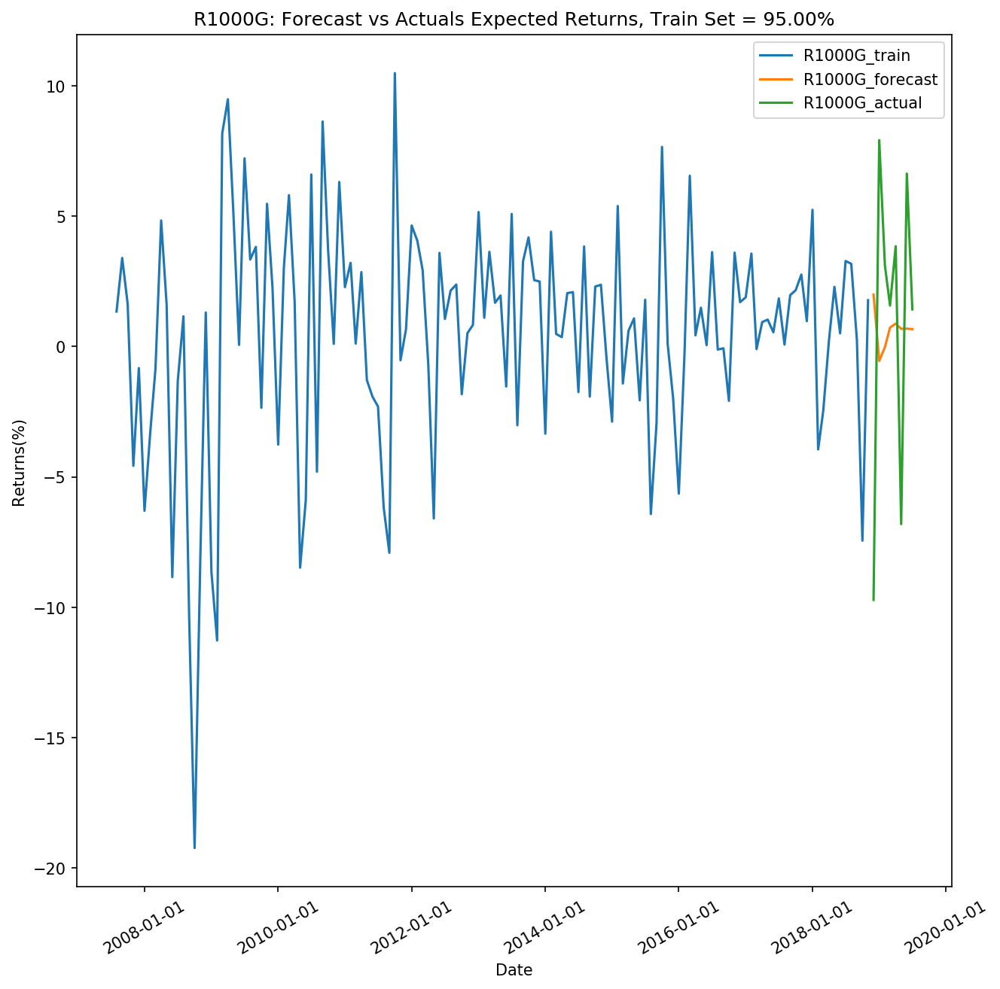

Forecast Accuracy of: R1000G
mape   :  0.9551
me     :  -0.1842
mae    :  6.043
mpe    :  -0.9551
rmse   :  7.41
corr   :  -0.9793


In [72]:
[causation_matrix,index_remove,merge1_tested_R1000G] = causation_test(merge1_differenced,2,5)
causation_matrix
index_remove
merge1_tested_R1000G

# Train Set = 95%
[model1_fitted_R1000G,df1_R1000G,df1_train_R1000G,df1_test_R1000G,date1] = VAR_Model(merge1_tested_R1000G,2,5,0.05)
[df1_forecast_R1000G,lag_order1_R1000G] = forecast_plot(model1_fitted_R1000G,df1_R1000G,df1_train_R1000G,df1_test_R1000G,date1,95)

print('Forecast Accuracy of: R1000G')
accuracy_prod = forecast_accuracy(df1_forecast_R1000G.iloc[:lag_order1_R1000G,0].values, df1_test_R1000G.iloc[:lag_order1_R1000G,0])

for k, v in accuracy_prod.items():
    print(adjust(k), ': ', round(v,4)) 

  Summary of Regression Results   
Model:                         VAR
Method:                        OLS
Date:           Wed, 28, Aug, 2019
Time:                     12:11:53
--------------------------------------------------------------------
No. of Equations:         3.00000    BIC:                    19.9342
Nobs:                     125.000    HQIC:                   19.4103
Log likelihood:          -1683.84    FPE:                1.88399e+08
AIC:                      19.0518    Det(Omega_mle):     1.40014e+08
--------------------------------------------------------------------
Results for equation R1000G
                        coefficient       std. error           t-stat            prob
-------------------------------------------------------------------------------------
const                      0.252800         0.384483            0.658           0.511
L1.R1000G                  0.054856         0.095666            0.573           0.566
L1.ICSA                   -0.000037    

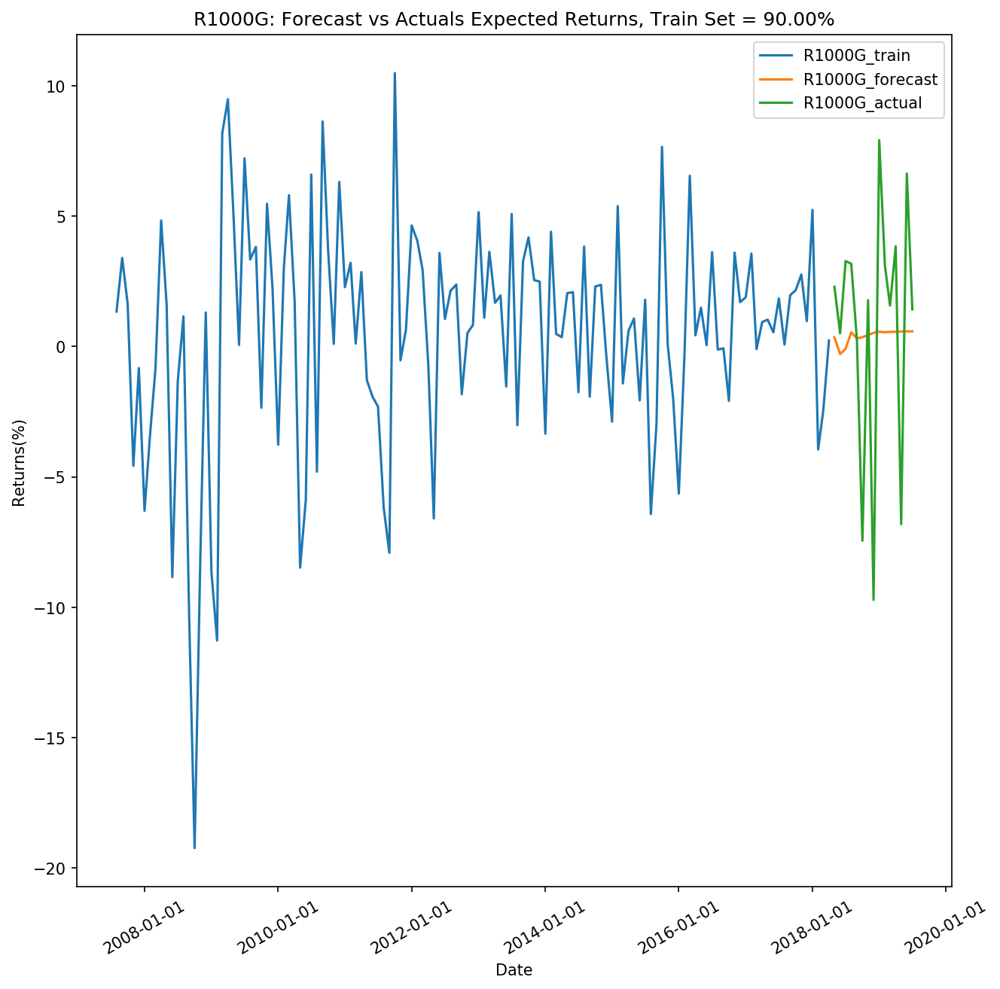

Forecast Accuracy of: R1000G
mape   :  1.0666
me     :  -2.1818
mae    :  2.1818
mpe    :  -1.0666
rmse   :  2.3782
corr   :  0.6077


In [73]:
# Train Size = 90%
[model1_fitted_R1000G,df1_R1000G,df1_train_R1000G,df1_test_R1000G,date1] = VAR_Model(merge1_tested_R1000G,2,5,0.1)
[df1_forecast_R1000G,lag_order1_R1000G] = forecast_plot(model1_fitted_R1000G,df1_R1000G,df1_train_R1000G,df1_test_R1000G,date1,90)

print('Forecast Accuracy of: R1000G')
accuracy_prod = forecast_accuracy(df1_forecast_R1000G.iloc[:lag_order1_R1000G,0].values, df1_test_R1000G.iloc[:lag_order1_R1000G,0])

for k, v in accuracy_prod.items():
    print(adjust(k), ': ', round(v,4)) 

  Summary of Regression Results   
Model:                         VAR
Method:                        OLS
Date:           Wed, 28, Aug, 2019
Time:                     12:11:55
--------------------------------------------------------------------
No. of Equations:         3.00000    BIC:                    20.2026
Nobs:                     111.000    HQIC:                   19.6368
Log likelihood:          -1501.91    FPE:                2.30053e+08
AIC:                      19.2506    Det(Omega_mle):     1.65018e+08
--------------------------------------------------------------------
Results for equation R1000G
                        coefficient       std. error           t-stat            prob
-------------------------------------------------------------------------------------
const                      0.271396         0.423265            0.641           0.521
L1.R1000G                  0.050774         0.103399            0.491           0.623
L1.ICSA                   -0.000039    

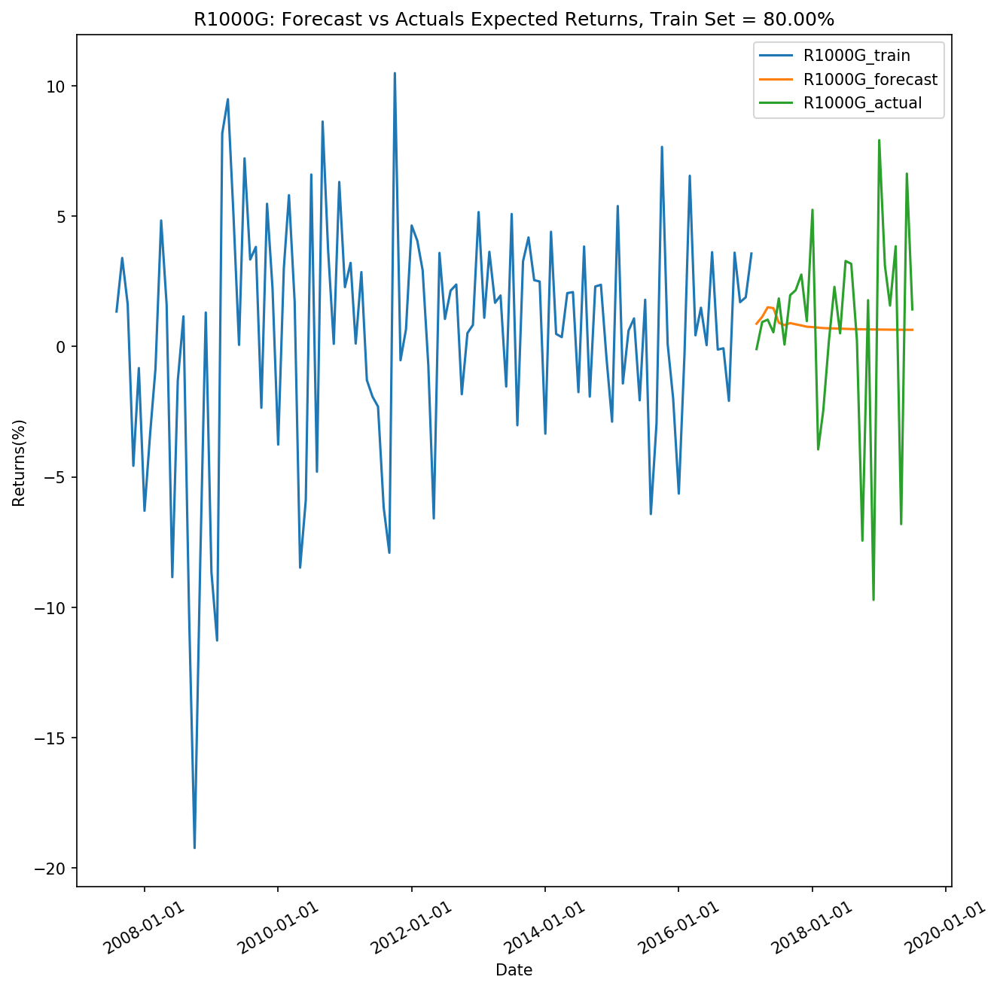

Forecast Accuracy of: R1000G
mape   :  3.0887
me     :  0.644
mae    :  0.644
mpe    :  -1.9073
rmse   :  0.7204
corr   :  0.6987


In [74]:
# Train Size = 80%
[model1_fitted_R1000G,df1_R1000G,df1_train_R1000G,df1_test_R1000G,date1] = VAR_Model(merge1_tested_R1000G,2,5,0.2)
[df1_forecast_R1000G,lag_order1_R1000G] = forecast_plot(model1_fitted_R1000G,df1_R1000G,df1_train_R1000G,df1_test_R1000G,date1,80)

print('Forecast Accuracy of: R1000G')
accuracy_prod = forecast_accuracy(df1_forecast_R1000G.iloc[:lag_order1_R1000G,0].values, df1_test_R1000G.iloc[:lag_order1_R1000G,0])

for k, v in accuracy_prod.items():
    print(adjust(k), ': ', round(v,4)) 

  Summary of Regression Results   
Model:                         VAR
Method:                        OLS
Date:           Wed, 28, Aug, 2019
Time:                     12:11:56
--------------------------------------------------------------------
No. of Equations:         3.00000    BIC:                    20.5975
Nobs:                     96.0000    HQIC:                   19.9768
Log likelihood:          -1308.33    FPE:                3.12697e+08
AIC:                      19.5557    Det(Omega_mle):     2.13628e+08
--------------------------------------------------------------------
Results for equation R1000G
                        coefficient       std. error           t-stat            prob
-------------------------------------------------------------------------------------
const                      0.173324         0.477293            0.363           0.717
L1.R1000G                  0.056852         0.112201            0.507           0.612
L1.ICSA                   -0.000035    

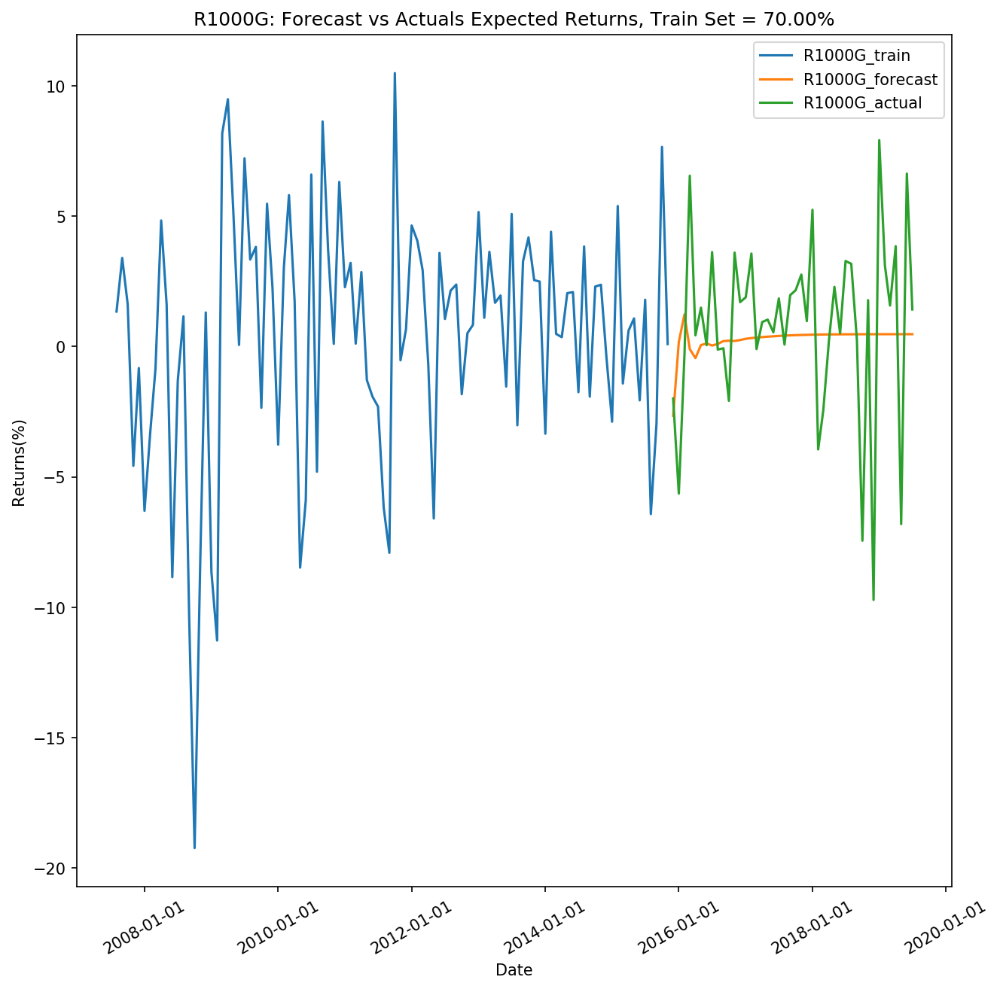

Forecast Accuracy of: R1000G
mape   :  1.875
me     :  0.0093
mae    :  3.6677
mpe    :  -1.7089
rmse   :  4.4986
corr   :  0.1109


In [75]:
# Train Size = 70%
[model1_fitted_R1000G,df1_R1000G,df1_train_R1000G,df1_test_R1000G,date1] = VAR_Model(merge1_tested_R1000G,2,5,0.3)
[df1_forecast_R1000G,lag_order1_R1000G] = forecast_plot(model1_fitted_R1000G,df1_R1000G,df1_train_R1000G,df1_test_R1000G,date1,70)

print('Forecast Accuracy of: R1000G')
accuracy_prod = forecast_accuracy(df1_forecast_R1000G.iloc[:lag_order1_R1000G,0].values, df1_test_R1000G.iloc[:lag_order1_R1000G,0])

for k, v in accuracy_prod.items():
    print(adjust(k), ': ', round(v,4)) 

#### 2.1.4 Forecast the returns for R1000V

        R1000V  DGORDER  PERMIT     ICSA      AWHAEMAN  CSCICP03USM665S  \
0     0.824544   -722.0     1.0  11300.0  1.000000e-01         0.089706   
1     3.169563 -33032.0     7.0  -8550.0  0.000000e+00        -0.469253   
2    -0.139933  21007.0    16.0  15550.0 -3.000000e-01        -1.169357   
3    -5.321445  -5756.0    67.0  -3000.0  3.000000e-01        -1.675790   
4    -1.214891   6528.0  -178.0  14450.0  0.000000e+00        -1.953669   
5    -4.271911   5531.0   -43.0  -2700.0 -2.000000e-01        -2.143401   
6    -4.587407  -7137.0   -52.0   2500.0  2.000000e-01        -2.305934   
7    -0.972388  -9163.0   -45.0  30000.0  0.000000e+00        -2.499122   
8     4.606064  -3303.0   167.0 -14750.0 -3.000000e-01        -2.846579   
9    -0.449713   3094.0   -36.0  23300.0  1.000000e-01        -3.159378   
10  -10.320302  -2748.0   271.0   5500.0 -1.000000e-01        -3.236472   
11   -0.583980 -13147.0  -213.0  16700.0 -1.000000e-01        -3.014665   
12    1.420719  -4725.0  

,R1000V_x,DGORDER_x,PERMIT_x,ICSA_x,AWHAEMAN_x,CSCICP03USM665S_x,T10Y3M_x
R1000V_y,1.0000,0.0479,0.2482,0.0377,0.2904,0.0019,0.1971
DGORDER_y,0.0097,1.0000,0.0895,0.0000,0.0000,0.0037,0.5878
PERMIT_y,0.0092,0.0000,1.0000,0.0000,0.0017,0.0049,0.0001
ICSA_y,0.0094,0.0535,0.0216,1.0000,0.1471,0.0001,0.0050
AWHAEMAN_y,0.0000,0.0000,0.0001,0.0000,1.0000,0.0100,0.0003
CSCICP03USM665S_y,0.0719,0.1197,0.0075,0.2277,0.0574,1.0000,0.0000
T10Y3M_y,0.0149,0.0001,0.0000,0.1609,0.0978,0.0445,1.0000


[6, 8, 10]

,Date,R1000,R1000G,R1000V,SP500,DGORDER,ICSA,CSCICP03USM665S
0,2007-08-01,1.451094,1.343026,0.824544,1.278156,-722.0,11300.0,0.089706
1,2007-09-01,4.013039,3.400576,3.169563,3.516828,-33032.0,-8550.0,-0.469253
2,2007-10-01,3.287222,1.625314,-0.139933,1.471356,21007.0,15550.0,-1.169357
3,2007-11-01,-3.887221,-4.575993,-5.321445,-4.504279,-5756.0,-3000.0,-1.675790
4,2007-12-01,-0.469530,-0.824280,-1.214891,-0.866593,6528.0,14450.0,-1.953669
5,2008-01-01,-8.177504,-6.302100,-4.271911,-6.311391,5531.0,-2700.0,-2.143401
6,2008-02-01,-2.147421,-3.323734,-4.587407,-3.537971,-7137.0,2500.0,-2.305934
7,2008-03-01,-0.723745,-0.843280,-0.972388,-0.597741,-9163.0,30000.0,-2.499122
8,2008-04-01,5.051552,4.838550,4.606064,4.645094,-3303.0,-14750.0,-2.846579
9,2008-05-01,3.463409,1.607319,-0.449713,1.061759,3094.0,23300.0,-3.159378


  Summary of Regression Results   
Model:                         VAR
Method:                        OLS
Date:           Wed, 28, Aug, 2019
Time:                     12:17:15
--------------------------------------------------------------------
No. of Equations:         4.00000    BIC:                    39.2309
Nobs:                     133.000    HQIC:                   38.5601
Log likelihood:          -3236.58    FPE:                3.53244e+16
AIC:                      38.1008    Det(Omega_mle):     2.43260e+16
--------------------------------------------------------------------
Results for equation R1000V
                        coefficient       std. error           t-stat            prob
-------------------------------------------------------------------------------------
const                      0.156355         0.374428            0.418           0.676
L1.R1000V                  0.086125         0.093673            0.919           0.358
L1.DGORDER                 0.000066    

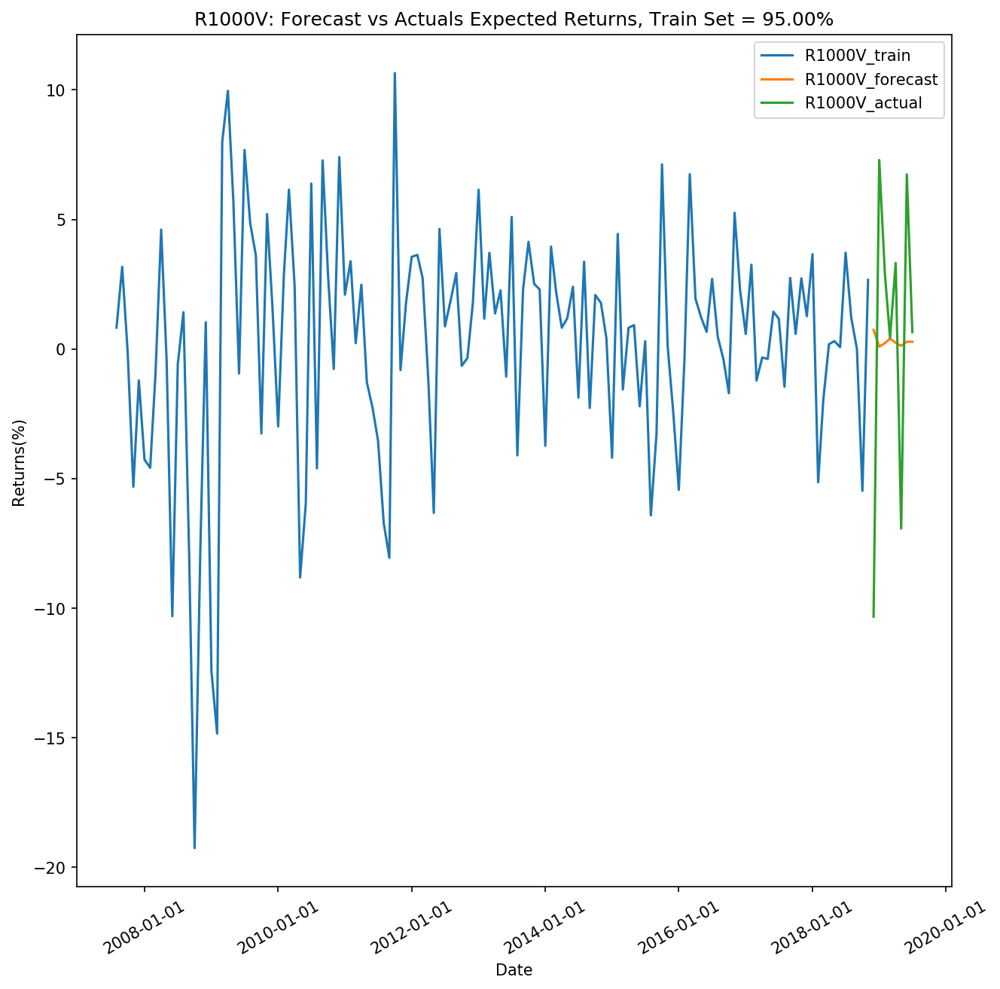

Forecast Accuracy of: R1000V
mape   :  0.9943
me     :  0.3975
mae    :  6.9832
mpe    :  -0.9943
rmse   :  7.7818
corr   :  -0.9992


In [76]:
[causation_matrix,index_remove,merge1_tested_R1000V] = causation_test(merge1_differenced,3,5)
causation_matrix
index_remove
merge1_tested_R1000V

# Train Size = 95%
[model1_fitted_R1000V,df1_R1000V,df1_train_R1000V,df1_test_R1000V,date1] = VAR_Model(merge1_tested_R1000V,3,5,0.05)
[df1_forecast_R1000V,lag_order1_R1000V] = forecast_plot(model1_fitted_R1000V,df1_R1000V,df1_train_R1000V,df1_test_R1000V,date1,95)

print('Forecast Accuracy of: R1000V')
accuracy_prod = forecast_accuracy(df1_forecast_R1000V.iloc[:lag_order1_R1000V,0].values, df1_test_R1000V.iloc[:lag_order1_R1000V,0])

for k, v in accuracy_prod.items():
    print(adjust(k), ': ', round(v,4)) 

  Summary of Regression Results   
Model:                         VAR
Method:                        OLS
Date:           Wed, 28, Aug, 2019
Time:                     12:17:16
--------------------------------------------------------------------
No. of Equations:         4.00000    BIC:                    39.3968
Nobs:                     126.000    HQIC:                   38.7018
Log likelihood:          -3071.40    FPE:                4.00637e+16
AIC:                      38.2263    Det(Omega_mle):     2.70504e+16
--------------------------------------------------------------------
Results for equation R1000V
                        coefficient       std. error           t-stat            prob
-------------------------------------------------------------------------------------
const                      0.132918         0.388951            0.342           0.733
L1.R1000V                  0.093525         0.095492            0.979           0.327
L1.DGORDER                 0.000068    

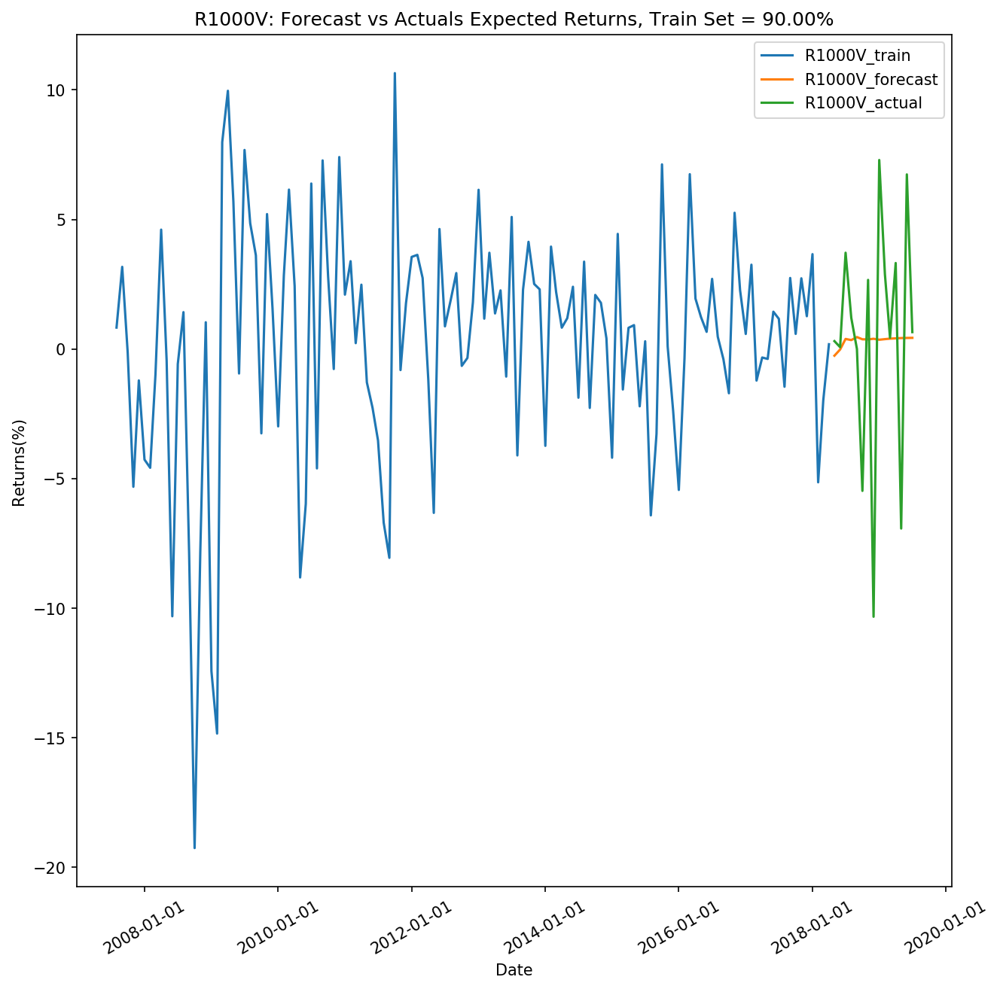

Forecast Accuracy of: R1000V
mape   :  1.3596
me     :  -1.3273
mae    :  1.3273
mpe    :  -1.3596
rmse   :  1.9493
corr   :  0.9088


In [77]:
# Train Size = 90%
[model1_fitted_R1000V,df1_R1000V,df1_train_R1000V,df1_test_R1000V,date1] = VAR_Model(merge1_tested_R1000V,3,5,0.1)
[df1_forecast_R1000V,lag_order1_R1000V] = forecast_plot(model1_fitted_R1000V,df1_R1000V,df1_train_R1000V,df1_test_R1000V,date1,90)

print('Forecast Accuracy of: R1000V')
accuracy_prod = forecast_accuracy(df1_forecast_R1000V.iloc[:lag_order1_R1000V,0].values, df1_test_R1000V.iloc[:lag_order1_R1000V,0])

for k, v in accuracy_prod.items():
    print(adjust(k), ': ', round(v,4)) 

  Summary of Regression Results   
Model:                         VAR
Method:                        OLS
Date:           Wed, 28, Aug, 2019
Time:                     12:17:16
--------------------------------------------------------------------
No. of Equations:         4.00000    BIC:                    39.7191
Nobs:                     112.000    HQIC:                   38.9691
Log likelihood:          -2737.28    FPE:                5.05220e+16
AIC:                      38.4570    Det(Omega_mle):     3.25621e+16
--------------------------------------------------------------------
Results for equation R1000V
                        coefficient       std. error           t-stat            prob
-------------------------------------------------------------------------------------
const                      0.219263         0.428350            0.512           0.609
L1.R1000V                  0.093339         0.102491            0.911           0.362
L1.DGORDER                 0.000070    

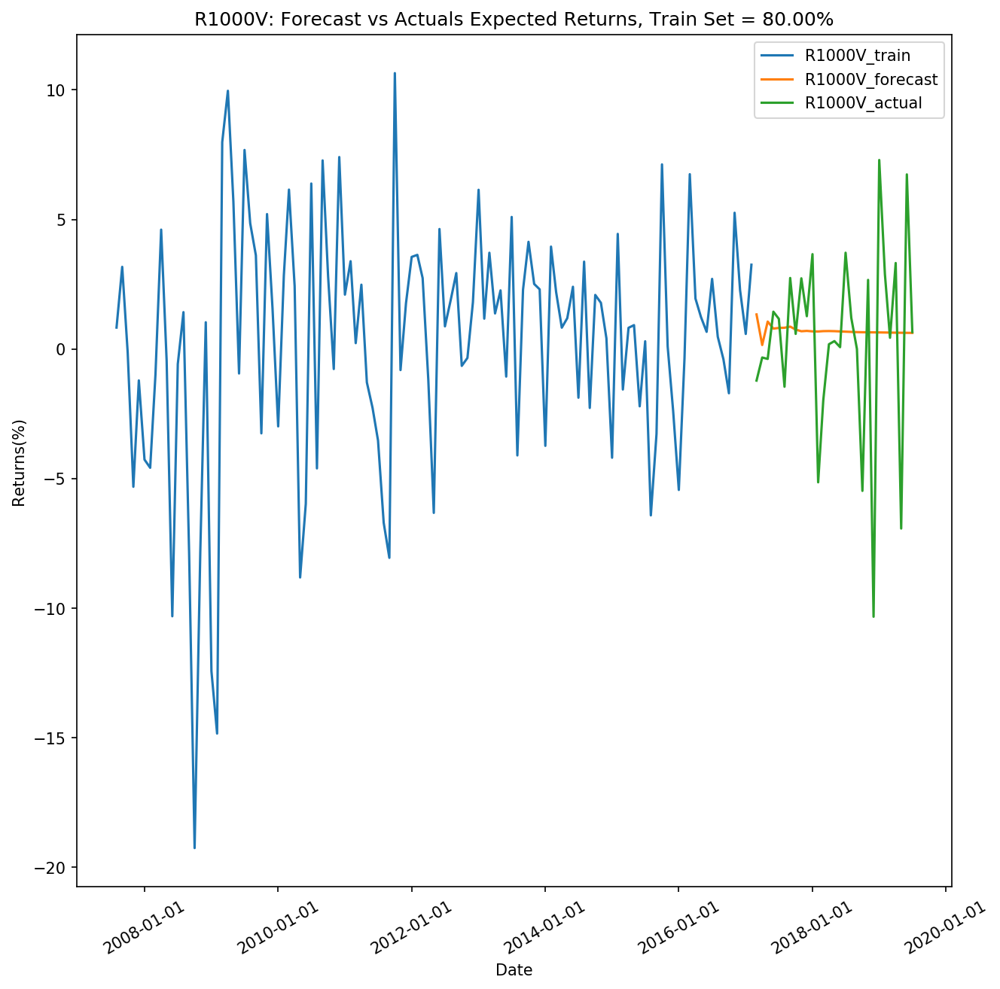

Forecast Accuracy of: R1000V
mape   :  2.4324
me     :  1.4927
mae    :  1.4927
mpe    :  -2.4324
rmse   :  1.7158
corr   :  -0.7184


In [78]:
# Train Size = 80%
[model1_fitted_R1000V,df1_R1000V,df1_train_R1000V,df1_test_R1000V,date1] = VAR_Model(merge1_tested_R1000V,3,5,0.2)
[df1_forecast_R1000V,lag_order1_R1000V] = forecast_plot(model1_fitted_R1000V,df1_R1000V,df1_train_R1000V,df1_test_R1000V,date1,80)

print('Forecast Accuracy of: R1000V')
accuracy_prod = forecast_accuracy(df1_forecast_R1000V.iloc[:lag_order1_R1000V,0].values, df1_test_R1000V.iloc[:lag_order1_R1000V,0])

for k, v in accuracy_prod.items():
    print(adjust(k), ': ', round(v,4)) 

  Summary of Regression Results   
Model:                         VAR
Method:                        OLS
Date:           Wed, 28, Aug, 2019
Time:                     12:17:17
--------------------------------------------------------------------
No. of Equations:         4.00000    BIC:                    40.2699
Nobs:                     97.0000    HQIC:                   39.4478
Log likelihood:          -2384.70    FPE:                7.80518e+16
AIC:                      38.8897    Det(Omega_mle):     4.71953e+16
--------------------------------------------------------------------
Results for equation R1000V
                        coefficient       std. error           t-stat            prob
-------------------------------------------------------------------------------------
const                      0.108706         0.481541            0.226           0.821
L1.R1000V                  0.082049         0.110316            0.744           0.457
L1.DGORDER                 0.000078    

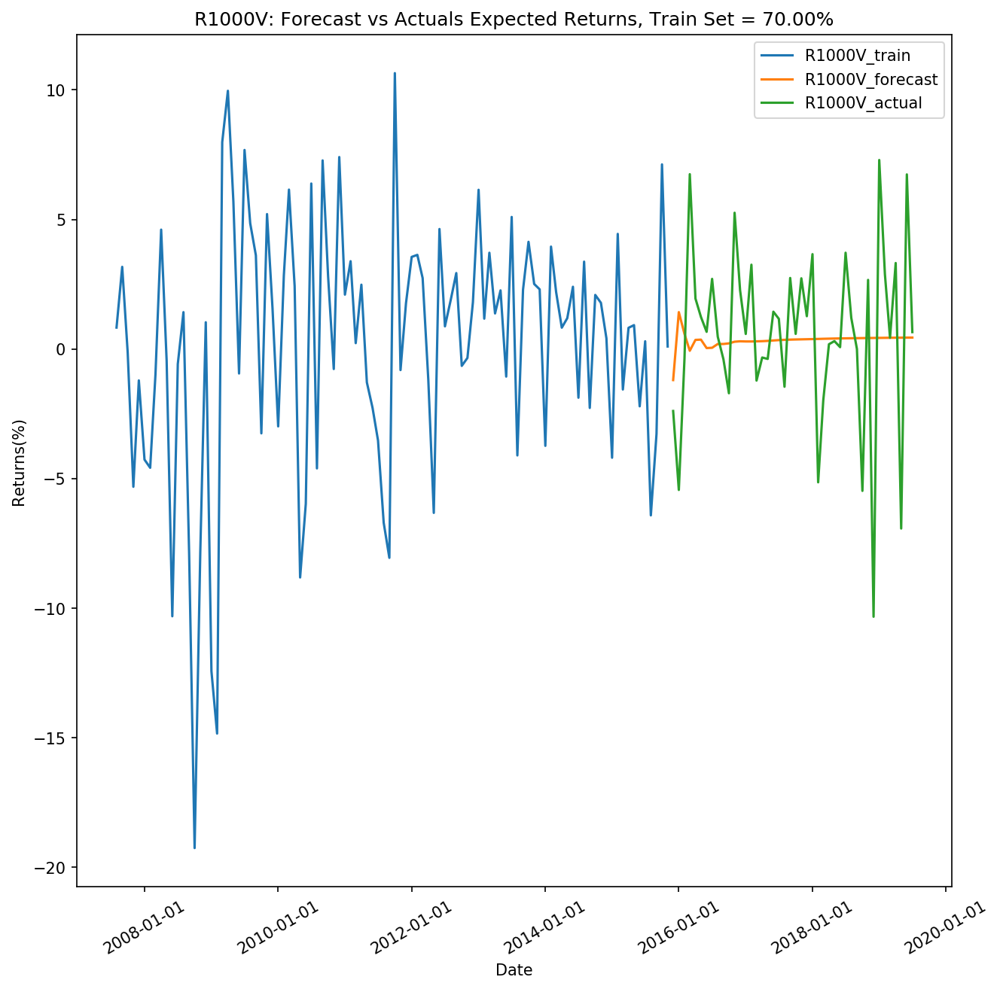

Forecast Accuracy of: R1000V
mape   :  1.4392
me     :  3.0021
mae    :  3.0021
mpe    :  -1.4392
rmse   :  4.0599
corr   :  -0.4229


In [79]:
# Train Size = 70%
[model1_fitted_R1000V,df1_R1000V,df1_train_R1000V,df1_test_R1000V,date1] = VAR_Model(merge1_tested_R1000V,3,5,0.3)
[df1_forecast_R1000V,lag_order1_R1000V] = forecast_plot(model1_fitted_R1000V,df1_R1000V,df1_train_R1000V,df1_test_R1000V,date1,70)

print('Forecast Accuracy of: R1000V')
accuracy_prod = forecast_accuracy(df1_forecast_R1000V.iloc[:lag_order1_R1000V,0].values, df1_test_R1000V.iloc[:lag_order1_R1000V,0])

for k, v in accuracy_prod.items():
    print(adjust(k), ': ', round(v,4)) 

### 2.2 Coincident Indicators

* All Employees: Total Nonfarm Payrolls (PAYEMS)
* Real Disposable Personal Income (DSPIC96)
* Industrial Production Index (INDPRO)
* Real Manufacturing and Trade Industries Sales (CMRMTSPL)
* Personal Consumption Expenditures (PCE)
* Advance Real Retail and Food Services Sales (RRSFS)
* Merchant Wholesalers, Except Manufacturers' Sales Branches and Offices Sales: Durable Goods Sales (S423SMM144SCEN)
* Producer Price Index for All Commodities (PPIACO)

,PAYEMS
1939-02-01,0.589776
1939-03-01,0.593001
1939-04-01,0.189947
1939-05-01,0.312182
1939-06-01,0.383297
1939-07-01,0.274000
1939-08-01,0.348990
1939-09-01,0.454491
1939-10-01,0.539230
1939-11-01,0.504073


,DSPIC96
1959-02-01,0.301301
1959-03-01,0.437002
1959-04-01,0.506676
1959-05-01,0.515855
1959-06-01,0.478859
1959-07-01,0.372990
1959-08-01,0.235148
1959-09-01,0.210813
1959-10-01,0.195878
1959-11-01,0.247907


,INDPRO
1919-04-01,-1.894251e+00
1919-05-01,-1.274878e+00
1919-06-01,2.198391e-01
1919-07-01,1.155998e+00
1919-08-01,1.210135e+00
1919-09-01,8.023822e-01
1919-10-01,5.974563e-01
1919-11-01,3.793538e-01
1919-12-01,4.888279e-01
1920-01-01,1.198645e+00


,CMRMTSPL
1967-02-01,-0.384574
1967-03-01,0.168550
1967-04-01,0.090560
1967-05-01,0.047440
1967-06-01,0.185972
1967-07-01,0.046924
1967-08-01,0.230838
1967-09-01,0.246033
1967-10-01,0.141332
1967-11-01,0.392993


,PCE
1959-02-01,1.136930
1959-03-01,1.066621
1959-04-01,0.657739
1959-05-01,0.803669
1959-06-01,0.775365
1959-07-01,0.625173
1959-08-01,0.643342
1959-09-01,0.718110
1959-10-01,0.590234
1959-11-01,0.534308


,RRSFS
1992-02-01,-0.144224
1992-03-01,-0.402370
1992-04-01,-0.139354
1992-05-01,-0.021712
1992-06-01,-0.018382
1992-07-01,0.055113
1992-08-01,0.063071
1992-09-01,0.147253
1992-10-01,0.163790
1992-11-01,0.141347


,S423SMM144SCEN
1992-03-01,1.712856
1992-04-01,1.513852
1992-05-01,0.701089
1992-06-01,1.108951
1992-07-01,1.056274
1992-08-01,0.842804
1992-09-01,0.789785
1992-10-01,0.800733
1992-11-01,0.893700
1992-12-01,0.759006


,PPIACO
1913-02-01,-0.829880
1913-03-01,-0.414940
1913-04-01,-0.276627
1913-05-01,-0.416676
1913-06-01,-0.333341
1913-07-01,-0.138313
1913-08-01,-0.118554
1913-09-01,0.102881
1913-10-01,0.091450
1913-11-01,0.000000


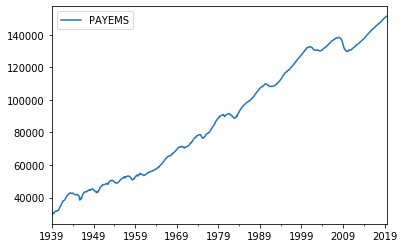

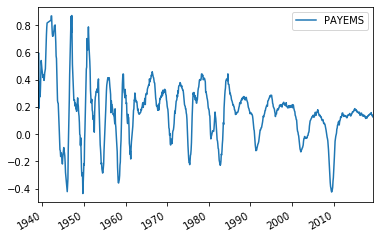

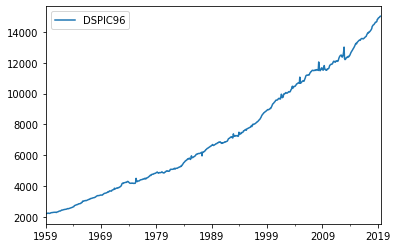

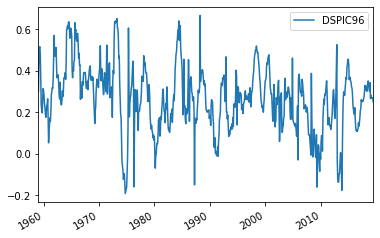

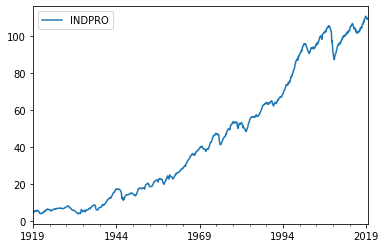

...

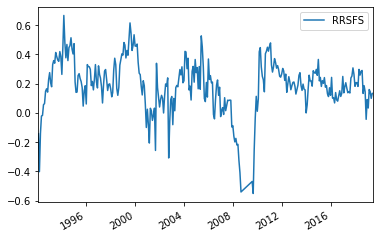

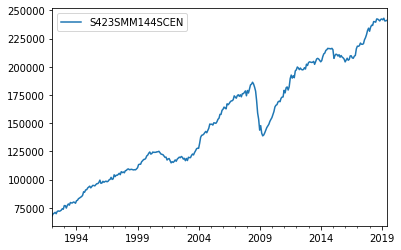

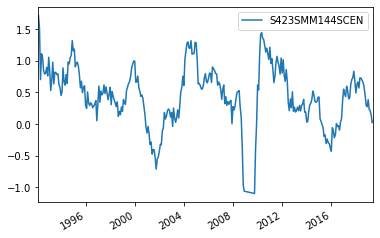

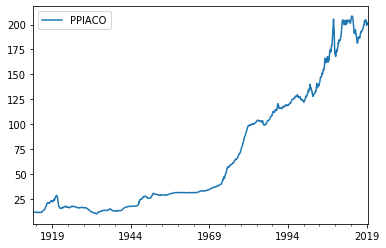

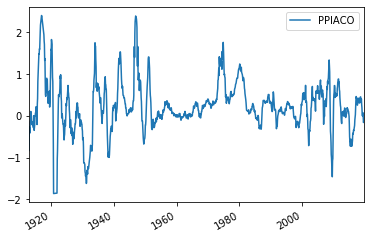

In [80]:
# Coincident Indicators from Fred Data
coincident_fred = ['PAYEMS','DSPIC96','INDPRO','CMRMTSPL','PCE','RRSFS','S423SMM144SCEN','PPIACO']
coincident_df = {}
for i in range(0,len(coincident_fred)):
    data = fred.get_series(coincident_fred[i]).dropna()
    data_series = pd.DataFrame(data,columns=[coincident_fred[i]])
    data_series = data_series.resample('MS').sum().dropna()
    data_series.plot()
    data_series = np.log(data_series).diff().dropna()*100
    data_series = data_series.diff(periods=12).dropna()
    data_series = data_series.rolling(12, min_periods=1).mean()
    z = np.abs(stats.zscore(data_series))
    data_series_o = data_series[(z < 3).all(axis=1)]
    data_series_o.plot()
    coincident_df[coincident_fred[i]] = data_series_o
    data_series_o
    

In [81]:
merge2 = Merge(coincident_df,coincident_fred)
merge2 = merge2.rename(columns={'index':'Date'})
merge2

,Date,R1000,R1000G,R1000V,SP500,PAYEMS,DSPIC96,INDPRO,CMRMTSPL,PCE,RRSFS,S423SMM144SCEN,PPIACO
0,2002-10-01,8.710151,7.831176,6.907849,8.291442,-0.052459,0.276554,0.194912,0.042551,0.253109,-0.308900,0.237483,0.183436
1,2002-11-01,5.192548,5.500032,5.822577,5.550058,-0.033487,0.282467,0.279227,0.171974,0.332521,-0.059770,0.211000,0.209216
2,2002-12-01,-7.291105,-5.998594,-4.650805,-6.222928,-0.032443,0.293180,0.236286,0.090660,0.415147,0.091364,0.110301,0.306548
3,2003-01-01,-2.530097,-2.581405,-2.636353,-2.779749,-0.017338,0.129567,0.247036,0.147595,0.406679,0.111447,0.182805,0.429714
4,2003-02-01,-0.593941,-1.760957,-2.971919,-1.714984,-0.018567,0.101207,0.261081,0.024709,0.358823,-0.081313,-0.038598,0.576671
5,2003-03-01,1.749153,0.887685,-0.025528,0.832287,-0.031037,0.122805,0.174081,0.141535,0.405861,0.098009,0.251636,0.701521
6,2003-04-01,7.076132,7.636873,8.234498,7.792735,-0.028243,0.136798,0.079950,0.022095,0.352448,0.013698,0.095137,0.373755
7,2003-05-01,4.777050,5.372610,5.996177,4.964567,-0.027921,0.172342,0.047130,0.077592,0.386143,0.172176,0.026123,0.367661
8,2003-06-01,1.251348,1.166838,1.079230,1.125863,-0.031046,0.178531,-0.017854,0.128135,0.400607,0.187145,0.104119,0.440167
9,2003-07-01,2.402049,1.831130,1.248816,1.609351,-0.025370,0.304692,0.038750,0.214505,0.394511,0.177850,0.223271,0.402954


In [82]:
# Remove the outlier
merge2_outlier = merge2.iloc[:,4:].copy()
z = np.abs(stats.zscore(merge2_outlier))
merge2_outlier = merge2_outlier[(z < 3).all(axis=1)]
merge2_o = pd.concat([merge2.iloc[:,0:4],merge2_outlier],join='inner',axis=1).dropna()
merge2_o

,Date,R1000,R1000G,R1000V,SP500,PAYEMS,DSPIC96,INDPRO,CMRMTSPL,PCE,RRSFS,S423SMM144SCEN,PPIACO
1,2002-11-01,5.192548,5.500032,5.822577,5.550058,-0.033487,0.282467,0.279227,0.171974,0.332521,-0.059770,0.211000,0.209216
2,2002-12-01,-7.291105,-5.998594,-4.650805,-6.222928,-0.032443,0.293180,0.236286,0.090660,0.415147,0.091364,0.110301,0.306548
3,2003-01-01,-2.530097,-2.581405,-2.636353,-2.779749,-0.017338,0.129567,0.247036,0.147595,0.406679,0.111447,0.182805,0.429714
4,2003-02-01,-0.593941,-1.760957,-2.971919,-1.714984,-0.018567,0.101207,0.261081,0.024709,0.358823,-0.081313,-0.038598,0.576671
5,2003-03-01,1.749153,0.887685,-0.025528,0.832287,-0.031037,0.122805,0.174081,0.141535,0.405861,0.098009,0.251636,0.701521
6,2003-04-01,7.076132,7.636873,8.234498,7.792735,-0.028243,0.136798,0.079950,0.022095,0.352448,0.013698,0.095137,0.373755
7,2003-05-01,4.777050,5.372610,5.996177,4.964567,-0.027921,0.172342,0.047130,0.077592,0.386143,0.172176,0.026123,0.367661
8,2003-06-01,1.251348,1.166838,1.079230,1.125863,-0.031046,0.178531,-0.017854,0.128135,0.400607,0.187145,0.104119,0.440167
9,2003-07-01,2.402049,1.831130,1.248816,1.609351,-0.025370,0.304692,0.038750,0.214505,0.394511,0.177850,0.223271,0.402954
10,2003-08-01,2.361945,1.850221,1.320796,1.771534,-0.027866,0.364103,0.025764,0.131440,0.473786,0.238186,0.095087,0.402057


0
1
0
0


C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


1
1
0
1
1


[]

,Date,R1000,R1000G,R1000V,SP500,PAYEMS,DSPIC96,INDPRO,CMRMTSPL,PCE,RRSFS,S423SMM144SCEN,PPIACO
0,2003-04-01,7.076132,7.636873,8.234498,7.792735,0.002794,0.136798,0.079950,-0.119440,-0.053413,0.013698,-0.156499,-0.327766
1,2003-05-01,4.777050,5.372610,5.996177,4.964567,0.000322,0.172342,0.047130,0.055497,0.033694,0.172176,-0.069014,-0.006094
2,2003-06-01,1.251348,1.166838,1.079230,1.125863,-0.003125,0.178531,-0.017854,0.050543,0.014464,0.187145,0.077996,0.072506
3,2003-07-01,2.402049,1.831130,1.248816,1.609351,0.005676,0.304692,0.038750,0.086370,-0.006096,0.177850,0.119152,-0.037212
4,2003-08-01,2.361945,1.850221,1.320796,1.771534,-0.002497,0.364103,0.025764,-0.083065,0.079276,0.238186,-0.128184,-0.000897
5,2003-09-01,-1.171651,-1.167637,-1.163576,-1.201623,0.012209,0.259790,0.063105,0.105556,0.012362,0.295650,0.190745,-0.020405
6,2003-10-01,5.379164,5.548351,5.724132,5.350427,0.004806,0.268873,0.100068,0.058174,-0.033269,0.258804,0.219196,-0.008501
7,2003-11-01,0.945482,1.027573,1.113868,0.710323,0.001787,0.296829,0.120646,-0.056642,0.024595,0.314362,0.069615,-0.017705
8,2003-12-01,3.282110,4.513700,5.770335,4.951890,0.016532,0.280430,0.155689,0.041337,-0.027942,0.205210,0.179852,0.048451
9,2004-01-01,1.982772,1.775387,1.564719,1.712888,0.004710,0.272383,0.113687,-0.090517,0.038456,0.219072,-0.146966,-0.036412


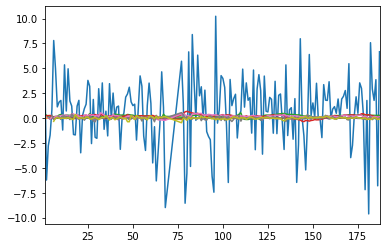

In [83]:
# ADF Test
merge2_diff = merge2_o.copy()

[index_remove2,merge2_differenced]=ADF_Test(merge2_diff)
index_remove2
merge2_differenced

#### 2.2.1 Forecast the returns for SP500

In [84]:
# Grangers Causation Test
[causation_matrix,index_remove,merge2_tested] = causation_test(merge2_differenced,4,5)
causation_matrix
index_remove
merge2_tested

        SP500    PAYEMS   DSPIC96    INDPRO  CMRMTSPL       PCE     RRSFS  \
0    7.792735  0.002794  0.136798  0.079950 -0.119440 -0.053413  0.013698   
1    4.964567  0.000322  0.172342  0.047130  0.055497  0.033694  0.172176   
2    1.125863 -0.003125  0.178531 -0.017854  0.050543  0.014464  0.187145   
3    1.609351  0.005676  0.304692  0.038750  0.086370 -0.006096  0.177850   
4    1.771534 -0.002497  0.364103  0.025764 -0.083065  0.079276  0.238186   
5   -1.201623  0.012209  0.259790  0.063105  0.105556  0.012362  0.295650   
6    5.350427  0.004806  0.268873  0.100068  0.058174 -0.033269  0.258804   
7    0.710323  0.001787  0.296829  0.120646 -0.056642  0.024595  0.314362   
8    4.951890  0.016532  0.280430  0.155689  0.041337 -0.027942  0.205210   
9    1.712888  0.004710  0.272383  0.113687 -0.090517  0.038456  0.219072   
10   1.213510  0.012250  0.308544  0.152180  0.156991  0.030638  0.420116   
11  -1.649422  0.033592  0.321408  0.129935  0.117769 -0.010635  0.415952   

,SP500_x,PAYEMS_x,DSPIC96_x,INDPRO_x,CMRMTSPL_x,PCE_x,RRSFS_x,S423SMM144SCEN_x,PPIACO_x
SP500_y,1.0000,0.0004,0.2430,0.0639,0.0390,0.2653,0.0211,0.0319,0.1495
PAYEMS_y,0.0136,1.0000,0.0414,0.0000,0.0000,0.0404,0.0000,0.0000,0.0008
DSPIC96_y,0.2820,0.0553,1.0000,0.2484,0.0076,0.0007,0.0001,0.0145,0.0305
INDPRO_y,0.0881,0.0364,0.0208,1.0000,0.0035,0.0151,0.0400,0.0004,0.0027
CMRMTSPL_y,0.0324,0.0018,0.0029,0.0008,1.0000,0.0001,0.0011,0.1389,0.0026
PCE_y,0.0178,0.0419,0.0067,0.0381,0.0116,1.0000,0.0268,0.0177,0.0011
RRSFS_y,0.0246,0.0270,0.0000,0.1680,0.0459,0.0009,1.0000,0.1587,0.0158
S423SMM144SCEN_y,0.2148,0.0002,0.2221,0.0000,0.0156,0.0175,0.0016,1.0000,0.0003
PPIACO_y,0.0085,0.0675,0.1694,0.0020,0.2300,0.2544,0.1216,0.1075,1.0000


[6, 7, 9, 12]

,Date,R1000,R1000G,R1000V,SP500,PAYEMS,CMRMTSPL,RRSFS,S423SMM144SCEN
0,2003-04-01,7.076132,7.636873,8.234498,7.792735,0.002794,-0.119440,0.013698,-0.156499
1,2003-05-01,4.777050,5.372610,5.996177,4.964567,0.000322,0.055497,0.172176,-0.069014
2,2003-06-01,1.251348,1.166838,1.079230,1.125863,-0.003125,0.050543,0.187145,0.077996
3,2003-07-01,2.402049,1.831130,1.248816,1.609351,0.005676,0.086370,0.177850,0.119152
4,2003-08-01,2.361945,1.850221,1.320796,1.771534,-0.002497,-0.083065,0.238186,-0.128184
5,2003-09-01,-1.171651,-1.167637,-1.163576,-1.201623,0.012209,0.105556,0.295650,0.190745
6,2003-10-01,5.379164,5.548351,5.724132,5.350427,0.004806,0.058174,0.258804,0.219196
7,2003-11-01,0.945482,1.027573,1.113868,0.710323,0.001787,-0.056642,0.314362,0.069615
8,2003-12-01,3.282110,4.513700,5.770335,4.951890,0.016532,0.041337,0.205210,0.179852
9,2004-01-01,1.982772,1.775387,1.564719,1.712888,0.004710,-0.090517,0.219072,-0.146966


  Summary of Regression Results   
Model:                         VAR
Method:                        OLS
Date:           Fri, 30, Aug, 2019
Time:                     11:06:25
--------------------------------------------------------------------
No. of Equations:         5.00000    BIC:                   -20.0892
Nobs:                     164.000    HQIC:                  -20.4260
Log likelihood:           560.282    FPE:                1.06950e-09
AIC:                     -20.6562    Det(Omega_mle):     8.93623e-10
--------------------------------------------------------------------
Results for equation SP500
                       coefficient       std. error           t-stat            prob
------------------------------------------------------------------------------------
const                     0.631966         0.480094            1.316           0.188
L1.SP500                 -0.081407         0.078887           -1.032           0.302
L1.PAYEMS               -14.967281        16

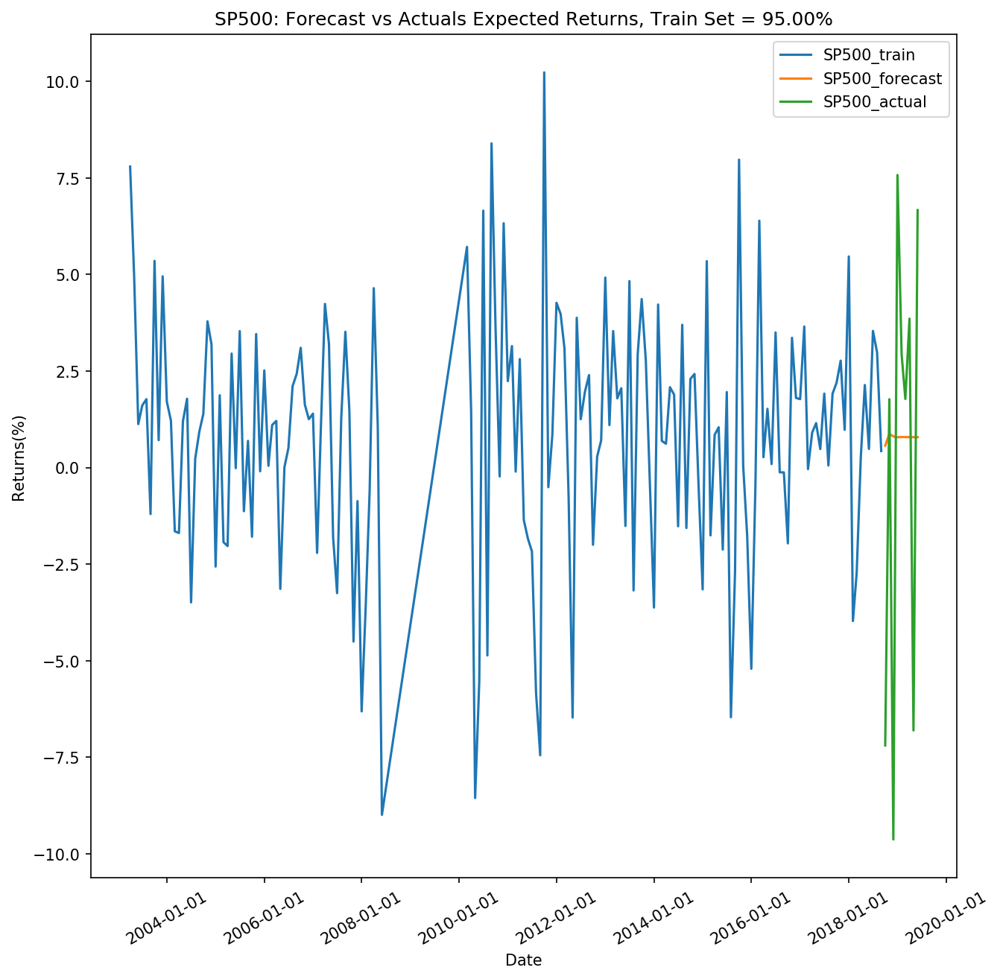

In [85]:
# Forecast, Train Set = 95%
[model2_fitted,df2,df2_train,df2_test,date2] = VAR_Model(merge2_tested,4,5,0.05)
[df2_forecast,lag_order2] = forecast_plot(model2_fitted,df2,df2_train,df2_test,date2,95)

In [86]:
# Test the Accuracy
print('Forecast Accuracy of: SP500')
accuracy_prod = forecast_accuracy(df2_forecast.iloc[:lag_order2,0].values, df2_test.iloc[:lag_order2,0])
for k, v in accuracy_prod.items():
    print(adjust(k), ': ', round(v,4))
    
print('\nForecast values are: ',df2_forecast.iloc[:lag_order2,0].values)
print('Actual values are: ',df2_test.iloc[:lag_order2,0].values)


Forecast Accuracy of: SP500
mape   :  1.0793
me     :  7.7632
mae    :  7.7632
mpe    :  -1.0793
rmse   :  7.7632
corr   :  nan

Forecast values are:  [0.57025754]
Actual values are:  [-7.19293491]


C:\ProgramData\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2522: RuntimeWarning: Degrees of freedom <= 0 for slice
  c = cov(x, y, rowvar)
C:\ProgramData\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2451: RuntimeWarning: divide by zero encountered in true_divide
  c *= np.true_divide(1, fact)
C:\ProgramData\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2451: RuntimeWarning: invalid value encountered in multiply
  c *= np.true_divide(1, fact)


  Summary of Regression Results   
Model:                         VAR
Method:                        OLS
Date:           Fri, 30, Aug, 2019
Time:                     10:57:01
--------------------------------------------------------------------
No. of Equations:         5.00000    BIC:                   -14.1778
Nobs:                     150.000    HQIC:                  -15.1311
Log likelihood:           199.553    FPE:                1.40318e-07
AIC:                     -15.7834    Det(Omega_mle):     8.45333e-08
--------------------------------------------------------------------
Results for equation SP500
                       coefficient       std. error           t-stat            prob
------------------------------------------------------------------------------------
const                     0.895389         0.285417            3.137           0.002
L1.SP500                 -0.084201         0.087092           -0.967           0.334
L1.PAYEMS                -3.201571         8

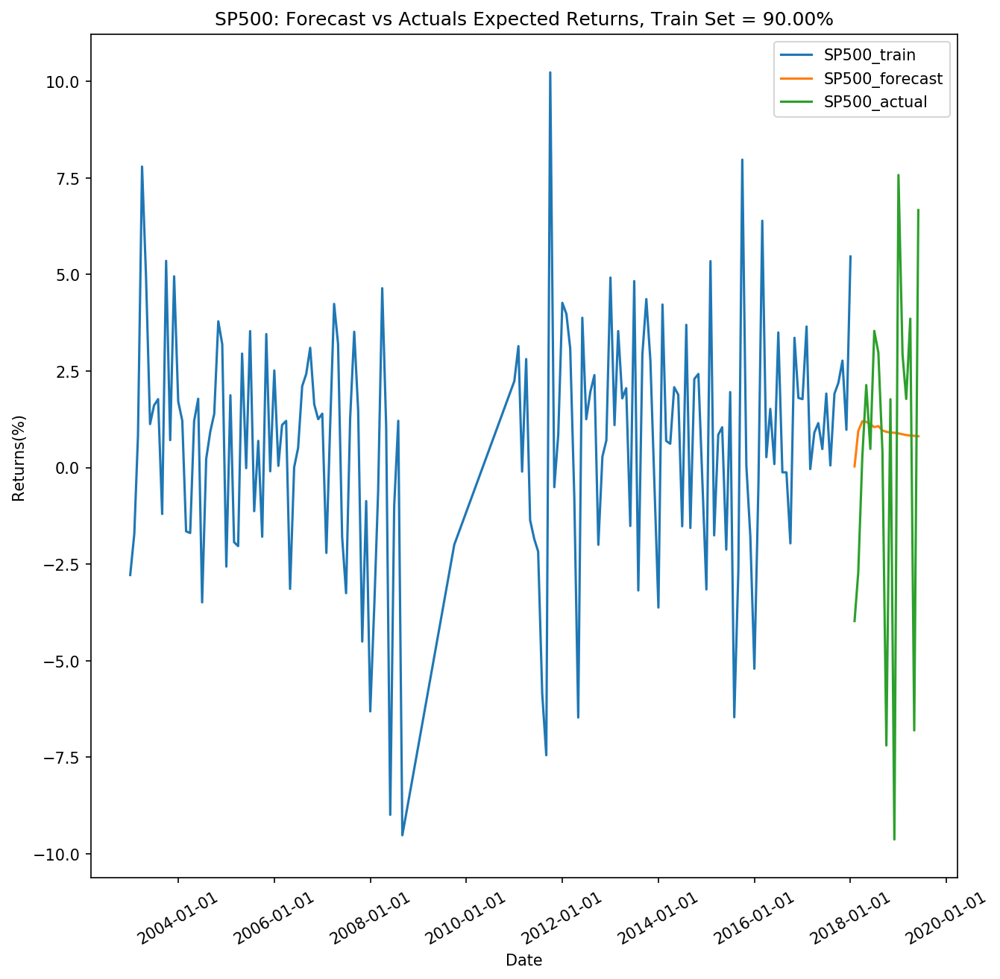

Forecast Accuracy of: SP500
mape   :  1.9253
me     :  2.8666
mae    :  2.8666
mpe    :  0.3563
rmse   :  3.1801
corr   :  0.8547

Forecast values are:  [0.03024703 0.94256563 1.20071845]
Actual values are:  [-3.97261156 -2.7252513   0.27151117]


In [65]:
# Forecast, Train Set = 90%
[model2_fitted,df2,df2_train,df2_test,date2] = VAR_Model(merge2_tested,4,5,0.1)
[df2_forecast,lag_order2] = forecast_plot(model2_fitted,df2,df2_train,df2_test,date2,90)

# Test the Accuracy
print('Forecast Accuracy of: SP500')
accuracy_prod = forecast_accuracy(df2_forecast.iloc[:lag_order2,0].values, df2_test.iloc[:lag_order2,0])
for k, v in accuracy_prod.items():
    print(adjust(k), ': ', round(v,4))
    
print('\nForecast values are: ',df2_forecast.iloc[:lag_order2,0].values)
print('Actual values are: ',df2_test.iloc[:lag_order2,0].values)

  Summary of Regression Results   
Model:                         VAR
Method:                        OLS
Date:           Fri, 30, Aug, 2019
Time:                     10:57:36
--------------------------------------------------------------------
No. of Equations:         5.00000    BIC:                   -14.2917
Nobs:                     134.000    HQIC:                  -14.9977
Log likelihood:           141.544    FPE:                1.89432e-07
AIC:                     -15.4811    Det(Omega_mle):     1.27684e-07
--------------------------------------------------------------------
Results for equation SP500
                       coefficient       std. error           t-stat            prob
------------------------------------------------------------------------------------
const                     0.903527         0.330487            2.734           0.006
L1.SP500                 -0.064029         0.089717           -0.714           0.475
L1.PAYEMS                -0.623160         8

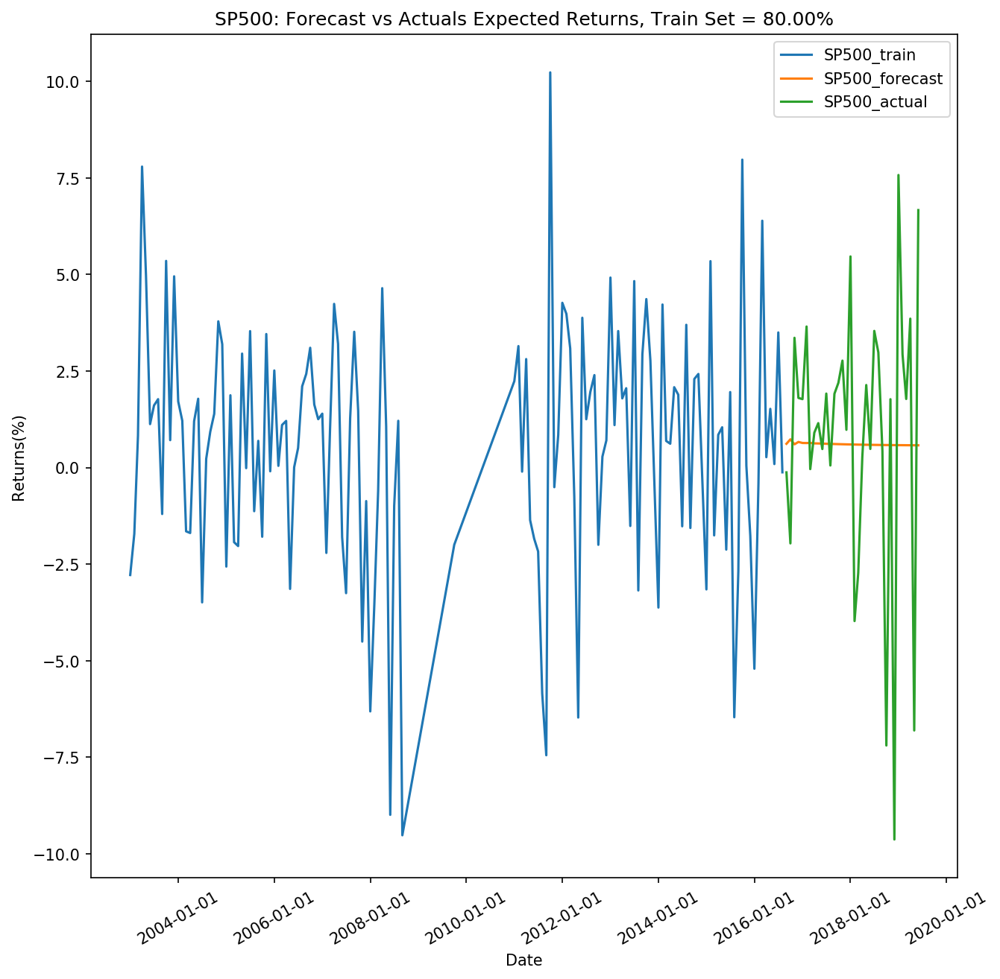

Forecast Accuracy of: SP500
mape   :  3.6823
me     :  1.7167
mae    :  1.7167
mpe    :  -3.6823
rmse   :  1.9751
corr   :  -1.0

Forecast values are:  [0.61657823 0.73163762]
Actual values are:  [-0.12352452 -1.96167821]


In [66]:
# Forecast, Train Set = 80%
[model2_fitted,df2,df2_train,df2_test,date2] = VAR_Model(merge2_tested,4,5,0.2)
[df2_forecast,lag_order2] = forecast_plot(model2_fitted,df2,df2_train,df2_test,date2,80)

# Test the Accuracy
print('Forecast Accuracy of: SP500')
accuracy_prod = forecast_accuracy(df2_forecast.iloc[:lag_order2,0].values, df2_test.iloc[:lag_order2,0])
for k, v in accuracy_prod.items():
    print(adjust(k), ': ', round(v,4))
    
print('\nForecast values are: ',df2_forecast.iloc[:lag_order2,0].values)
print('Actual values are: ',df2_test.iloc[:lag_order2,0].values)

  Summary of Regression Results   
Model:                         VAR
Method:                        OLS
Date:           Fri, 30, Aug, 2019
Time:                     10:57:58
--------------------------------------------------------------------
No. of Equations:         5.00000    BIC:                   -13.9144
Nobs:                     117.000    HQIC:                  -14.6857
Log likelihood:           114.876    FPE:                2.47930e-07
AIC:                     -15.2129    Det(Omega_mle):     1.58201e-07
--------------------------------------------------------------------
Results for equation SP500
                       coefficient       std. error           t-stat            prob
------------------------------------------------------------------------------------
const                     0.775505         0.337318            2.299           0.022
L1.SP500                 -0.057892         0.096883           -0.598           0.550
L1.PAYEMS                 2.604607         8

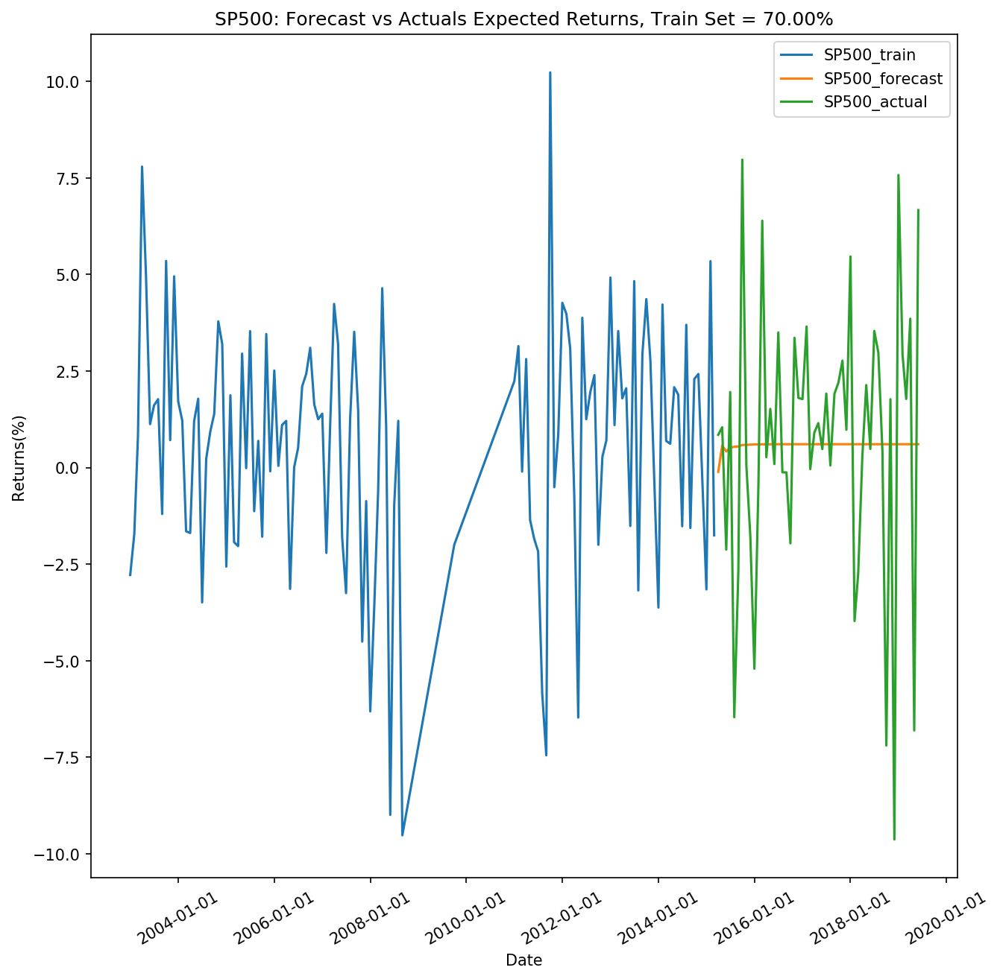

Forecast Accuracy of: SP500
mape   :  1.8463
me     :  -0.1094
mae    :  2.5672
mpe    :  -0.6778
rmse   :  3.552
corr   :  0.0458

Forecast values are:  [-0.11005681  0.56992979]
Actual values are:  [0.84846659 1.04367853]


In [67]:
# Forecast, Train Set = 70%
[model2_fitted,df2,df2_train,df2_test,date2] = VAR_Model(merge2_tested,4,5,0.3)
[df2_forecast,lag_order2] = forecast_plot(model2_fitted,df2,df2_train,df2_test,date2,70)

# Test the Accuracy
print('Forecast Accuracy of: SP500')
accuracy_prod = forecast_accuracy(df2_forecast.iloc[:,0].values, df2_test.iloc[:,0])
for k, v in accuracy_prod.items():
    print(adjust(k), ': ', round(v,4))
    
print('\nForecast values are: ',df2_forecast.iloc[:lag_order2,0].values)
print('Actual values are: ',df2_test.iloc[:lag_order2,0].values)

#### 2.2.2 Forecast the returns for R1000

        R1000    PAYEMS   DSPIC96    INDPRO  CMRMTSPL       PCE     RRSFS  \
0   -2.530097  0.099263 -0.139311  0.558220 -0.002108  0.174294  0.071970   
1   -0.593941  0.111199 -0.159950  0.520974 -0.116456  0.097911 -0.172826   
2    1.749153  0.097305 -0.113320  0.346765  0.057536  0.113742 -0.021367   
3    7.076132  0.088249 -0.151563  0.193963 -0.280713 -0.001987 -0.085228   
4    4.777050  0.084787 -0.163442  0.074919  0.109959  0.112097  0.173278   
5    1.251348  0.071424 -0.175391 -0.118949 -0.090921  0.102105  0.071138   
6    2.402049  0.075028  0.099308 -0.090106  0.141358  0.039042 -0.019150   
7    2.361945  0.063512  0.305734 -0.114520 -0.094141  0.137660  0.056270   
8   -1.171651  0.064845  0.137041 -0.120675  0.000218  0.048432  0.057027   
9    5.379164  0.041608 -0.007681 -0.094843  0.340660  0.199771  0.567704   
10   0.945482  0.024424  0.014362 -0.158581 -0.186065  0.144954  0.374132   
11   3.282110  0.039912 -0.012750 -0.080597  0.122652  0.034386  0.113846   

,R1000_x,PAYEMS_x,DSPIC96_x,INDPRO_x,CMRMTSPL_x,PCE_x,RRSFS_x,S423SMM144SCEN_x,PPIACO_x
R1000_y,1.0000,0.0088,0.3068,0.0035,0.0018,0.2889,0.0634,0.0047,0.2136
PAYEMS_y,0.0018,1.0000,0.0217,0.0000,0.0000,0.0120,0.0000,0.1718,0.0000
DSPIC96_y,0.2293,0.5315,1.0000,0.3095,0.0041,0.0001,0.0074,0.0140,0.0013
INDPRO_y,0.0004,0.0081,0.0520,1.0000,0.0009,0.1867,0.0123,0.0282,0.0552
CMRMTSPL_y,0.0008,0.0002,0.0029,0.0094,1.0000,0.0056,0.0018,0.2882,0.0036
PCE_y,0.0522,0.4057,0.0000,0.0000,0.0234,1.0000,0.0316,0.0128,0.0312
RRSFS_y,0.0577,0.2679,0.0020,0.0919,0.0148,0.0005,1.0000,0.0564,0.0000
S423SMM144SCEN_y,0.0069,0.0007,0.0022,0.0000,0.0525,0.0028,0.0020,1.0000,0.1973
PPIACO_y,0.0211,0.0000,0.0271,0.0005,0.0002,0.0017,0.0012,0.3335,1.0000


[6, 9, 10, 12]

,Date,R1000,R1000G,R1000V,SP500,PAYEMS,INDPRO,CMRMTSPL,S423SMM144SCEN
0,2003-01-01,-2.530097,-2.581405,-2.636353,-2.779749,0.099263,0.558220,-0.002108,-0.013627
1,2003-02-01,-0.593941,-1.760957,-2.971919,-1.714984,0.111199,0.520974,-0.116456,-0.335293
2,2003-03-01,1.749153,0.887685,-0.025528,0.832287,0.097305,0.346765,0.057536,0.299998
3,2003-04-01,7.076132,7.636873,8.234498,7.792735,0.088249,0.193963,-0.280713,-0.376923
4,2003-05-01,4.777050,5.372610,5.996177,4.964567,0.084787,0.074919,0.109959,-0.118482
5,2003-06-01,1.251348,1.166838,1.079230,1.125863,0.071424,-0.118949,-0.090921,-0.161248
6,2003-07-01,2.402049,1.831130,1.248816,1.609351,0.075028,-0.090106,0.141358,0.220724
7,2003-08-01,2.361945,1.850221,1.320796,1.771534,0.063512,-0.114520,-0.094141,-0.175236
8,2003-09-01,-1.171651,-1.167637,-1.163576,-1.201623,0.064845,-0.120675,0.000218,0.106825
9,2003-10-01,5.379164,5.548351,5.724132,5.350427,0.041608,-0.094843,0.340660,0.190616


  Summary of Regression Results   
Model:                         VAR
Method:                        OLS
Date:           Fri, 30, Aug, 2019
Time:                     10:58:24
--------------------------------------------------------------------
No. of Equations:         5.00000    BIC:                   -14.7157
Nobs:                     159.000    HQIC:                  -15.3462
Log likelihood:           181.237    FPE:                1.40766e-07
AIC:                     -15.7773    Det(Omega_mle):     1.00748e-07
--------------------------------------------------------------------
Results for equation R1000
                       coefficient       std. error           t-stat            prob
------------------------------------------------------------------------------------
const                     0.969109         0.281824            3.439           0.001
L1.R1000                 -0.087815         0.082241           -1.068           0.286
L1.PAYEMS                 0.496866         7

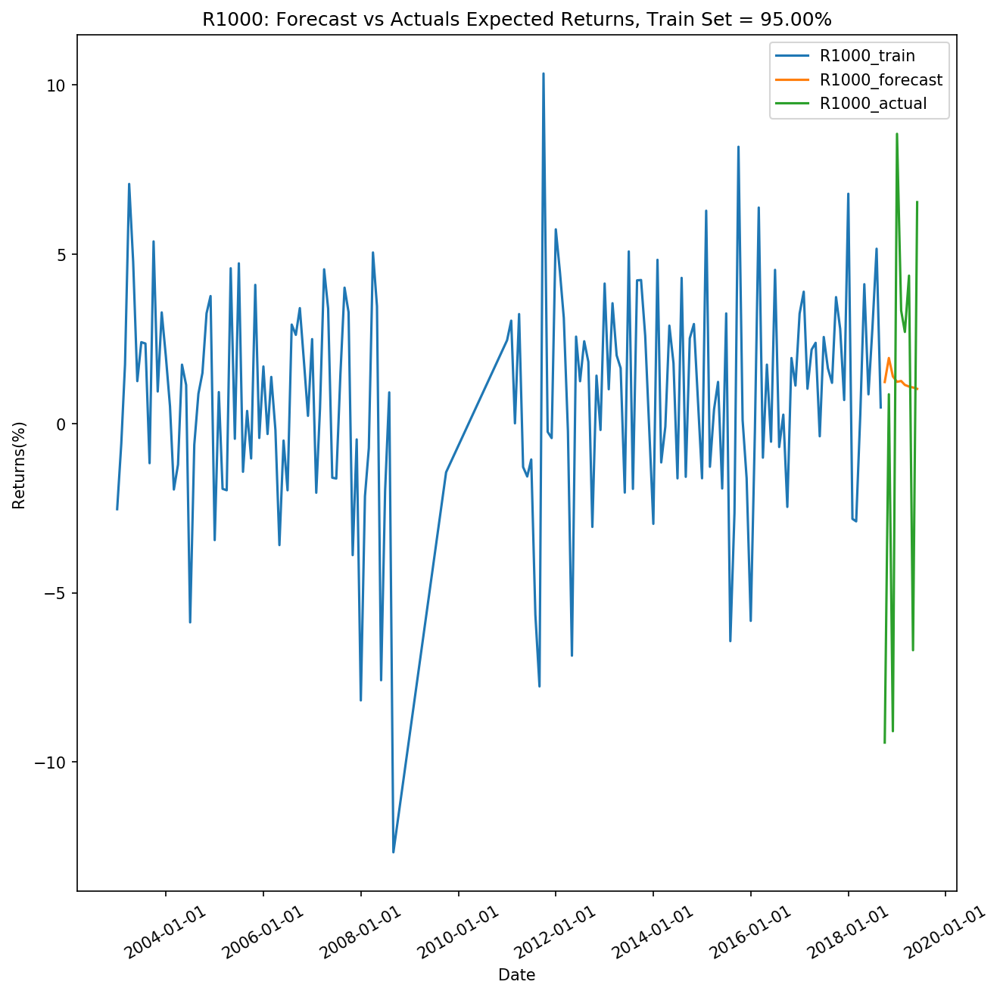

Forecast Accuracy of: R1000
mape   :  0.9261
me     :  1.1334
mae    :  5.5236
mpe    :  -0.6502
rmse   :  6.5493
corr   :  -0.1212


In [68]:
[causation_matrix,index_remove,merge2_tested_R1000] = causation_test(merge2_differenced,1,5)
causation_matrix
index_remove
merge2_tested_R1000

# Train Set = 95%
[model2_fitted_R1000,df2_R1000,df2_train_R1000,df2_test_R1000,date1] = VAR_Model(merge2_tested_R1000,1,5,0.05)
[df2_forecast_R1000,lag_order2_R1000] = forecast_plot(model2_fitted_R1000,df2_R1000,df2_train_R1000,df2_test_R1000,date1,95)

print('Forecast Accuracy of: R1000')
accuracy_prod = forecast_accuracy(df2_forecast_R1000['R1000_forecast'].values, df2_test_R1000['R1000'])

for k, v in accuracy_prod.items():
    print(adjust(k), ': ', round(v,4)) 

  Summary of Regression Results   
Model:                         VAR
Method:                        OLS
Date:           Fri, 30, Aug, 2019
Time:                     10:58:46
--------------------------------------------------------------------
No. of Equations:         5.00000    BIC:                   -14.5729
Nobs:                     151.000    HQIC:                  -15.2255
Log likelihood:           166.933    FPE:                1.56431e-07
AIC:                     -15.6719    Det(Omega_mle):     1.10061e-07
--------------------------------------------------------------------
Results for equation R1000
                       coefficient       std. error           t-stat            prob
------------------------------------------------------------------------------------
const                     0.999026         0.291590            3.426           0.001
L1.R1000                 -0.101258         0.085695           -1.182           0.237
L1.PAYEMS                -0.894323         7

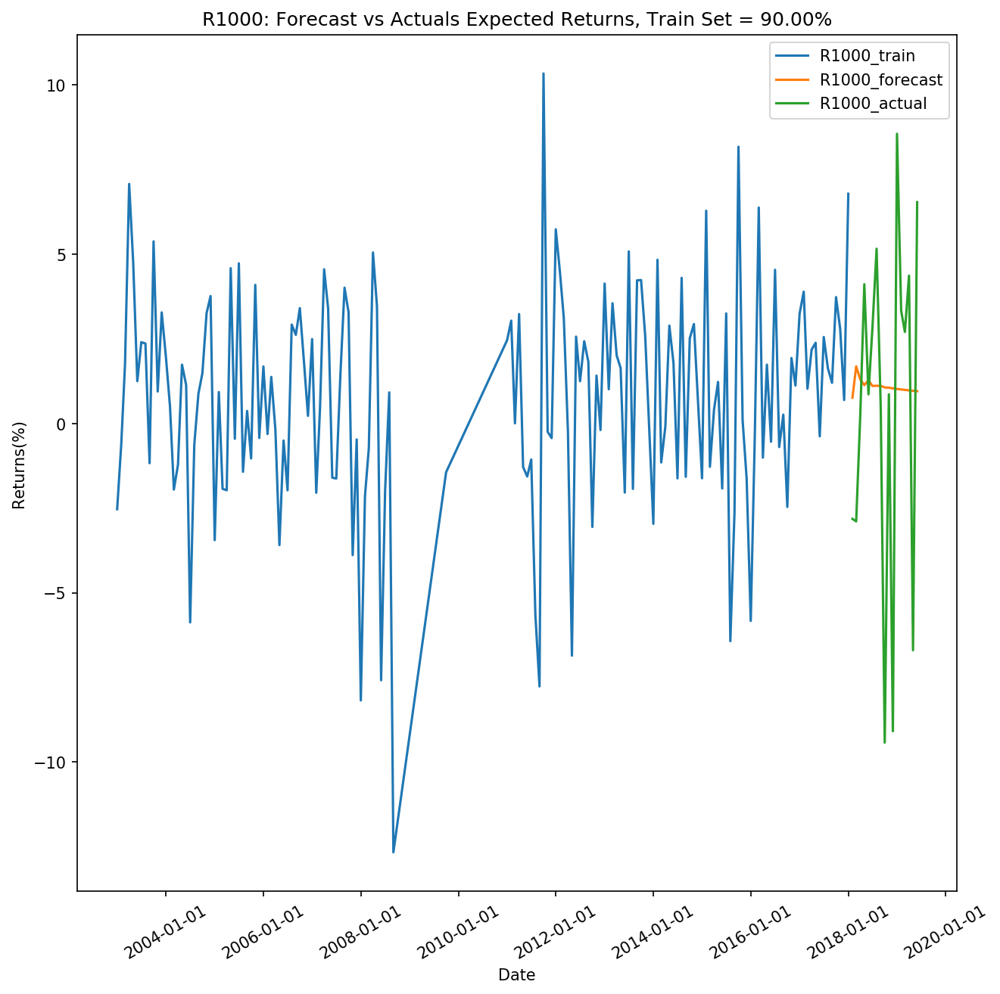

Forecast Accuracy of: R1000
mape   :  1.0513
me     :  0.5524
mae    :  4.0005
mpe    :  -0.3823
rmse   :  5.1032
corr   :  -0.0774


In [69]:
# Train Set = 90%
[model2_fitted_R1000,df2_R1000,df2_train_R1000,df2_test_R1000,date1] = VAR_Model(merge2_tested_R1000,1,5,0.1)
[df2_forecast_R1000,lag_order2_R1000] = forecast_plot(model2_fitted_R1000,df2_R1000,df2_train_R1000,df2_test_R1000,date1,90)

print('Forecast Accuracy of: R1000')
accuracy_prod = forecast_accuracy(df2_forecast_R1000['R1000_forecast'].values, df2_test_R1000['R1000'])

for k, v in accuracy_prod.items():
    print(adjust(k), ': ', round(v,4)) 

  Summary of Regression Results   
Model:                         VAR
Method:                        OLS
Date:           Fri, 30, Aug, 2019
Time:                     10:59:01
--------------------------------------------------------------------
No. of Equations:         5.00000    BIC:                   -14.2036
Nobs:                     134.000    HQIC:                  -14.9097
Log likelihood:           135.642    FPE:                2.06877e-07
AIC:                     -15.3930    Det(Omega_mle):     1.39443e-07
--------------------------------------------------------------------
Results for equation R1000
                       coefficient       std. error           t-stat            prob
------------------------------------------------------------------------------------
const                     0.975112         0.353040            2.762           0.006
L1.R1000                 -0.096779         0.090593           -1.068           0.285
L1.PAYEMS                -1.355869         8

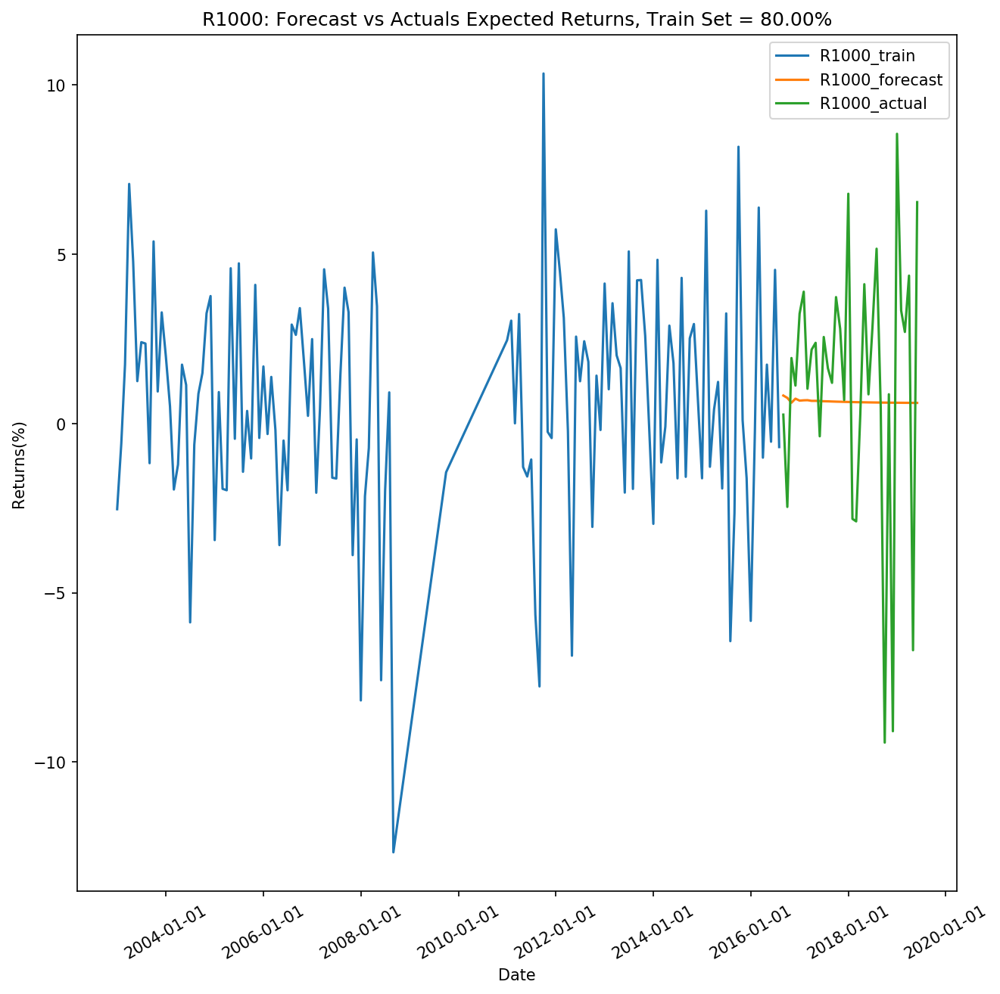

Forecast Accuracy of: R1000
mape   :  0.869
me     :  -0.5811
mae    :  2.8951
mpe    :  -0.6518
rmse   :  3.9386
corr   :  -0.0414


In [70]:
# Train Set = 80%
[model2_fitted_R1000,df2_R1000,df2_train_R1000,df2_test_R1000,date1] = VAR_Model(merge2_tested_R1000,1,5,0.2)
[df2_forecast_R1000,lag_order2_R1000] = forecast_plot(model2_fitted_R1000,df2_R1000,df2_train_R1000,df2_test_R1000,date1,80)

print('Forecast Accuracy of: R1000')
accuracy_prod = forecast_accuracy(df2_forecast_R1000['R1000_forecast'].values, df2_test_R1000['R1000'])

for k, v in accuracy_prod.items():
    print(adjust(k), ': ', round(v,4)) 

  Summary of Regression Results   
Model:                         VAR
Method:                        OLS
Date:           Fri, 30, Aug, 2019
Time:                     10:59:14
--------------------------------------------------------------------
No. of Equations:         5.00000    BIC:                   -13.8295
Nobs:                     117.000    HQIC:                  -14.6008
Log likelihood:           109.905    FPE:                2.69918e-07
AIC:                     -15.1279    Det(Omega_mle):     1.72231e-07
--------------------------------------------------------------------
Results for equation R1000
                       coefficient       std. error           t-stat            prob
------------------------------------------------------------------------------------
const                     0.832536         0.361106            2.306           0.021
L1.R1000                 -0.072540         0.097721           -0.742           0.458
L1.PAYEMS                 2.277203         8

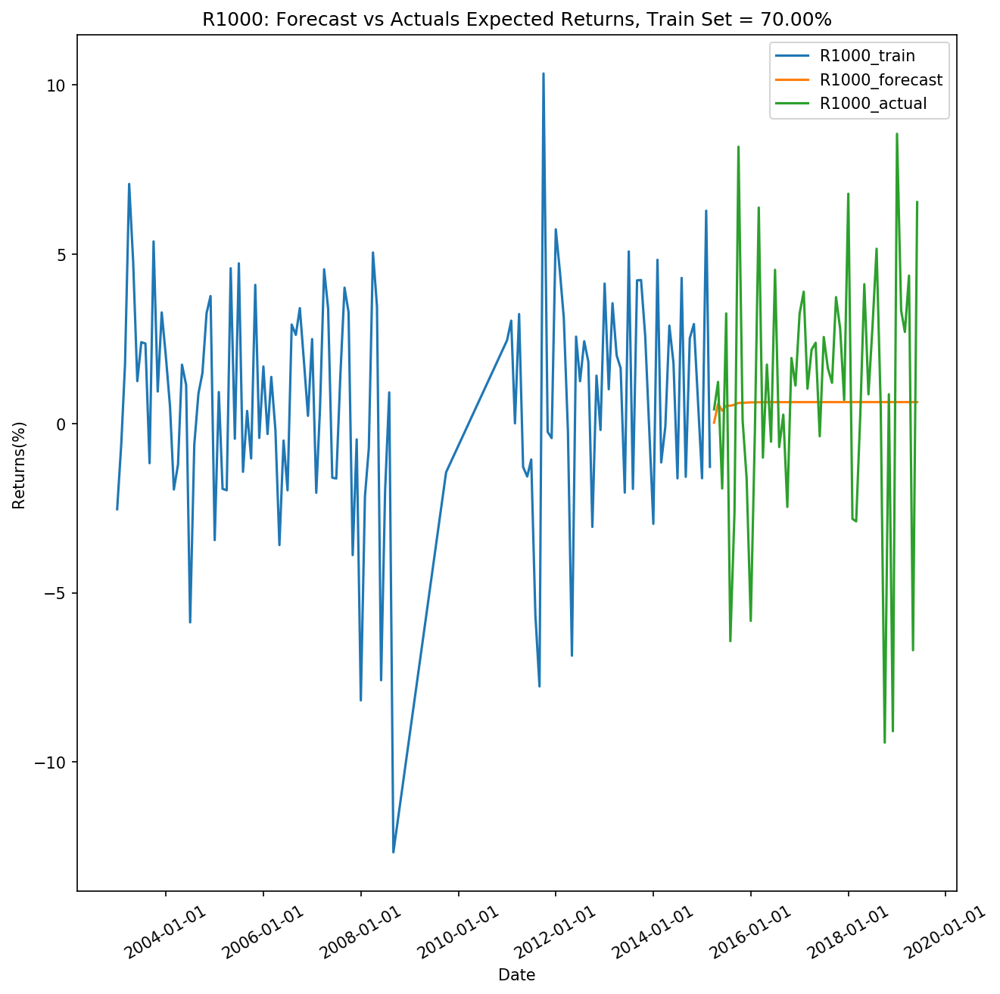

Forecast Accuracy of: R1000
mape   :  1.0802
me     :  -0.3086
mae    :  2.8851
mpe    :  -0.7593
rmse   :  3.8591
corr   :  0.0968


In [71]:
# Train Set = 70%
[model2_fitted_R1000,df2_R1000,df2_train_R1000,df2_test_R1000,date1] = VAR_Model(merge2_tested_R1000,1,5,0.3)
[df2_forecast_R1000,lag_order2_R1000] = forecast_plot(model2_fitted_R1000,df2_R1000,df2_train_R1000,df2_test_R1000,date1,70)

print('Forecast Accuracy of: R1000')
accuracy_prod = forecast_accuracy(df2_forecast_R1000['R1000_forecast'].values, df2_test_R1000['R1000'])

for k, v in accuracy_prod.items():
    print(adjust(k), ': ', round(v,4)) 

#### 2.2.3 Forecast the returns for R1000G

       R1000G    PAYEMS   DSPIC96    INDPRO  CMRMTSPL       PCE     RRSFS  \
0   -2.581405  0.099263 -0.139311  0.558220 -0.002108  0.174294  0.071970   
1   -1.760957  0.111199 -0.159950  0.520974 -0.116456  0.097911 -0.172826   
2    0.887685  0.097305 -0.113320  0.346765  0.057536  0.113742 -0.021367   
3    7.636873  0.088249 -0.151563  0.193963 -0.280713 -0.001987 -0.085228   
4    5.372610  0.084787 -0.163442  0.074919  0.109959  0.112097  0.173278   
5    1.166838  0.071424 -0.175391 -0.118949 -0.090921  0.102105  0.071138   
6    1.831130  0.075028  0.099308 -0.090106  0.141358  0.039042 -0.019150   
7    1.850221  0.063512  0.305734 -0.114520 -0.094141  0.137660  0.056270   
8   -1.167637  0.064845  0.137041 -0.120675  0.000218  0.048432  0.057027   
9    5.548351  0.041608 -0.007681 -0.094843  0.340660  0.199771  0.567704   
10   1.027573  0.024424  0.014362 -0.158581 -0.186065  0.144954  0.374132   
11   4.513700  0.039912 -0.012750 -0.080597  0.122652  0.034386  0.113846   

,R1000G_x,PAYEMS_x,DSPIC96_x,INDPRO_x,CMRMTSPL_x,PCE_x,RRSFS_x,S423SMM144SCEN_x,PPIACO_x
R1000G_y,1.0000,0.0013,0.3625,0.0045,0.0026,0.5090,0.1064,0.0080,0.2139
PAYEMS_y,0.0104,1.0000,0.0217,0.0000,0.0000,0.0120,0.0000,0.1718,0.0000
DSPIC96_y,0.3487,0.5315,1.0000,0.3095,0.0041,0.0001,0.0074,0.0140,0.0013
INDPRO_y,0.0004,0.0081,0.0520,1.0000,0.0009,0.1867,0.0123,0.0282,0.0552
CMRMTSPL_y,0.0034,0.0002,0.0029,0.0094,1.0000,0.0056,0.0018,0.2882,0.0036
PCE_y,0.1419,0.4057,0.0000,0.0000,0.0234,1.0000,0.0316,0.0128,0.0312
RRSFS_y,0.0819,0.2679,0.0020,0.0919,0.0148,0.0005,1.0000,0.0564,0.0000
S423SMM144SCEN_y,0.0178,0.0007,0.0022,0.0000,0.0525,0.0028,0.0020,1.0000,0.1973
PPIACO_y,0.0345,0.0000,0.0271,0.0005,0.0002,0.0017,0.0012,0.3335,1.0000


[6, 9, 10, 12]

,Date,R1000,R1000G,R1000V,SP500,PAYEMS,INDPRO,CMRMTSPL,S423SMM144SCEN
0,2003-01-01,-2.530097,-2.581405,-2.636353,-2.779749,0.099263,0.558220,-0.002108,-0.013627
1,2003-02-01,-0.593941,-1.760957,-2.971919,-1.714984,0.111199,0.520974,-0.116456,-0.335293
2,2003-03-01,1.749153,0.887685,-0.025528,0.832287,0.097305,0.346765,0.057536,0.299998
3,2003-04-01,7.076132,7.636873,8.234498,7.792735,0.088249,0.193963,-0.280713,-0.376923
4,2003-05-01,4.777050,5.372610,5.996177,4.964567,0.084787,0.074919,0.109959,-0.118482
5,2003-06-01,1.251348,1.166838,1.079230,1.125863,0.071424,-0.118949,-0.090921,-0.161248
6,2003-07-01,2.402049,1.831130,1.248816,1.609351,0.075028,-0.090106,0.141358,0.220724
7,2003-08-01,2.361945,1.850221,1.320796,1.771534,0.063512,-0.114520,-0.094141,-0.175236
8,2003-09-01,-1.171651,-1.167637,-1.163576,-1.201623,0.064845,-0.120675,0.000218,0.106825
9,2003-10-01,5.379164,5.548351,5.724132,5.350427,0.041608,-0.094843,0.340660,0.190616


  Summary of Regression Results   
Model:                         VAR
Method:                        OLS
Date:           Fri, 30, Aug, 2019
Time:                     10:59:37
--------------------------------------------------------------------
No. of Equations:         5.00000    BIC:                   -14.8017
Nobs:                     159.000    HQIC:                  -15.4321
Log likelihood:           188.070    FPE:                1.29173e-07
AIC:                     -15.8632    Det(Omega_mle):     9.24512e-08
--------------------------------------------------------------------
Results for equation R1000G
                       coefficient       std. error           t-stat            prob
------------------------------------------------------------------------------------
const                     0.811638         0.264444            3.069           0.002
L1.R1000G                -0.050943         0.081724           -0.623           0.533
L1.PAYEMS                 1.425811         

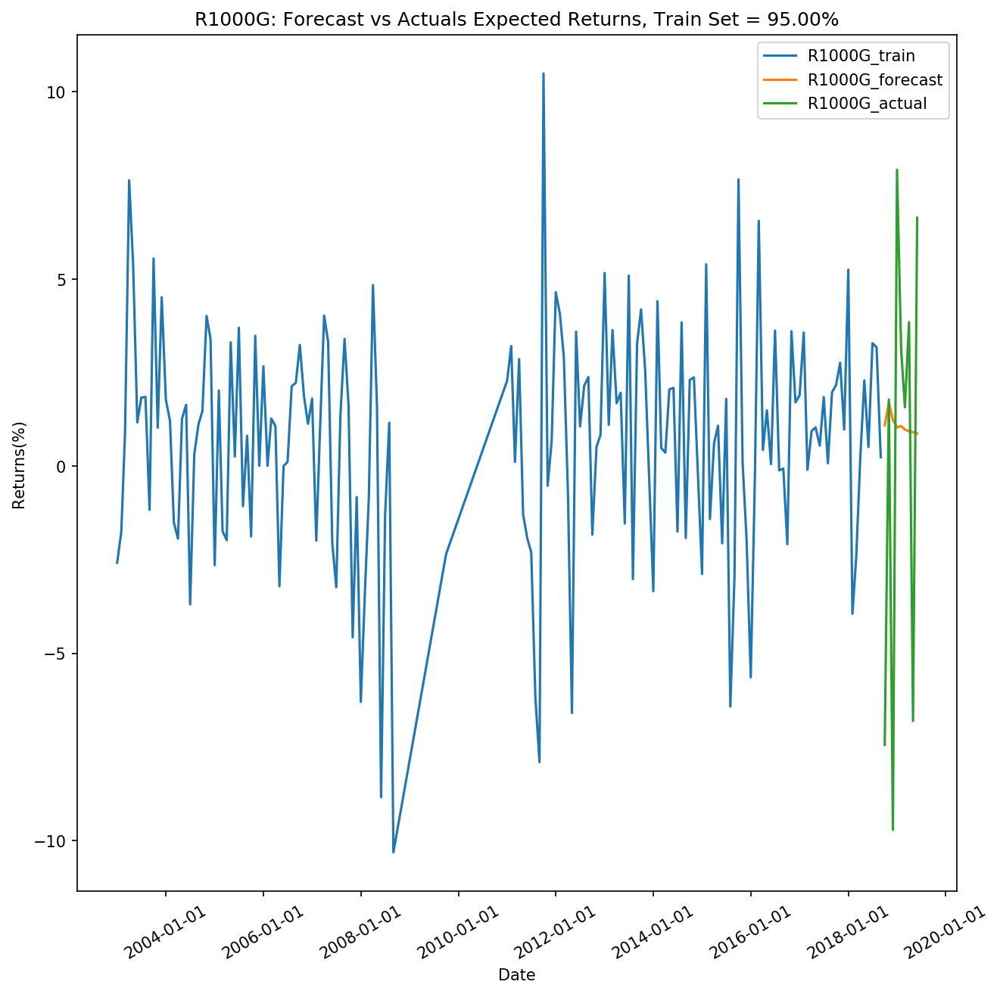

Forecast Accuracy of: R1000G
mape   :  0.7753
me     :  0.9918
mae    :  5.0545
mpe    :  -0.7753
rmse   :  6.2015
corr   :  -0.135


In [72]:
[causation_matrix,index_remove,merge2_tested_R1000G] = causation_test(merge2_differenced,2,5)
causation_matrix
index_remove
merge2_tested_R1000G

# Train Set = 95%
[model2_fitted_R1000G,df2_R1000G,df2_train_R1000G,df2_test_R1000G,date1] = VAR_Model(merge2_tested_R1000G,2,5,0.05)
[df2_forecast_R1000G,lag_order2_R1000G] = forecast_plot(model2_fitted_R1000G,df2_R1000G,df2_train_R1000G,df2_test_R1000G,date1,95)

print('Forecast Accuracy of: R1000G')
accuracy_prod = forecast_accuracy(df2_forecast_R1000G['R1000G_forecast'].values, df2_test_R1000G['R1000G'])

for k, v in accuracy_prod.items():
    print(adjust(k), ': ', round(v,4)) 

  Summary of Regression Results   
Model:                         VAR
Method:                        OLS
Date:           Fri, 30, Aug, 2019
Time:                     11:01:31
--------------------------------------------------------------------
No. of Equations:         5.00000    BIC:                   -14.1441
Nobs:                     150.000    HQIC:                  -15.0974
Log likelihood:           197.027    FPE:                1.45125e-07
AIC:                     -15.7497    Det(Omega_mle):     8.74295e-08
--------------------------------------------------------------------
Results for equation R1000G
                       coefficient       std. error           t-stat            prob
------------------------------------------------------------------------------------
const                     0.894759         0.290459            3.080           0.002
L1.R1000G                -0.076433         0.087110           -0.877           0.380
L1.PAYEMS                -2.726666         

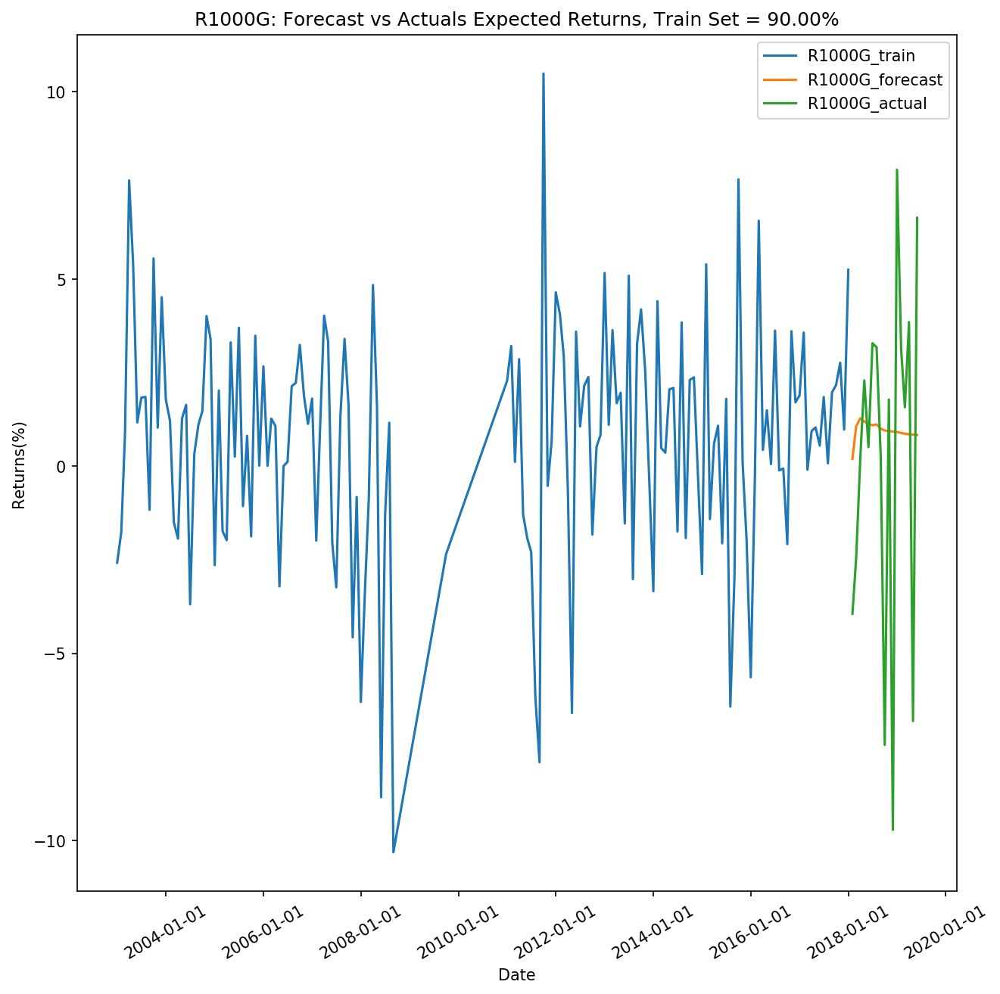

Forecast Accuracy of: R1000G
mape   :  1.2182
me     :  0.6959
mae    :  3.6304
mpe    :  -0.1703
rmse   :  4.742
corr   :  0.1947


In [73]:
# Train Set = 90%
[model2_fitted_R1000G,df2_R1000G,df2_train_R1000G,df2_test_R1000G,date1] = VAR_Model(merge2_tested_R1000G,2,5,0.1)
[df2_forecast_R1000G,lag_order2_R1000G] = forecast_plot(model2_fitted_R1000G,df2_R1000G,df2_train_R1000G,df2_test_R1000G,date1,90)

print('Forecast Accuracy of: R1000G')
accuracy_prod = forecast_accuracy(df2_forecast_R1000G['R1000G_forecast'].values, df2_test_R1000G['R1000G'])

for k, v in accuracy_prod.items():
    print(adjust(k), ': ', round(v,4)) 

  Summary of Regression Results   
Model:                         VAR
Method:                        OLS
Date:           Fri, 30, Aug, 2019
Time:                     11:01:44
--------------------------------------------------------------------
No. of Equations:         5.00000    BIC:                   -14.2617
Nobs:                     134.000    HQIC:                  -14.9678
Log likelihood:           139.538    FPE:                1.95188e-07
AIC:                     -15.4512    Det(Omega_mle):     1.31564e-07
--------------------------------------------------------------------
Results for equation R1000G
                       coefficient       std. error           t-stat            prob
------------------------------------------------------------------------------------
const                     0.926493         0.336596            2.753           0.006
L1.R1000G                -0.057586         0.089720           -0.642           0.521
L1.PAYEMS                -0.600216         

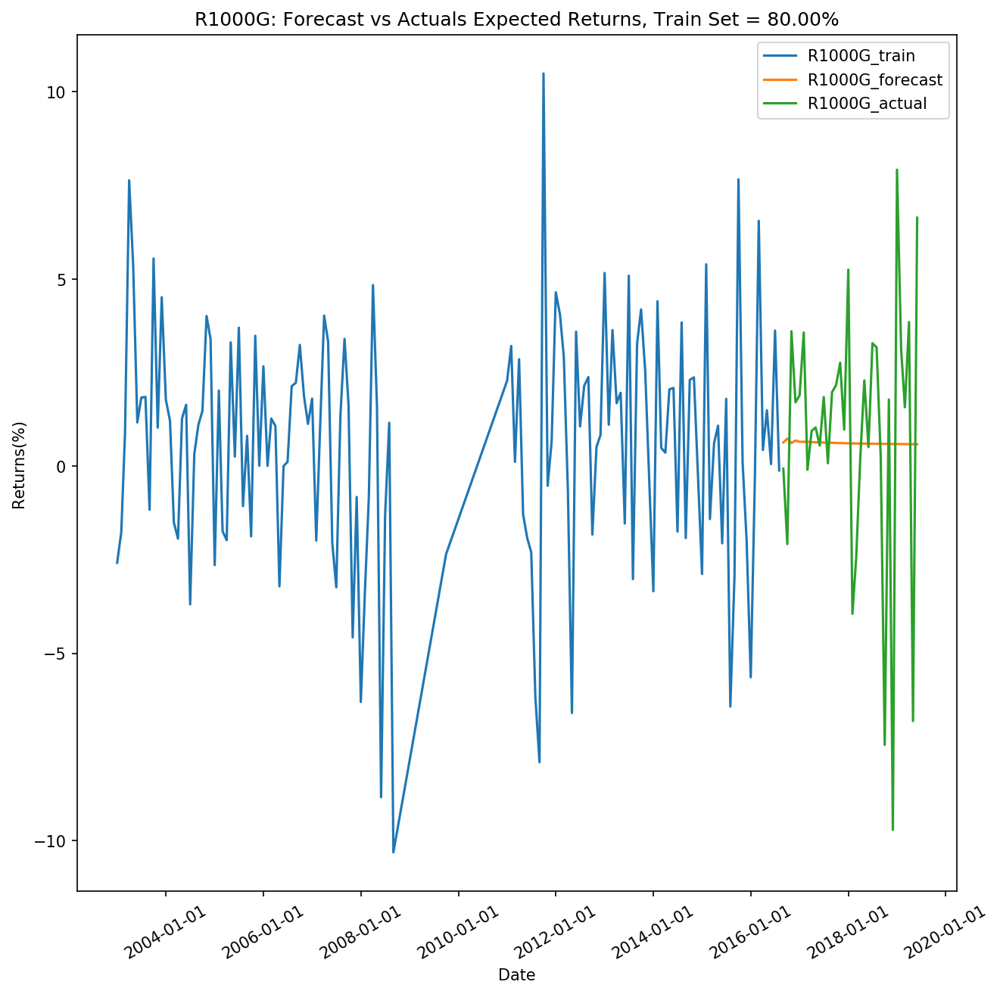

Forecast Accuracy of: R1000G
mape   :  1.4909
me     :  -0.2744
mae    :  2.5736
mpe    :  -0.8633
rmse   :  3.614
corr   :  -0.0274


In [74]:
# Train Set = 80%
[model2_fitted_R1000G,df2_R1000G,df2_train_R1000G,df2_test_R1000G,date1] = VAR_Model(merge2_tested_R1000G,2,5,0.2)
[df2_forecast_R1000G,lag_order2_R1000G] = forecast_plot(model2_fitted_R1000G,df2_R1000G,df2_train_R1000G,df2_test_R1000G,date1,80)

print('Forecast Accuracy of: R1000G')
accuracy_prod = forecast_accuracy(df2_forecast_R1000G['R1000G_forecast'].values, df2_test_R1000G['R1000G'])

for k, v in accuracy_prod.items():
    print(adjust(k), ': ', round(v,4)) 

  Summary of Regression Results   
Model:                         VAR
Method:                        OLS
Date:           Fri, 30, Aug, 2019
Time:                     11:01:54
--------------------------------------------------------------------
No. of Equations:         5.00000    BIC:                   -13.8837
Nobs:                     117.000    HQIC:                  -14.6550
Log likelihood:           113.079    FPE:                2.55664e-07
AIC:                     -15.1822    Det(Omega_mle):     1.63136e-07
--------------------------------------------------------------------
Results for equation R1000G
                       coefficient       std. error           t-stat            prob
------------------------------------------------------------------------------------
const                     0.795682         0.343918            2.314           0.021
L1.R1000G                -0.055935         0.096777           -0.578           0.563
L1.PAYEMS                 2.727353         

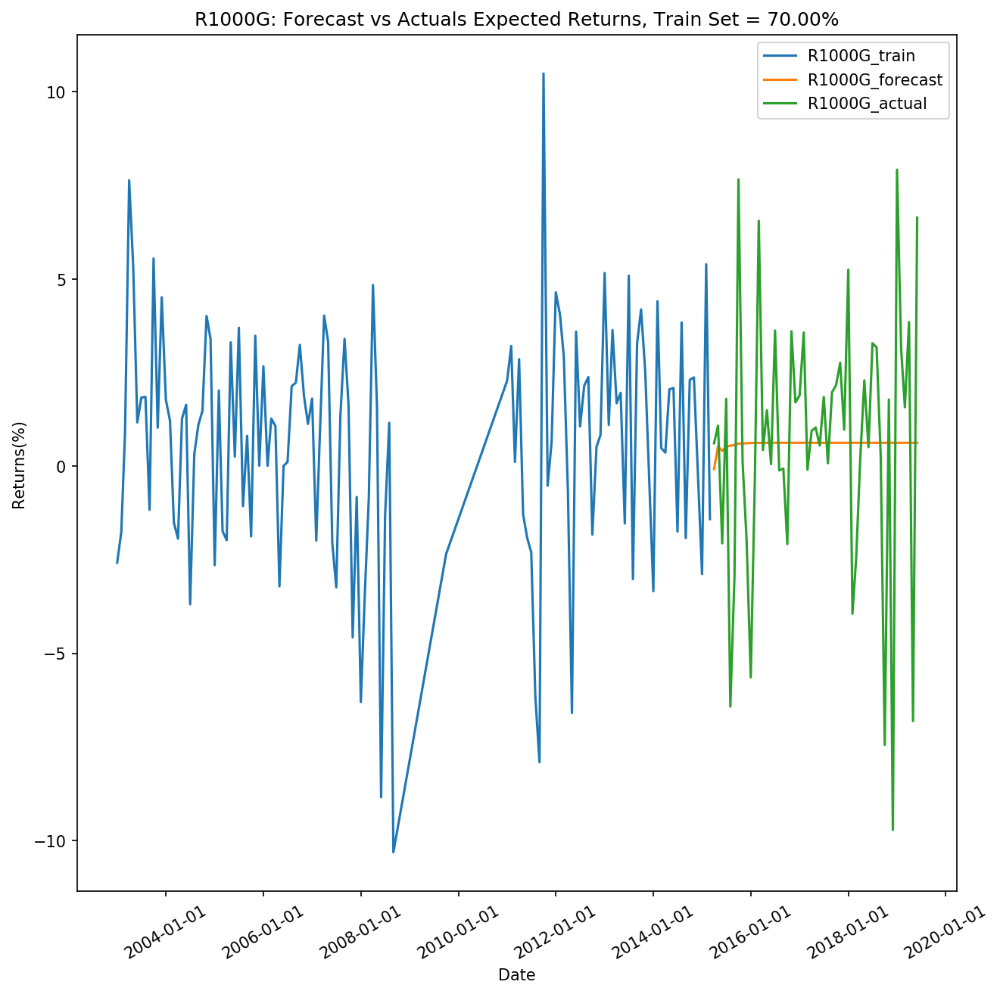

Forecast Accuracy of: R1000G
mape   :  1.7216
me     :  -0.0733
mae    :  2.5784
mpe    :  -0.6515
rmse   :  3.5865
corr   :  0.0623


In [75]:
# Train Set = 70%
[model2_fitted_R1000G,df2_R1000G,df2_train_R1000G,df2_test_R1000G,date1] = VAR_Model(merge2_tested_R1000G,2,5,0.3)
[df2_forecast_R1000G,lag_order2_R1000G] = forecast_plot(model2_fitted_R1000G,df2_R1000G,df2_train_R1000G,df2_test_R1000G,date1,70)

print('Forecast Accuracy of: R1000G')
accuracy_prod = forecast_accuracy(df2_forecast_R1000G['R1000G_forecast'].values, df2_test_R1000G['R1000G'])

for k, v in accuracy_prod.items():
    print(adjust(k), ': ', round(v,4)) 

#### 2.2.4 Forecast the returns for R1000V

        R1000V    PAYEMS   DSPIC96    INDPRO  CMRMTSPL       PCE     RRSFS  \
0    -2.636353  0.099263 -0.139311  0.558220 -0.002108  0.174294  0.071970   
1    -2.971919  0.111199 -0.159950  0.520974 -0.116456  0.097911 -0.172826   
2    -0.025528  0.097305 -0.113320  0.346765  0.057536  0.113742 -0.021367   
3     8.234498  0.088249 -0.151563  0.193963 -0.280713 -0.001987 -0.085228   
4     5.996177  0.084787 -0.163442  0.074919  0.109959  0.112097  0.173278   
5     1.079230  0.071424 -0.175391 -0.118949 -0.090921  0.102105  0.071138   
6     1.248816  0.075028  0.099308 -0.090106  0.141358  0.039042 -0.019150   
7     1.320796  0.063512  0.305734 -0.114520 -0.094141  0.137660  0.056270   
8    -1.163576  0.064845  0.137041 -0.120675  0.000218  0.048432  0.057027   
9     5.724132  0.041608 -0.007681 -0.094843  0.340660  0.199771  0.567704   
10    1.113868  0.024424  0.014362 -0.158581 -0.186065  0.144954  0.374132   
11    5.770335  0.039912 -0.012750 -0.080597  0.122652  0.034386

,R1000V_x,PAYEMS_x,DSPIC96_x,INDPRO_x,CMRMTSPL_x,PCE_x,RRSFS_x,S423SMM144SCEN_x,PPIACO_x
R1000V_y,1.0000,0.0001,0.4309,0.0095,0.0055,0.6795,0.1884,0.0152,0.2308
PAYEMS_y,0.0825,1.0000,0.0217,0.0000,0.0000,0.0120,0.0000,0.1718,0.0000
DSPIC96_y,0.3674,0.5315,1.0000,0.3095,0.0041,0.0001,0.0074,0.0140,0.0013
INDPRO_y,0.0015,0.0081,0.0520,1.0000,0.0009,0.1867,0.0123,0.0282,0.0552
CMRMTSPL_y,0.0192,0.0002,0.0029,0.0094,1.0000,0.0056,0.0018,0.2882,0.0036
PCE_y,0.2569,0.4057,0.0000,0.0000,0.0234,1.0000,0.0316,0.0128,0.0312
RRSFS_y,0.0992,0.2679,0.0020,0.0919,0.0148,0.0005,1.0000,0.0564,0.0000
S423SMM144SCEN_y,0.0484,0.0007,0.0022,0.0000,0.0525,0.0028,0.0020,1.0000,0.1973
PPIACO_y,0.0675,0.0000,0.0271,0.0005,0.0002,0.0017,0.0012,0.3335,1.0000


[6, 9, 10, 12]

,Date,R1000,R1000G,R1000V,SP500,PAYEMS,INDPRO,CMRMTSPL,S423SMM144SCEN
0,2003-01-01,-2.530097,-2.581405,-2.636353,-2.779749,0.099263,0.558220,-0.002108,-0.013627
1,2003-02-01,-0.593941,-1.760957,-2.971919,-1.714984,0.111199,0.520974,-0.116456,-0.335293
2,2003-03-01,1.749153,0.887685,-0.025528,0.832287,0.097305,0.346765,0.057536,0.299998
3,2003-04-01,7.076132,7.636873,8.234498,7.792735,0.088249,0.193963,-0.280713,-0.376923
4,2003-05-01,4.777050,5.372610,5.996177,4.964567,0.084787,0.074919,0.109959,-0.118482
5,2003-06-01,1.251348,1.166838,1.079230,1.125863,0.071424,-0.118949,-0.090921,-0.161248
6,2003-07-01,2.402049,1.831130,1.248816,1.609351,0.075028,-0.090106,0.141358,0.220724
7,2003-08-01,2.361945,1.850221,1.320796,1.771534,0.063512,-0.114520,-0.094141,-0.175236
8,2003-09-01,-1.171651,-1.167637,-1.163576,-1.201623,0.064845,-0.120675,0.000218,0.106825
9,2003-10-01,5.379164,5.548351,5.724132,5.350427,0.041608,-0.094843,0.340660,0.190616


  Summary of Regression Results   
Model:                         VAR
Method:                        OLS
Date:           Fri, 30, Aug, 2019
Time:                     11:02:16
--------------------------------------------------------------------
No. of Equations:         5.00000    BIC:                   -14.2620
Nobs:                     158.000    HQIC:                  -15.1829
Log likelihood:           208.239    FPE:                1.36194e-07
AIC:                     -15.8127    Det(Omega_mle):     8.40808e-08
--------------------------------------------------------------------
Results for equation R1000V
                       coefficient       std. error           t-stat            prob
------------------------------------------------------------------------------------
const                     0.645075         0.272849            2.364           0.018
L1.R1000V                -0.011229         0.083041           -0.135           0.892
L1.PAYEMS                -2.228638         

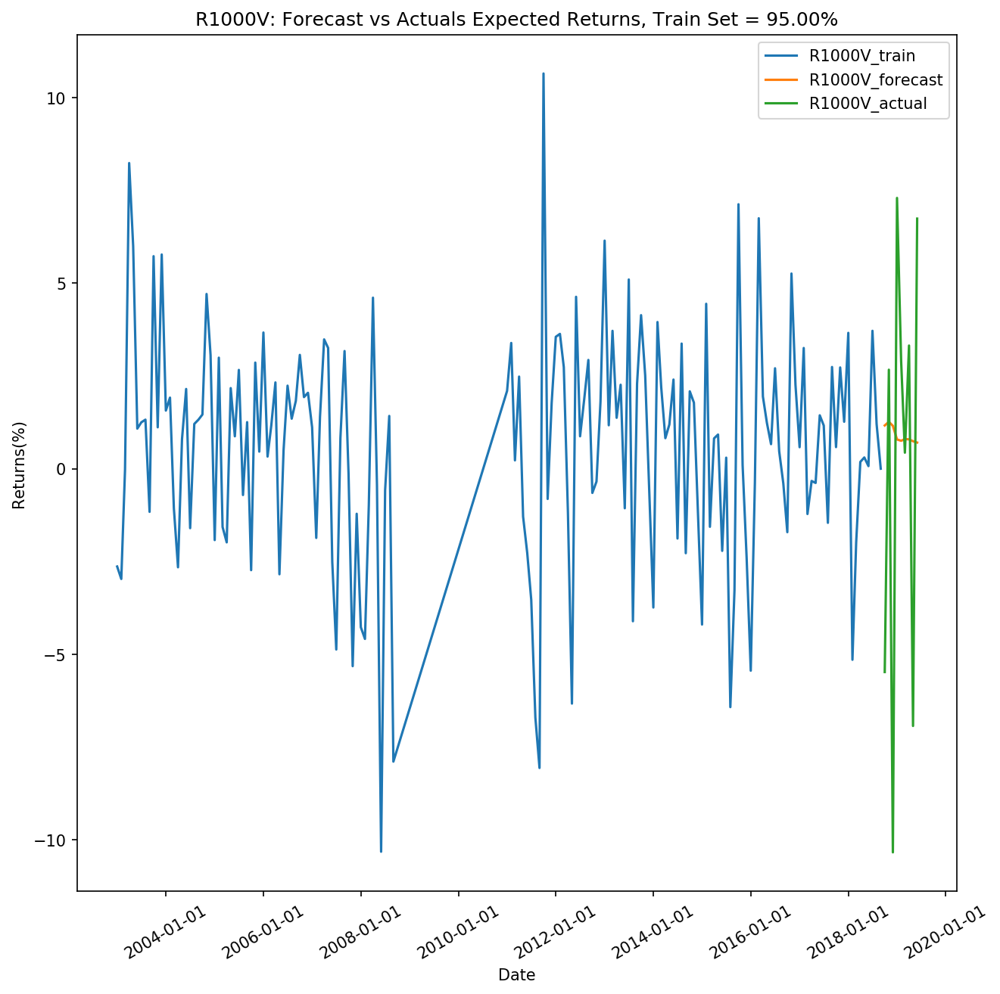

Forecast Accuracy of: R1000V
mape   :  0.9004
me     :  0.8403
mae    :  4.976
mpe    :  -0.71
rmse   :  6.0261
corr   :  -0.4537


In [76]:
[causation_matrix,index_remove,merge2_tested_R1000V] = causation_test(merge2_differenced,3,5)
causation_matrix
index_remove
merge2_tested_R1000V

# Train Set = 95%
[model2_fitted_R1000V,df2_R1000V,df2_train_R1000V,df2_test_R1000V,date1] = VAR_Model(merge2_tested_R1000V,3,5,0.05)
[df2_forecast_R1000V,lag_order2_R1000V] = forecast_plot(model2_fitted_R1000V,df2_R1000V,df2_train_R1000V,df2_test_R1000V,date1,95)

print('Forecast Accuracy of: R1000V')
accuracy_prod = forecast_accuracy(df2_forecast_R1000V['R1000V_forecast'].values, df2_test_R1000V['R1000V'])

for k, v in accuracy_prod.items():
    print(adjust(k), ': ', round(v,4)) 

  Summary of Regression Results   
Model:                         VAR
Method:                        OLS
Date:           Fri, 30, Aug, 2019
Time:                     11:02:34
--------------------------------------------------------------------
No. of Equations:         5.00000    BIC:                   -14.0837
Nobs:                     150.000    HQIC:                  -15.0370
Log likelihood:           192.499    FPE:                1.54157e-07
AIC:                     -15.6894    Det(Omega_mle):     9.28706e-08
--------------------------------------------------------------------
Results for equation R1000V
                       coefficient       std. error           t-stat            prob
------------------------------------------------------------------------------------
const                     0.725969         0.288286            2.518           0.012
L1.R1000V                -0.016128         0.086019           -0.187           0.851
L1.PAYEMS                -1.714044         

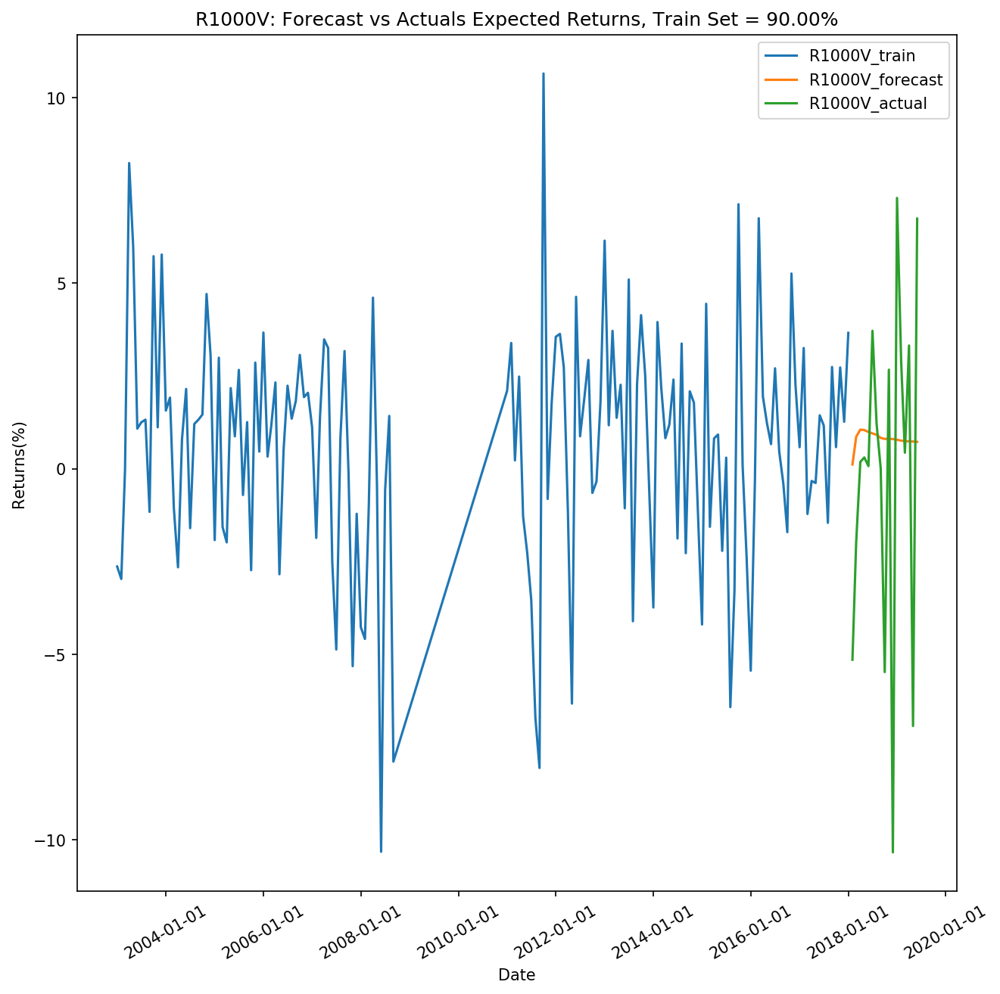

Forecast Accuracy of: R1000V
mape   :  62.7795
me     :  0.8637
mae    :  3.4712
mpe    :  -60.2785
rmse   :  4.6138
corr   :  0.237


In [77]:
# Train Set = 90%
[model2_fitted_R1000V,df2_R1000V,df2_train_R1000V,df2_test_R1000V,date1] = VAR_Model(merge2_tested_R1000V,3,5,0.1)
[df2_forecast_R1000V,lag_order2_R1000V] = forecast_plot(model2_fitted_R1000V,df2_R1000V,df2_train_R1000V,df2_test_R1000V,date1,90)

print('Forecast Accuracy of: R1000V')
accuracy_prod = forecast_accuracy(df2_forecast_R1000V['R1000V_forecast'].values, df2_test_R1000V['R1000V'])

for k, v in accuracy_prod.items():
    print(adjust(k), ': ', round(v,4)) 

  Summary of Regression Results   
Model:                         VAR
Method:                        OLS
Date:           Fri, 30, Aug, 2019
Time:                     11:02:53
--------------------------------------------------------------------
No. of Equations:         5.00000    BIC:                   -14.2089
Nobs:                     134.000    HQIC:                  -14.9150
Log likelihood:           136.000    FPE:                2.05773e-07
AIC:                     -15.3983    Det(Omega_mle):     1.38698e-07
--------------------------------------------------------------------
Results for equation R1000V
                       coefficient       std. error           t-stat            prob
------------------------------------------------------------------------------------
const                     0.851763         0.338881            2.513           0.012
L1.R1000V                 0.004165         0.088884            0.047           0.963
L1.PAYEMS                 0.052902         

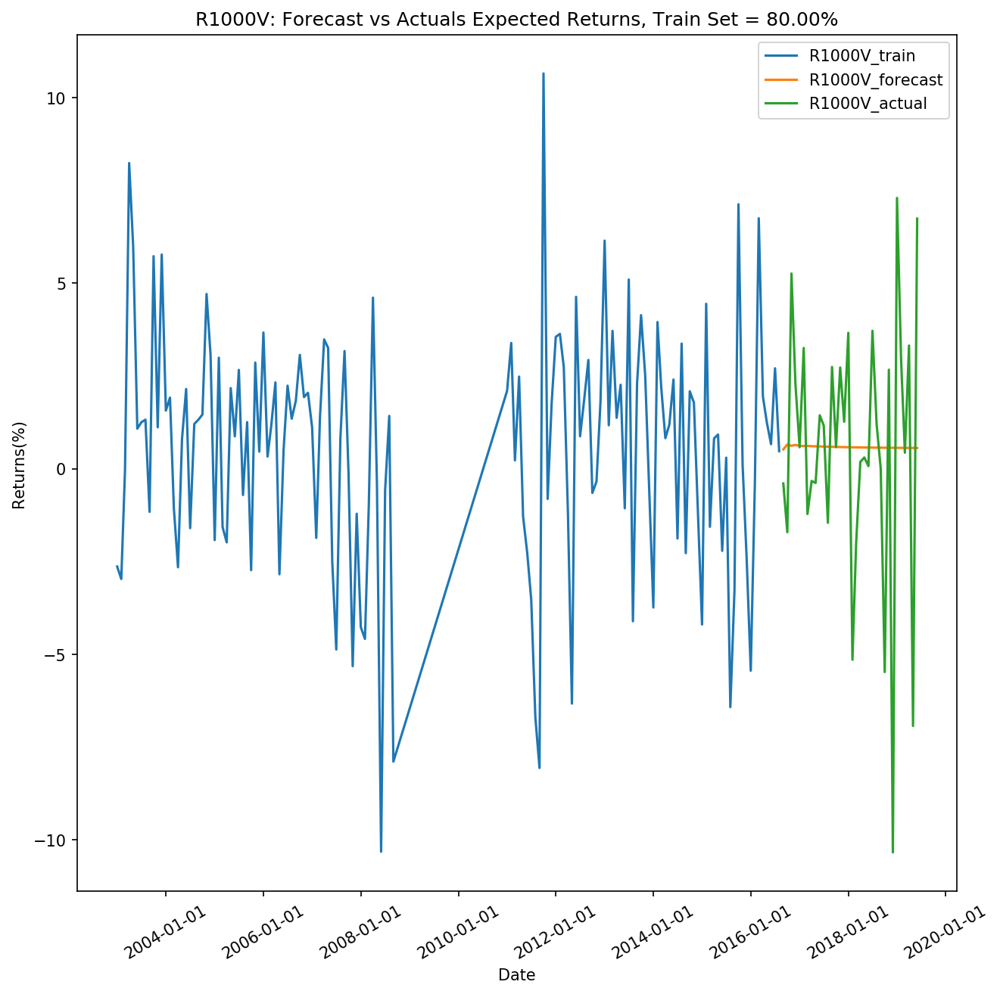

Forecast Accuracy of: R1000V
mape   :  21.9495
me     :  0.0422
mae    :  2.5281
mpe    :  -21.3234
rmse   :  3.5564
corr   :  0.0773


In [78]:
# Train Set = 80%
[model2_fitted_R1000V,df2_R1000V,df2_train_R1000V,df2_test_R1000V,date1] = VAR_Model(merge2_tested_R1000V,3,5,0.2)
[df2_forecast_R1000V,lag_order2_R1000V] = forecast_plot(model2_fitted_R1000V,df2_R1000V,df2_train_R1000V,df2_test_R1000V,date1,80)

print('Forecast Accuracy of: R1000V')
accuracy_prod = forecast_accuracy(df2_forecast_R1000V['R1000V_forecast'].values, df2_test_R1000V['R1000V'])

for k, v in accuracy_prod.items():
    print(adjust(k), ': ', round(v,4)) 

  Summary of Regression Results   
Model:                         VAR
Method:                        OLS
Date:           Fri, 30, Aug, 2019
Time:                     11:03:02
--------------------------------------------------------------------
No. of Equations:         5.00000    BIC:                   -13.8149
Nobs:                     117.000    HQIC:                  -14.5862
Log likelihood:           109.054    FPE:                2.73875e-07
AIC:                     -15.1134    Det(Omega_mle):     1.74756e-07
--------------------------------------------------------------------
Results for equation R1000V
                       coefficient       std. error           t-stat            prob
------------------------------------------------------------------------------------
const                     0.733265         0.347845            2.108           0.035
L1.R1000V                -0.015643         0.095957           -0.163           0.871
L1.PAYEMS                 3.201413         

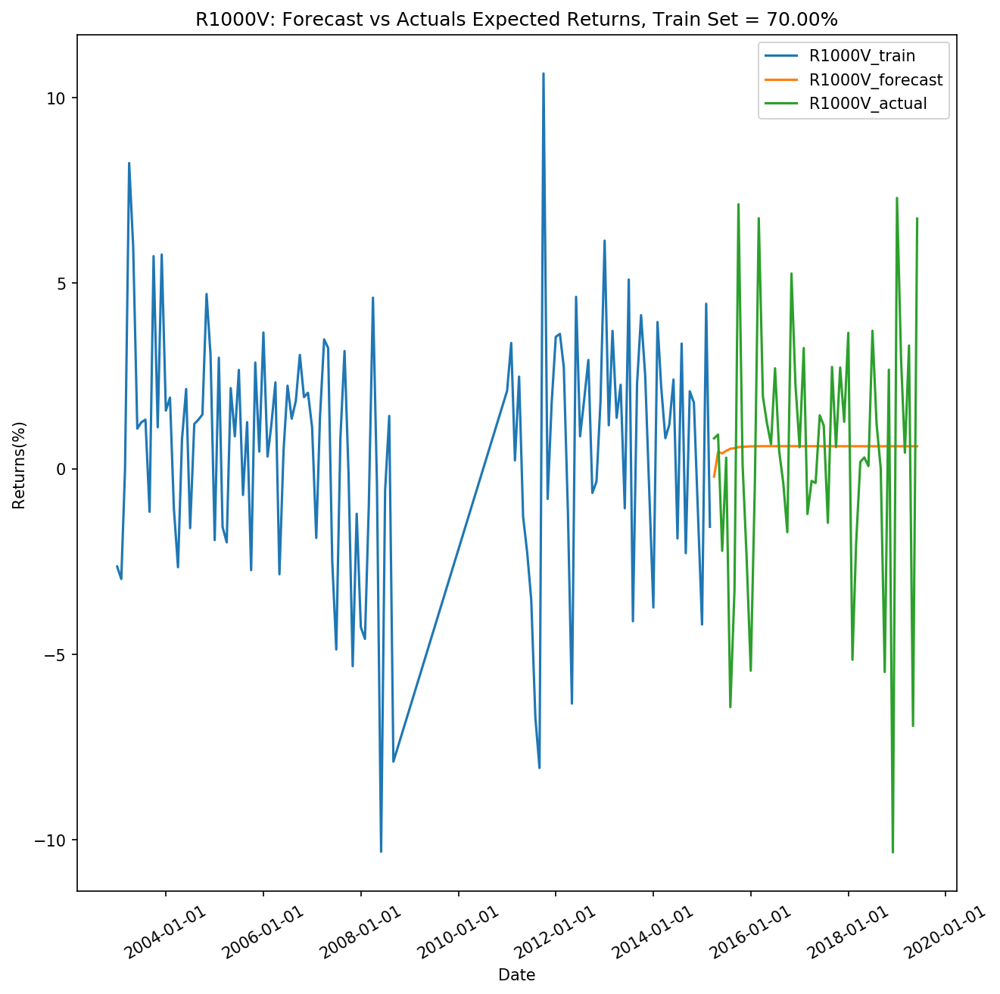

Forecast Accuracy of: R1000V
mape   :  16.0094
me     :  0.1602
mae    :  2.5214
mpe    :  -15.3141
rmse   :  3.5307
corr   :  0.0322


In [79]:
# Train Set = 70%
[model2_fitted_R1000V,df2_R1000V,df2_train_R1000V,df2_test_R1000V,date1] = VAR_Model(merge2_tested_R1000V,3,5,0.3)
[df2_forecast_R1000V,lag_order2_R1000V] = forecast_plot(model2_fitted_R1000V,df2_R1000V,df2_train_R1000V,df2_test_R1000V,date1,70)

print('Forecast Accuracy of: R1000V')
accuracy_prod = forecast_accuracy(df2_forecast_R1000V['R1000V_forecast'].values, df2_test_R1000V['R1000V'])

for k, v in accuracy_prod.items():
    print(adjust(k), ': ', round(v,4)) 

### 2.3 Lagging Indicators

* Gross Domestic Product (A191RP1Q027SBEA)
* Consumer Price Index: Total All Items for the United States (CPALTT01USQ657N)
* Manufacturers: Inventories to Sales Ratio (MNFCTRIRSA)
* Civilian Unemployment Rate (UNRATE)
* Effective Federal Funds Rate (FEDFUNDS)
* Nonfarm Business Sector: Unit Labor Cost (ULCNFB)

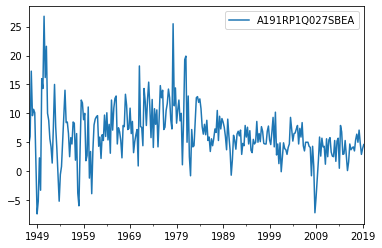

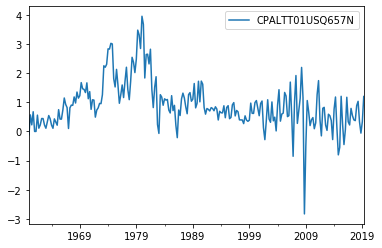

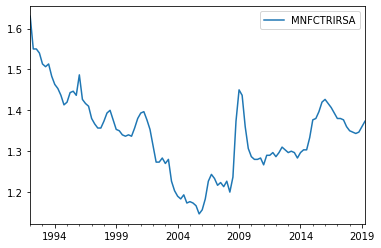

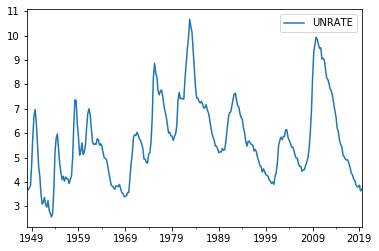

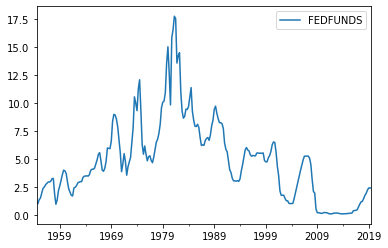

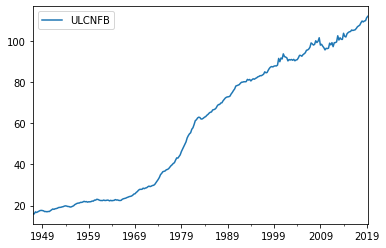

In [87]:
lagging_fred = ['A191RP1Q027SBEA','CPALTT01USQ657N','MNFCTRIRSA','UNRATE','FEDFUNDS','ULCNFB']
lagging_df = {}
for i in range(0,len(lagging_fred)):
    data = fred.get_series(lagging_fred[i]).dropna()
    data_series = pd.DataFrame(data,columns=[lagging_fred[i]])
    data_series = data_series.resample('Q').mean().dropna()
    data_series.plot()
#     data_series
    lagging_df[lagging_fred[i]] = data_series

In [88]:
# Eliminate Seasonality
for i in range(0,len(lagging_fred)):
    lagging_df[lagging_fred[i]] = lagging_df[lagging_fred[i]].diff(periods=4).dropna()

# Merge all Indicators and Indices
merge = lagging_df[lagging_fred[0]]
for i in range(0,len(lagging_fred)-1):
    merge = pd.concat([merge,lagging_df[lagging_fred[i+1]]],join='inner',axis=1)
merge3 = pd.concat([TR_1_Q,merge],join='inner',axis=1)
merge3 = merge3.reset_index()
merge3

,Date,R1000,R1000G,R1000V,SP500,A191RP1Q027SBEA,CPALTT01USQ657N,MNFCTRIRSA,UNRATE,FEDFUNDS,ULCNFB
0,2002-12-31,6.611595,7.332614,8.079621,7.618573,0.5,0.595036,-0.070000,0.366667,-0.690000,-0.823
1,2003-03-31,-1.374886,-3.454677,-5.633799,-3.662446,-0.8,0.654682,-0.043333,0.166667,-0.483333,0.322
2,2003-06-30,13.104530,14.176321,15.309905,13.883164,0.8,-0.722454,0.006667,0.300000,-0.503333,0.090
3,2003-09-30,3.592342,2.513713,1.406037,2.179262,5.6,0.063697,-0.046667,0.400000,-0.723333,-0.367
4,2003-12-31,9.606756,11.089623,12.608335,11.012639,4.3,-0.295709,-0.080000,-0.033333,-0.446667,-0.266
5,2004-03-31,0.542353,1.479184,2.413217,1.276976,1.1,-0.109107,-0.080000,-0.166667,-0.246667,0.276
6,2004-06-30,1.661797,0.971370,0.285172,1.290682,1.8,1.067341,-0.096667,-0.533333,-0.236667,0.736
7,2004-09-30,-5.620782,-2.265713,0.920815,-2.328718,-2.7,-0.137160,-0.033333,-0.700000,0.416667,2.626
8,2004-12-31,8.511727,8.882425,9.223042,8.372823,0.1,0.579689,-0.030000,-0.400000,0.953333,2.204
9,2005-03-31,-4.442505,-2.364169,-0.505210,-2.619157,2.7,-0.273702,-0.013333,-0.400000,1.466667,1.670


In [89]:
# Remove the outlier
merge3_outlier = merge3.iloc[:,5:].copy()
z = np.abs(stats.zscore(merge3_outlier))
merge3_outlier = merge3_outlier[(z < 3).all(axis=1)]
merge3_o = pd.concat([merge3.iloc[:,0:5],merge3_outlier],join='inner',axis=1).dropna()
merge3_o

,Date,R1000,R1000G,R1000V,SP500,A191RP1Q027SBEA,CPALTT01USQ657N,MNFCTRIRSA,UNRATE,FEDFUNDS,ULCNFB
0,2002-12-31,6.611595,7.332614,8.079621,7.618573,0.5,0.595036,-0.070000,0.366667,-0.690000,-0.823
1,2003-03-31,-1.374886,-3.454677,-5.633799,-3.662446,-0.8,0.654682,-0.043333,0.166667,-0.483333,0.322
2,2003-06-30,13.104530,14.176321,15.309905,13.883164,0.8,-0.722454,0.006667,0.300000,-0.503333,0.090
3,2003-09-30,3.592342,2.513713,1.406037,2.179262,5.6,0.063697,-0.046667,0.400000,-0.723333,-0.367
4,2003-12-31,9.606756,11.089623,12.608335,11.012639,4.3,-0.295709,-0.080000,-0.033333,-0.446667,-0.266
5,2004-03-31,0.542353,1.479184,2.413217,1.276976,1.1,-0.109107,-0.080000,-0.166667,-0.246667,0.276
6,2004-06-30,1.661797,0.971370,0.285172,1.290682,1.8,1.067341,-0.096667,-0.533333,-0.236667,0.736
7,2004-09-30,-5.620782,-2.265713,0.920815,-2.328718,-2.7,-0.137160,-0.033333,-0.700000,0.416667,2.626
8,2004-12-31,8.511727,8.882425,9.223042,8.372823,0.1,0.579689,-0.030000,-0.400000,0.953333,2.204
9,2005-03-31,-4.442505,-2.364169,-0.505210,-2.619157,2.7,-0.273702,-0.013333,-0.400000,1.466667,1.670


0
0
0
0
1
0
0


[]

,Date,R1000,R1000G,R1000V,SP500,A191RP1Q027SBEA,CPALTT01USQ657N,MNFCTRIRSA,UNRATE,FEDFUNDS,ULCNFB
0,2003-03-31,-1.374886,-3.454677,-5.633799,-3.662446,-0.8,0.654682,-0.043333,-2.000000e-01,-0.483333,0.322
1,2003-06-30,13.104530,14.176321,15.309905,13.883164,0.8,-0.722454,0.006667,1.333333e-01,-0.503333,0.090
2,2003-09-30,3.592342,2.513713,1.406037,2.179262,5.6,0.063697,-0.046667,1.000000e-01,-0.723333,-0.367
3,2003-12-31,9.606756,11.089623,12.608335,11.012639,4.3,-0.295709,-0.080000,-4.333333e-01,-0.446667,-0.266
4,2004-03-31,0.542353,1.479184,2.413217,1.276976,1.1,-0.109107,-0.080000,-1.333333e-01,-0.246667,0.276
5,2004-06-30,1.661797,0.971370,0.285172,1.290682,1.8,1.067341,-0.096667,-3.666667e-01,-0.236667,0.736
6,2004-09-30,-5.620782,-2.265713,0.920815,-2.328718,-2.7,-0.137160,-0.033333,-1.666667e-01,0.416667,2.626
7,2004-12-31,8.511727,8.882425,9.223042,8.372823,0.1,0.579689,-0.030000,3.000000e-01,0.953333,2.204
8,2005-03-31,-4.442505,-2.364169,-0.505210,-2.619157,2.7,-0.273702,-0.013333,-8.881784e-16,1.466667,1.670
9,2005-06-30,2.163017,1.582307,1.056342,0.905602,-1.8,-0.094369,-0.010000,-1.000000e-01,1.933333,1.545


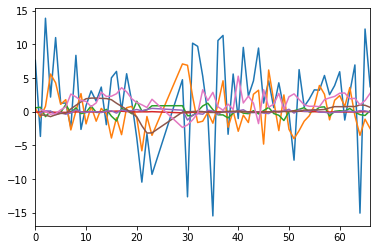

In [90]:
# ADF Test: test whether the series is stationary or not, take the difference if not stationary
merge3_diff = merge3_o.copy()

[index_remove3,merge3_differenced]=ADF_Test(merge3_diff)
index_remove3
merge3_differenced

#### 2.3.1 Forecast the returns for SP500

In [91]:
# Grangers Causation Test
[causation_matrix,index_remove,merge3_tested] = causation_test(merge3_differenced,4,5)
causation_matrix
index_remove
merge3_tested

        SP500  A191RP1Q027SBEA  CPALTT01USQ657N  MNFCTRIRSA        UNRATE  \
0   -3.662446             -0.8         0.654682   -0.043333 -2.000000e-01   
1   13.883164              0.8        -0.722454    0.006667  1.333333e-01   
2    2.179262              5.6         0.063697   -0.046667  1.000000e-01   
3   11.012639              4.3        -0.295709   -0.080000 -4.333333e-01   
4    1.276976              1.1        -0.109107   -0.080000 -1.333333e-01   
5    1.290682              1.8         1.067341   -0.096667 -3.666667e-01   
6   -2.328718             -2.7        -0.137160   -0.033333 -1.666667e-01   
7    8.372823              0.1         0.579689   -0.030000  3.000000e-01   
8   -2.619157              2.7        -0.273702   -0.013333 -8.881784e-16   
9    0.905602             -1.8        -0.094369   -0.010000 -1.000000e-01   
10   3.097589              0.8         0.863937   -0.026667  3.333333e-02   
11   1.572839             -1.4        -0.089792   -0.026667  0.000000e+00   

,SP500_x,A191RP1Q027SBEA_x,CPALTT01USQ657N_x,MNFCTRIRSA_x,UNRATE_x,FEDFUNDS_x,ULCNFB_x
SP500_y,1.0000,0.0120,0.0001,0.0012,0.0000,0.0000,0.0610
A191RP1Q027SBEA_y,0.0076,1.0000,0.1270,0.0000,0.0003,0.0001,0.0000
CPALTT01USQ657N_y,0.0270,0.0000,1.0000,0.0001,0.0000,0.0000,0.0000
MNFCTRIRSA_y,0.1116,0.0000,0.0014,1.0000,0.0000,0.0000,0.3063
UNRATE_y,0.0000,0.0000,0.0000,0.0000,1.0000,0.0000,0.0000
FEDFUNDS_y,0.0280,0.0766,0.0010,0.0000,0.1725,1.0000,0.0304
ULCNFB_y,0.0001,0.0000,0.0009,0.0263,0.0000,0.0000,1.0000


[10]

,Date,R1000,R1000G,R1000V,SP500,A191RP1Q027SBEA,CPALTT01USQ657N,MNFCTRIRSA,UNRATE,FEDFUNDS
0,2003-03-31,-1.374886,-3.454677,-5.633799,-3.662446,-0.8,0.654682,-0.043333,-2.000000e-01,-0.483333
1,2003-06-30,13.104530,14.176321,15.309905,13.883164,0.8,-0.722454,0.006667,1.333333e-01,-0.503333
2,2003-09-30,3.592342,2.513713,1.406037,2.179262,5.6,0.063697,-0.046667,1.000000e-01,-0.723333
3,2003-12-31,9.606756,11.089623,12.608335,11.012639,4.3,-0.295709,-0.080000,-4.333333e-01,-0.446667
4,2004-03-31,0.542353,1.479184,2.413217,1.276976,1.1,-0.109107,-0.080000,-1.333333e-01,-0.246667
5,2004-06-30,1.661797,0.971370,0.285172,1.290682,1.8,1.067341,-0.096667,-3.666667e-01,-0.236667
6,2004-09-30,-5.620782,-2.265713,0.920815,-2.328718,-2.7,-0.137160,-0.033333,-1.666667e-01,0.416667
7,2004-12-31,8.511727,8.882425,9.223042,8.372823,0.1,0.579689,-0.030000,3.000000e-01,0.953333
8,2005-03-31,-4.442505,-2.364169,-0.505210,-2.619157,2.7,-0.273702,-0.013333,-8.881784e-16,1.466667
9,2005-06-30,2.163017,1.582307,1.056342,0.905602,-1.8,-0.094369,-0.010000,-1.000000e-01,1.933333


  Summary of Regression Results   
Model:                         VAR
Method:                        OLS
Date:           Wed, 28, Aug, 2019
Time:                     13:33:04
--------------------------------------------------------------------
No. of Equations:         6.00000    BIC:                   -3.13817
Nobs:                     51.0000    HQIC:                  -8.33392
Log likelihood:           82.2609    FPE:                9.86925e-05
AIC:                     -11.5473    Det(Omega_mle):     3.73946e-06
--------------------------------------------------------------------
Results for equation SP500
                        coefficient       std. error           t-stat            prob
-------------------------------------------------------------------------------------
const                      0.555144         1.485835            0.374           0.709
L1.SP500                  -0.436949         0.258634           -1.689           0.091
L1.A191RP1Q027SBEA        -0.776501     

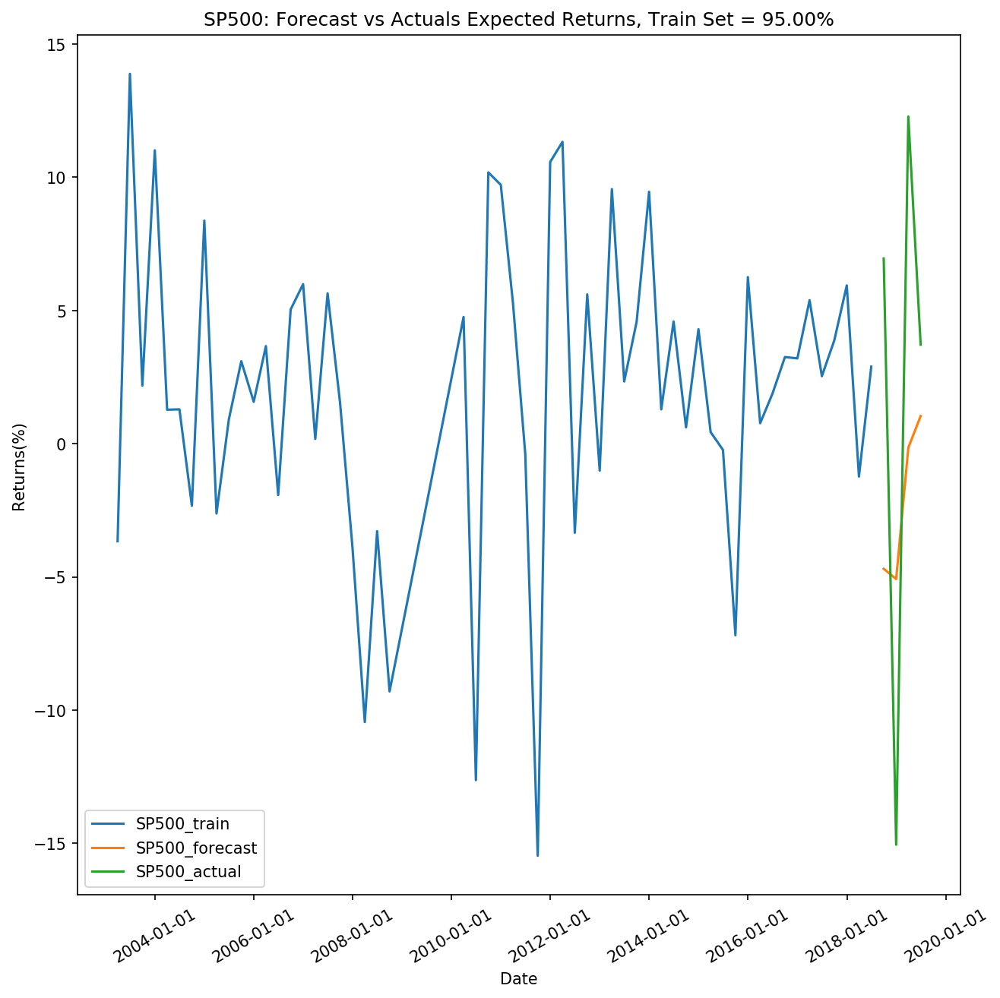

In [107]:
# Forecast, Train Size = 95%
[model3_fitted,df3,df3_train,df3_test,date3] = VAR_Model(merge3_tested,4,5,0.05)
[df3_forecast,lag_order3] = forecast_plot(model3_fitted,df3,df3_train,df3_test,date3,95)

In [108]:
# Test the Accuracy
print('Forecast Accuracy of: SP500')
accuracy_prod = forecast_accuracy(df3_forecast['SP500_forecast'].values, df3_test['SP500'])
for k, v in accuracy_prod.items():
    print(adjust(k), ': ', round(v,4))
    
print('\nForecast values are: ',df3_forecast.iloc[:lag_order3,0].values)
print('Actual values are: ',df3_test.iloc[:lag_order3,0].values)

Forecast Accuracy of: SP500
mape   :  1.0176
me     :  -4.1949
mae    :  9.18
mpe    :  -1.0176
rmse   :  9.9573
corr   :  0.57

Forecast values are:  [-4.69242128 -5.07917832 -0.14915981  1.03860757]
Actual values are:  [  6.94874084 -15.04928594  12.28032897   3.71777671]


  Summary of Regression Results   
Model:                         VAR
Method:                        OLS
Date:           Wed, 28, Aug, 2019
Time:                     13:33:06
--------------------------------------------------------------------
No. of Equations:         6.00000    BIC:                   -5.02866
Nobs:                     48.0000    HQIC:                  -10.4125
Log likelihood:           141.737    FPE:                2.33613e-05
AIC:                     -13.6830    Det(Omega_mle):     7.57585e-07
--------------------------------------------------------------------
Results for equation SP500
                        coefficient       std. error           t-stat            prob
-------------------------------------------------------------------------------------
const                      0.700009         1.355684            0.516           0.606
L1.SP500                  -0.456633         0.251184           -1.818           0.069
L1.A191RP1Q027SBEA        -0.875376     

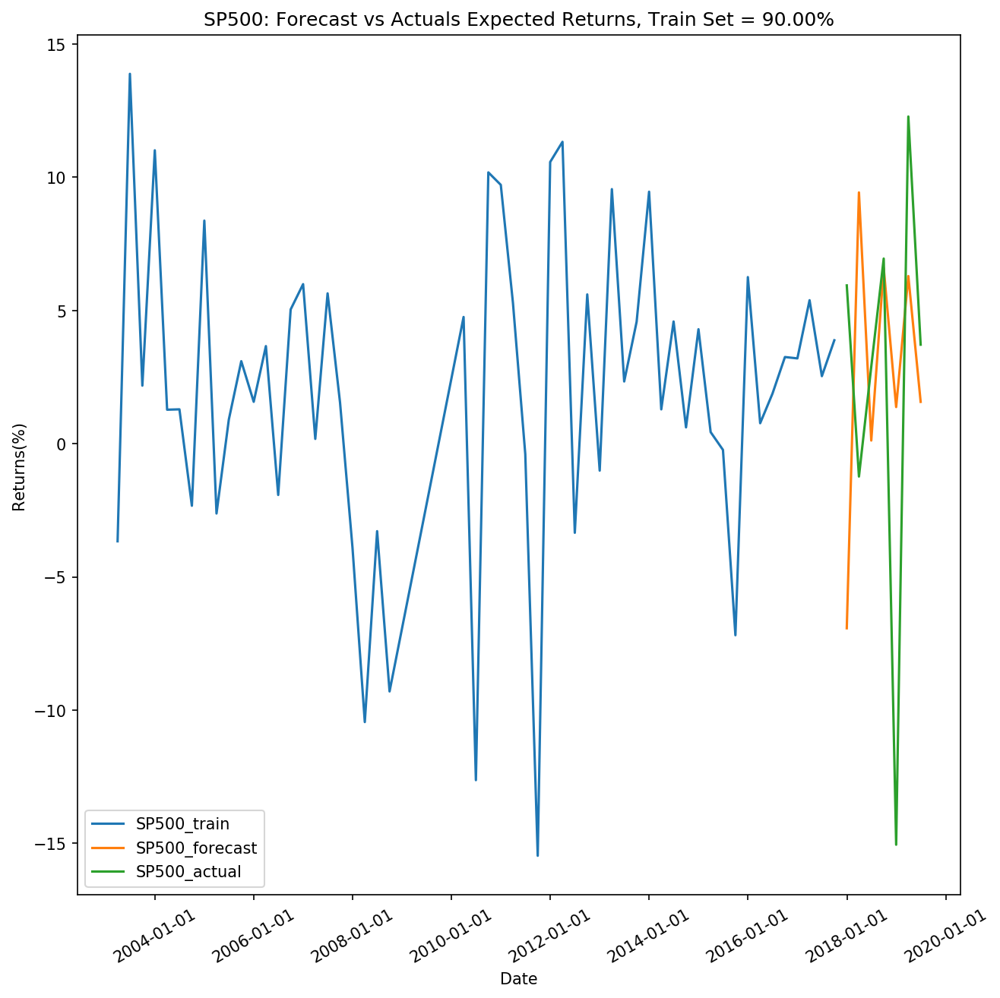

Forecast Accuracy of: SP500
mape   :  1.998
me     :  0.4227
mae    :  7.3169
mpe    :  -1.998
rmse   :  9.2379
corr   :  0.0531

Forecast values are:  [-6.92625866  9.43111688  0.11960407  6.59450867  1.37592151  6.29271197]
Actual values are:  [  5.94247181  -1.23212108   2.89240276   6.94874084 -15.04928594
  12.28032897]


In [109]:
# Forecast, Train Size = 90%
[model3_fitted,df3,df3_train,df3_test,date3] = VAR_Model(merge3_tested,4,5,0.1)
[df3_forecast,lag_order3] = forecast_plot(model3_fitted,df3,df3_train,df3_test,date3,90)

print('Forecast Accuracy of: SP500')
accuracy_prod = forecast_accuracy(df3_forecast['SP500_forecast'].values, df3_test['SP500'])
for k, v in accuracy_prod.items():
    print(adjust(k), ': ', round(v,4))
    
print('\nForecast values are: ',df3_forecast.iloc[:lag_order3,0].values)
print('Actual values are: ',df3_test.iloc[:lag_order3,0].values)

  Summary of Regression Results   
Model:                         VAR
Method:                        OLS
Date:           Wed, 28, Aug, 2019
Time:                     13:33:08
--------------------------------------------------------------------
No. of Equations:         6.00000    BIC:                   -49.3151
Nobs:                     42.0000    HQIC:                  -55.1333
Log likelihood:           1092.93    FPE:                1.56548e-23
AIC:                     -58.4999    Det(Omega_mle):    -7.20019e-26
--------------------------------------------------------------------
Results for equation SP500
                        coefficient       std. error           t-stat            prob
-------------------------------------------------------------------------------------
const                      0.790172         1.572233            0.503           0.615
L1.SP500                  -0.521409         0.373617           -1.396           0.163
L1.A191RP1Q027SBEA        -1.074538     

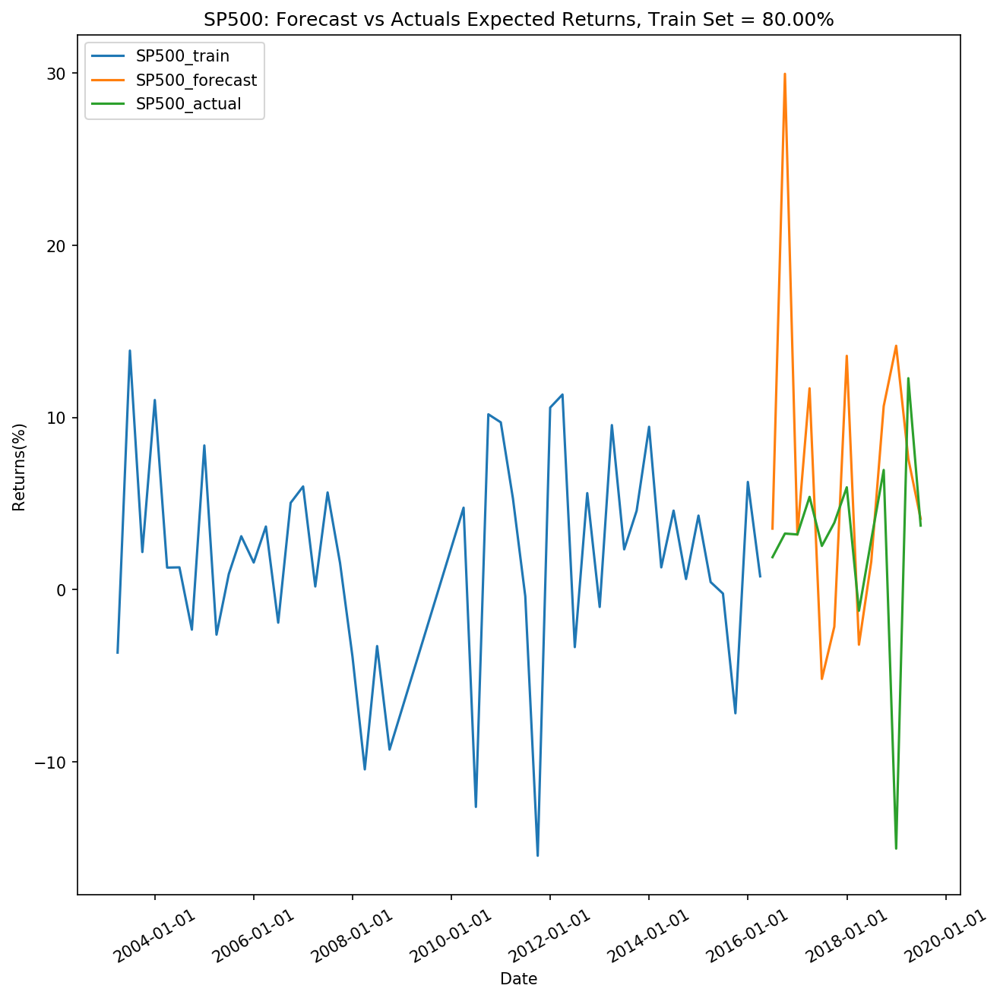

Forecast Accuracy of: SP500
mape   :  1.6271
me     :  4.1484
mae    :  7.4868
mpe    :  0.4939
rmse   :  11.7841
corr   :  -0.0443

Forecast values are:  [ 3.53993242 29.96357083  3.18897897 11.69189859 -5.19066366 -2.15714339]
Actual values are:  [1.88145789 3.25352744 3.20237934 5.38600898 2.53621415 3.88292618]


In [110]:
# Forecast, Train Size = 80%
[model3_fitted,df3,df3_train,df3_test,date3] = VAR_Model(merge3_tested,4,5,0.2)
[df3_forecast,lag_order3] = forecast_plot(model3_fitted,df3,df3_train,df3_test,date3,80)

print('Forecast Accuracy of: SP500')
accuracy_prod = forecast_accuracy(df3_forecast['SP500_forecast'].values, df3_test['SP500'])
for k, v in accuracy_prod.items():
    print(adjust(k), ': ', round(v,4))
    
print('\nForecast values are: ',df3_forecast.iloc[:lag_order3,0].values)
print('Actual values are: ',df3_test.iloc[:lag_order3,0].values)

#### 2.3.2 Forecast the returns for R1000

        R1000  A191RP1Q027SBEA  CPALTT01USQ657N  MNFCTRIRSA        UNRATE  \
0   -1.374886             -0.8         0.654682   -0.043333 -2.000000e-01   
1   13.104530              0.8        -0.722454    0.006667  1.333333e-01   
2    3.592342              5.6         0.063697   -0.046667  1.000000e-01   
3    9.606756              4.3        -0.295709   -0.080000 -4.333333e-01   
4    0.542353              1.1        -0.109107   -0.080000 -1.333333e-01   
5    1.661797              1.8         1.067341   -0.096667 -3.666667e-01   
6   -5.620782             -2.7        -0.137160   -0.033333 -1.666667e-01   
7    8.511727              0.1         0.579689   -0.030000  3.000000e-01   
8   -4.442505              2.7        -0.273702   -0.013333 -8.881784e-16   
9    2.163017             -1.8        -0.094369   -0.010000 -1.000000e-01   
10   3.676226              0.8         0.863937   -0.026667  3.333333e-02   
11   2.635105             -1.4        -0.089792   -0.026667  0.000000e+00   

,R1000_x,A191RP1Q027SBEA_x,CPALTT01USQ657N_x,MNFCTRIRSA_x,UNRATE_x,FEDFUNDS_x,ULCNFB_x
R1000_y,1.0000,0.0061,0.0012,0.0007,0.0000,0.0000,0.1352
A191RP1Q027SBEA_y,0.0051,1.0000,0.1270,0.0000,0.0003,0.0001,0.0000
CPALTT01USQ657N_y,0.0032,0.0000,1.0000,0.0001,0.0000,0.0000,0.0000
MNFCTRIRSA_y,0.1868,0.0000,0.0014,1.0000,0.0000,0.0000,0.3063
UNRATE_y,0.0000,0.0000,0.0000,0.0000,1.0000,0.0000,0.0000
FEDFUNDS_y,0.0042,0.0766,0.0010,0.0000,0.1725,1.0000,0.0304
ULCNFB_y,0.0001,0.0000,0.0009,0.0263,0.0000,0.0000,1.0000


[10]

,Date,R1000,R1000G,R1000V,SP500,A191RP1Q027SBEA,CPALTT01USQ657N,MNFCTRIRSA,UNRATE,FEDFUNDS
0,2003-03-31,-1.374886,-3.454677,-5.633799,-3.662446,-0.8,0.654682,-0.043333,-2.000000e-01,-0.483333
1,2003-06-30,13.104530,14.176321,15.309905,13.883164,0.8,-0.722454,0.006667,1.333333e-01,-0.503333
2,2003-09-30,3.592342,2.513713,1.406037,2.179262,5.6,0.063697,-0.046667,1.000000e-01,-0.723333
3,2003-12-31,9.606756,11.089623,12.608335,11.012639,4.3,-0.295709,-0.080000,-4.333333e-01,-0.446667
4,2004-03-31,0.542353,1.479184,2.413217,1.276976,1.1,-0.109107,-0.080000,-1.333333e-01,-0.246667
5,2004-06-30,1.661797,0.971370,0.285172,1.290682,1.8,1.067341,-0.096667,-3.666667e-01,-0.236667
6,2004-09-30,-5.620782,-2.265713,0.920815,-2.328718,-2.7,-0.137160,-0.033333,-1.666667e-01,0.416667
7,2004-12-31,8.511727,8.882425,9.223042,8.372823,0.1,0.579689,-0.030000,3.000000e-01,0.953333
8,2005-03-31,-4.442505,-2.364169,-0.505210,-2.619157,2.7,-0.273702,-0.013333,-8.881784e-16,1.466667
9,2005-06-30,2.163017,1.582307,1.056342,0.905602,-1.8,-0.094369,-0.010000,-1.000000e-01,1.933333


  Summary of Regression Results   
Model:                         VAR
Method:                        OLS
Date:           Wed, 28, Aug, 2019
Time:                     13:44:21
--------------------------------------------------------------------
No. of Equations:         6.00000    BIC:                   -2.55151
Nobs:                     51.0000    HQIC:                  -7.74726
Log likelihood:           67.3009    FPE:                0.000177447
AIC:                     -10.9606    Det(Omega_mle):     6.72348e-06
--------------------------------------------------------------------
Results for equation R1000
                        coefficient       std. error           t-stat            prob
-------------------------------------------------------------------------------------
const                      1.143056         2.017719            0.567           0.571
L1.R1000                  -0.106455         0.326212           -0.326           0.744
L1.A191RP1Q027SBEA        -0.807369     

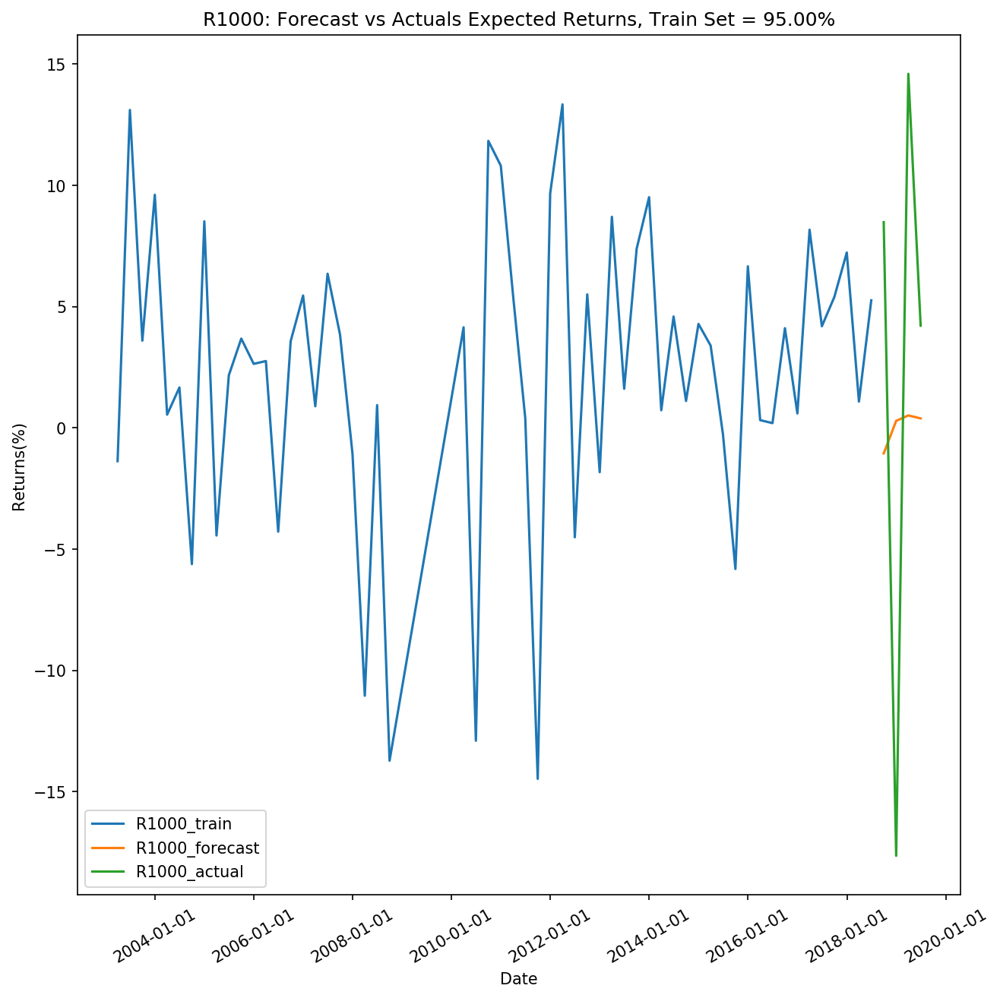

Forecast Accuracy of: R1000
mape   :  1.0035
me     :  -2.3785
mae    :  11.3437
mpe    :  -1.0035
rmse   :  12.5043
corr   :  -0.1696


In [112]:
[causation_matrix,index_remove,merge3_tested_R1000] = causation_test(merge3_differenced,1,5)
causation_matrix
index_remove
merge3_tested_R1000

# Train Size = 95%
[model3_fitted_R1000,df3_R1000,df3_train_R1000,df3_test_R1000,date1] = VAR_Model(merge3_tested_R1000,1,5,0.05)
[df3_forecast_R1000,lag_order3_R1000] = forecast_plot(model3_fitted_R1000,df3_R1000,df3_train_R1000,df3_test_R1000,date1,95)

print('Forecast Accuracy of: R1000')
accuracy_prod = forecast_accuracy(df3_forecast_R1000['R1000_forecast'].values, df3_test_R1000['R1000'])

for k, v in accuracy_prod.items():
    print(adjust(k), ': ', round(v,4)) 

  Summary of Regression Results   
Model:                         VAR
Method:                        OLS
Date:           Wed, 28, Aug, 2019
Time:                     13:44:28
--------------------------------------------------------------------
No. of Equations:         6.00000    BIC:                   -3.97085
Nobs:                     48.0000    HQIC:                  -9.35468
Log likelihood:           116.349    FPE:                6.72818e-05
AIC:                     -12.6252    Det(Omega_mle):     2.18188e-06
--------------------------------------------------------------------
Results for equation R1000
                        coefficient       std. error           t-stat            prob
-------------------------------------------------------------------------------------
const                      2.909171         2.113018            1.377           0.169
L1.R1000                  -0.410538         0.374581           -1.096           0.273
L1.A191RP1Q027SBEA        -0.696696     

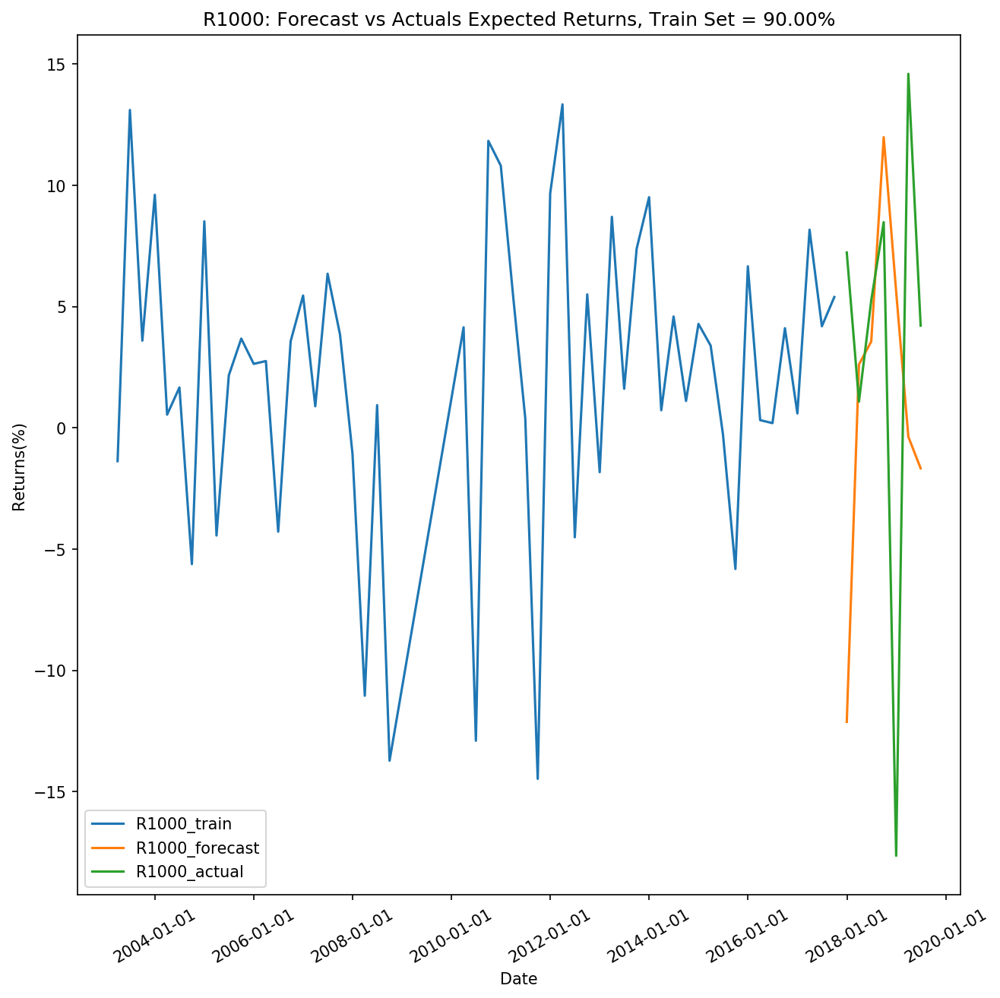

Forecast Accuracy of: R1000
mape   :  1.2246
me     :  -1.9435
mae    :  10.0274
mpe    :  -0.7016
rmse   :  13.0468
corr   :  -0.2382


In [113]:
# Train Size = 90%
[model3_fitted_R1000,df3_R1000,df3_train_R1000,df3_test_R1000,date1] = VAR_Model(merge3_tested_R1000,1,5,0.1)
[df3_forecast_R1000,lag_order3_R1000] = forecast_plot(model3_fitted_R1000,df3_R1000,df3_train_R1000,df3_test_R1000,date1,90)

print('Forecast Accuracy of: R1000')
accuracy_prod = forecast_accuracy(df3_forecast_R1000['R1000_forecast'].values, df3_test_R1000['R1000'])

for k, v in accuracy_prod.items():
    print(adjust(k), ': ', round(v,4)) 

  Summary of Regression Results   
Model:                         VAR
Method:                        OLS
Date:           Wed, 28, Aug, 2019
Time:                     13:45:03
--------------------------------------------------------------------
No. of Equations:         6.00000    BIC:                   -1.65893
Nobs:                     43.0000    HQIC:                  -6.46778
Log likelihood:           19.3725    FPE:                0.000899783
AIC:                     -9.27715    Det(Omega_mle):     3.46384e-05
--------------------------------------------------------------------
Results for equation R1000
                        coefficient       std. error           t-stat            prob
-------------------------------------------------------------------------------------
const                      1.365916         1.277318            1.069           0.285
L1.R1000                  -0.292503         0.205422           -1.424           0.154
L1.A191RP1Q027SBEA        -0.830840     

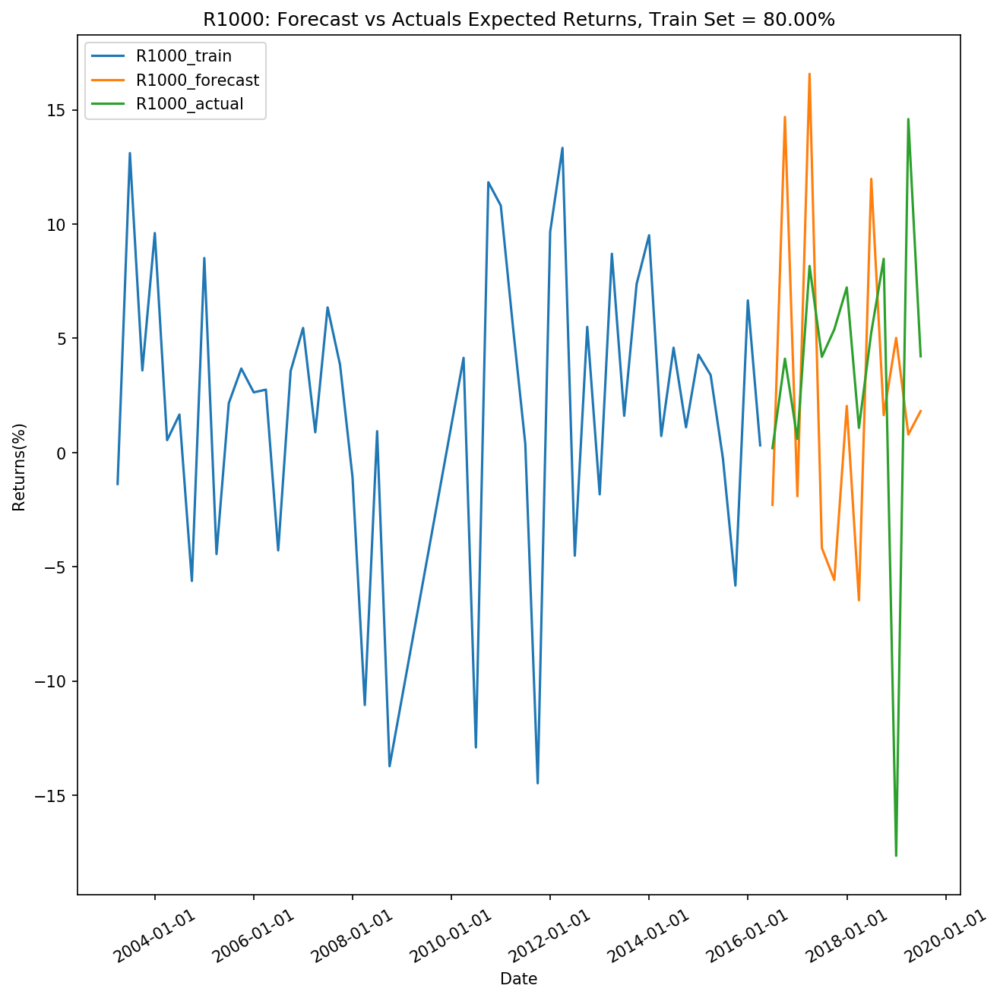

Forecast Accuracy of: R1000
mape   :  2.8711
me     :  -0.9025
mae    :  8.3439
mpe    :  -2.1197
rmse   :  9.888
corr   :  0.0618


In [114]:
# Train Size = 80%
[model3_fitted_R1000,df3_R1000,df3_train_R1000,df3_test_R1000,date1] = VAR_Model(merge3_tested_R1000,1,5,0.2)
[df3_forecast_R1000,lag_order3_R1000] = forecast_plot(model3_fitted_R1000,df3_R1000,df3_train_R1000,df3_test_R1000,date1,80)

print('Forecast Accuracy of: R1000')
accuracy_prod = forecast_accuracy(df3_forecast_R1000['R1000_forecast'].values, df3_test_R1000['R1000'])

for k, v in accuracy_prod.items():
    print(adjust(k), ': ', round(v,4)) 

#### 2.3.3 Forecast the returns for R1000G

       R1000G  A191RP1Q027SBEA  CPALTT01USQ657N  MNFCTRIRSA        UNRATE  \
0   -3.454677             -0.8         0.654682   -0.043333 -2.000000e-01   
1   14.176321              0.8        -0.722454    0.006667  1.333333e-01   
2    2.513713              5.6         0.063697   -0.046667  1.000000e-01   
3   11.089623              4.3        -0.295709   -0.080000 -4.333333e-01   
4    1.479184              1.1        -0.109107   -0.080000 -1.333333e-01   
5    0.971370              1.8         1.067341   -0.096667 -3.666667e-01   
6   -2.265713             -2.7        -0.137160   -0.033333 -1.666667e-01   
7    8.882425              0.1         0.579689   -0.030000  3.000000e-01   
8   -2.364169              2.7        -0.273702   -0.013333 -8.881784e-16   
9    1.582307             -1.8        -0.094369   -0.010000 -1.000000e-01   
10   3.440562              0.8         0.863937   -0.026667  3.333333e-02   
11   1.615822             -1.4        -0.089792   -0.026667  0.000000e+00   

,R1000G_x,A191RP1Q027SBEA_x,CPALTT01USQ657N_x,MNFCTRIRSA_x,UNRATE_x,FEDFUNDS_x,ULCNFB_x
R1000G_y,1.0000,0.0059,0.0000,0.0003,0.0000,0.0000,0.0657
A191RP1Q027SBEA_y,0.0081,1.0000,0.1270,0.0000,0.0003,0.0001,0.0000
CPALTT01USQ657N_y,0.0318,0.0000,1.0000,0.0001,0.0000,0.0000,0.0000
MNFCTRIRSA_y,0.1612,0.0000,0.0014,1.0000,0.0000,0.0000,0.3063
UNRATE_y,0.0000,0.0000,0.0000,0.0000,1.0000,0.0000,0.0000
FEDFUNDS_y,0.0362,0.0766,0.0010,0.0000,0.1725,1.0000,0.0304
ULCNFB_y,0.0001,0.0000,0.0009,0.0263,0.0000,0.0000,1.0000


[10]

,Date,R1000,R1000G,R1000V,SP500,A191RP1Q027SBEA,CPALTT01USQ657N,MNFCTRIRSA,UNRATE,FEDFUNDS
0,2003-03-31,-1.374886,-3.454677,-5.633799,-3.662446,-0.8,0.654682,-0.043333,-2.000000e-01,-0.483333
1,2003-06-30,13.104530,14.176321,15.309905,13.883164,0.8,-0.722454,0.006667,1.333333e-01,-0.503333
2,2003-09-30,3.592342,2.513713,1.406037,2.179262,5.6,0.063697,-0.046667,1.000000e-01,-0.723333
3,2003-12-31,9.606756,11.089623,12.608335,11.012639,4.3,-0.295709,-0.080000,-4.333333e-01,-0.446667
4,2004-03-31,0.542353,1.479184,2.413217,1.276976,1.1,-0.109107,-0.080000,-1.333333e-01,-0.246667
5,2004-06-30,1.661797,0.971370,0.285172,1.290682,1.8,1.067341,-0.096667,-3.666667e-01,-0.236667
6,2004-09-30,-5.620782,-2.265713,0.920815,-2.328718,-2.7,-0.137160,-0.033333,-1.666667e-01,0.416667
7,2004-12-31,8.511727,8.882425,9.223042,8.372823,0.1,0.579689,-0.030000,3.000000e-01,0.953333
8,2005-03-31,-4.442505,-2.364169,-0.505210,-2.619157,2.7,-0.273702,-0.013333,-8.881784e-16,1.466667
9,2005-06-30,2.163017,1.582307,1.056342,0.905602,-1.8,-0.094369,-0.010000,-1.000000e-01,1.933333


  Summary of Regression Results   
Model:                         VAR
Method:                        OLS
Date:           Wed, 28, Aug, 2019
Time:                     13:51:18
--------------------------------------------------------------------
No. of Equations:         6.00000    BIC:                   -3.10252
Nobs:                     51.0000    HQIC:                  -8.29827
Log likelihood:           81.3518    FPE:                0.000102274
AIC:                     -11.5116    Det(Omega_mle):     3.87518e-06
--------------------------------------------------------------------
Results for equation R1000G
                        coefficient       std. error           t-stat            prob
-------------------------------------------------------------------------------------
const                      0.725966         1.506164            0.482           0.630
L1.R1000G                 -0.439007         0.266529           -1.647           0.100
L1.A191RP1Q027SBEA        -0.849420    

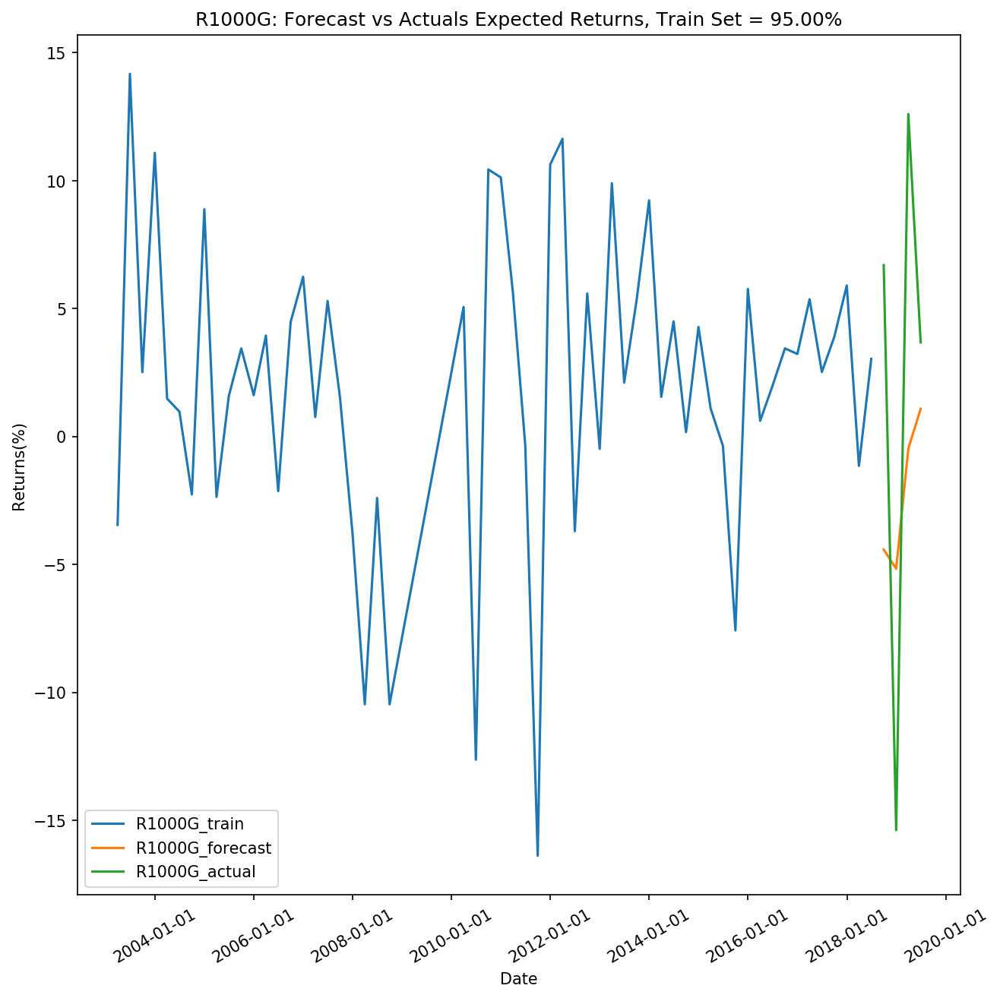

Forecast Accuracy of: R1000G
mape   :  1.017
me     :  -4.1424
mae    :  9.2532
mpe    :  -1.017
rmse   :  10.0732
corr   :  0.5909


In [116]:
[causation_matrix,index_remove,merge3_tested_R1000G] = causation_test(merge3_differenced,2,5)
causation_matrix
index_remove
merge3_tested_R1000G

# Train Set = 95%
[model3_fitted_R1000G,df3_R1000G,df3_train_R1000G,df3_test_R1000G,date1] = VAR_Model(merge3_tested_R1000G,2,5,0.05)
[df3_forecast_R1000G,lag_order3_R1000G] = forecast_plot(model3_fitted_R1000G,df3_R1000G,df3_train_R1000G,df3_test_R1000G,date1,95)

print('Forecast Accuracy of: R1000G')
accuracy_prod = forecast_accuracy(df3_forecast_R1000G['R1000G_forecast'].values, df3_test_R1000G['R1000G'])

for k, v in accuracy_prod.items():
    print(adjust(k), ': ', round(v,4)) 

  Summary of Regression Results   
Model:                         VAR
Method:                        OLS
Date:           Wed, 28, Aug, 2019
Time:                     13:51:21
--------------------------------------------------------------------
No. of Equations:         6.00000    BIC:                   -4.95014
Nobs:                     48.0000    HQIC:                  -10.3340
Log likelihood:           139.852    FPE:                2.52695e-05
AIC:                     -13.6044    Det(Omega_mle):     8.19464e-07
--------------------------------------------------------------------
Results for equation R1000G
                        coefficient       std. error           t-stat            prob
-------------------------------------------------------------------------------------
const                      0.788943         1.384990            0.570           0.569
L1.R1000G                 -0.435724         0.260633           -1.672           0.095
L1.A191RP1Q027SBEA        -0.956168    

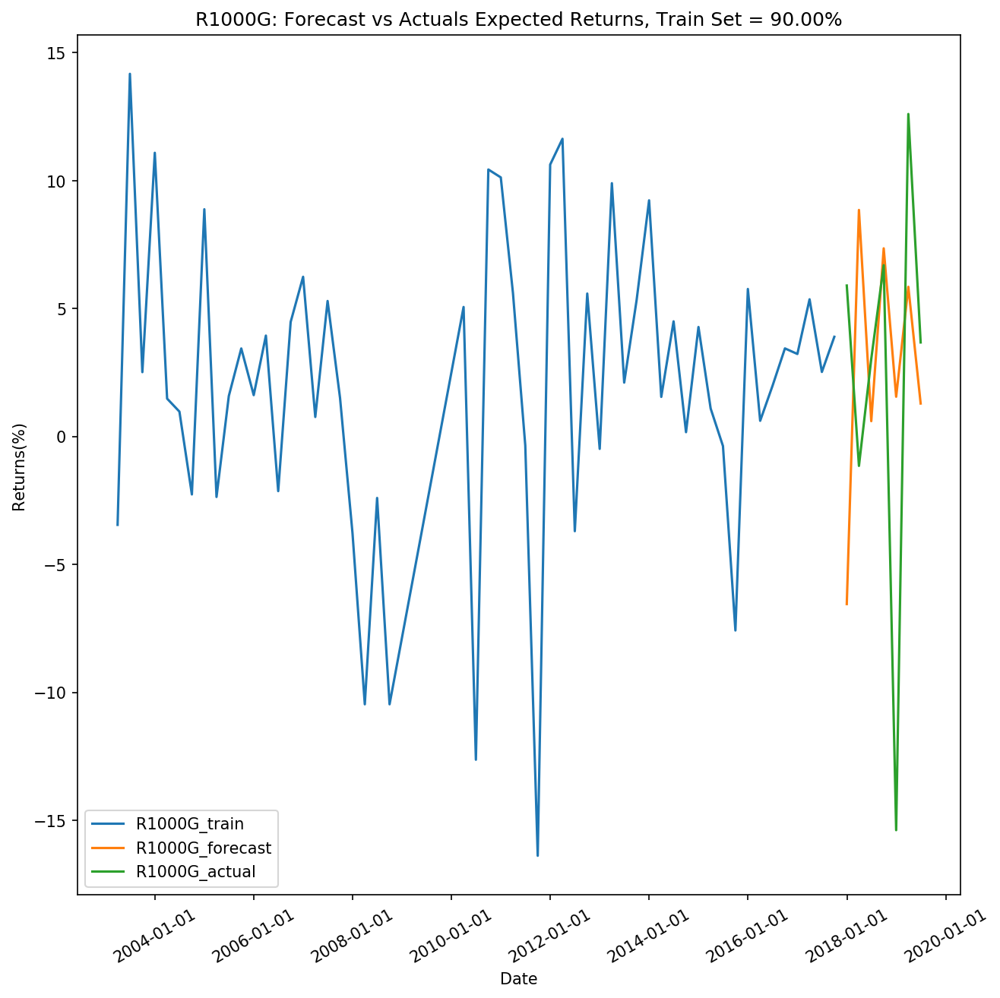

Forecast Accuracy of: R1000G
mape   :  1.9997
me     :  0.511
mae    :  7.3757
mpe    :  -1.9717
rmse   :  9.2569
corr   :  0.0552


In [117]:
# Train Set = 90%
[model3_fitted_R1000G,df3_R1000G,df3_train_R1000G,df3_test_R1000G,date1] = VAR_Model(merge3_tested_R1000G,2,5,0.1)
[df3_forecast_R1000G,lag_order3_R1000G] = forecast_plot(model3_fitted_R1000G,df3_R1000G,df3_train_R1000G,df3_test_R1000G,date1,90)

print('Forecast Accuracy of: R1000G')
accuracy_prod = forecast_accuracy(df3_forecast_R1000G['R1000G_forecast'].values, df3_test_R1000G['R1000G'])

for k, v in accuracy_prod.items():
    print(adjust(k), ': ', round(v,4)) 

  Summary of Regression Results   
Model:                         VAR
Method:                        OLS
Date:           Wed, 28, Aug, 2019
Time:                     13:53:56
--------------------------------------------------------------------
No. of Equations:         6.00000    BIC:                   -45.6099
Nobs:                     42.0000    HQIC:                  -51.4281
Log likelihood:           1015.12    FPE:                6.36478e-22
AIC:                     -54.7947    Det(Omega_mle):     2.71508e-23
--------------------------------------------------------------------
Results for equation R1000G
                        coefficient       std. error           t-stat            prob
-------------------------------------------------------------------------------------
const                      0.976740         1.579183            0.619           0.536
L1.R1000G                 -0.537232         0.392199           -1.370           0.171
L1.A191RP1Q027SBEA        -1.162254    

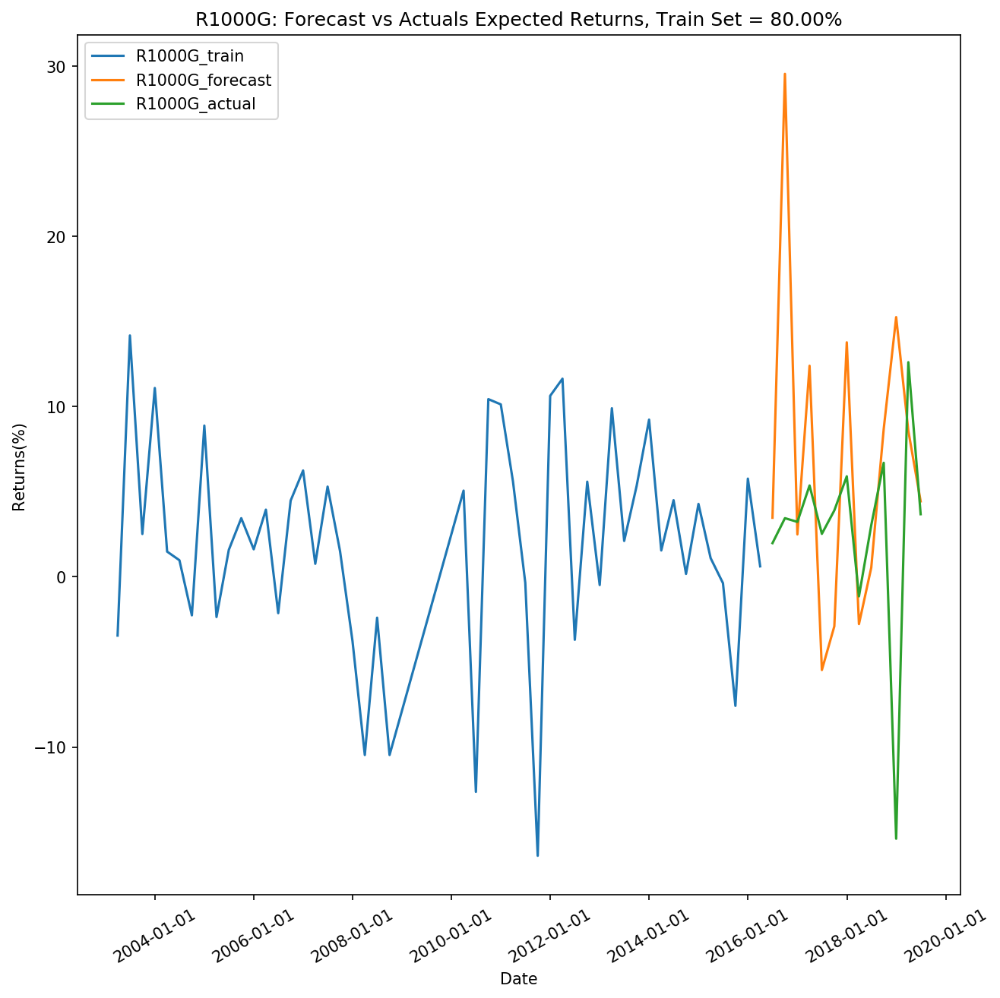

Forecast Accuracy of: R1000G
mape   :  1.6295
me     :  4.0139
mae    :  7.6601
mpe    :  0.3556
rmse   :  12.0082
corr   :  -0.0701


In [119]:
# Train Size = 80%
[model3_fitted_R1000G,df3_R1000G,df3_train_R1000G,df3_test_R1000G,date1] = VAR_Model(merge3_tested_R1000G,2,5,0.2)
[df3_forecast_R1000G,lag_order3_R1000G] = forecast_plot(model3_fitted_R1000G,df3_R1000G,df3_train_R1000G,df3_test_R1000G,date1,80)

print('Forecast Accuracy of: R1000G')
accuracy_prod = forecast_accuracy(df3_forecast_R1000G['R1000G_forecast'].values, df3_test_R1000G['R1000G'])

for k, v in accuracy_prod.items():
    print(adjust(k), ': ', round(v,4)) 

#### 2.3.4 Forecast the returns for R1000V

       R1000V  A191RP1Q027SBEA  CPALTT01USQ657N  MNFCTRIRSA        UNRATE  \
0   -5.633799             -0.8         0.654682   -0.043333 -2.000000e-01   
1   15.309905              0.8        -0.722454    0.006667  1.333333e-01   
2    1.406037              5.6         0.063697   -0.046667  1.000000e-01   
3   12.608335              4.3        -0.295709   -0.080000 -4.333333e-01   
4    2.413217              1.1        -0.109107   -0.080000 -1.333333e-01   
5    0.285172              1.8         1.067341   -0.096667 -3.666667e-01   
6    0.920815             -2.7        -0.137160   -0.033333 -1.666667e-01   
7    9.223042              0.1         0.579689   -0.030000  3.000000e-01   
8   -0.505210              2.7        -0.273702   -0.013333 -8.881784e-16   
9    1.056342             -1.8        -0.094369   -0.010000 -1.000000e-01   
10   3.204911              0.8         0.863937   -0.026667  3.333333e-02   
11   0.581907             -1.4        -0.089792   -0.026667  0.000000e+00   

,R1000V_x,A191RP1Q027SBEA_x,CPALTT01USQ657N_x,MNFCTRIRSA_x,UNRATE_x,FEDFUNDS_x,ULCNFB_x
R1000V_y,1.0000,0.0171,0.0008,0.0001,0.0000,0.0000,0.0115
A191RP1Q027SBEA_y,0.0014,1.0000,0.1270,0.0000,0.0003,0.0001,0.0000
CPALTT01USQ657N_y,0.0508,0.0000,1.0000,0.0001,0.0000,0.0000,0.0000
MNFCTRIRSA_y,0.1479,0.0000,0.0014,1.0000,0.0000,0.0000,0.3063
UNRATE_y,0.0002,0.0000,0.0000,0.0000,1.0000,0.0000,0.0000
FEDFUNDS_y,0.1980,0.0766,0.0010,0.0000,0.1725,1.0000,0.0304
ULCNFB_y,0.0004,0.0000,0.0009,0.0263,0.0000,0.0000,1.0000


[]

,Date,R1000,R1000G,R1000V,SP500,A191RP1Q027SBEA,CPALTT01USQ657N,MNFCTRIRSA,UNRATE,FEDFUNDS,ULCNFB
0,2003-03-31,-1.374886,-3.454677,-5.633799,-3.662446,-0.8,0.654682,-0.043333,-2.000000e-01,-0.483333,0.322
1,2003-06-30,13.104530,14.176321,15.309905,13.883164,0.8,-0.722454,0.006667,1.333333e-01,-0.503333,0.090
2,2003-09-30,3.592342,2.513713,1.406037,2.179262,5.6,0.063697,-0.046667,1.000000e-01,-0.723333,-0.367
3,2003-12-31,9.606756,11.089623,12.608335,11.012639,4.3,-0.295709,-0.080000,-4.333333e-01,-0.446667,-0.266
4,2004-03-31,0.542353,1.479184,2.413217,1.276976,1.1,-0.109107,-0.080000,-1.333333e-01,-0.246667,0.276
5,2004-06-30,1.661797,0.971370,0.285172,1.290682,1.8,1.067341,-0.096667,-3.666667e-01,-0.236667,0.736
6,2004-09-30,-5.620782,-2.265713,0.920815,-2.328718,-2.7,-0.137160,-0.033333,-1.666667e-01,0.416667,2.626
7,2004-12-31,8.511727,8.882425,9.223042,8.372823,0.1,0.579689,-0.030000,3.000000e-01,0.953333,2.204
8,2005-03-31,-4.442505,-2.364169,-0.505210,-2.619157,2.7,-0.273702,-0.013333,-8.881784e-16,1.466667,1.670
9,2005-06-30,2.163017,1.582307,1.056342,0.905602,-1.8,-0.094369,-0.010000,-1.000000e-01,1.933333,1.545


  Summary of Regression Results   
Model:                         VAR
Method:                        OLS
Date:           Wed, 28, Aug, 2019
Time:                     14:04:13
--------------------------------------------------------------------
No. of Equations:         7.00000    BIC:                   -5.27464
Nobs:                     51.0000    HQIC:                  -12.3193
Log likelihood:           219.682    FPE:                1.32284e-05
AIC:                     -16.6762    Det(Omega_mle):     1.83064e-07
--------------------------------------------------------------------
Results for equation R1000V
                        coefficient       std. error           t-stat            prob
-------------------------------------------------------------------------------------
const                     -1.275838         7.237589           -0.176           0.860
L1.R1000V                 -0.662884         0.373739           -1.774           0.076
L1.A191RP1Q027SBEA        -0.941531    

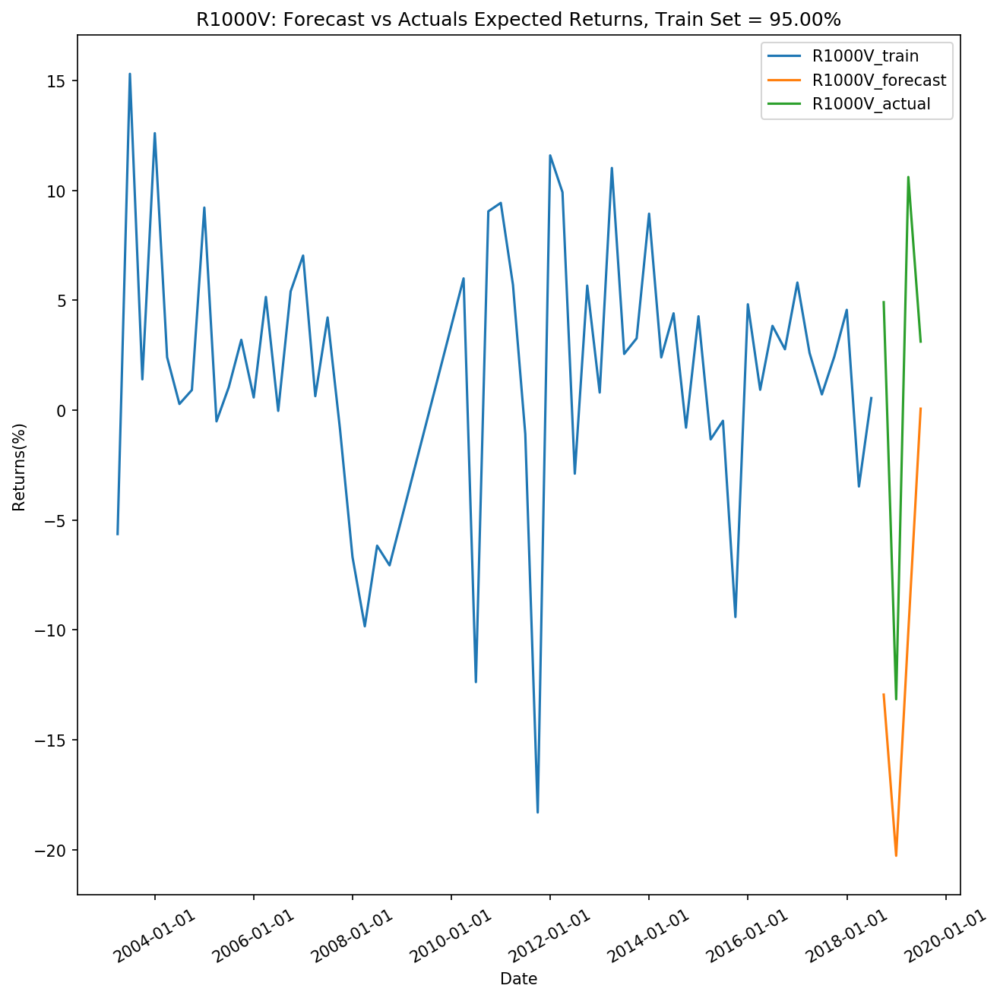

Forecast Accuracy of: R1000V
mape   :  1.7744
me     :  -12.1755
mae    :  12.1755
mpe    :  -1.5036
rmse   :  14.1971
corr   :  0.6047


In [120]:
[causation_matrix,index_remove,merge3_tested_R1000V] = causation_test(merge3_differenced,3,5)
causation_matrix
index_remove
merge3_tested_R1000V

# Train Set = 95%
[model3_fitted_R1000V,df3_R1000V,df3_train_R1000V,df3_test_R1000V,date1] = VAR_Model(merge3_tested_R1000V,3,5,0.05)
[df3_forecast_R1000V,lag_order3_R1000V] = forecast_plot(model3_fitted_R1000V,df3_R1000V,df3_train_R1000V,df3_test_R1000V,date1,95)

print('Forecast Accuracy of: R1000V')
accuracy_prod = forecast_accuracy(df3_forecast_R1000V['R1000V_forecast'].values, df3_test_R1000V['R1000V'])

for k, v in accuracy_prod.items():
    print(adjust(k), ': ', round(v,4)) 

  Summary of Regression Results   
Model:                         VAR
Method:                        OLS
Date:           Wed, 28, Aug, 2019
Time:                     14:04:14
--------------------------------------------------------------------
No. of Equations:         7.00000    BIC:                   -1.27425
Nobs:                     49.0000    HQIC:                  -7.31231
Log likelihood:           34.8927    FPE:                0.000290062
AIC:                     -11.0036    Det(Omega_mle):     6.13664e-06
--------------------------------------------------------------------
Results for equation R1000V
                        coefficient       std. error           t-stat            prob
-------------------------------------------------------------------------------------
const                      1.856466         6.337275            0.293           0.770
L1.R1000V                 -0.255523         0.231592           -1.103           0.270
L1.A191RP1Q027SBEA        -0.997245    

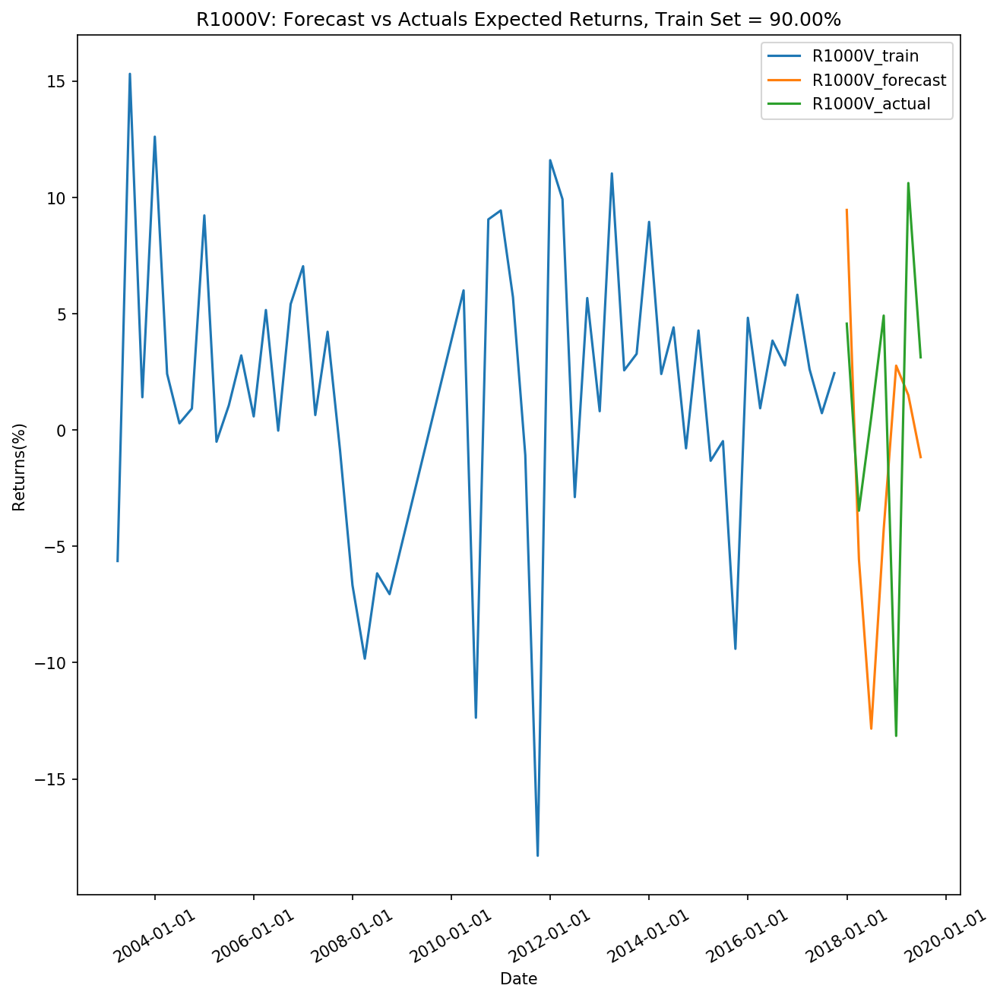

Forecast Accuracy of: R1000V
mape   :  4.4568
me     :  -2.4679
mae    :  8.4116
mpe    :  -3.9792
rmse   :  9.613
corr   :  0.0642


In [121]:
# Train Set = 90%
[model3_fitted_R1000V,df3_R1000V,df3_train_R1000V,df3_test_R1000V,date1] = VAR_Model(merge3_tested_R1000V,3,5,0.1)
[df3_forecast_R1000V,lag_order3_R1000V] = forecast_plot(model3_fitted_R1000V,df3_R1000V,df3_train_R1000V,df3_test_R1000V,date1,90)

print('Forecast Accuracy of: R1000V')
accuracy_prod = forecast_accuracy(df3_forecast_R1000V['R1000V_forecast'].values, df3_test_R1000V['R1000V'])

for k, v in accuracy_prod.items():
    print(adjust(k), ': ', round(v,4)) 

## Part Two: Global Indices VS Global Indicators

### 3. Global Indices

* ACWI Net TR USD 
* ACWI ex USA Net TR USD 
* MSCI EAFE Net TR USD

In [22]:
# Monthly Data
ACWI = pd.read_excel('historyIndex_MSCI.xls', skiprows=5,header=1,skipfooter=18)
ACWI = ACWI.set_index('Date')
ACWI_exUSA = pd.read_excel('historyIndex_MSCI ex USA.xls', skiprows=5,header=1,skipfooter=18)
ACWI_exUSA = ACWI_exUSA.set_index('Date')
EAFE = pd.read_excel('historyIndex_MSCI EAFE.xls', skiprows=5,header=1,skipfooter=18)
EAFE = EAFE.set_index('Date')
Indice_2 = pd.concat([ACWI,ACWI_exUSA,EAFE],join='inner',axis=1)
TR_2 = np.log(Indice_2).diff().dropna()

In [23]:
# Change frequency to monthly
TR_2_M = TR_2.resample('MS').sum()*100
# Change frequency to annually
TR_2_Y = TR_2.resample('YS').sum()*100
# Change frequency to quarterly
TR_2_Q = TR_2.resample('Q').sum()*100
TR_2_Y
TR_2_M
TR_2_Q

,ACWI Standard (Large+Mid Cap),ACWI ex USA Standard (Large+Mid Cap),EAFE Standard (Large+Mid Cap)
Date,,,
2001-01-01,-17.684458,-21.982407,-24.134144
2002-01-01,-21.464366,-16.190498,-17.363962
2003-01-01,29.257357,34.238513,32.631920
2004-01-01,14.179215,18.984796,18.437894
2005-01-01,10.287518,15.374012,12.694596
2006-01-01,19.024089,23.627618,23.381095
2007-01-01,11.031275,15.402586,10.588731
2008-01-01,-54.809543,-60.743316,-56.878083
2009-01-01,29.733124,34.676458,27.593434


,ACWI Standard (Large+Mid Cap),ACWI ex USA Standard (Large+Mid Cap),EAFE Standard (Large+Mid Cap)
Date,,,
2001-01-01,2.482919,1.482950,-0.051589
2001-02-01,-8.809918,-8.251965,-7.792647
2001-03-01,-7.007856,-7.379277,-6.898659
2001-04-01,6.990809,6.526041,6.718359
2001-05-01,-1.182203,-2.876030,-3.593168
2001-06-01,-3.141000,-3.949976,-4.175518
2001-07-01,-1.609420,-2.262334,-1.836245
2001-08-01,-4.740498,-2.537509,-2.566816
2001-09-01,-9.607513,-11.240150,-10.679162


,ACWI Standard (Large+Mid Cap),ACWI ex USA Standard (Large+Mid Cap),EAFE Standard (Large+Mid Cap)
Date,,,
2001-03-31,-13.334855,-14.148292,-14.742895
2001-06-30,2.667607,-0.299964,-1.050327
2001-09-30,-15.957430,-16.039992,-15.082222
2001-12-31,8.940221,8.505842,6.741301
2002-03-31,0.815370,1.567399,0.507157
2002-06-30,-9.515749,-2.855151,-2.142337
2002-09-30,-20.216324,-21.511794,-21.982144
2002-12-31,7.452337,6.609048,6.253363
2003-03-31,-5.230198,-7.680461,-8.570500


### 4.1 Leading Indicators

* CCI_OECD

,CCI_OECD
Date,
2015-01-01,0.69323
2015-02-01,0.75575
2015-03-01,0.72092
2015-04-01,0.62111
2015-05-01,0.52240
2015-06-01,0.47134
2015-07-01,0.39816
2015-08-01,0.32383
2015-09-01,0.27356


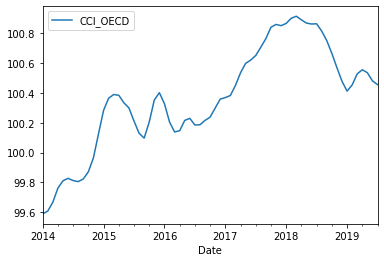

In [24]:
# indicators from OECD downloaded data
def OECD_Month(df,colname):
    df = df.drop(['LOCATION'],axis=1).rename(columns={'TIME':'Date','Value':colname})
    df['Date'] = pd.to_datetime(df['Date'])
    df = df.set_index('Date')
    df = df.asfreq(freq='MS',method='bfill')
    df.plot()
    return df
CCI = pd.read_csv("CCI.csv",usecols=[0,5,6])
CCI_OECD = CCI[CCI.LOCATION =='OECD'].reset_index(drop=True)
CCI_OECD = OECD_Month(CCI_OECD,'CCI_OECD')
# Eliminate seasonal effect
CCI_OECD = CCI_OECD.diff(periods=12).dropna()
CCI_OECD

In [25]:
merge4 = pd.concat([TR_2_M,CCI_OECD],join='inner',axis=1).reset_index()
merge4

,Date,ACWI Standard (Large+Mid Cap),ACWI ex USA Standard (Large+Mid Cap),EAFE Standard (Large+Mid Cap),CCI_OECD
0,2015-01-01,-1.575821,-0.148287,0.487645,0.69323
1,2015-02-01,5.417695,5.208461,5.806216,0.75575
2,2015-03-01,-1.561583,-1.629695,-1.530766,0.72092
3,2015-04-01,2.860148,4.928196,4.001753,0.62111
4,2015-05-01,-0.130563,-1.573472,-0.513193,0.52240
5,2015-06-01,-2.382347,-2.829764,-2.874268,0.47134
6,2015-07-01,0.864648,-0.278227,2.055070,0.39816
7,2015-08-01,-7.101387,-7.951185,-7.640913,0.32383
8,2015-09-01,-3.690154,-4.747652,-5.211017,0.27356
9,2015-10-01,7.555724,7.180210,7.526464,0.33295


0


[]

,Date,ACWI Standard (Large+Mid Cap),ACWI ex USA Standard (Large+Mid Cap),EAFE Standard (Large+Mid Cap),CCI_OECD
0,2015-01-01,-1.575821,-0.148287,0.487645,0.69323
1,2015-02-01,5.417695,5.208461,5.806216,0.75575
2,2015-03-01,-1.561583,-1.629695,-1.530766,0.72092
3,2015-04-01,2.860148,4.928196,4.001753,0.62111
4,2015-05-01,-0.130563,-1.573472,-0.513193,0.52240
5,2015-06-01,-2.382347,-2.829764,-2.874268,0.47134
6,2015-07-01,0.864648,-0.278227,2.055070,0.39816
7,2015-08-01,-7.101387,-7.951185,-7.640913,0.32383
8,2015-09-01,-3.690154,-4.747652,-5.211017,0.27356
9,2015-10-01,7.555724,7.180210,7.526464,0.33295


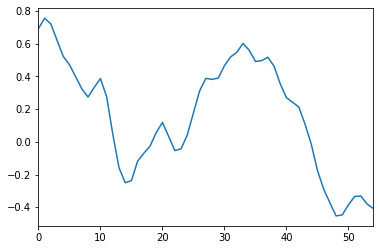

In [26]:
# ADF Test
merge4_diff = merge4.copy()

[index_remove4,merge4_differenced]=ADF_Test(merge4_diff)
index_remove4
merge4_differenced

#### 4.1.1 Forecast the returns for EAFE

In [27]:
# Granger Test
[causation_matrix,index_remove,merge4_tested] = causation_test(merge4_differenced,3,4)
causation_matrix
index_remove
merge4_tested

    EAFE Standard (Large+Mid Cap)   CCI_OECD
0                         0.487645   0.69323
1                         5.806216   0.75575
2                        -1.530766   0.72092
3                         4.001753   0.62111
4                        -0.513193   0.52240
5                        -2.874268   0.47134
6                         2.055070   0.39816
7                        -7.640913   0.32383
8                        -5.211017   0.27356
9                         7.526464   0.33295
10                       -1.567915   0.38703
11                       -1.356572   0.27540
12                       -7.506189   0.04480
13                       -1.849067  -0.15910
14                        6.303813  -0.25060
15                        2.853993  -0.23710
16                       -0.912559  -0.11810
17                       -3.414397  -0.06970
18                        4.943837  -0.02640
19                        0.070971   0.05670
20                        1.220947   0.11850
21        

,EAFE Standard (Large+Mid Cap) _x,CCI_OECD_x
EAFE Standard (Large+Mid Cap) _y,1.0000,0.0004
CCI_OECD_y,0.0003,1.0000


[]

,Date,ACWI Standard (Large+Mid Cap),ACWI ex USA Standard (Large+Mid Cap),EAFE Standard (Large+Mid Cap),CCI_OECD
0,2015-01-01,-1.575821,-0.148287,0.487645,0.69323
1,2015-02-01,5.417695,5.208461,5.806216,0.75575
2,2015-03-01,-1.561583,-1.629695,-1.530766,0.72092
3,2015-04-01,2.860148,4.928196,4.001753,0.62111
4,2015-05-01,-0.130563,-1.573472,-0.513193,0.52240
5,2015-06-01,-2.382347,-2.829764,-2.874268,0.47134
6,2015-07-01,0.864648,-0.278227,2.055070,0.39816
7,2015-08-01,-7.101387,-7.951185,-7.640913,0.32383
8,2015-09-01,-3.690154,-4.747652,-5.211017,0.27356
9,2015-10-01,7.555724,7.180210,7.526464,0.33295


  Summary of Regression Results   
Model:                         VAR
Method:                        OLS
Date:           Wed, 28, Aug, 2019
Time:                     09:25:31
--------------------------------------------------------------------
No. of Equations:         2.00000    BIC:                   -2.49775
Nobs:                     47.0000    HQIC:                  -3.03788
Log likelihood:          -32.3315    FPE:                  0.0352216
AIC:                     -3.36377    Det(Omega_mle):       0.0231286
--------------------------------------------------------------------
Results for equation EAFE Standard (Large+Mid Cap) 
                                       coefficient       std. error           t-stat            prob
----------------------------------------------------------------------------------------------------
const                                     1.656638         0.750079            2.209           0.027
L1.EAFE Standard (Large+Mid Cap)         -0.282179      

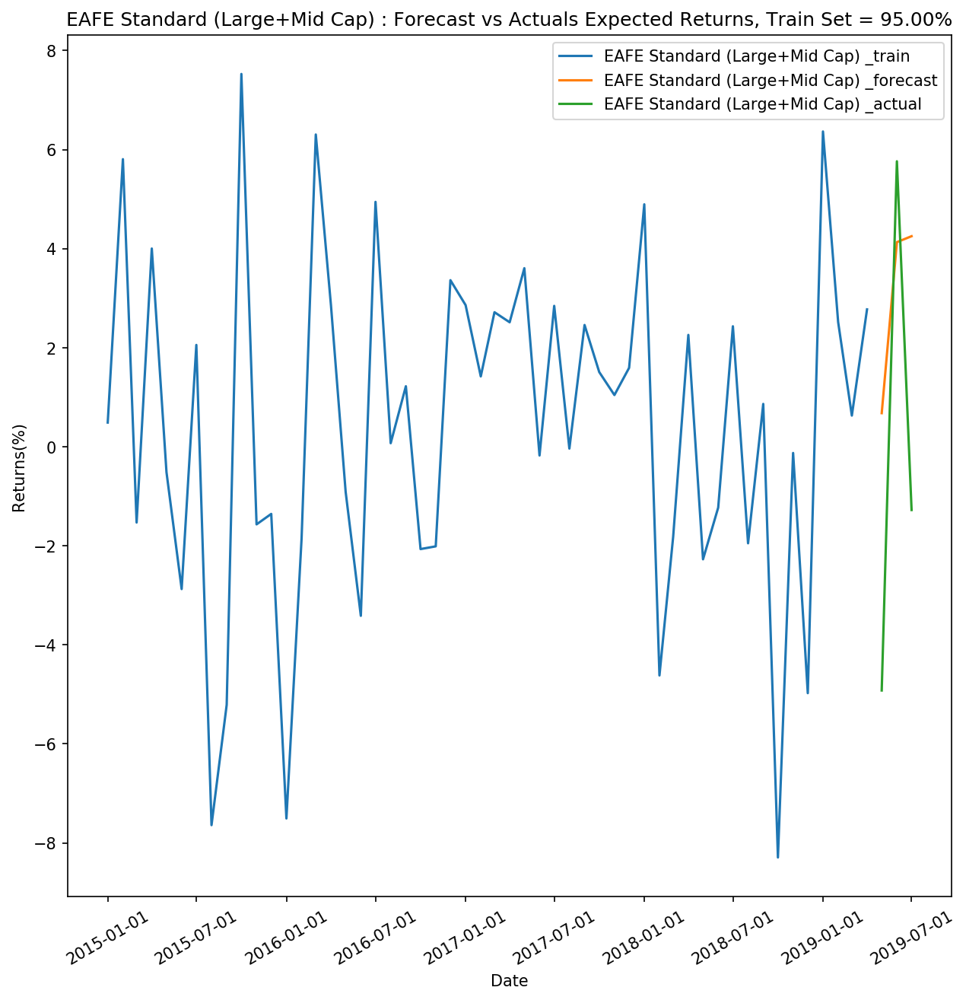

In [28]:
# Forecast, Train Set = 0.95
[model4_fitted,df4,df4_train,df4_test,date4] = VAR_Model(merge4_tested,3,4,0.05)
[df4_forecast,lag_order4] = forecast_plot(model4_fitted,df4,df4_train,df4_test,date4,95)

In [29]:
# Test the Accuracy
print('Forecast Accuracy of: EAFE')
accuracy_prod = forecast_accuracy(df4_forecast.iloc[:lag_order4,0].values, df4_test.iloc[:lag_order4,0])
for k, v in accuracy_prod.items():
    print(adjust(k), ': ', round(v,4))

print('\nForecast values are: ',df4_forecast.iloc[:lag_order4,0].values)
print('Actual values are: ',df4_test.iloc[:lag_order4,0].values)

Forecast Accuracy of: EAFE
mape   :  1.9158
me     :  3.1649
mae    :  4.2535
mpe    :  -1.9158
rmse   :  4.6397
corr   :  0.742

Forecast values are:  [0.6775173  4.1303368  4.25058198]
Actual values are:  [-4.92174274  5.76323401 -1.27781423]


  Summary of Regression Results   
Model:                         VAR
Method:                        OLS
Date:           Wed, 28, Aug, 2019
Time:                     09:25:37
--------------------------------------------------------------------
No. of Equations:         2.00000    BIC:                   -2.35283
Nobs:                     44.0000    HQIC:                  -2.91410
Log likelihood:          -31.4781    FPE:                  0.0398243
AIC:                     -3.24493    Det(Omega_mle):       0.0254875
--------------------------------------------------------------------
Results for equation EAFE Standard (Large+Mid Cap) 
                                       coefficient       std. error           t-stat            prob
----------------------------------------------------------------------------------------------------
const                                     1.279205         0.822279            1.556           0.120
L1.EAFE Standard (Large+Mid Cap)         -0.372530      

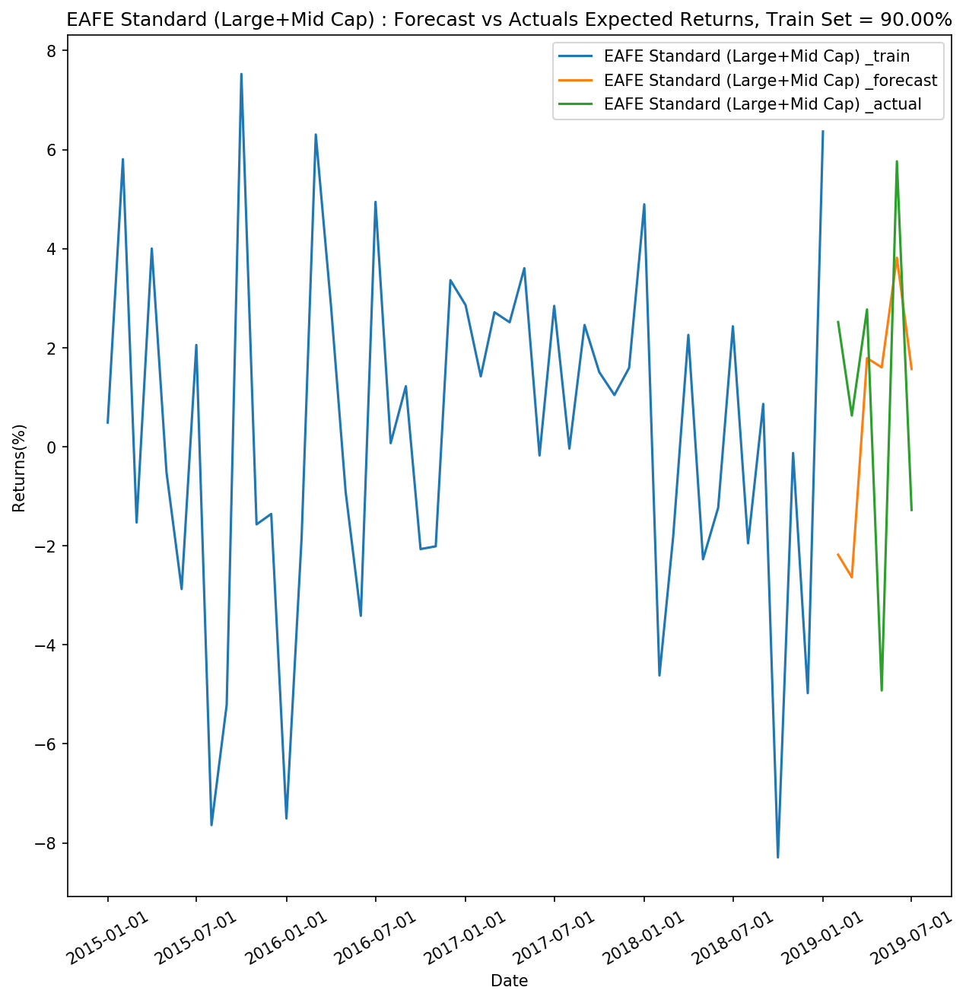

Forecast Accuracy of: EAFE
mape   :  1.8156
me     :  -0.8737
mae    :  3.4829
mpe    :  -1.8156
rmse   :  4.0007
corr   :  0.1977

Forecast values are:  [-2.18006958 -2.63657643  1.79017659  1.60116276  3.81665937]
Actual values are:  [ 2.51718395  0.62859873  2.77273171 -4.92174274  5.76323401]


In [30]:
# Train Set = 0.9
[model4_fitted,df4,df4_train,df4_test,date4] = VAR_Model(merge4_tested,3,4,0.1)
[df4_forecast,lag_order4] = forecast_plot(model4_fitted,df4,df4_train,df4_test,date4,90)

print('Forecast Accuracy of: EAFE')
accuracy_prod = forecast_accuracy(df4_forecast.iloc[:lag_order4,0].values, df4_test.iloc[:lag_order4,0])
for k, v in accuracy_prod.items():
    print(adjust(k), ': ', round(v,4))

print('\nForecast values are: ',df4_forecast.iloc[:lag_order4,0].values)
print('Actual values are: ',df4_test.iloc[:lag_order4,0].values)

  Summary of Regression Results   
Model:                         VAR
Method:                        OLS
Date:           Wed, 28, Aug, 2019
Time:                     09:25:41
--------------------------------------------------------------------
No. of Equations:         2.00000    BIC:                   -2.43743
Nobs:                     39.0000    HQIC:                  -3.03915
Log likelihood:          -22.8482    FPE:                  0.0352808
AIC:                     -3.37585    Det(Omega_mle):       0.0214648
--------------------------------------------------------------------
Results for equation EAFE Standard (Large+Mid Cap) 
                                       coefficient       std. error           t-stat            prob
----------------------------------------------------------------------------------------------------
const                                     1.482381         0.833605            1.778           0.075
L1.EAFE Standard (Large+Mid Cap)         -0.247958      

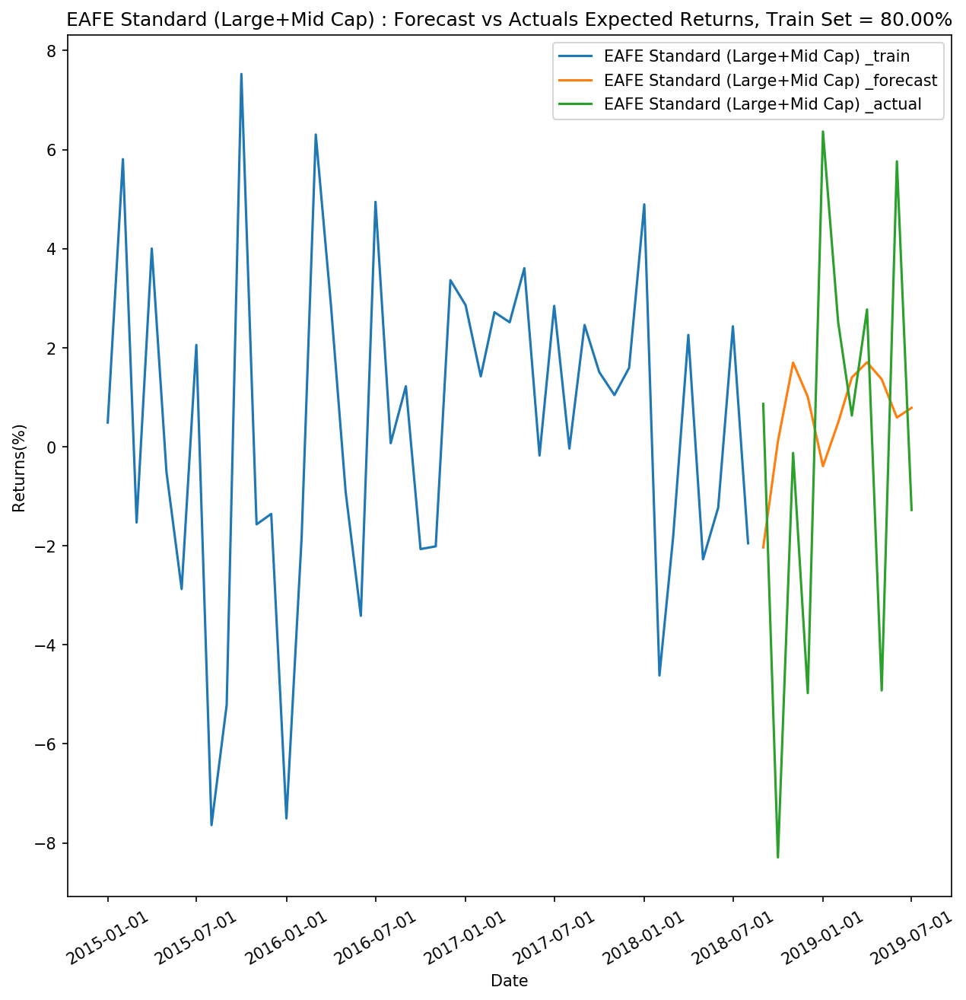

Forecast Accuracy of: EAFE
mape   :  4.2196
me     :  1.311
mae    :  5.1736
mpe    :  -4.2196
rmse   :  5.7242
corr   :  -0.3077

Forecast values are:  [-2.03412734  0.11007279  1.69799491  1.00758848 -0.39316147]
Actual values are:  [ 0.86413581 -8.29383393 -0.12609051 -4.97616222  6.36507381]


In [31]:
# Train Set = 0.8
[model4_fitted,df4,df4_train,df4_test,date4] = VAR_Model(merge4_tested,3,4,0.2)
[df4_forecast,lag_order4] = forecast_plot(model4_fitted,df4,df4_train,df4_test,date4,80)

print('Forecast Accuracy of: EAFE')
accuracy_prod = forecast_accuracy(df4_forecast.iloc[:lag_order4,0].values, df4_test.iloc[:lag_order4,0])
for k, v in accuracy_prod.items():
    print(adjust(k), ': ', round(v,4))

print('\nForecast values are: ',df4_forecast.iloc[:lag_order4,0].values)
print('Actual values are: ',df4_test.iloc[:lag_order4,0].values)

  Summary of Regression Results   
Model:                         VAR
Method:                        OLS
Date:           Wed, 28, Aug, 2019
Time:                     14:10:54
--------------------------------------------------------------------
No. of Equations:         2.00000    BIC:                   -2.09311
Nobs:                     33.0000    HQIC:                  -2.75510
Log likelihood:          -20.6520    FPE:                  0.0479391
AIC:                     -3.09079    Det(Omega_mle):       0.0269657
--------------------------------------------------------------------
Results for equation EAFE Standard (Large+Mid Cap) 
                                       coefficient       std. error           t-stat            prob
----------------------------------------------------------------------------------------------------
const                                     1.475946         0.920667            1.603           0.109
L1.EAFE Standard (Large+Mid Cap)         -0.253641      

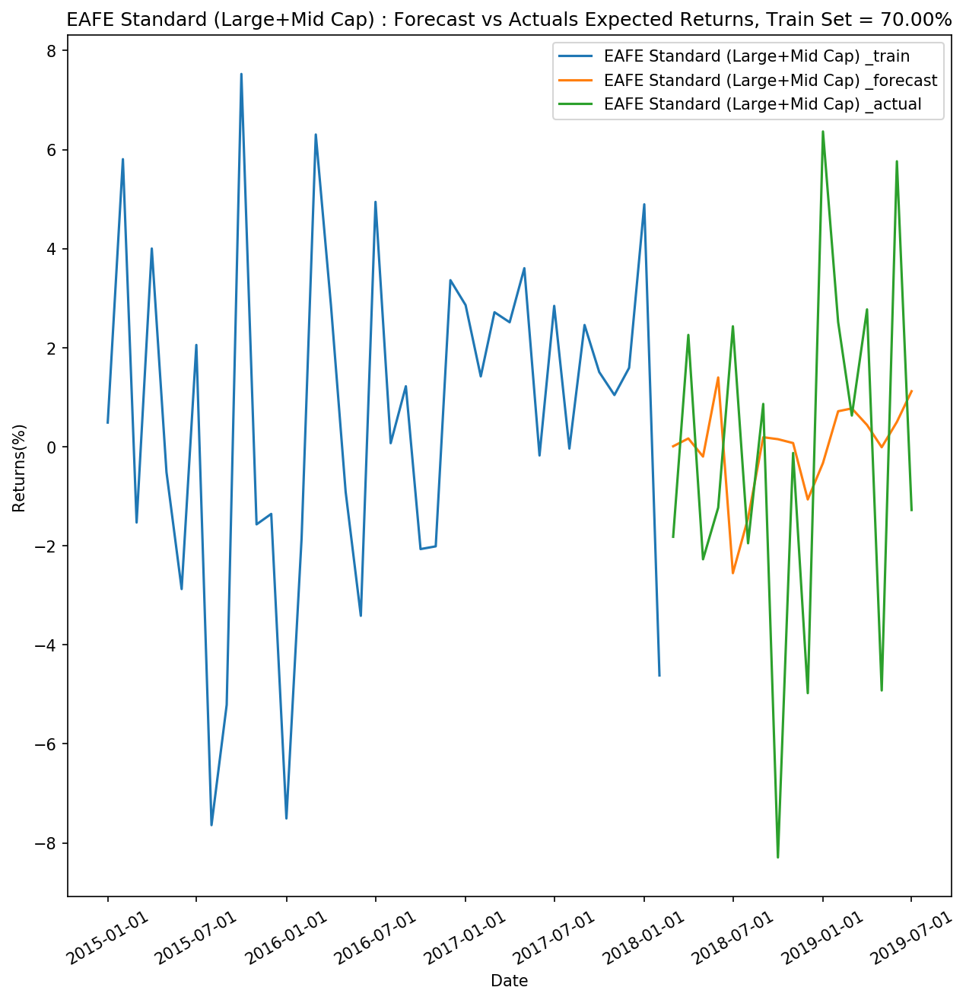

Forecast Accuracy of: EAFE
mape   :  1.4062
me     :  -0.1093
mae    :  2.721
mpe    :  -1.4062
rmse   :  2.9586
corr   :  -0.5524

Forecast values are:  [ 0.00860353  0.16673118 -0.19945028  1.39849551 -2.55321543]
Actual values are:  [-1.81880153  2.25759047 -2.27344451 -1.22924821  2.43172185]


In [123]:
# Train Set = 0.7
[model4_fitted,df4,df4_train,df4_test,date4] = VAR_Model(merge4_tested,3,4,0.3)
[df4_forecast,lag_order4] = forecast_plot(model4_fitted,df4,df4_train,df4_test,date4,70)

print('Forecast Accuracy of: EAFE')
accuracy_prod = forecast_accuracy(df4_forecast.iloc[:lag_order4,0].values, df4_test.iloc[:lag_order4,0])
for k, v in accuracy_prod.items():
    print(adjust(k), ': ', round(v,4))

print('\nForecast values are: ',df4_forecast.iloc[:lag_order4,0].values)
print('Actual values are: ',df4_test.iloc[:lag_order4,0].values)

#### 4.1.2 Forecast the returns for ACWI

    ACWI Standard (Large+Mid Cap)   CCI_OECD
0                        -1.575821   0.69323
1                         5.417695   0.75575
2                        -1.561583   0.72092
3                         2.860148   0.62111
4                        -0.130563   0.52240
5                        -2.382347   0.47134
6                         0.864648   0.39816
7                        -7.101387   0.32383
8                        -3.690154   0.27356
9                         7.555724   0.33295
10                       -0.829184   0.38703
11                       -1.819871   0.27540
12                       -6.220588   0.04480
13                       -0.690262  -0.15910
14                        7.149027  -0.25060
15                        1.465346  -0.23710
16                        0.125949  -0.11810
17                       -0.607186  -0.06970
18                        4.219109  -0.02640
19                        0.335869   0.05670
20                        0.610807   0.11850
21        

,ACWI Standard (Large+Mid Cap) _x,CCI_OECD_x
ACWI Standard (Large+Mid Cap) _y,1.0,0.0005
CCI_OECD_y,0.0,1.0000


[]

,Date,ACWI Standard (Large+Mid Cap),ACWI ex USA Standard (Large+Mid Cap),EAFE Standard (Large+Mid Cap),CCI_OECD
0,2015-01-01,-1.575821,-0.148287,0.487645,0.69323
1,2015-02-01,5.417695,5.208461,5.806216,0.75575
2,2015-03-01,-1.561583,-1.629695,-1.530766,0.72092
3,2015-04-01,2.860148,4.928196,4.001753,0.62111
4,2015-05-01,-0.130563,-1.573472,-0.513193,0.52240
5,2015-06-01,-2.382347,-2.829764,-2.874268,0.47134
6,2015-07-01,0.864648,-0.278227,2.055070,0.39816
7,2015-08-01,-7.101387,-7.951185,-7.640913,0.32383
8,2015-09-01,-3.690154,-4.747652,-5.211017,0.27356
9,2015-10-01,7.555724,7.180210,7.526464,0.33295


  Summary of Regression Results   
Model:                         VAR
Method:                        OLS
Date:           Wed, 28, Aug, 2019
Time:                     09:25:49
--------------------------------------------------------------------
No. of Equations:         2.00000    BIC:                   -2.91667
Nobs:                     49.0000    HQIC:                  -3.25212
Log likelihood:          -40.3548    FPE:                  0.0316424
AIC:                     -3.45719    Det(Omega_mle):       0.0242262
--------------------------------------------------------------------
Results for equation ACWI Standard (Large+Mid Cap) 
                                       coefficient       std. error           t-stat            prob
----------------------------------------------------------------------------------------------------
const                                     1.553425         0.693076            2.241           0.025
L1.ACWI Standard (Large+Mid Cap)         -0.207692      

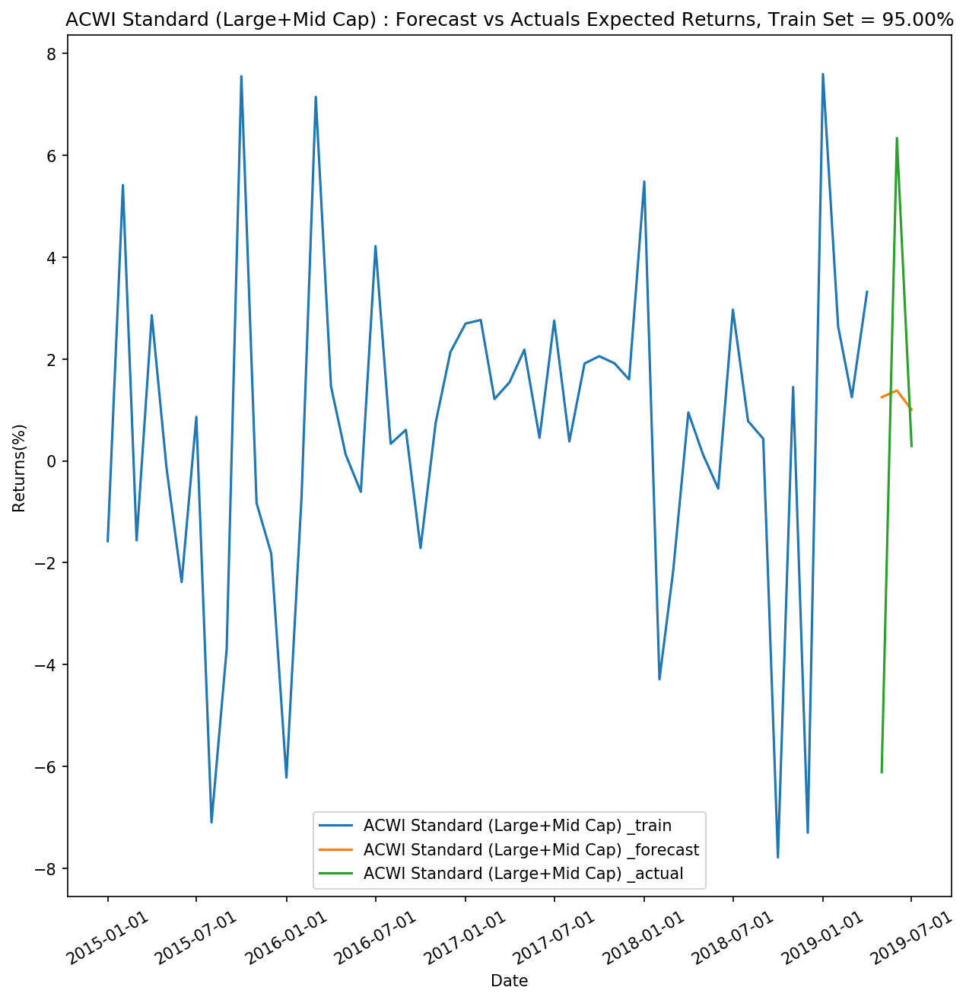

Forecast Accuracy of: ACWI
mape   :  1.474
me     :  1.0395
mae    :  4.3463
mpe    :  0.1495
rmse   :  5.1439
corr   :  0.3257

Forecast values are:  [1.25142866 1.38240383 1.0044908 ]
Actual values are:  [-6.115188    6.34269478  0.2924097 ]


In [32]:
[causation_matrix,index_remove,merge4_tested_ACWI] = causation_test(merge4_differenced,1,4)
causation_matrix
index_remove
merge4_tested_ACWI

# Train Set = 0.95
[model4_fitted_ACWI,df4_ACWI,df4_train_ACWI,df4_test_ACWI,date1] = VAR_Model(merge4_tested_ACWI,1,4,0.05)
[df4_forecast_ACWI,lag_order4_ACWI] = forecast_plot(model4_fitted_ACWI,df4_ACWI,df4_train_ACWI,df4_test_ACWI,date1,95)

print('Forecast Accuracy of: ACWI')
accuracy_prod = forecast_accuracy(df4_forecast_ACWI.iloc[:lag_order4_ACWI,0].values, df4_test_ACWI.iloc[:lag_order4_ACWI,0])

for k, v in accuracy_prod.items():
    print(adjust(k), ': ', round(v,4)) 

print('\nForecast values are: ',df4_forecast_ACWI.iloc[:lag_order4_ACWI,0].values)
print('Actual values are: ',df4_test_ACWI.iloc[:lag_order4_ACWI,0].values)

  Summary of Regression Results   
Model:                         VAR
Method:                        OLS
Date:           Wed, 28, Aug, 2019
Time:                     09:25:54
--------------------------------------------------------------------
No. of Equations:         2.00000    BIC:                   -2.79459
Nobs:                     46.0000    HQIC:                  -3.14265
Log likelihood:          -39.4662    FPE:                  0.0352119
AIC:                     -3.35114    Det(Omega_mle):       0.0265249
--------------------------------------------------------------------
Results for equation ACWI Standard (Large+Mid Cap) 
                                       coefficient       std. error           t-stat            prob
----------------------------------------------------------------------------------------------------
const                                     1.248565         0.761854            1.639           0.101
L1.ACWI Standard (Large+Mid Cap)         -0.261752      

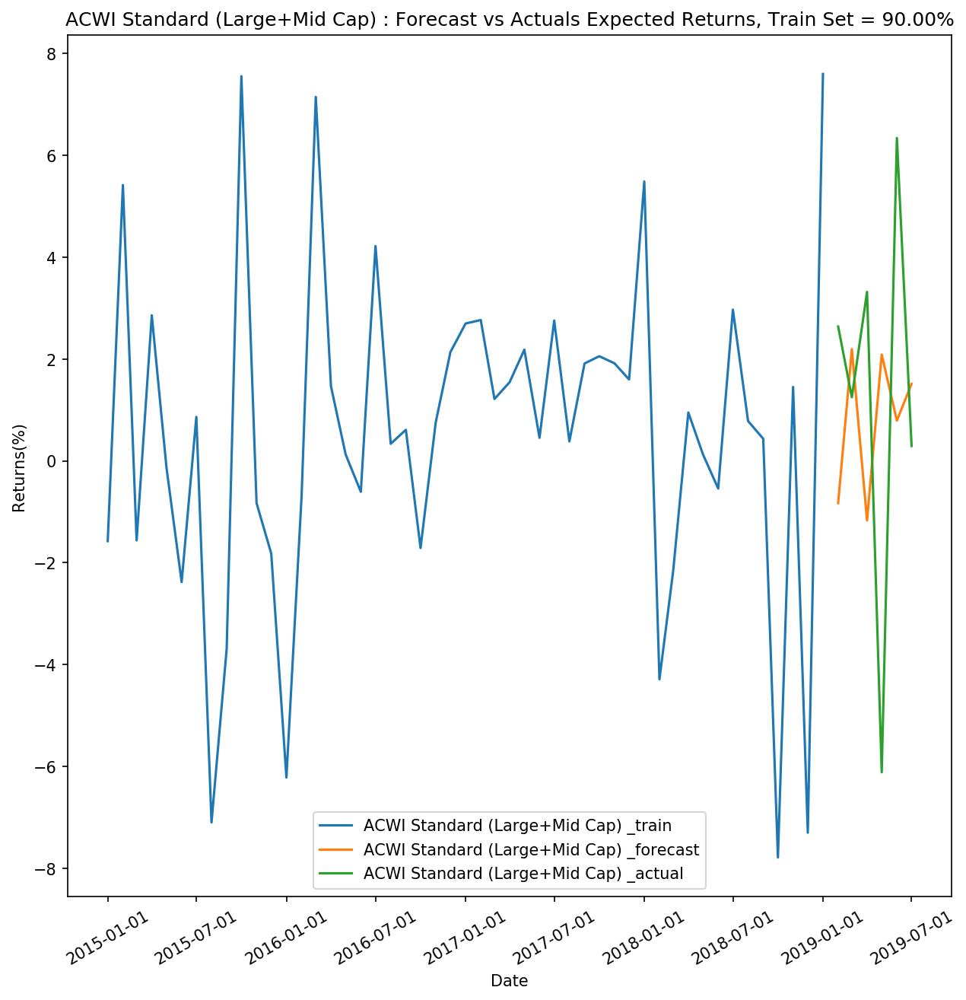

Forecast Accuracy of: ACWI
mape   :  1.1415
me     :  -2.3385
mae    :  2.9693
mpe    :  -0.6366
rmse   :  3.3221
corr   :  -0.972

Forecast values are:  [-0.83149292  2.19558897 -1.16956093]
Actual values are:  [2.63971887 1.2494179  3.32098662]


In [33]:
# Train Set = 0.9
[model4_fitted_ACWI,df4_ACWI,df4_train_ACWI,df4_test_ACWI,date1] = VAR_Model(merge4_tested_ACWI,1,4,0.1)
[df4_forecast_ACWI,lag_order4_ACWI] = forecast_plot(model4_fitted_ACWI,df4_ACWI,df4_train_ACWI,df4_test_ACWI,date1,90)

print('Forecast Accuracy of: ACWI')
accuracy_prod = forecast_accuracy(df4_forecast_ACWI.iloc[:lag_order4_ACWI,0].values, df4_test_ACWI.iloc[:lag_order4_ACWI,0])

for k, v in accuracy_prod.items():
    print(adjust(k), ': ', round(v,4)) 

print('\nForecast values are: ',df4_forecast_ACWI.iloc[:lag_order4_ACWI,0].values)
print('Actual values are: ',df4_test_ACWI.iloc[:lag_order4_ACWI,0].values)

  Summary of Regression Results   
Model:                         VAR
Method:                        OLS
Date:           Wed, 28, Aug, 2019
Time:                     09:25:59
--------------------------------------------------------------------
No. of Equations:         2.00000    BIC:                   -2.78653
Nobs:                     40.0000    HQIC:                  -3.27174
Log likelihood:          -24.5845    FPE:                  0.0292796
AIC:                     -3.54653    Det(Omega_mle):       0.0195116
--------------------------------------------------------------------
Results for equation ACWI Standard (Large+Mid Cap) 
                                       coefficient       std. error           t-stat            prob
----------------------------------------------------------------------------------------------------
const                                     1.780586         0.807548            2.205           0.027
L1.ACWI Standard (Large+Mid Cap)         -0.122967      

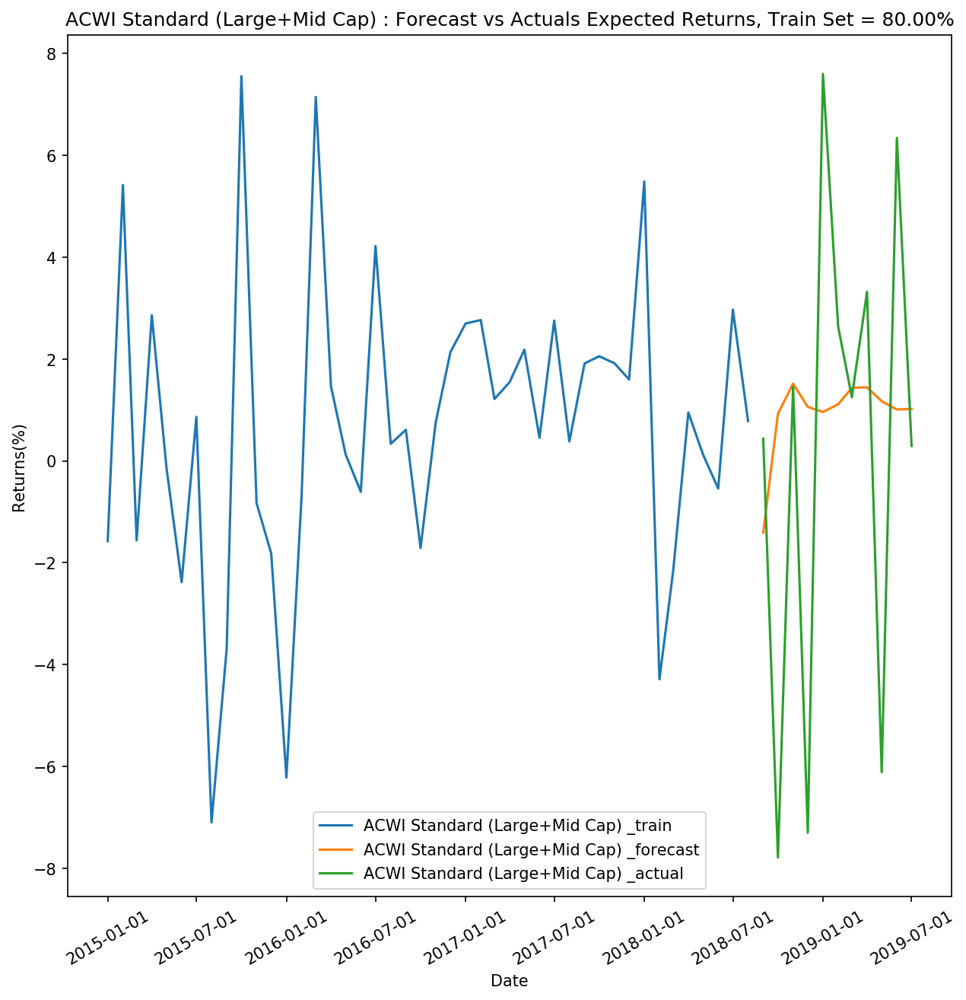

Forecast Accuracy of: ACWI
mape   :  1.6381
me     :  3.8249
mae    :  4.7467
mpe    :  -1.6157
rmse   :  6.1094
corr   :  -0.3325

Forecast values are:  [-1.40922335  0.92582846  1.51693012  1.05921216]
Actual values are:  [ 0.43444064 -7.78954551  1.45192961 -7.30372614]


In [34]:
# Train Set = 80%
[model4_fitted_ACWI,df4_ACWI,df4_train_ACWI,df4_test_ACWI,date1] = VAR_Model(merge4_tested_ACWI,1,4,0.2)
[df4_forecast_ACWI,lag_order4_ACWI] = forecast_plot(model4_fitted_ACWI,df4_ACWI,df4_train_ACWI,df4_test_ACWI,date1,80)

print('Forecast Accuracy of: ACWI')
accuracy_prod = forecast_accuracy(df4_forecast_ACWI.iloc[:lag_order4_ACWI,0].values, df4_test_ACWI.iloc[:lag_order4_ACWI,0])

for k, v in accuracy_prod.items():
    print(adjust(k), ': ', round(v,4)) 

print('\nForecast values are: ',df4_forecast_ACWI.iloc[:lag_order4_ACWI,0].values)
print('Actual values are: ',df4_test_ACWI.iloc[:lag_order4_ACWI,0].values)

  Summary of Regression Results   
Model:                         VAR
Method:                        OLS
Date:           Wed, 28, Aug, 2019
Time:                     14:15:04
--------------------------------------------------------------------
No. of Equations:         2.00000    BIC:                   -2.69632
Nobs:                     35.0000    HQIC:                  -3.10370
Log likelihood:          -27.2526    FPE:                  0.0366064
AIC:                     -3.31846    Det(Omega_mle):       0.0254211
--------------------------------------------------------------------
Results for equation ACWI Standard (Large+Mid Cap) 
                                       coefficient       std. error           t-stat            prob
----------------------------------------------------------------------------------------------------
const                                     1.476494         0.862851            1.711           0.087
L1.ACWI Standard (Large+Mid Cap)         -0.101947      

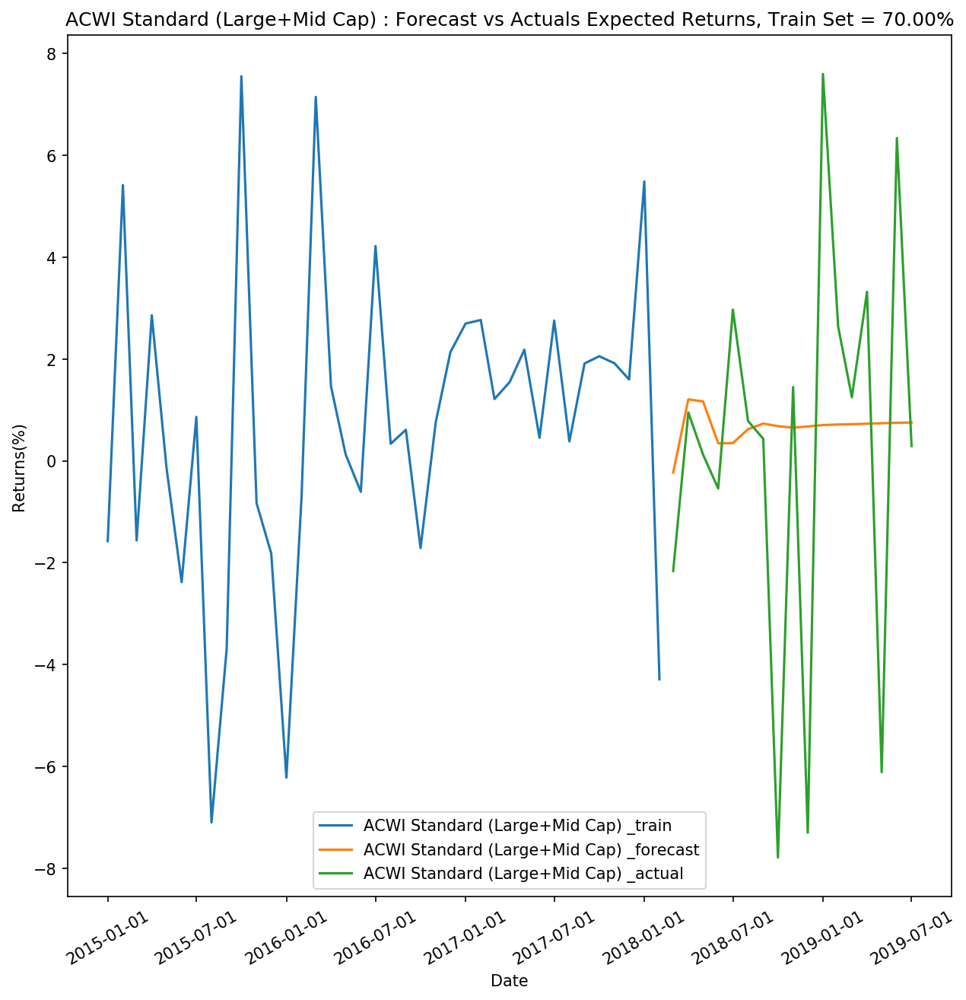

Forecast Accuracy of: ACWI
mape   :  3.1774
me     :  1.0777
mae    :  1.0777
mpe    :  2.5821
rmse   :  1.2763
corr   :  0.9728

Forecast values are:  [-0.23180749  1.20836184  1.16766788]
Actual values are:  [-2.16377076  0.9503082   0.12464855]


In [124]:
# Train Set = 70%
[model4_fitted_ACWI,df4_ACWI,df4_train_ACWI,df4_test_ACWI,date1] = VAR_Model(merge4_tested_ACWI,1,4,0.3)
[df4_forecast_ACWI,lag_order4_ACWI] = forecast_plot(model4_fitted_ACWI,df4_ACWI,df4_train_ACWI,df4_test_ACWI,date1,70)

print('Forecast Accuracy of: ACWI')
accuracy_prod = forecast_accuracy(df4_forecast_ACWI.iloc[:lag_order4_ACWI,0].values, df4_test_ACWI.iloc[:lag_order4_ACWI,0])

for k, v in accuracy_prod.items():
    print(adjust(k), ': ', round(v,4)) 

print('\nForecast values are: ',df4_forecast_ACWI.iloc[:lag_order4_ACWI,0].values)
print('Actual values are: ',df4_test_ACWI.iloc[:lag_order4_ACWI,0].values)

#### 4.1.3 Forecast the returns for ACWI ex USA

    ACWI ex USA Standard (Large+Mid Cap)   CCI_OECD
0                               -0.148287   0.69323
1                                5.208461   0.75575
2                               -1.629695   0.72092
3                                4.928196   0.62111
4                               -1.573472   0.52240
5                               -2.829764   0.47134
6                               -0.278227   0.39816
7                               -7.951185   0.32383
8                               -4.747652   0.27356
9                                7.180210   0.33295
10                              -2.085747   0.38703
11                              -1.901501   0.27540
12                              -7.044573   0.04480
13                              -1.149534  -0.15910
14                               7.817312  -0.25060
15                               2.597406  -0.23710
16                              -1.702076  -0.11810
17                              -1.541951  -0.06970
18          

,ACWI ex USA Standard (Large+Mid Cap) _x,CCI_OECD_x
ACWI ex USA Standard (Large+Mid Cap) _y,1.0000,0.0003
CCI_OECD_y,0.0004,1.0000


[]

,Date,ACWI Standard (Large+Mid Cap),ACWI ex USA Standard (Large+Mid Cap),EAFE Standard (Large+Mid Cap),CCI_OECD
0,2015-01-01,-1.575821,-0.148287,0.487645,0.69323
1,2015-02-01,5.417695,5.208461,5.806216,0.75575
2,2015-03-01,-1.561583,-1.629695,-1.530766,0.72092
3,2015-04-01,2.860148,4.928196,4.001753,0.62111
4,2015-05-01,-0.130563,-1.573472,-0.513193,0.52240
5,2015-06-01,-2.382347,-2.829764,-2.874268,0.47134
6,2015-07-01,0.864648,-0.278227,2.055070,0.39816
7,2015-08-01,-7.101387,-7.951185,-7.640913,0.32383
8,2015-09-01,-3.690154,-4.747652,-5.211017,0.27356
9,2015-10-01,7.555724,7.180210,7.526464,0.33295


  Summary of Regression Results   
Model:                         VAR
Method:                        OLS
Date:           Wed, 28, Aug, 2019
Time:                     09:26:07
--------------------------------------------------------------------
No. of Equations:         2.00000    BIC:                   -2.45177
Nobs:                     47.0000    HQIC:                  -2.99191
Log likelihood:          -33.4119    FPE:                  0.0368787
AIC:                     -3.31780    Det(Omega_mle):       0.0242167
--------------------------------------------------------------------
Results for equation ACWI ex USA Standard (Large+Mid Cap) 
                                              coefficient       std. error           t-stat            prob
-----------------------------------------------------------------------------------------------------------
const                                            1.826553         0.786229            2.323           0.020
L1.ACWI ex USA Standard (Lar

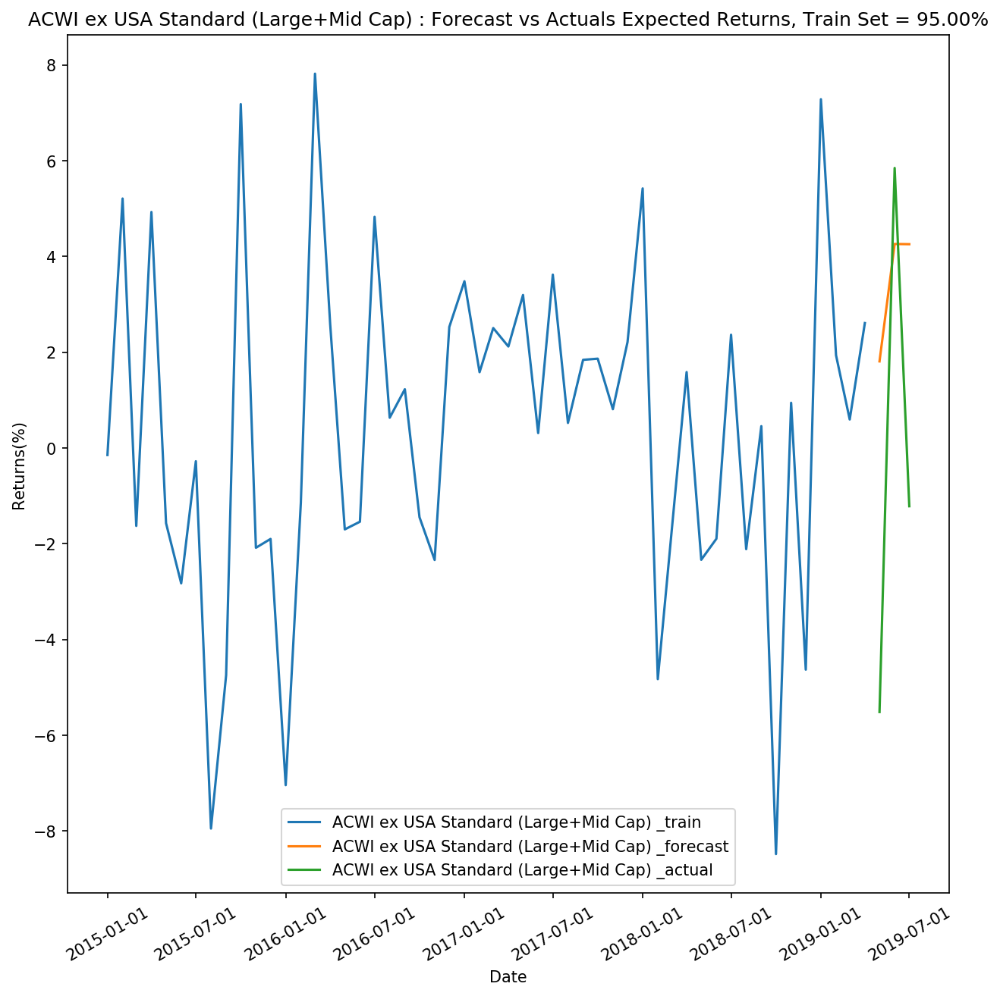

Forecast Accuracy of: ACWI_exUSA
mape   :  2.0312
me     :  3.7364
mae    :  4.7948
mpe    :  -2.0312
rmse   :  5.3576
corr   :  0.789


In [35]:
[causation_matrix,index_remove,merge4_tested_ACWI_exUSA] = causation_test(merge4_differenced,2,4)
causation_matrix
index_remove
merge4_tested_ACWI_exUSA

# Train Set = 95%

[model4_fitted_ACWI_exUSA,df4_ACWI_exUSA,df4_train_ACWI_exUSA,df4_test_ACWI_exUSA,date1] = VAR_Model(merge4_tested_ACWI_exUSA,2,4,0.05)
[df4_forecast_ACWI_exUSA,lag_order4_ACWI_exUSA] = forecast_plot(model4_fitted_ACWI_exUSA,df4_ACWI_exUSA,df4_train_ACWI_exUSA,df4_test_ACWI_exUSA,date1,95)

print('Forecast Accuracy of: ACWI_exUSA')
accuracy_prod = forecast_accuracy(df4_forecast_ACWI_exUSA.iloc[:lag_order4_ACWI_exUSA,0].values, df4_test_ACWI_exUSA.iloc[:lag_order4_ACWI_exUSA,0])

for k, v in accuracy_prod.items():
    print(adjust(k), ': ', round(v,4)) 

  Summary of Regression Results   
Model:                         VAR
Method:                        OLS
Date:           Wed, 28, Aug, 2019
Time:                     09:26:16
--------------------------------------------------------------------
No. of Equations:         2.00000    BIC:                   -2.26967
Nobs:                     44.0000    HQIC:                  -2.83093
Log likelihood:          -33.3078    FPE:                  0.0432780
AIC:                     -3.16176    Det(Omega_mle):       0.0276979
--------------------------------------------------------------------
Results for equation ACWI ex USA Standard (Large+Mid Cap) 
                                              coefficient       std. error           t-stat            prob
-----------------------------------------------------------------------------------------------------------
const                                            1.628315         0.868455            1.875           0.061
L1.ACWI ex USA Standard (Lar

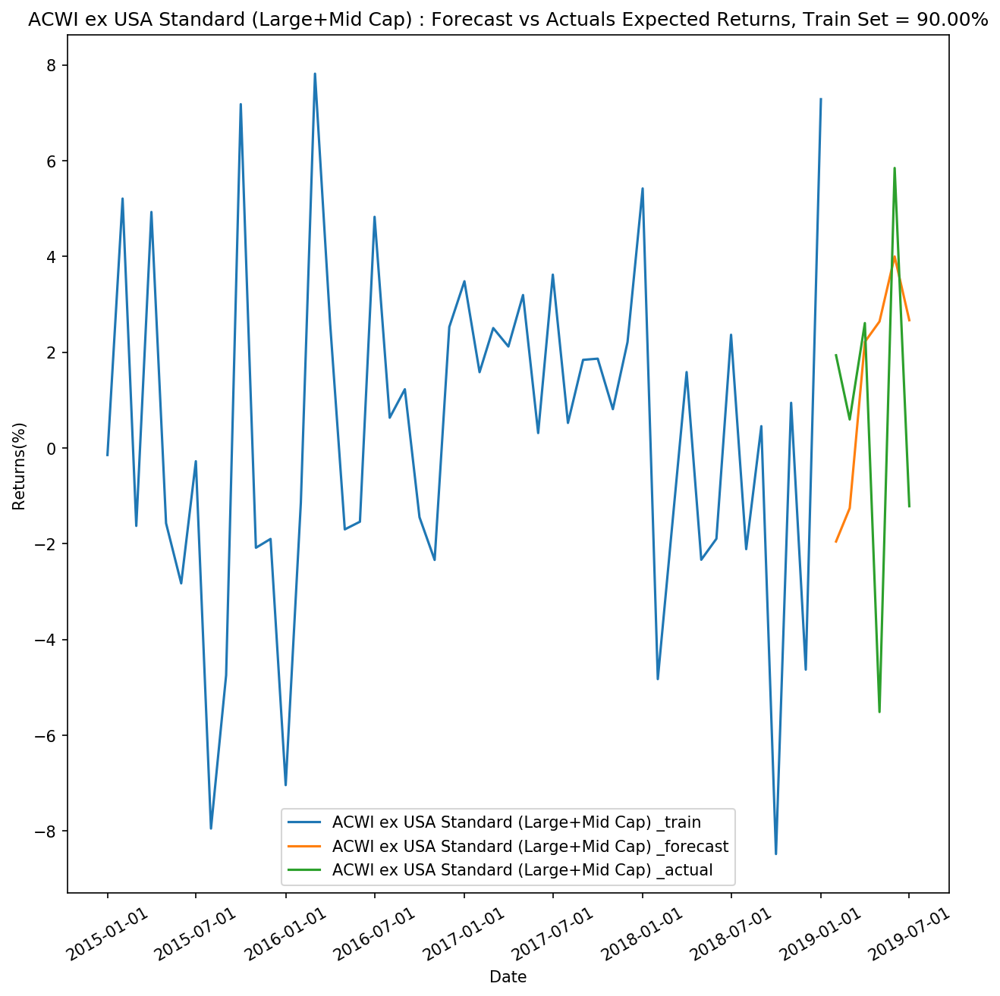

Forecast Accuracy of: ACWI_exUSA
mape   :  1.4151
me     :  0.0345
mae    :  3.2283
mpe    :  -1.4151
rmse   :  4.2114
corr   :  0.09


In [36]:
# Train Set = 90%
[model4_fitted_ACWI_exUSA,df4_ACWI_exUSA,df4_train_ACWI_exUSA,df4_test_ACWI_exUSA,date1] = VAR_Model(merge4_tested_ACWI_exUSA,2,4,0.1)
[df4_forecast_ACWI_exUSA,lag_order4_ACWI_exUSA] = forecast_plot(model4_fitted_ACWI_exUSA,df4_ACWI_exUSA,df4_train_ACWI_exUSA,df4_test_ACWI_exUSA,date1,90)

print('Forecast Accuracy of: ACWI_exUSA')
accuracy_prod = forecast_accuracy(df4_forecast_ACWI_exUSA.iloc[:lag_order4_ACWI_exUSA,0].values, df4_test_ACWI_exUSA.iloc[:lag_order4_ACWI_exUSA,0])

for k, v in accuracy_prod.items():
    print(adjust(k), ': ', round(v,4)) 

  Summary of Regression Results   
Model:                         VAR
Method:                        OLS
Date:           Wed, 28, Aug, 2019
Time:                     09:26:20
--------------------------------------------------------------------
No. of Equations:         2.00000    BIC:                   -2.41368
Nobs:                     39.0000    HQIC:                  -3.01540
Log likelihood:          -23.3112    FPE:                  0.0361286
AIC:                     -3.35210    Det(Omega_mle):       0.0219807
--------------------------------------------------------------------
Results for equation ACWI ex USA Standard (Large+Mid Cap) 
                                              coefficient       std. error           t-stat            prob
-----------------------------------------------------------------------------------------------------------
const                                            1.650367         0.866138            1.905           0.057
L1.ACWI ex USA Standard (Lar

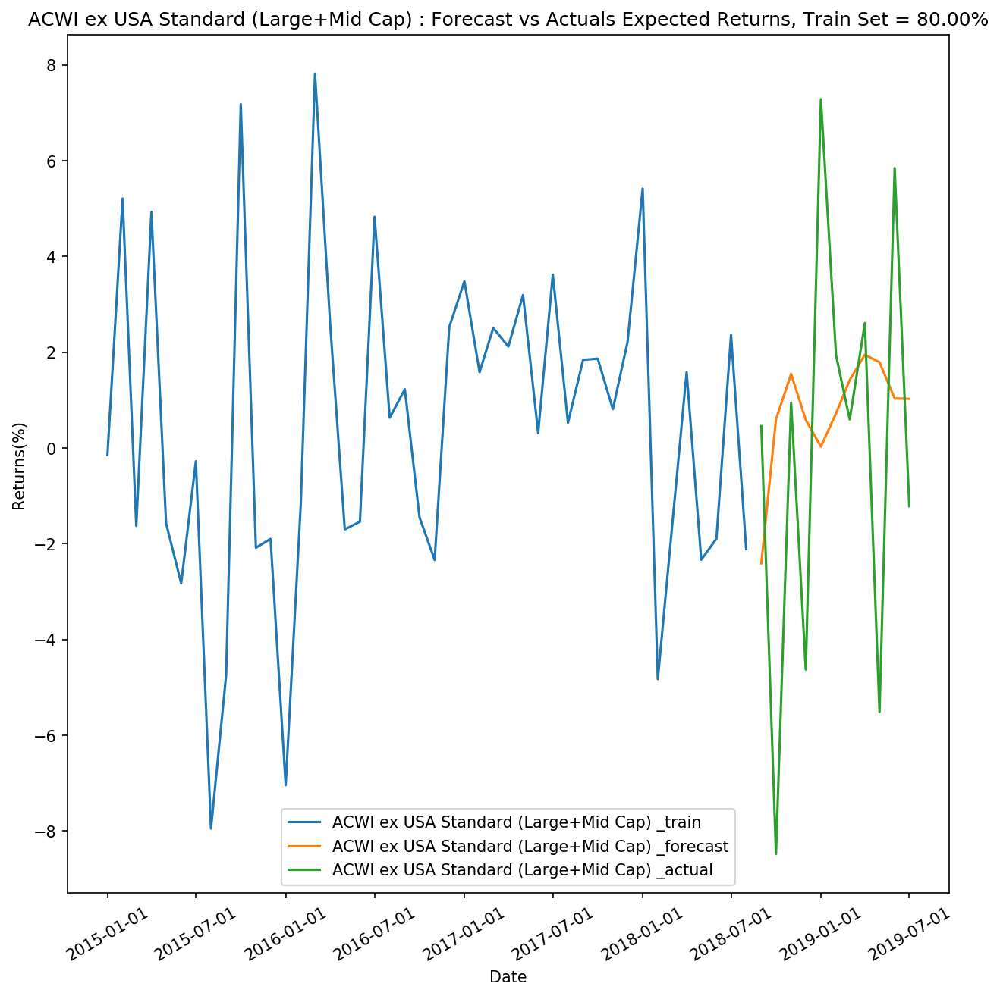

Forecast Accuracy of: ACWI_exUSA
mape   :  2.0273
me     :  0.9546
mae    :  5.0042
mpe    :  -1.7718
rmse   :  5.8462
corr   :  -0.1937


In [37]:
# Train Set = 80%
[model4_fitted_ACWI_exUSA,df4_ACWI_exUSA,df4_train_ACWI_exUSA,df4_test_ACWI_exUSA,date1] = VAR_Model(merge4_tested_ACWI_exUSA,2,4,0.2)
[df4_forecast_ACWI_exUSA,lag_order4_ACWI_exUSA] = forecast_plot(model4_fitted_ACWI_exUSA,df4_ACWI_exUSA,df4_train_ACWI_exUSA,df4_test_ACWI_exUSA,date1,80)

print('Forecast Accuracy of: ACWI_exUSA')
accuracy_prod = forecast_accuracy(df4_forecast_ACWI_exUSA.iloc[:lag_order4_ACWI_exUSA,0].values, df4_test_ACWI_exUSA.iloc[:lag_order4_ACWI_exUSA,0])

for k, v in accuracy_prod.items():
    print(adjust(k), ': ', round(v,4)) 

  Summary of Regression Results   
Model:                         VAR
Method:                        OLS
Date:           Wed, 28, Aug, 2019
Time:                     14:29:22
--------------------------------------------------------------------
No. of Equations:         2.00000    BIC:                   -2.05429
Nobs:                     33.0000    HQIC:                  -2.71627
Log likelihood:          -21.2926    FPE:                  0.0498370
AIC:                     -3.05196    Det(Omega_mle):       0.0280333
--------------------------------------------------------------------
Results for equation ACWI ex USA Standard (Large+Mid Cap) 
                                              coefficient       std. error           t-stat            prob
-----------------------------------------------------------------------------------------------------------
const                                            1.672989         0.960497            1.742           0.082
L1.ACWI ex USA Standard (Lar

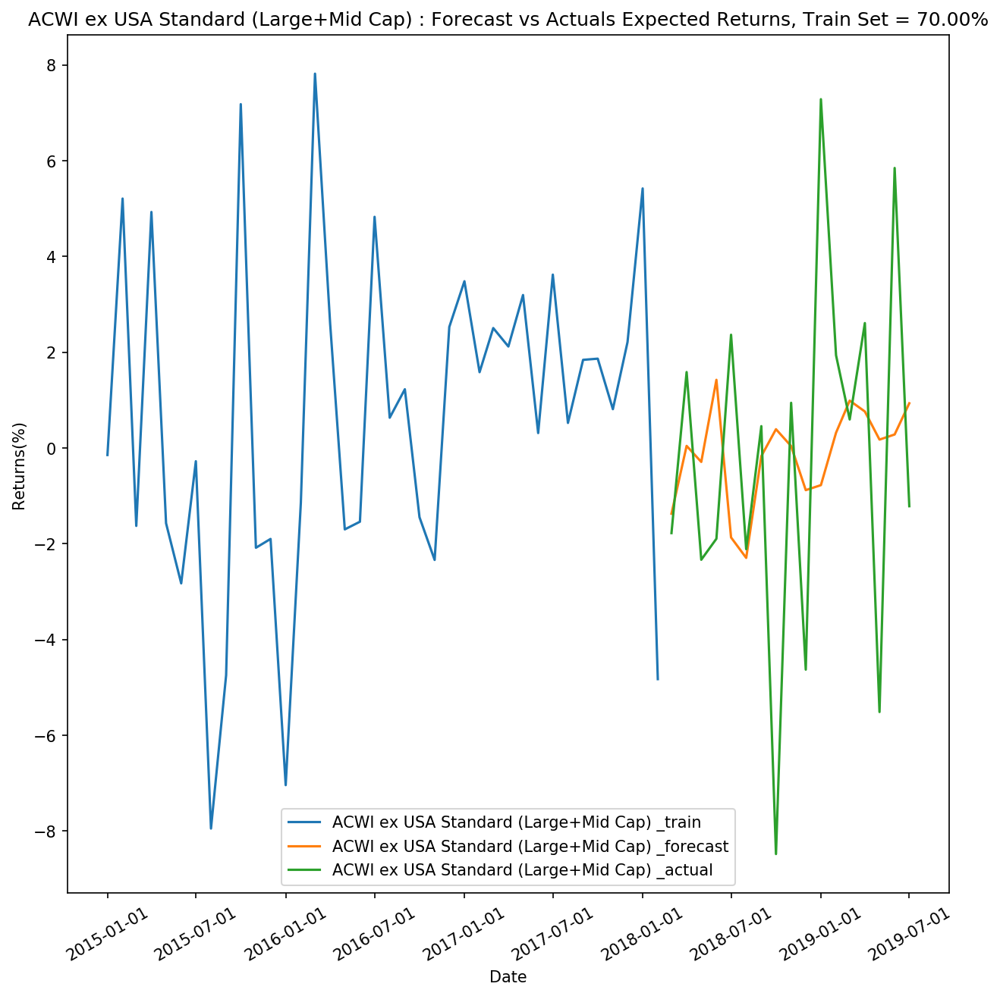

Forecast Accuracy of: ACWI_exUSA
mape   :  1.1233
me     :  -0.0015
mae    :  2.3088
mpe    :  -1.1233
rmse   :  2.6706
corr   :  -0.4203


In [125]:
# Train Set = 70%
[model4_fitted_ACWI_exUSA,df4_ACWI_exUSA,df4_train_ACWI_exUSA,df4_test_ACWI_exUSA,date1] = VAR_Model(merge4_tested_ACWI_exUSA,2,4,0.3)
[df4_forecast_ACWI_exUSA,lag_order4_ACWI_exUSA] = forecast_plot(model4_fitted_ACWI_exUSA,df4_ACWI_exUSA,df4_train_ACWI_exUSA,df4_test_ACWI_exUSA,date1,70)

print('Forecast Accuracy of: ACWI_exUSA')
accuracy_prod = forecast_accuracy(df4_forecast_ACWI_exUSA.iloc[:lag_order4_ACWI_exUSA,0].values, df4_test_ACWI_exUSA.iloc[:lag_order4_ACWI_exUSA,0])

for k, v in accuracy_prod.items():
    print(adjust(k), ': ', round(v,4)) 

### 4.2 Coincident Indicators

* Producer Prices Index: Total Consumer Goods for the Euro Area (PITGCG01EZM661N)
* Total Retail Trade (OECD Total)
* Production of Total Industry (OECD Total)

,PPI_Euro
2000-01-01,81.6
2000-02-01,81.9
2000-03-01,82.0
2000-04-01,82.2
2000-05-01,82.5
2000-06-01,82.6
2000-07-01,82.9
2000-08-01,83.1
2000-09-01,83.4
2000-10-01,83.6


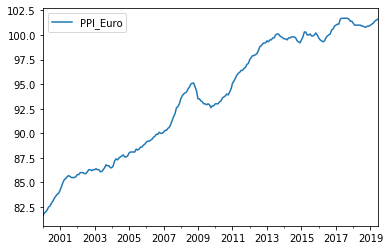

In [38]:
# Monthly Data
PPI_Euro = fred.get_series('PITGCG01EZM661N').dropna()
PPI_Euro = pd.DataFrame(PPI_Euro,columns=['PPI_Euro']).asfreq(freq='MS',method='bfill')
PPI_Euro.plot()
PPI_Euro
PPI_Euro = PPI_Euro.diff(periods=12).dropna()

C:\ProgramData\Anaconda3\lib\site-packages\pandasdmx\writer\data2pandas.py:124: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.

  d_frame = PD.concat(list(pd_series), axis=1, copy=False)


,retail_trade
Date,
1971-01-01,2.05460
1971-02-01,2.09187
1971-03-01,2.44833
1971-04-01,3.08063
1971-05-01,2.28762
1971-06-01,2.33528
1971-07-01,2.04932
1971-08-01,2.14708
1971-09-01,2.80954


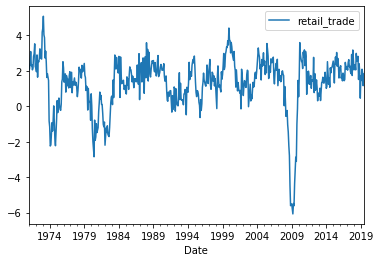

In [40]:
# Get OECD Data through API (not so stable),
# might need to rerun the cell to get the result
def OECD_API_M(df,colname):
    df = df.rename(columns={'index':'Date','M':colname})
    df['Date'] = pd.to_datetime(df['Date'])
    df = df.set_index('Date')
    df = df.asfreq(freq='MS',method='bfill')
    df = df.diff(periods=12).dropna()
    df.plot()
    return df

oecd = pandasdmx.Request('OECD')
data_response = oecd.data(resource_id='MEI_REAL')
retail_trade = data_response.write(data_response.data.series, parse_time=False)
retail_trade = retail_trade['SLRTTO01']['OECD']['M'].dropna()
retail_trade = retail_trade.reset_index()

retail_trade = OECD_API_M(retail_trade,'retail_trade')
retail_trade

,industry_production
Date,
1976-01-01,1.39705
1976-02-01,2.35386
1976-03-01,2.71172
1976-04-01,3.48753
1976-05-01,3.97053
1976-06-01,3.83950
1976-07-01,3.87385
1976-08-01,3.67011
1976-09-01,3.87121


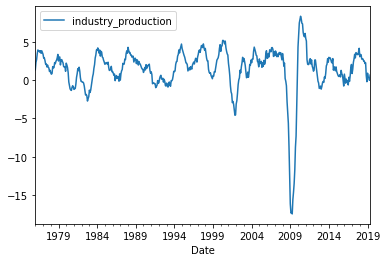

In [41]:
data_response = oecd.data(resource_id='MEI_REAL')
industry_production = data_response.write(data_response.data.series, parse_time=False)
industry_production = industry_production['PRINTO01']['OECD']['M'].dropna()
industry_production = industry_production.reset_index()
industry_production = OECD_API_M(industry_production,'industry_production')
industry_production

In [42]:
merge5 = pd.concat([TR_2_M,PPI_Euro,retail_trade,industry_production],join='inner',axis=1).reset_index()
merge5

,Date,ACWI Standard (Large+Mid Cap),ACWI ex USA Standard (Large+Mid Cap),EAFE Standard (Large+Mid Cap),PPI_Euro,retail_trade,industry_production
0,2001-01-01,2.482919,1.482950,-0.051589,2.6,2.05072,2.21256
1,2001-02-01,-8.809918,-8.251965,-7.792647,2.7,1.39815,1.52799
2,2001-03-01,-7.007856,-7.379277,-6.898659,3.0,0.86330,0.62624
3,2001-04-01,6.990809,6.526041,6.718359,3.1,1.33411,-0.70016
4,2001-05-01,-1.182203,-2.876030,-3.593168,2.9,0.96059,-1.51720
5,2001-06-01,-3.141000,-3.949976,-4.175518,3.0,0.87001,-1.78450
6,2001-07-01,-1.609420,-2.262334,-1.836245,2.8,0.73586,-2.92216
7,2001-08-01,-4.740498,-2.537509,-2.566816,2.5,0.88670,-2.76996
8,2001-09-01,-9.607513,-11.240150,-10.679162,2.1,-0.15231,-3.15365
9,2001-10-01,2.088319,2.765227,2.528992,1.9,2.08460,-3.88229


1
1
0


C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


[]

,Date,ACWI Standard (Large+Mid Cap),ACWI ex USA Standard (Large+Mid Cap),EAFE Standard (Large+Mid Cap),PPI_Euro,retail_trade,industry_production
0,2001-03-01,-7.007856,-7.379277,-6.898659,3.000000e-01,-0.53485,0.62624
1,2001-04-01,6.990809,6.526041,6.718359,1.000000e-01,0.47081,-0.70016
2,2001-05-01,-1.182203,-2.876030,-3.593168,-2.000000e-01,-0.37352,-1.51720
3,2001-06-01,-3.141000,-3.949976,-4.175518,1.000000e-01,-0.09058,-1.78450
4,2001-07-01,-1.609420,-2.262334,-1.836245,-2.000000e-01,-0.13415,-2.92216
5,2001-08-01,-4.740498,-2.537509,-2.566816,-3.000000e-01,0.15084,-2.76996
6,2001-09-01,-9.607513,-11.240150,-10.679162,-4.000000e-01,-1.03901,-3.15365
7,2001-10-01,2.088319,2.765227,2.528992,-2.000000e-01,2.23691,-3.88229
8,2001-11-01,5.940744,4.464221,3.619946,-2.000000e-01,-0.31980,-4.58041
9,2001-12-01,0.911157,1.276394,0.592362,-1.421085e-14,-0.61475,-4.53714


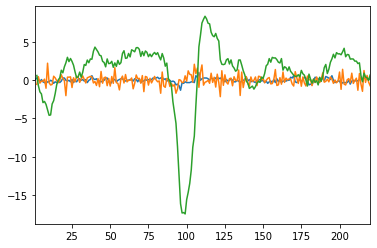

In [43]:
# ADF Test
merge5_diff = merge5.copy()

[index_remove5,merge5_differenced]=ADF_Test(merge5_diff)
index_remove5
merge5_differenced

#### 5.1.1 Forecast the returns for EAFE

In [44]:
# Grangers Causation Test
[causation_matrix,index_remove,merge5_tested] = causation_test(merge5_differenced,3,4)
causation_matrix
index_remove
merge5_tested

     EAFE Standard (Large+Mid Cap)       PPI_Euro  retail_trade  \
0                         -6.898659  3.000000e-01      -0.53485   
1                          6.718359  1.000000e-01       0.47081   
2                         -3.593168 -2.000000e-01      -0.37352   
3                         -4.175518  1.000000e-01      -0.09058   
4                         -1.836245 -2.000000e-01      -0.13415   
5                         -2.566816 -3.000000e-01       0.15084   
6                        -10.679162 -4.000000e-01      -1.03901   
7                          2.528992 -2.000000e-01       2.23691   
8                          3.619946 -2.000000e-01      -0.31980   
9                          0.592362 -1.421085e-14      -0.61475   
10                        -5.459832 -1.000000e-01      -0.54838   
11                         0.698988 -4.000000e-01       0.53043   
12                         5.268001 -2.000000e-01       0.30887   
13                         0.660519 -3.000000e-01      -0.0524

,EAFE Standard (Large+Mid Cap) _x,PPI_Euro_x,retail_trade_x,industry_production_x
EAFE Standard (Large+Mid Cap) _y,1.0000,0.4069,0.0381,0.0357
PPI_Euro_y,0.1344,1.0000,0.0000,0.0001
retail_trade_y,0.0002,0.0001,1.0000,0.0000
industry_production_y,0.0000,0.0003,0.0000,1.0000


[4]

,Date,ACWI Standard (Large+Mid Cap),ACWI ex USA Standard (Large+Mid Cap),EAFE Standard (Large+Mid Cap),retail_trade,industry_production
0,2001-03-01,-7.007856,-7.379277,-6.898659,-0.53485,0.62624
1,2001-04-01,6.990809,6.526041,6.718359,0.47081,-0.70016
2,2001-05-01,-1.182203,-2.876030,-3.593168,-0.37352,-1.51720
3,2001-06-01,-3.141000,-3.949976,-4.175518,-0.09058,-1.78450
4,2001-07-01,-1.609420,-2.262334,-1.836245,-0.13415,-2.92216
5,2001-08-01,-4.740498,-2.537509,-2.566816,0.15084,-2.76996
6,2001-09-01,-9.607513,-11.240150,-10.679162,-1.03901,-3.15365
7,2001-10-01,2.088319,2.765227,2.528992,2.23691,-3.88229
8,2001-11-01,5.940744,4.464221,3.619946,-0.31980,-4.58041
9,2001-12-01,0.911157,1.276394,0.592362,-0.61475,-4.53714


  Summary of Regression Results   
Model:                         VAR
Method:                        OLS
Date:           Wed, 28, Aug, 2019
Time:                     09:32:52
--------------------------------------------------------------------
No. of Equations:         3.00000    BIC:                    2.08406
Nobs:                     204.000    HQIC:                   1.70632
Log likelihood:          -977.261    FPE:                    4.26412
AIC:                      1.44972    Det(Omega_mle):         3.54275
--------------------------------------------------------------------
Results for equation EAFE Standard (Large+Mid Cap) 
                                       coefficient       std. error           t-stat            prob
----------------------------------------------------------------------------------------------------
const                                     0.310833         0.340945            0.912           0.362
L1.EAFE Standard (Large+Mid Cap)          0.204400      

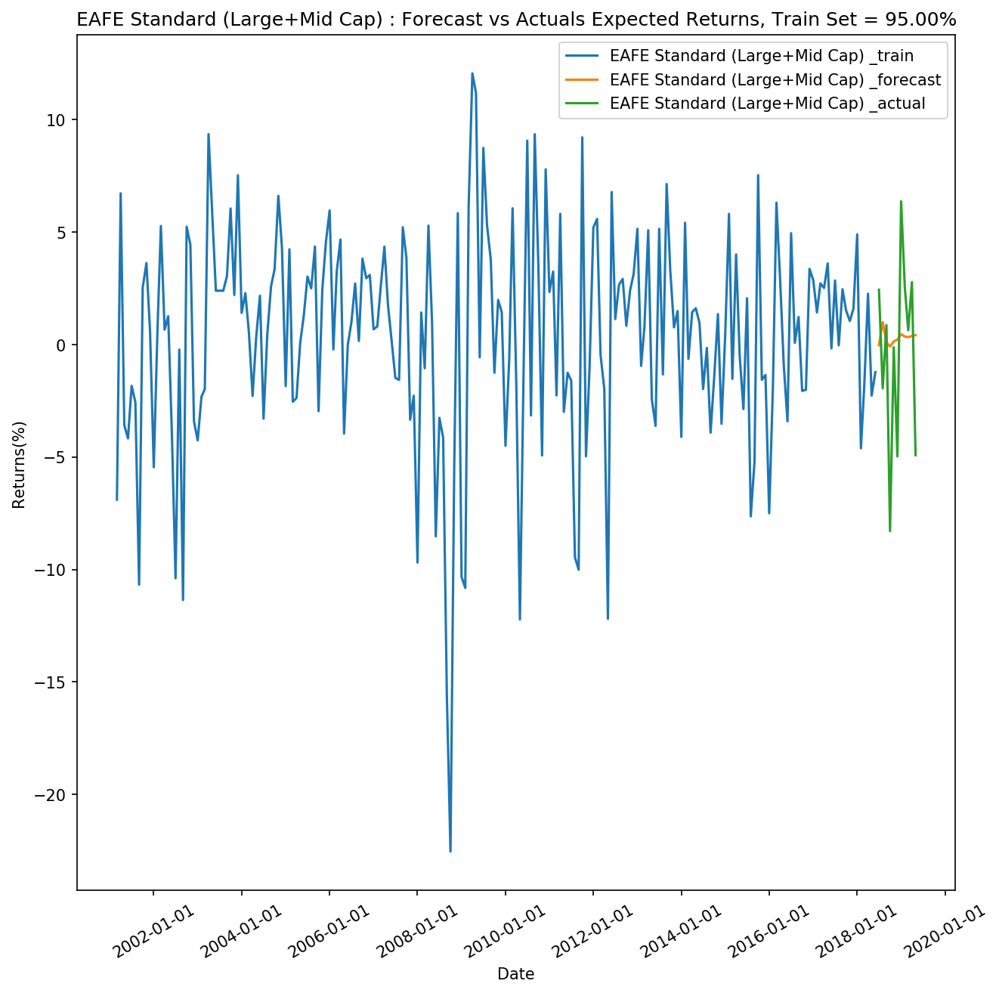

In [45]:
# Forecast, Train Size = 95%
[model5_fitted,df5,df5_train,df5_test,date5] = VAR_Model(merge5_tested,3,4,0.05)
[df5_forecast,lag_order5] = forecast_plot(model5_fitted,df5,df5_train,df5_test,date5,95)

In [46]:
# Test the Accuracy
print('Forecast Accuracy of: EAFE')
accuracy_prod = forecast_accuracy(df5_forecast.iloc[:,0].values, df5_test.iloc[:,0])
for k, v in accuracy_prod.items():
    print(adjust(k), ': ', round(v,5))

print('\nForecast values are: ',df5_forecast.iloc[:lag_order5,0].values)
print('Actual values are: ',df5_test.iloc[:lag_order5,0].values)

Forecast Accuracy of: EAFE
mape   :  1.07135
me     :  0.72188
mae    :  3.26806
mpe    :  -1.07135
rmse   :  4.08471
corr   :  0.16946

Forecast values are:  [-0.03102651  0.99688502  0.09564295 -0.092558  ]
Actual values are:  [ 2.43172185 -1.95014421  0.86413581 -8.29383393]


  Summary of Regression Results   
Model:                         VAR
Method:                        OLS
Date:           Wed, 28, Aug, 2019
Time:                     09:38:21
--------------------------------------------------------------------
No. of Equations:         3.00000    BIC:                    2.19084
Nobs:                     193.000    HQIC:                   1.79853
Log likelihood:          -930.359    FPE:                    4.62812
AIC:                      1.53154    Det(Omega_mle):         3.80605
--------------------------------------------------------------------
Results for equation EAFE Standard (Large+Mid Cap) 
                                       coefficient       std. error           t-stat            prob
----------------------------------------------------------------------------------------------------
const                                     0.319552         0.354214            0.902           0.367
L1.EAFE Standard (Large+Mid Cap)          0.214765      

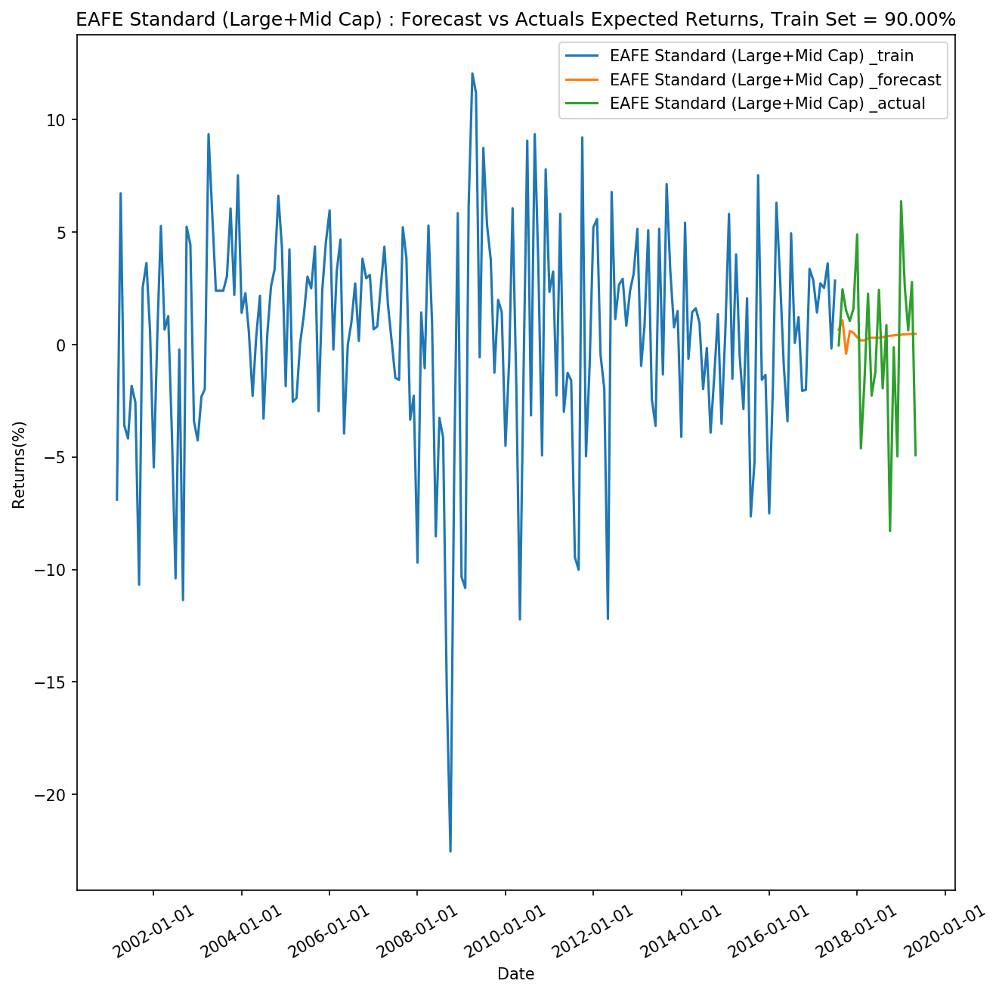

Forecast Accuracy of: EAFE
mape   :  1.8381
me     :  0.42614
mae    :  2.65232
mpe    :  -1.8381
rmse   :  3.41672
corr   :  0.10618

Forecast values are:  [ 0.65034791  1.07859909 -0.41567398  0.59610795]
Actual values are:  [-0.03768707  2.457595    1.5070571   1.04345971]


In [47]:
# Train Size = 90%
[model5_fitted,df5,df5_train,df5_test,date5] = VAR_Model(merge5_tested,3,4,0.1)
[df5_forecast,lag_order5] = forecast_plot(model5_fitted,df5,df5_train,df5_test,date5,90)

print('Forecast Accuracy of: EAFE')
accuracy_prod = forecast_accuracy(df5_forecast.iloc[:,0].values, df5_test.iloc[:,0])
for k, v in accuracy_prod.items():
    print(adjust(k), ': ', round(v,5))

print('\nForecast values are: ',df5_forecast.iloc[:lag_order5,0].values)
print('Actual values are: ',df5_test.iloc[:lag_order5,0].values)

  Summary of Regression Results   
Model:                         VAR
Method:                        OLS
Date:           Wed, 28, Aug, 2019
Time:                     14:37:02
--------------------------------------------------------------------
No. of Equations:         3.00000    BIC:                    2.38615
Nobs:                     171.000    HQIC:                   1.96036
Log likelihood:          -831.669    FPE:                    5.31488
AIC:                      1.66963    Det(Omega_mle):         4.26608
--------------------------------------------------------------------
Results for equation EAFE Standard (Large+Mid Cap) 
                                       coefficient       std. error           t-stat            prob
----------------------------------------------------------------------------------------------------
const                                     0.241409         0.389185            0.620           0.535
L1.EAFE Standard (Large+Mid Cap)          0.217447      

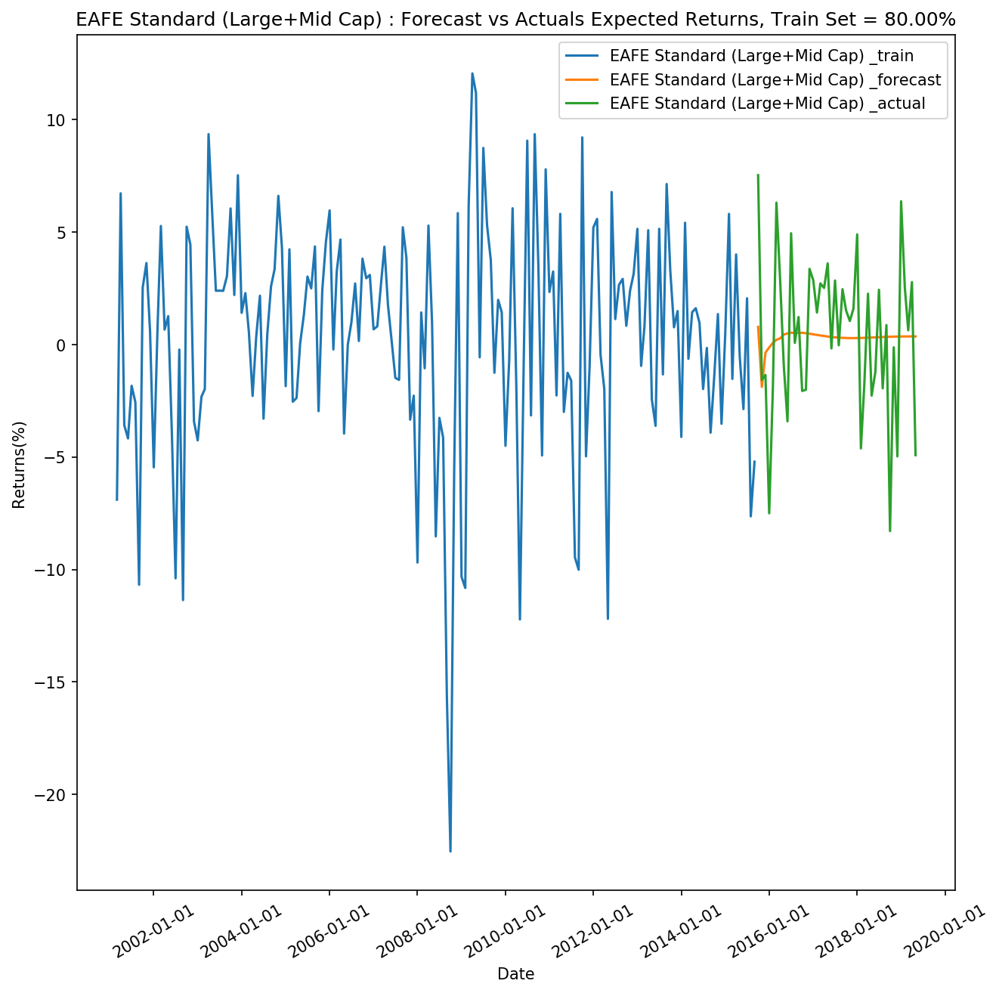

Forecast Accuracy of: EAFE
mape   :  1.33297
me     :  -0.17767
mae    :  2.68133
mpe    :  -1.04529
rmse   :  3.37091
corr   :  0.22363

Forecast values are:  [ 0.7818262  -1.88760952 -0.36139733 -0.13351304]
Actual values are:  [ 7.52646386 -1.56791483 -1.35657203 -7.50618903]


In [126]:
# Train Size = 80%
[model5_fitted,df5,df5_train,df5_test,date5] = VAR_Model(merge5_tested,3,4,0.2)
[df5_forecast,lag_order5] = forecast_plot(model5_fitted,df5,df5_train,df5_test,date5,80)

print('Forecast Accuracy of: EAFE')
accuracy_prod = forecast_accuracy(df5_forecast.iloc[:,0].values, df5_test.iloc[:,0])
for k, v in accuracy_prod.items():
    print(adjust(k), ': ', round(v,5))

print('\nForecast values are: ',df5_forecast.iloc[:lag_order5,0].values)
print('Actual values are: ',df5_test.iloc[:lag_order5,0].values)

  Summary of Regression Results   
Model:                         VAR
Method:                        OLS
Date:           Wed, 28, Aug, 2019
Time:                     14:37:07
--------------------------------------------------------------------
No. of Equations:         3.00000    BIC:                    2.38615
Nobs:                     171.000    HQIC:                   1.96036
Log likelihood:          -831.669    FPE:                    5.31488
AIC:                      1.66963    Det(Omega_mle):         4.26608
--------------------------------------------------------------------
Results for equation EAFE Standard (Large+Mid Cap) 
                                       coefficient       std. error           t-stat            prob
----------------------------------------------------------------------------------------------------
const                                     0.241409         0.389185            0.620           0.535
L1.EAFE Standard (Large+Mid Cap)          0.217447      

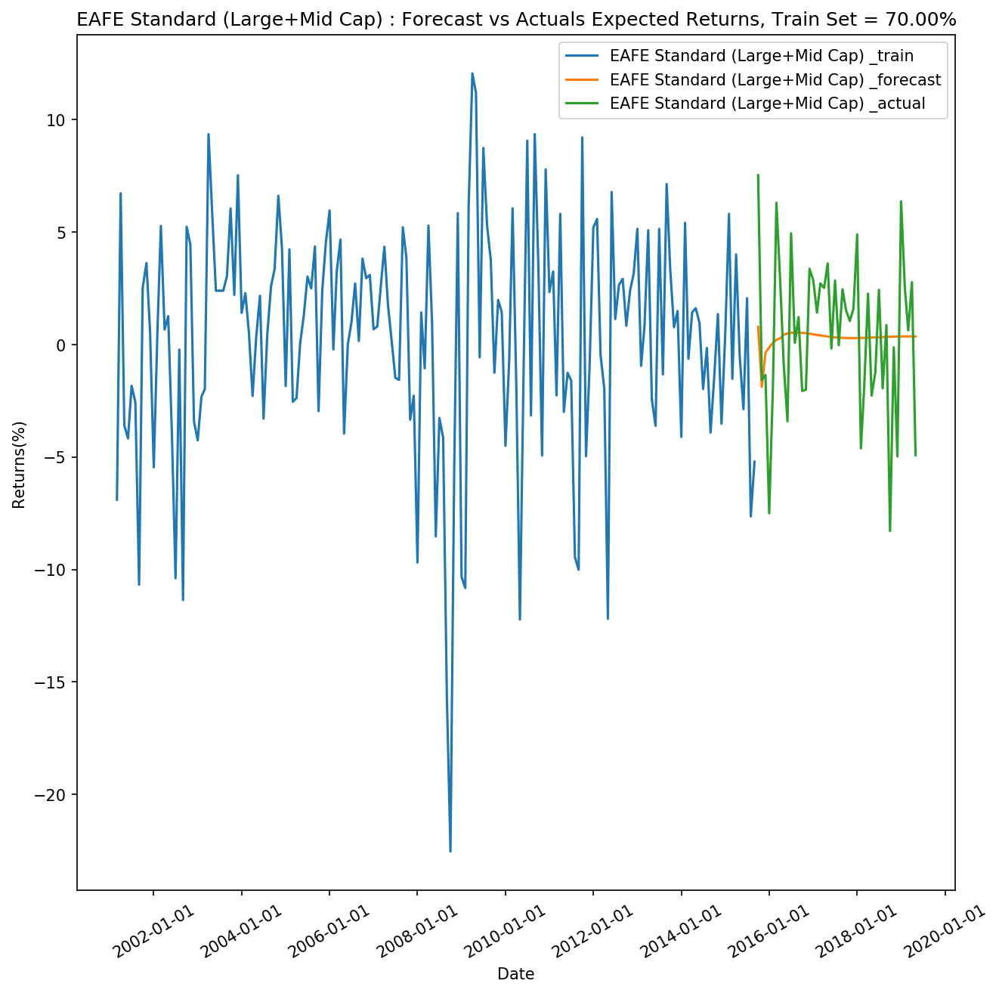

Forecast Accuracy of: EAFE
mape   :  1.33297
me     :  -0.17767
mae    :  2.68133
mpe    :  -1.04529
rmse   :  3.37091
corr   :  0.22363

Forecast values are:  [ 0.7818262  -1.88760952 -0.36139733 -0.13351304]
Actual values are:  [ 7.52646386 -1.56791483 -1.35657203 -7.50618903]


In [127]:
# Train Size = 70%
[model5_fitted,df5,df5_train,df5_test,date5] = VAR_Model(merge5_tested,3,4,0.2)
[df5_forecast,lag_order5] = forecast_plot(model5_fitted,df5,df5_train,df5_test,date5,70)

print('Forecast Accuracy of: EAFE')
accuracy_prod = forecast_accuracy(df5_forecast.iloc[:,0].values, df5_test.iloc[:,0])
for k, v in accuracy_prod.items():
    print(adjust(k), ': ', round(v,5))

print('\nForecast values are: ',df5_forecast.iloc[:lag_order5,0].values)
print('Actual values are: ',df5_test.iloc[:lag_order5,0].values)

#### 5.1.2 Forecast the returns for ACWI

     ACWI Standard (Large+Mid Cap)       PPI_Euro  retail_trade  \
0                         -7.007856  3.000000e-01      -0.53485   
1                          6.990809  1.000000e-01       0.47081   
2                         -1.182203 -2.000000e-01      -0.37352   
3                         -3.141000  1.000000e-01      -0.09058   
4                         -1.609420 -2.000000e-01      -0.13415   
5                         -4.740498 -3.000000e-01       0.15084   
6                         -9.607513 -4.000000e-01      -1.03901   
7                          2.088319 -2.000000e-01       2.23691   
8                          5.940744 -2.000000e-01      -0.31980   
9                          0.911157 -1.421085e-14      -0.61475   
10                        -2.799256 -1.000000e-01      -0.54838   
11                        -0.767562 -4.000000e-01       0.53043   
12                         4.382188 -2.000000e-01       0.30887   
13                        -3.256888 -3.000000e-01      -0.0524

,ACWI Standard (Large+Mid Cap) _x,PPI_Euro_x,retail_trade_x,industry_production_x
ACWI Standard (Large+Mid Cap) _y,1.0000,0.2866,0.018,0.0228
PPI_Euro_y,0.0823,1.0000,0.000,0.0001
retail_trade_y,0.0001,0.0001,1.000,0.0000
industry_production_y,0.0000,0.0003,0.000,1.0000


[4]

,Date,ACWI Standard (Large+Mid Cap),ACWI ex USA Standard (Large+Mid Cap),EAFE Standard (Large+Mid Cap),retail_trade,industry_production
0,2001-03-01,-7.007856,-7.379277,-6.898659,-0.53485,0.62624
1,2001-04-01,6.990809,6.526041,6.718359,0.47081,-0.70016
2,2001-05-01,-1.182203,-2.876030,-3.593168,-0.37352,-1.51720
3,2001-06-01,-3.141000,-3.949976,-4.175518,-0.09058,-1.78450
4,2001-07-01,-1.609420,-2.262334,-1.836245,-0.13415,-2.92216
5,2001-08-01,-4.740498,-2.537509,-2.566816,0.15084,-2.76996
6,2001-09-01,-9.607513,-11.240150,-10.679162,-1.03901,-3.15365
7,2001-10-01,2.088319,2.765227,2.528992,2.23691,-3.88229
8,2001-11-01,5.940744,4.464221,3.619946,-0.31980,-4.58041
9,2001-12-01,0.911157,1.276394,0.592362,-0.61475,-4.53714


  Summary of Regression Results   
Model:                         VAR
Method:                        OLS
Date:           Wed, 28, Aug, 2019
Time:                     09:48:50
--------------------------------------------------------------------
No. of Equations:         3.00000    BIC:                    1.90938
Nobs:                     204.000    HQIC:                   1.53163
Log likelihood:          -959.443    FPE:                    3.58066
AIC:                      1.27503    Det(Omega_mle):         2.97491
--------------------------------------------------------------------
Results for equation ACWI Standard (Large+Mid Cap) 
                                       coefficient       std. error           t-stat            prob
----------------------------------------------------------------------------------------------------
const                                     0.369488         0.315778            1.170           0.242
L1.ACWI Standard (Large+Mid Cap)          0.186357      

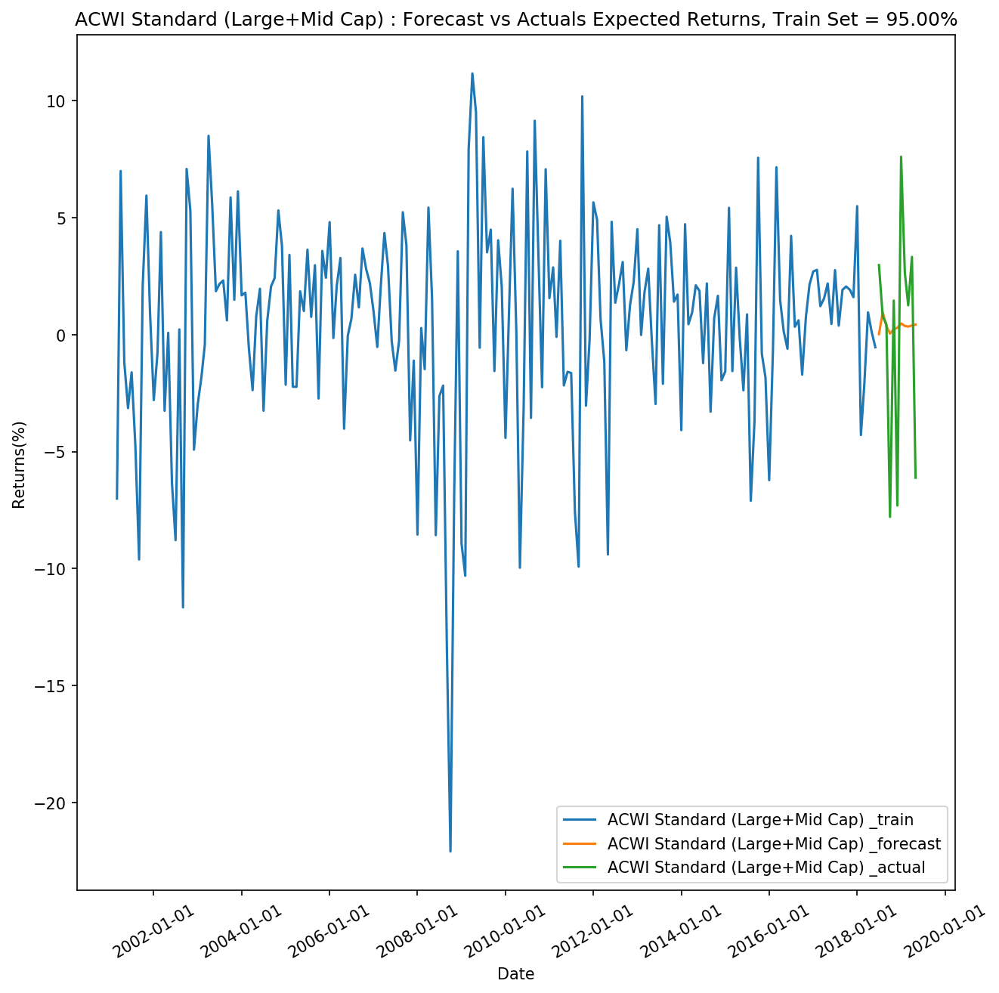

Forecast Accuracy of: ACWI
mape   :  0.5969
me     :  1.2457
mae    :  2.7574
mpe    :  -0.4855
rmse   :  4.1858
corr   :  0.3035


In [48]:
[causation_matrix,index_remove,merge5_tested_ACWI] = causation_test(merge5_differenced,1,4)
causation_matrix
index_remove
merge5_tested_ACWI

# Train Size = 95%
[model5_fitted_ACWI,df5_ACWI,df5_train_ACWI,df5_test_ACWI,date1] = VAR_Model(merge5_tested_ACWI,1,4,0.05)
[df5_forecast_ACWI,lag_order5_ACWI] = forecast_plot(model5_fitted_ACWI,df5_ACWI,df5_train_ACWI,df5_test_ACWI,date1,95)

print('Forecast Accuracy of: ACWI')
accuracy_prod = forecast_accuracy(df5_forecast_ACWI.iloc[:lag_order5_ACWI,0].values, df5_test_ACWI.iloc[:lag_order5_ACWI,0])

for k, v in accuracy_prod.items():
    print(adjust(k), ': ', round(v,4)) 

  Summary of Regression Results   
Model:                         VAR
Method:                        OLS
Date:           Wed, 28, Aug, 2019
Time:                     09:49:04
--------------------------------------------------------------------
No. of Equations:         3.00000    BIC:                    2.01293
Nobs:                     193.000    HQIC:                   1.62063
Log likelihood:          -913.191    FPE:                    3.87384
AIC:                      1.35363    Det(Omega_mle):         3.18575
--------------------------------------------------------------------
Results for equation ACWI Standard (Large+Mid Cap) 
                                       coefficient       std. error           t-stat            prob
----------------------------------------------------------------------------------------------------
const                                     0.364773         0.327323            1.114           0.265
L1.ACWI Standard (Large+Mid Cap)          0.195838      

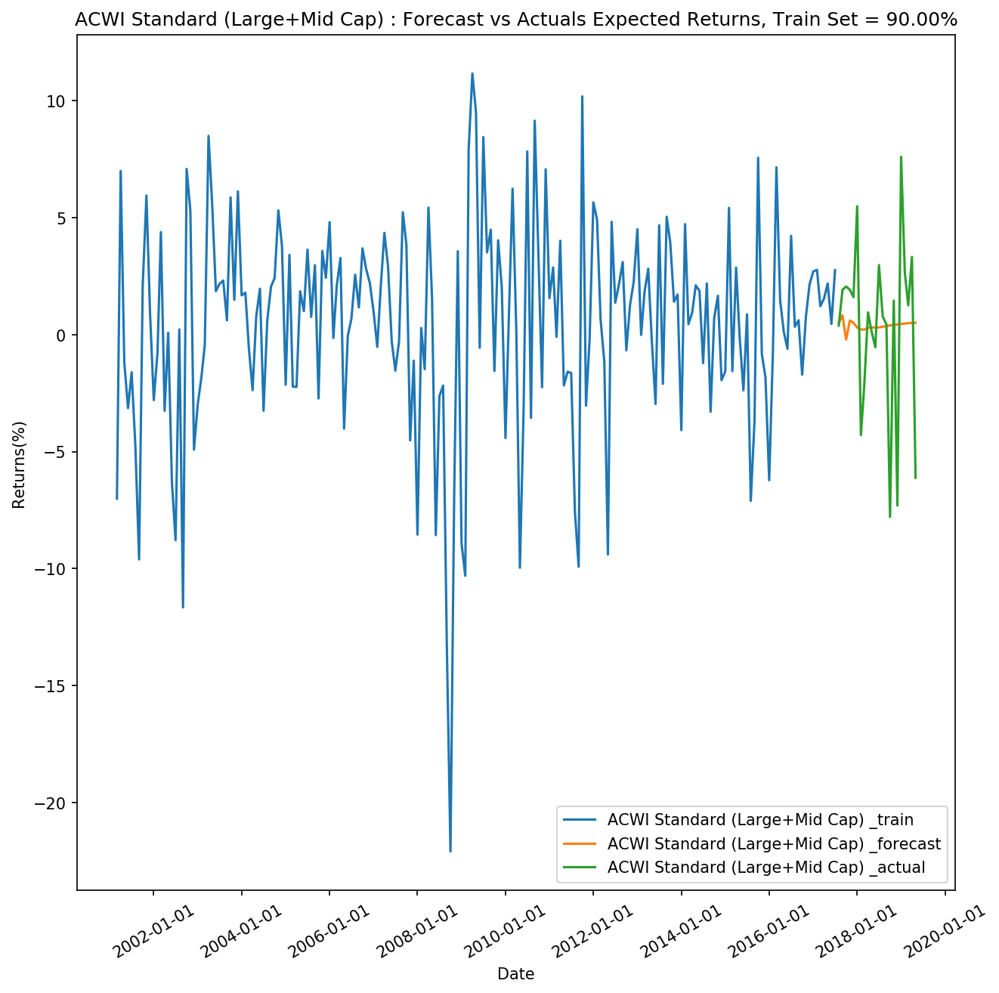

Forecast Accuracy of: ACWI
mape   :  0.6631
me     :  -1.1413
mae    :  1.197
mpe    :  -0.5174
rmse   :  1.4214
corr   :  -0.1826


In [49]:
# Train Size = 90%
[model5_fitted_ACWI,df5_ACWI,df5_train_ACWI,df5_test_ACWI,date1] = VAR_Model(merge5_tested_ACWI,1,4,0.1)
[df5_forecast_ACWI,lag_order5_ACWI] = forecast_plot(model5_fitted_ACWI,df5_ACWI,df5_train_ACWI,df5_test_ACWI,date1,90)

print('Forecast Accuracy of: ACWI')
accuracy_prod = forecast_accuracy(df5_forecast_ACWI.iloc[:lag_order5_ACWI,0].values, df5_test_ACWI.iloc[:lag_order5_ACWI,0])

for k, v in accuracy_prod.items():
    print(adjust(k), ': ', round(v,4)) 

  Summary of Regression Results   
Model:                         VAR
Method:                        OLS
Date:           Wed, 28, Aug, 2019
Time:                     14:44:21
--------------------------------------------------------------------
No. of Equations:         3.00000    BIC:                    2.21051
Nobs:                     171.000    HQIC:                   1.78472
Log likelihood:          -816.652    FPE:                    4.45877
AIC:                      1.49399    Det(Omega_mle):         3.57890
--------------------------------------------------------------------
Results for equation ACWI Standard (Large+Mid Cap) 
                                       coefficient       std. error           t-stat            prob
----------------------------------------------------------------------------------------------------
const                                     0.265119         0.360478            0.735           0.462
L1.ACWI Standard (Large+Mid Cap)          0.193432      

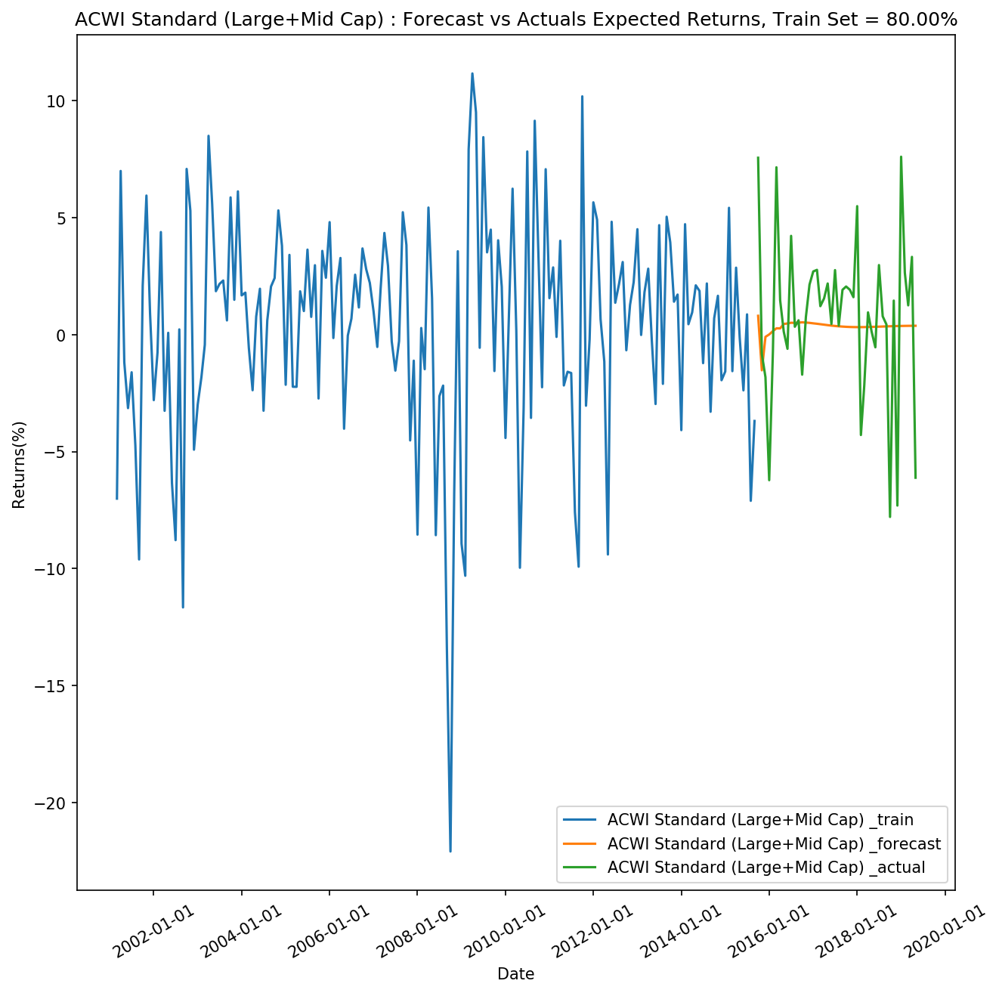

Forecast Accuracy of: ACWI
mape   :  0.9207
me     :  0.1257
mae    :  3.8501
mpe    :  -0.5004
rmse   :  4.6858
corr   :  0.4304


In [128]:
# Train Size = 80%
[model5_fitted_ACWI,df5_ACWI,df5_train_ACWI,df5_test_ACWI,date1] = VAR_Model(merge5_tested_ACWI,1,4,0.2)
[df5_forecast_ACWI,lag_order5_ACWI] = forecast_plot(model5_fitted_ACWI,df5_ACWI,df5_train_ACWI,df5_test_ACWI,date1,80)

print('Forecast Accuracy of: ACWI')
accuracy_prod = forecast_accuracy(df5_forecast_ACWI.iloc[:lag_order5_ACWI,0].values, df5_test_ACWI.iloc[:lag_order5_ACWI,0])

for k, v in accuracy_prod.items():
    print(adjust(k), ': ', round(v,4)) 

  Summary of Regression Results   
Model:                         VAR
Method:                        OLS
Date:           Wed, 28, Aug, 2019
Time:                     14:44:26
--------------------------------------------------------------------
No. of Equations:         3.00000    BIC:                    2.28441
Nobs:                     150.000    HQIC:                   1.92691
Log likelihood:          -734.694    FPE:                    5.38104
AIC:                      1.68229    Det(Omega_mle):         4.43384
--------------------------------------------------------------------
Results for equation ACWI Standard (Large+Mid Cap) 
                                       coefficient       std. error           t-stat            prob
----------------------------------------------------------------------------------------------------
const                                     0.356486         0.393747            0.905           0.365
L1.ACWI Standard (Large+Mid Cap)          0.232084      

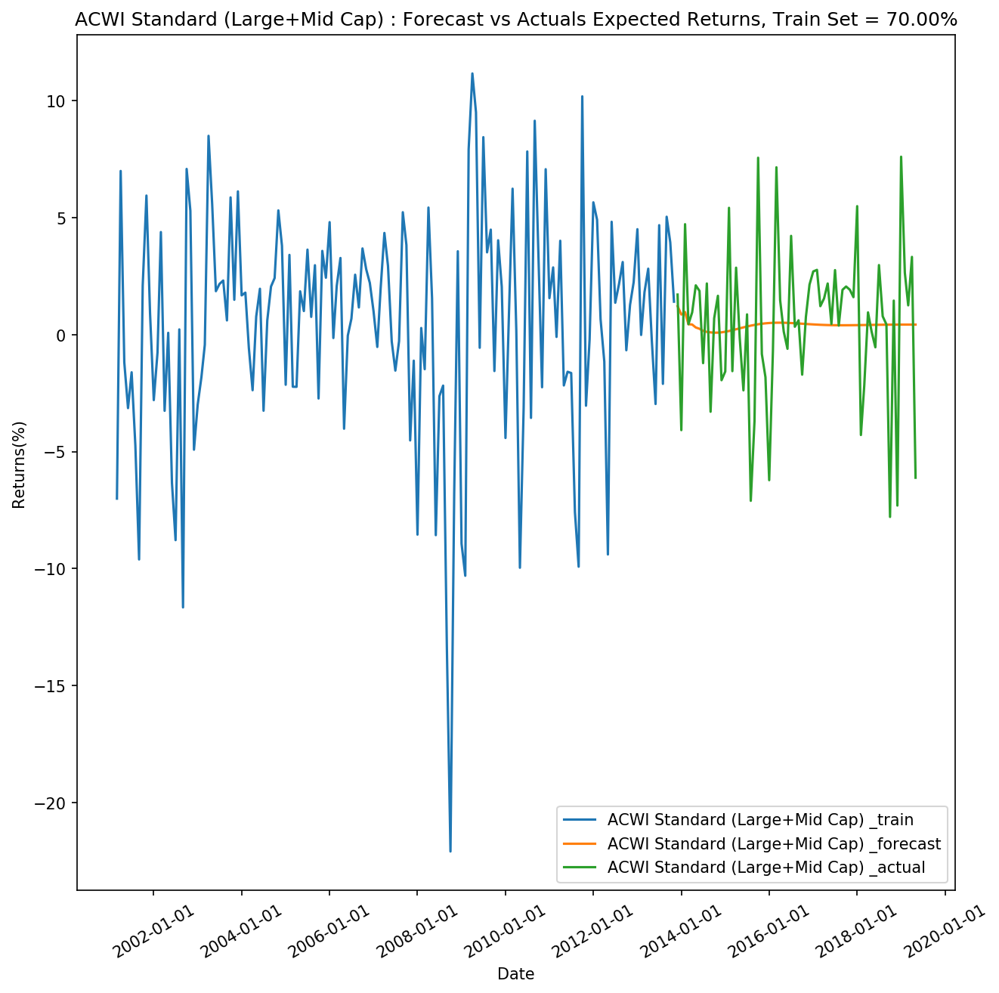

Forecast Accuracy of: ACWI
mape   :  0.7655
me     :  0.2287
mae    :  3.0639
mpe    :  -0.7655
rmse   :  3.5937
corr   :  0.4555


In [129]:
# Train Size = 70%
[model5_fitted_ACWI,df5_ACWI,df5_train_ACWI,df5_test_ACWI,date1] = VAR_Model(merge5_tested_ACWI,1,4,0.3)
[df5_forecast_ACWI,lag_order5_ACWI] = forecast_plot(model5_fitted_ACWI,df5_ACWI,df5_train_ACWI,df5_test_ACWI,date1,70)

print('Forecast Accuracy of: ACWI')
accuracy_prod = forecast_accuracy(df5_forecast_ACWI.iloc[:lag_order5_ACWI,0].values, df5_test_ACWI.iloc[:lag_order5_ACWI,0])

for k, v in accuracy_prod.items():
    print(adjust(k), ': ', round(v,4)) 

#### 5.1.3 Forecast the returns for ACWI ex USA

     ACWI ex USA Standard (Large+Mid Cap)       PPI_Euro  retail_trade  \
0                                -7.379277  3.000000e-01      -0.53485   
1                                 6.526041  1.000000e-01       0.47081   
2                                -2.876030 -2.000000e-01      -0.37352   
3                                -3.949976  1.000000e-01      -0.09058   
4                                -2.262334 -2.000000e-01      -0.13415   
5                                -2.537509 -3.000000e-01       0.15084   
6                               -11.240150 -4.000000e-01      -1.03901   
7                                 2.765227 -2.000000e-01       2.23691   
8                                 4.464221 -2.000000e-01      -0.31980   
9                                 1.276394 -1.421085e-14      -0.61475   
10                               -4.386808 -1.000000e-01      -0.54838   
11                                0.709522 -4.000000e-01       0.53043   
12                                5.24

,ACWI ex USA Standard (Large+Mid Cap) _x,PPI_Euro_x,retail_trade_x,industry_production_x
ACWI ex USA Standard (Large+Mid Cap) _y,1.0000,0.3434,0.0476,0.0473
PPI_Euro_y,0.0525,1.0000,0.0000,0.0001
retail_trade_y,0.0001,0.0001,1.0000,0.0000
industry_production_y,0.0000,0.0003,0.0000,1.0000


[4]

,Date,ACWI Standard (Large+Mid Cap),ACWI ex USA Standard (Large+Mid Cap),EAFE Standard (Large+Mid Cap),retail_trade,industry_production
0,2001-03-01,-7.007856,-7.379277,-6.898659,-0.53485,0.62624
1,2001-04-01,6.990809,6.526041,6.718359,0.47081,-0.70016
2,2001-05-01,-1.182203,-2.876030,-3.593168,-0.37352,-1.51720
3,2001-06-01,-3.141000,-3.949976,-4.175518,-0.09058,-1.78450
4,2001-07-01,-1.609420,-2.262334,-1.836245,-0.13415,-2.92216
5,2001-08-01,-4.740498,-2.537509,-2.566816,0.15084,-2.76996
6,2001-09-01,-9.607513,-11.240150,-10.679162,-1.03901,-3.15365
7,2001-10-01,2.088319,2.765227,2.528992,2.23691,-3.88229
8,2001-11-01,5.940744,4.464221,3.619946,-0.31980,-4.58041
9,2001-12-01,0.911157,1.276394,0.592362,-0.61475,-4.53714


  Summary of Regression Results   
Model:                         VAR
Method:                        OLS
Date:           Wed, 28, Aug, 2019
Time:                     09:55:28
--------------------------------------------------------------------
No. of Equations:         3.00000    BIC:                    2.12531
Nobs:                     204.000    HQIC:                   1.74757
Log likelihood:          -981.468    FPE:                    4.44366
AIC:                      1.49096    Det(Omega_mle):         3.69192
--------------------------------------------------------------------
Results for equation ACWI ex USA Standard (Large+Mid Cap) 
                                              coefficient       std. error           t-stat            prob
-----------------------------------------------------------------------------------------------------------
const                                            0.354215         0.352510            1.005           0.315
L1.ACWI ex USA Standard (Lar

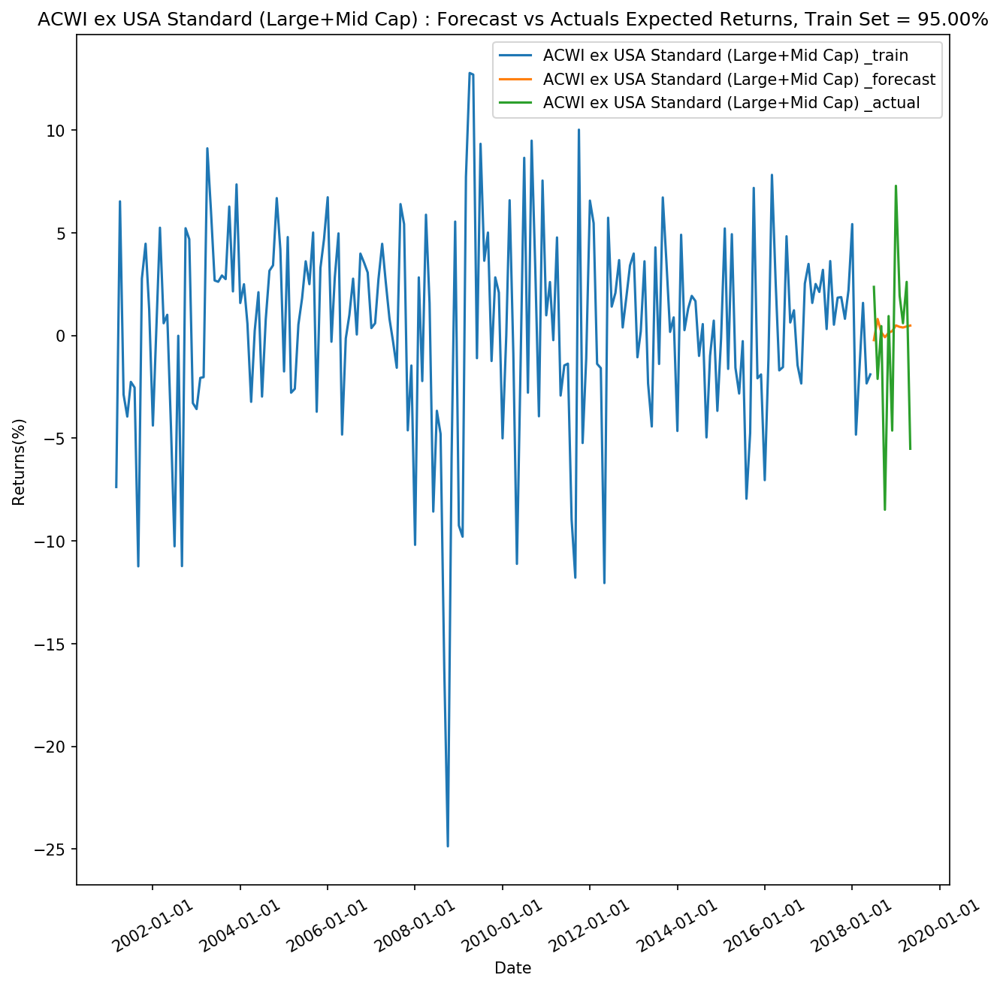

Forecast Accuracy of: ACWI_exUSA
mape   :  1.0333
me     :  2.1038
mae    :  3.5523
mpe    :  -1.0333
rmse   :  4.632
corr   :  -0.0303


In [50]:
[causation_matrix,index_remove,merge5_tested_ACWI_exUSA] = causation_test(merge5_differenced,2,4)
causation_matrix
index_remove
merge5_tested_ACWI_exUSA

# Train Size = 95%
[model5_fitted_ACWI_exUSA,df5_ACWI_exUSA,df5_train_ACWI_exUSA,df5_test_ACWI_exUSA,date1] = VAR_Model(merge5_tested_ACWI_exUSA,2,4,0.05)
[df5_forecast_ACWI_exUSA,lag_order5_ACWI_exUSA] = forecast_plot(model5_fitted_ACWI_exUSA,df5_ACWI_exUSA,df5_train_ACWI_exUSA,df5_test_ACWI_exUSA,date1,95)

print('Forecast Accuracy of: ACWI_exUSA')
accuracy_prod = forecast_accuracy(df5_forecast_ACWI_exUSA.iloc[:lag_order5_ACWI_exUSA,0].values, df5_test_ACWI_exUSA.iloc[:lag_order5_ACWI_exUSA,0])

for k, v in accuracy_prod.items():
    print(adjust(k), ': ', round(v,4)) 

  Summary of Regression Results   
Model:                         VAR
Method:                        OLS
Date:           Wed, 28, Aug, 2019
Time:                     09:55:38
--------------------------------------------------------------------
No. of Equations:         3.00000    BIC:                    2.23140
Nobs:                     193.000    HQIC:                   1.83910
Log likelihood:          -934.273    FPE:                    4.81973
AIC:                      1.57210    Det(Omega_mle):         3.96363
--------------------------------------------------------------------
Results for equation ACWI ex USA Standard (Large+Mid Cap) 
                                              coefficient       std. error           t-stat            prob
-----------------------------------------------------------------------------------------------------------
const                                            0.366718         0.366248            1.001           0.317
L1.ACWI ex USA Standard (Lar

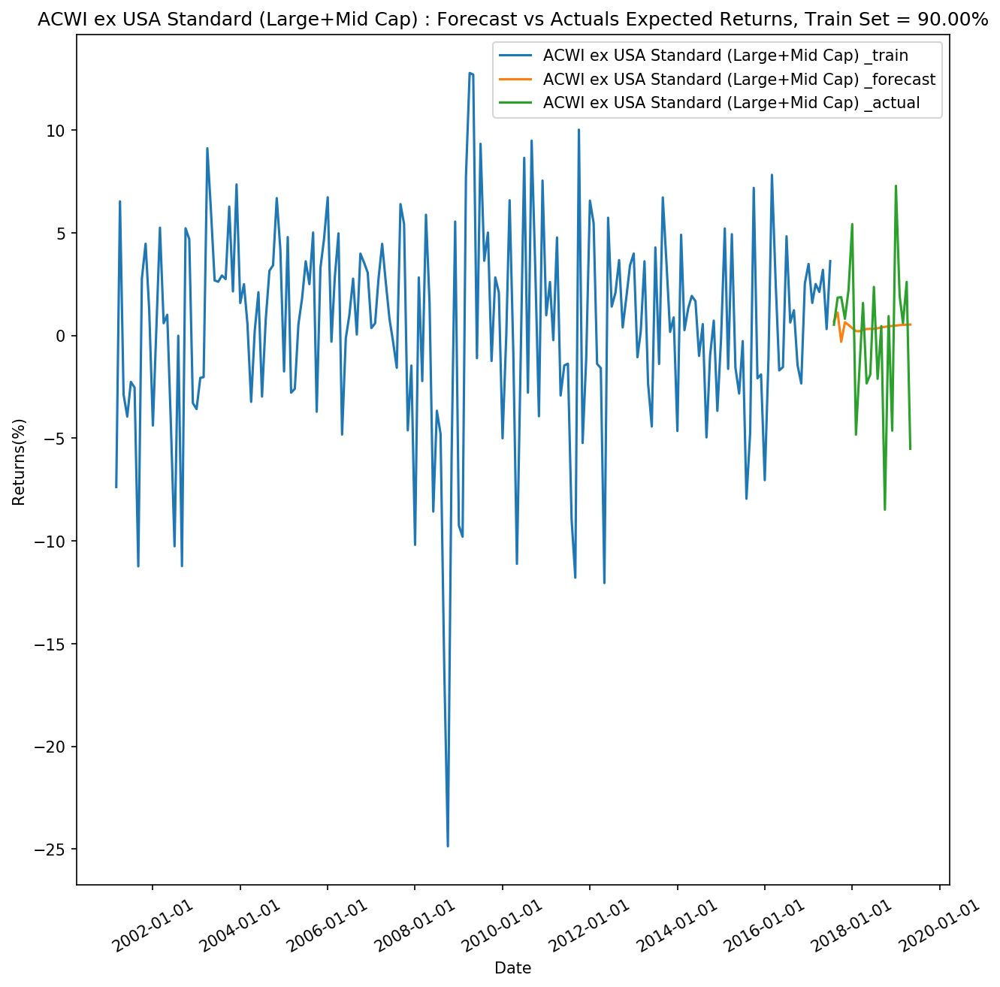

Forecast Accuracy of: ACWI_exUSA
mape   :  0.5194
me     :  -0.7247
mae    :  0.8065
mpe    :  -0.3626
rmse   :  1.1507
corr   :  -0.2664


In [51]:
# Train Size = 90%
[model5_fitted_ACWI_exUSA,df5_ACWI_exUSA,df5_train_ACWI_exUSA,df5_test_ACWI_exUSA,date1] = VAR_Model(merge5_tested_ACWI_exUSA,2,4,0.1)
[df5_forecast_ACWI_exUSA,lag_order5_ACWI_exUSA] = forecast_plot(model5_fitted_ACWI_exUSA,df5_ACWI_exUSA,df5_train_ACWI_exUSA,df5_test_ACWI_exUSA,date1,90)

print('Forecast Accuracy of: ACWI_exUSA')
accuracy_prod = forecast_accuracy(df5_forecast_ACWI_exUSA.iloc[:lag_order5_ACWI_exUSA,0].values, df5_test_ACWI_exUSA.iloc[:lag_order5_ACWI_exUSA,0])

for k, v in accuracy_prod.items():
    print(adjust(k), ': ', round(v,4)) 

  Summary of Regression Results   
Model:                         VAR
Method:                        OLS
Date:           Wed, 28, Aug, 2019
Time:                     14:56:02
--------------------------------------------------------------------
No. of Equations:         3.00000    BIC:                    2.42965
Nobs:                     171.000    HQIC:                   2.00386
Log likelihood:          -835.388    FPE:                    5.55117
AIC:                      1.71313    Det(Omega_mle):         4.45573
--------------------------------------------------------------------
Results for equation ACWI ex USA Standard (Large+Mid Cap) 
                                              coefficient       std. error           t-stat            prob
-----------------------------------------------------------------------------------------------------------
const                                            0.277218         0.403169            0.688           0.492
L1.ACWI ex USA Standard (Lar

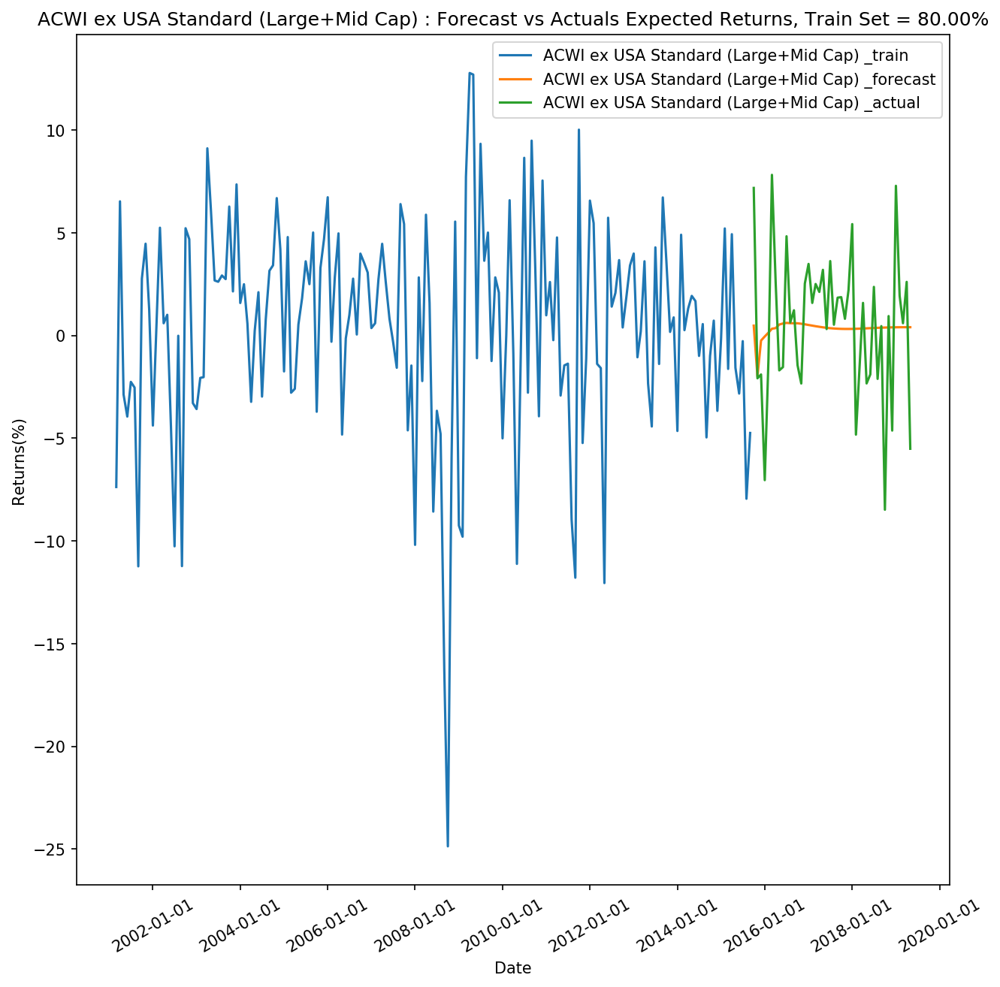

Forecast Accuracy of: ACWI_exUSA
mape   :  0.7102
me     :  0.5096
mae    :  3.8611
mpe    :  -0.7102
rmse   :  4.914
corr   :  0.35


In [130]:
# Train Size = 80%
[model5_fitted_ACWI_exUSA,df5_ACWI_exUSA,df5_train_ACWI_exUSA,df5_test_ACWI_exUSA,date1] = VAR_Model(merge5_tested_ACWI_exUSA,2,4,0.2)
[df5_forecast_ACWI_exUSA,lag_order5_ACWI_exUSA] = forecast_plot(model5_fitted_ACWI_exUSA,df5_ACWI_exUSA,df5_train_ACWI_exUSA,df5_test_ACWI_exUSA,date1,80)

print('Forecast Accuracy of: ACWI_exUSA')
accuracy_prod = forecast_accuracy(df5_forecast_ACWI_exUSA.iloc[:lag_order5_ACWI_exUSA,0].values, df5_test_ACWI_exUSA.iloc[:lag_order5_ACWI_exUSA,0])

for k, v in accuracy_prod.items():
    print(adjust(k), ': ', round(v,4)) 

  Summary of Regression Results   
Model:                         VAR
Method:                        OLS
Date:           Wed, 28, Aug, 2019
Time:                     14:56:04
--------------------------------------------------------------------
No. of Equations:         3.00000    BIC:                    2.68852
Nobs:                     149.000    HQIC:                   2.22170
Log likelihood:          -736.983    FPE:                    6.70992
AIC:                      1.90225    Det(Omega_mle):         5.22073
--------------------------------------------------------------------
Results for equation ACWI ex USA Standard (Large+Mid Cap) 
                                              coefficient       std. error           t-stat            prob
-----------------------------------------------------------------------------------------------------------
const                                            0.395843         0.446222            0.887           0.375
L1.ACWI ex USA Standard (Lar

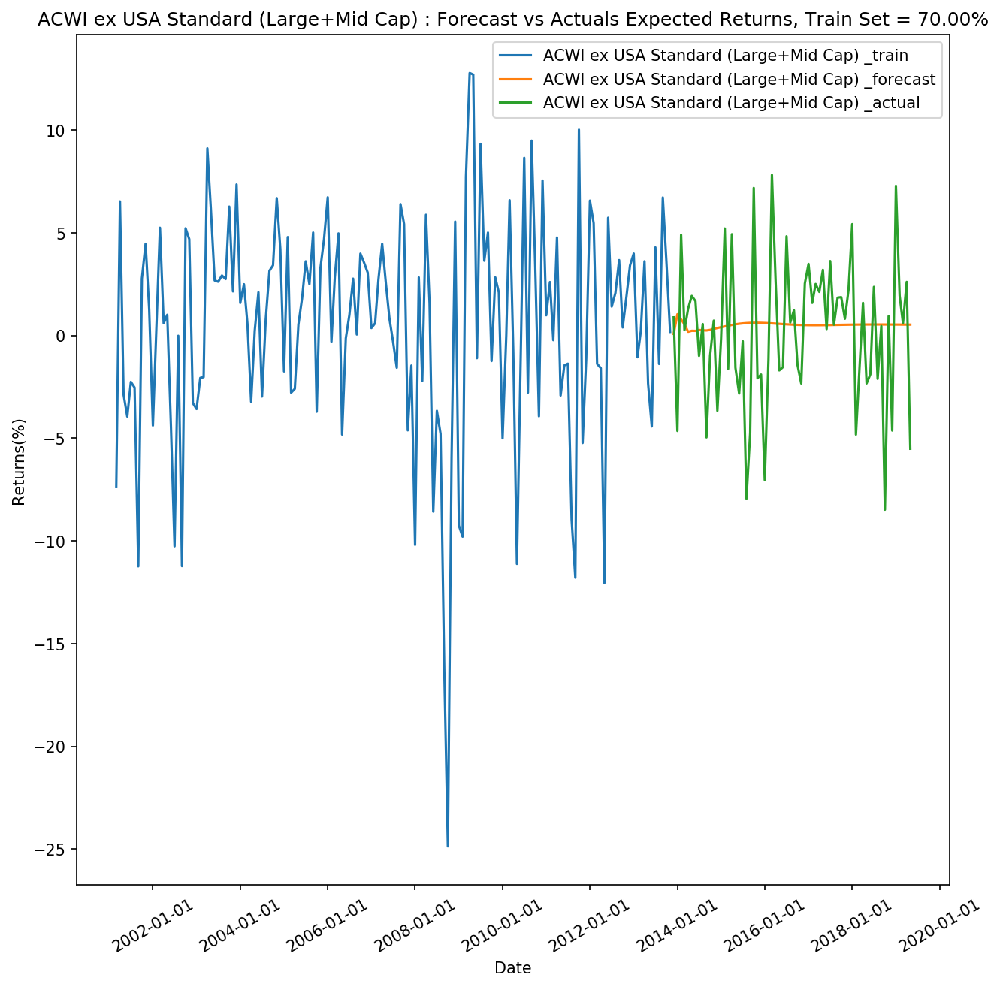

Forecast Accuracy of: ACWI_exUSA
mape   :  1.0258
me     :  0.2619
mae    :  2.7236
mpe    :  -0.4626
rmse   :  3.5352
corr   :  -0.3353


In [131]:
# Train Size = 70%
[model5_fitted_ACWI_exUSA,df5_ACWI_exUSA,df5_train_ACWI_exUSA,df5_test_ACWI_exUSA,date1] = VAR_Model(merge5_tested_ACWI_exUSA,2,4,0.3)
[df5_forecast_ACWI_exUSA,lag_order5_ACWI_exUSA] = forecast_plot(model5_fitted_ACWI_exUSA,df5_ACWI_exUSA,df5_train_ACWI_exUSA,df5_test_ACWI_exUSA,date1,70)

print('Forecast Accuracy of: ACWI_exUSA')
accuracy_prod = forecast_accuracy(df5_forecast_ACWI_exUSA.iloc[:lag_order5_ACWI_exUSA,0].values, df5_test_ACWI_exUSA.iloc[:lag_order5_ACWI_exUSA,0])

for k, v in accuracy_prod.items():
    print(adjust(k), ': ', round(v,4)) 

### 4.3 Lagging Indicators

* Real GDP Growth (Advanced)
* Real GDP Growth (Emerging Market)
* Inflation Rate (Advanced)
* Inflation Rate (Emerging Market)
* Current account balance percent of GDP (Emerging Market)
* Current account balance percent of GDP (Advanced)
* Unemployment rate (OECD Total)
* Youth Unemployment Rate for Developing Countries in East Asia and Pacific (SLUEM1524ZSEAP)
* General government net lending/borrowing Percent of GDP (Emerging Market)
* General government gross debt Percent of GDP (Adanced)

In [52]:
GDP = pd.read_excel("IMF_GDP.xlsx")
Inflation = pd.read_excel("IMF_Inflation.xlsx")
Balance = pd.read_excel("IMF_Current.xlsx")
NetBL = pd.read_excel("IMF_NetBL.xlsx")
Debt = pd.read_excel("IMF_Debt.xlsx")

In [53]:
def IMF_Data(df):
    # Emerging Economies
    col_name = df.columns[0]
    df_Emerging = df[df[col_name]=='Emerging market and developing economies'].T
    df_Emerging = df_Emerging.reset_index().iloc[1:,:]
    col1 = df_Emerging.columns[0]
    col2 = df_Emerging.columns[1]
    col_name1 = col_name+"_Emerging"
    df_Emerging = df_Emerging.rename(columns = {col1:'Date',col2:col_name1})
    df_Emerging = df_Emerging[df_Emerging[col_name1]!='no data'].reset_index(drop=True)
    df_Emerging['Date'] = pd.to_datetime(df_Emerging['Date'],format='%Y')
    df_Emerging = df_Emerging.set_index('Date').asfreq(freq='MS',method='ffill').astype({col_name1: 'float64'})
    df_Emerging.plot()
    
    # Advanced Economies
    df_Advanced = df[df[col_name]=='Advanced economies'].T
    df_Advanced = df_Advanced.reset_index().iloc[1:,:]
    col3 = df_Advanced.columns[1]
    col_name2 = col_name+'_Advanced'
    df_Advanced = df_Advanced.rename(columns = {col1:'Date',col3:col_name2})
    df_Advanced = df_Advanced[df_Advanced[col_name2]!='no data'].reset_index(drop=True)
    df_Advanced['Date'] = pd.to_datetime(df_Advanced['Date'],format='%Y')
    df_Advanced = df_Advanced.set_index('Date').asfreq(freq='MS',method='ffill').astype({col_name2: 'float64'})
    df_Advanced.plot()
    return df_Emerging,df_Advanced

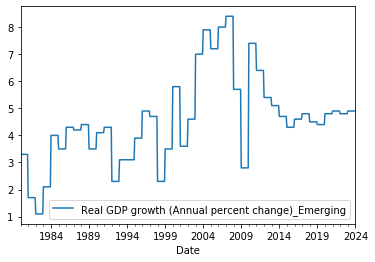

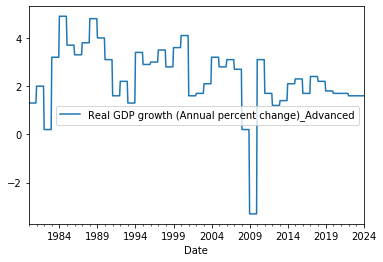

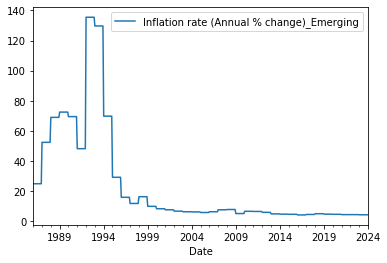

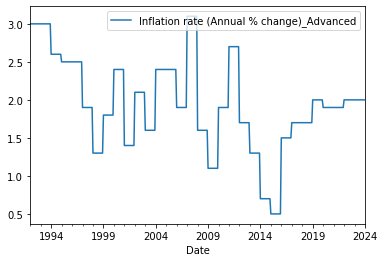

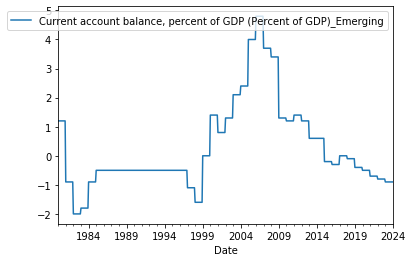

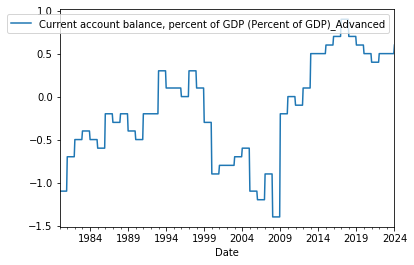

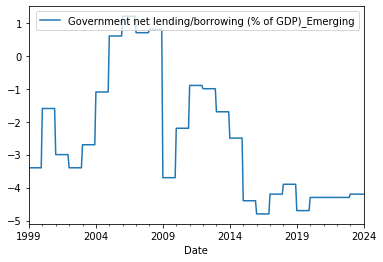

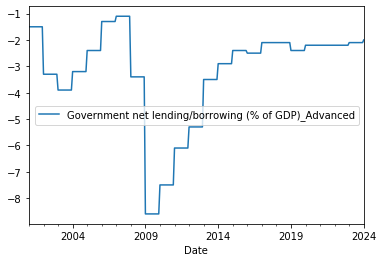

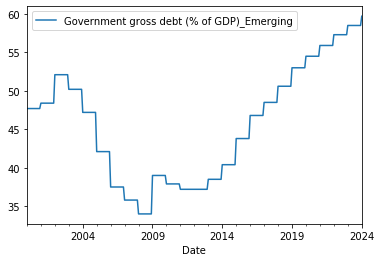

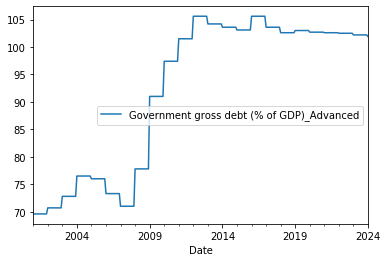

In [54]:
[GDP_Emerging,GDP_Advanced] = IMF_Data(GDP)
[Inflation_Emerging,Inflation_Advanced] = IMF_Data(Inflation)
[Balance_Emerging,Balance_Advanced] = IMF_Data(Balance)
[NetBL_Emerging,NetBL_Advanced] = IMF_Data(NetBL)
[Debt_Emerging,Debt_Advanced] = IMF_Data(Debt)

In [55]:
y_unemployment = fred.get_series('SLUEM1524ZSEAP').dropna()
y_unemployment = pd.DataFrame(y_unemployment,columns=['y_unemployment'])
y_unemployment = y_unemployment.asfreq(freq='MS',method='ffill')

In [56]:
merge6 = pd.concat([TR_2_M,y_unemployment,GDP_Emerging,GDP_Advanced,Inflation_Emerging,Inflation_Advanced,
                     Balance_Emerging,Balance_Advanced,NetBL_Emerging,NetBL_Advanced,
                     Debt_Emerging,Debt_Advanced],join='inner',axis=1).reset_index()
merge6

,Date,ACWI Standard (Large+Mid Cap),ACWI ex USA Standard (Large+Mid Cap),EAFE Standard (Large+Mid Cap),y_unemployment,Real GDP growth (Annual percent change)_Emerging,Real GDP growth (Annual percent change)_Advanced,Inflation rate (Annual % change)_Emerging,Inflation rate (Annual % change)_Advanced,"Current account balance, percent of GDP (Percent of GDP)_Emerging","Current account balance, percent of GDP (Percent of GDP)_Advanced",Government net lending/borrowing (% of GDP)_Emerging,Government net lending/borrowing (% of GDP)_Advanced,Government gross debt (% of GDP)_Emerging,Government gross debt (% of GDP)_Advanced
0,2001-01-01,2.482919,1.482950,-0.051589,9.218007,3.6,1.6,7.6,1.4,0.8,-0.8,-3.0,-1.5,48.4,69.6
1,2001-02-01,-8.809918,-8.251965,-7.792647,9.218007,3.6,1.6,7.6,1.4,0.8,-0.8,-3.0,-1.5,48.4,69.6
2,2001-03-01,-7.007856,-7.379277,-6.898659,9.218007,3.6,1.6,7.6,1.4,0.8,-0.8,-3.0,-1.5,48.4,69.6
3,2001-04-01,6.990809,6.526041,6.718359,9.218007,3.6,1.6,7.6,1.4,0.8,-0.8,-3.0,-1.5,48.4,69.6
4,2001-05-01,-1.182203,-2.876030,-3.593168,9.218007,3.6,1.6,7.6,1.4,0.8,-0.8,-3.0,-1.5,48.4,69.6
5,2001-06-01,-3.141000,-3.949976,-4.175518,9.218007,3.6,1.6,7.6,1.4,0.8,-0.8,-3.0,-1.5,48.4,69.6
6,2001-07-01,-1.609420,-2.262334,-1.836245,9.218007,3.6,1.6,7.6,1.4,0.8,-0.8,-3.0,-1.5,48.4,69.6
7,2001-08-01,-4.740498,-2.537509,-2.566816,9.218007,3.6,1.6,7.6,1.4,0.8,-0.8,-3.0,-1.5,48.4,69.6
8,2001-09-01,-9.607513,-11.240150,-10.679162,9.218007,3.6,1.6,7.6,1.4,0.8,-0.8,-3.0,-1.5,48.4,69.6
9,2001-10-01,2.088319,2.765227,2.528992,9.218007,3.6,1.6,7.6,1.4,0.8,-0.8,-3.0,-1.5,48.4,69.6


#### 4.3.1 Forecast the returns for EAFE

In [57]:
# Grangers Causation Test
[causation_matrix,index_remove,merge6_tested] = causation_test(merge6,3,4)
causation_matrix
index_remove
merge6_tested

     EAFE Standard (Large+Mid Cap)   y_unemployment  \
0                         -0.051589        9.218007   
1                         -7.792647        9.218007   
2                         -6.898659        9.218007   
3                          6.718359        9.218007   
4                         -3.593168        9.218007   
5                         -4.175518        9.218007   
6                         -1.836245        9.218007   
7                         -2.566816        9.218007   
8                        -10.679162        9.218007   
9                          2.528992        9.218007   
10                         3.619946        9.218007   
11                         0.592362        9.218007   
12                        -5.459832        9.942034   
13                         0.698988        9.942034   
14                         5.268001        9.942034   
15                         0.660519        9.942034   
16                         1.259102        9.942034   
17        

,EAFE Standard (Large+Mid Cap) _x,y_unemployment_x,Real GDP growth (Annual percent change)_Emerging_x,Real GDP growth (Annual percent change)_Advanced_x,Inflation rate (Annual % change)_Emerging_x,Inflation rate (Annual % change)_Advanced_x,"Current account balance, percent of GDP (Percent of GDP)_Emerging_x","Current account balance, percent of GDP (Percent of GDP)_Advanced_x",Government net lending/borrowing (% of GDP)_Emerging_x,Government net lending/borrowing (% of GDP)_Advanced_x,Government gross debt (% of GDP)_Emerging_x,Government gross debt (% of GDP)_Advanced_x
EAFE Standard (Large+Mid Cap) _y,1.0000,0.0044,0.0170,0.0037,0.0101,0.1014,0.2334,0.0138,0.0167,0.0001,0.2450,0.1681
y_unemployment_y,0.1266,1.0000,0.4720,0.1369,0.5567,0.6813,0.8957,0.6103,0.9190,0.1443,0.1251,0.2688
Real GDP growth (Annual percent change)_Emerging_y,0.0092,0.2677,1.0000,0.3957,0.6316,0.7915,0.3169,0.3545,0.5193,0.3506,0.0086,0.1953
Real GDP growth (Annual percent change)_Advanced_y,0.0000,0.5359,0.5558,1.0000,0.0745,0.5764,0.4650,0.3466,0.1660,0.1689,0.1133,0.1128
Inflation rate (Annual % change)_Emerging_y,0.0001,0.3974,0.2689,0.9580,1.0000,0.1588,0.0768,0.1445,0.6015,0.9010,0.9109,0.0618
Inflation rate (Annual % change)_Advanced_y,0.2590,0.6401,0.2565,0.5494,0.6773,1.0000,0.3734,0.3295,0.7447,0.7379,0.3679,0.2038
"Current account balance, percent of GDP (Percent of GDP)_Emerging_y",0.0071,0.6948,0.2140,0.2010,0.9738,0.0596,1.0000,0.4198,0.1432,0.8640,0.0068,0.0564
"Current account balance, percent of GDP (Percent of GDP)_Advanced_y",0.0000,0.8780,0.0744,0.0617,0.9113,0.0366,0.4965,1.0000,0.9404,0.3783,0.1775,0.0107
Government net lending/borrowing (% of GDP)_Emerging_y,0.0000,0.3910,0.0141,0.3894,0.9794,0.0149,0.0765,0.4795,1.0000,0.3963,0.1423,0.2383
Government net lending/borrowing (% of GDP)_Advanced_y,0.0000,0.3853,0.6502,0.0856,0.0199,0.8688,0.4077,0.0901,0.3748,1.0000,0.2212,0.1829


[8, 9, 13, 14]

,Date,ACWI Standard (Large+Mid Cap),ACWI ex USA Standard (Large+Mid Cap),EAFE Standard (Large+Mid Cap),y_unemployment,Real GDP growth (Annual percent change)_Emerging,Real GDP growth (Annual percent change)_Advanced,Inflation rate (Annual % change)_Emerging,"Current account balance, percent of GDP (Percent of GDP)_Advanced",Government net lending/borrowing (% of GDP)_Emerging,Government net lending/borrowing (% of GDP)_Advanced
0,2001-01-01,2.482919,1.482950,-0.051589,9.218007,3.6,1.6,7.6,-0.8,-3.0,-1.5
1,2001-02-01,-8.809918,-8.251965,-7.792647,9.218007,3.6,1.6,7.6,-0.8,-3.0,-1.5
2,2001-03-01,-7.007856,-7.379277,-6.898659,9.218007,3.6,1.6,7.6,-0.8,-3.0,-1.5
3,2001-04-01,6.990809,6.526041,6.718359,9.218007,3.6,1.6,7.6,-0.8,-3.0,-1.5
4,2001-05-01,-1.182203,-2.876030,-3.593168,9.218007,3.6,1.6,7.6,-0.8,-3.0,-1.5
5,2001-06-01,-3.141000,-3.949976,-4.175518,9.218007,3.6,1.6,7.6,-0.8,-3.0,-1.5
6,2001-07-01,-1.609420,-2.262334,-1.836245,9.218007,3.6,1.6,7.6,-0.8,-3.0,-1.5
7,2001-08-01,-4.740498,-2.537509,-2.566816,9.218007,3.6,1.6,7.6,-0.8,-3.0,-1.5
8,2001-09-01,-9.607513,-11.240150,-10.679162,9.218007,3.6,1.6,7.6,-0.8,-3.0,-1.5
9,2001-10-01,2.088319,2.765227,2.528992,9.218007,3.6,1.6,7.6,-0.8,-3.0,-1.5


  Summary of Regression Results   
Model:                         VAR
Method:                        OLS
Date:           Wed, 28, Aug, 2019
Time:                     10:15:06
--------------------------------------------------------------------
No. of Equations:         8.00000    BIC:                   -18.4928
Nobs:                     193.000    HQIC:                  -19.2171
Log likelihood:          -216.827    FPE:                2.75610e-09
AIC:                     -19.7100    Det(Omega_mle):     1.91400e-09
--------------------------------------------------------------------
Results for equation EAFE Standard (Large+Mid Cap) 
                                                                          coefficient       std. error           t-stat            prob
---------------------------------------------------------------------------------------------------------------------------------------
const                                                                       57.973385  

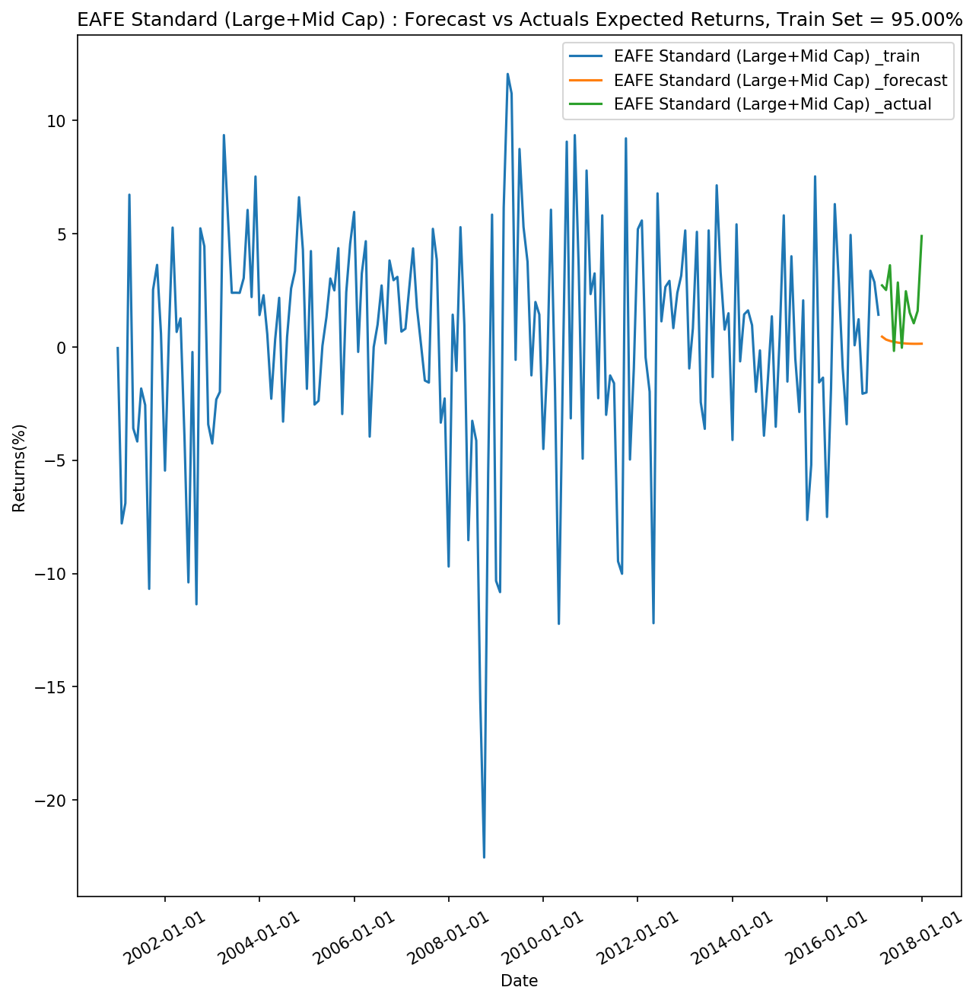

In [58]:
# Forecast, Train Size = 95%
[model6_fitted,df6,df6_train,df6_test,date6] = VAR_Model(merge6_tested,3,4,0.05)
[df6_forecast,lag_order6] = forecast_plot(model6_fitted,df6,df6_train,df6_test,date6,95)

In [59]:
# Test the Accuracy
print('Forecast Accuracy of: EAFE')
accuracy_prod = forecast_accuracy(df6_forecast.iloc[:,0].values, df6_test.iloc[:,0])
for k, v in accuracy_prod.items():
    print(adjust(k), ': ', round(v,4))

print('\nForecast values are: ',df6_forecast.iloc[:lag_order6,0].values)
print('Actual values are: ',df6_test.iloc[:lag_order6,0].values)

Forecast Accuracy of: EAFE
mape   :  1.4401
me     :  -1.8755
mae    :  1.9852
mpe    :  -1.4401
rmse   :  2.3555
corr   :  0.1786

Forecast values are:  [0.45297989]
Actual values are:  [2.71565751]


  Summary of Regression Results   
Model:                         VAR
Method:                        OLS
Date:           Wed, 28, Aug, 2019
Time:                     10:15:30
--------------------------------------------------------------------
No. of Equations:         8.00000    BIC:                   -18.2837
Nobs:                     183.000    HQIC:                  -19.0346
Log likelihood:          -216.823    FPE:                3.24599e-09
AIC:                     -19.5465    Det(Omega_mle):     2.21078e-09
--------------------------------------------------------------------
Results for equation EAFE Standard (Large+Mid Cap) 
                                                                          coefficient       std. error           t-stat            prob
---------------------------------------------------------------------------------------------------------------------------------------
const                                                                       63.898393  

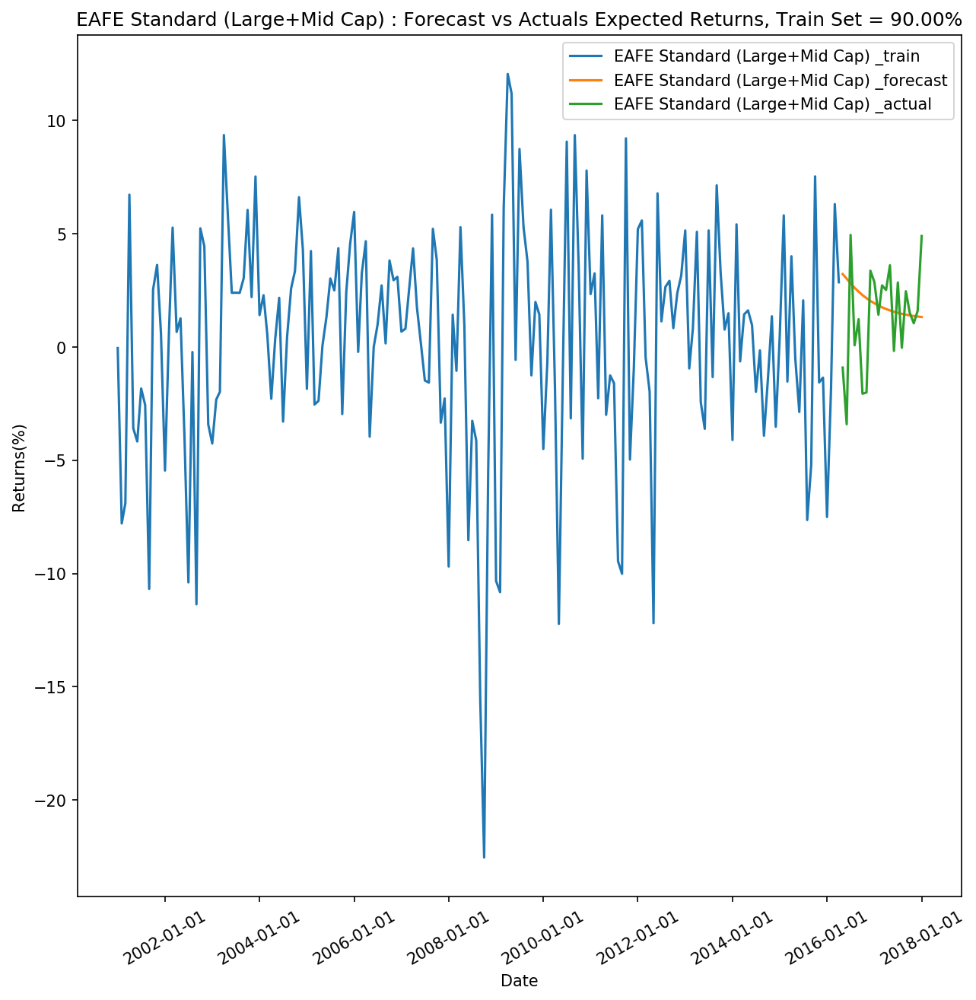

Forecast Accuracy of: EAFE
mape   :  4.8454
me     :  0.5837
mae    :  1.9674
mpe    :  -1.2871
rmse   :  2.5509
corr   :  -0.424

Forecast values are:  [3.21491615]
Actual values are:  [-0.91255911]


In [60]:
# Train Size = 90%
[model6_fitted,df6,df6_train,df6_test,date6] = VAR_Model(merge6_tested,3,4,0.1)
[df6_forecast,lag_order6] = forecast_plot(model6_fitted,df6,df6_train,df6_test,date6,90)
print('Forecast Accuracy of: EAFE')
accuracy_prod = forecast_accuracy(df6_forecast.iloc[:,0].values, df6_test.iloc[:,0])
for k, v in accuracy_prod.items():
    print(adjust(k), ': ', round(v,4))

print('\nForecast values are: ',df6_forecast.iloc[:lag_order6,0].values)
print('Actual values are: ',df6_test.iloc[:lag_order6,0].values)

  Summary of Regression Results   
Model:                         VAR
Method:                        OLS
Date:           Wed, 28, Aug, 2019
Time:                     15:05:58
--------------------------------------------------------------------
No. of Equations:         8.00000    BIC:                   -18.7686
Nobs:                     163.000    HQIC:                  -19.5804
Log likelihood:          -137.276    FPE:                1.80210e-09
AIC:                     -20.1352    Det(Omega_mle):     1.17234e-09
--------------------------------------------------------------------
Results for equation EAFE Standard (Large+Mid Cap) 
                                                                          coefficient       std. error           t-stat            prob
---------------------------------------------------------------------------------------------------------------------------------------
const                                                                       68.505421  

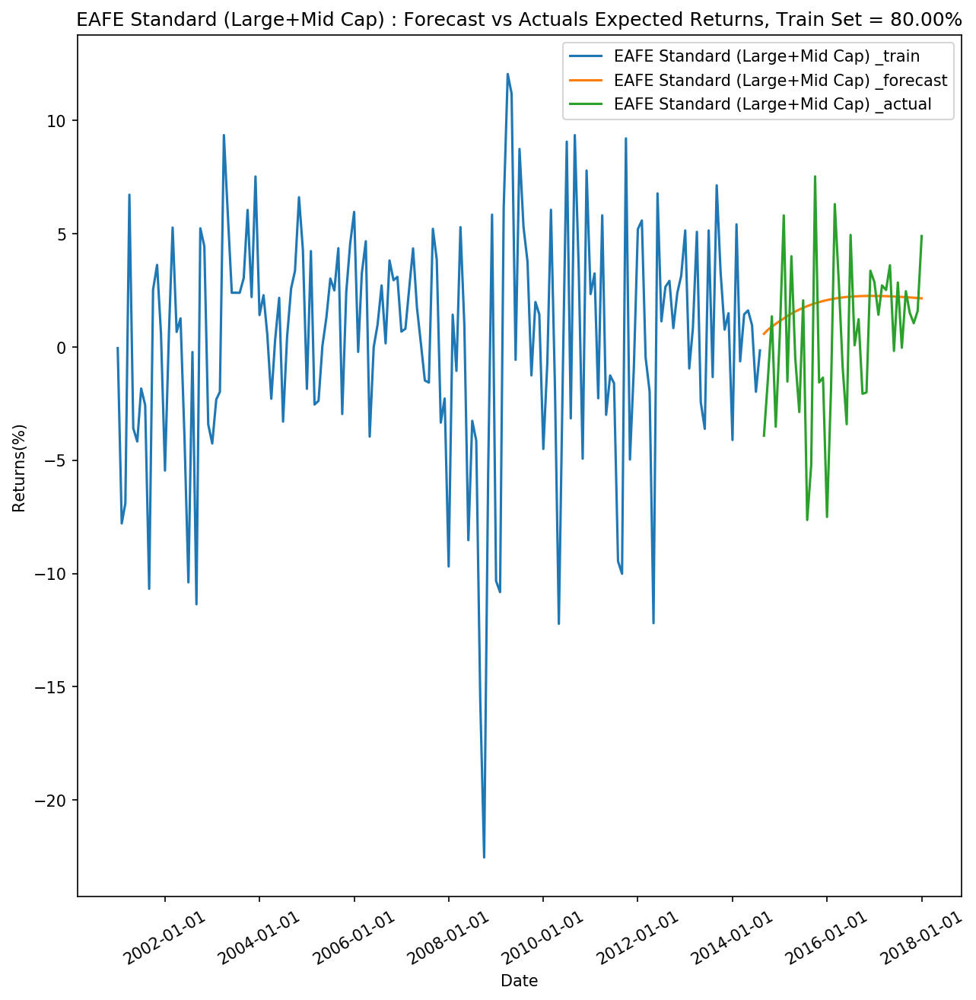

Forecast Accuracy of: EAFE
mape   :  3.5567
me     :  1.4179
mae    :  2.8102
mpe    :  -1.8461
rmse   :  3.6387
corr   :  0.2199

Forecast values are:  [0.57647497]
Actual values are:  [-3.91988666]


In [132]:
# Train Size = 80%
[model6_fitted,df6,df6_train,df6_test,date6] = VAR_Model(merge6_tested,3,4,0.2)
[df6_forecast,lag_order6] = forecast_plot(model6_fitted,df6,df6_train,df6_test,date6,80)
print('Forecast Accuracy of: EAFE')
accuracy_prod = forecast_accuracy(df6_forecast.iloc[:,0].values, df6_test.iloc[:,0])
for k, v in accuracy_prod.items():
    print(adjust(k), ': ', round(v,4))

print('\nForecast values are: ',df6_forecast.iloc[:lag_order6,0].values)
print('Actual values are: ',df6_test.iloc[:lag_order6,0].values)

  Summary of Regression Results   
Model:                         VAR
Method:                        OLS
Date:           Wed, 28, Aug, 2019
Time:                     15:06:06
--------------------------------------------------------------------
No. of Equations:         8.00000    BIC:                   -19.0810
Nobs:                     142.000    HQIC:                  -19.9707
Log likelihood:          -78.7555    FPE:                1.15595e-09
AIC:                     -20.5797    Det(Omega_mle):     7.07021e-10
--------------------------------------------------------------------
Results for equation EAFE Standard (Large+Mid Cap) 
                                                                          coefficient       std. error           t-stat            prob
---------------------------------------------------------------------------------------------------------------------------------------
const                                                                       58.419527  

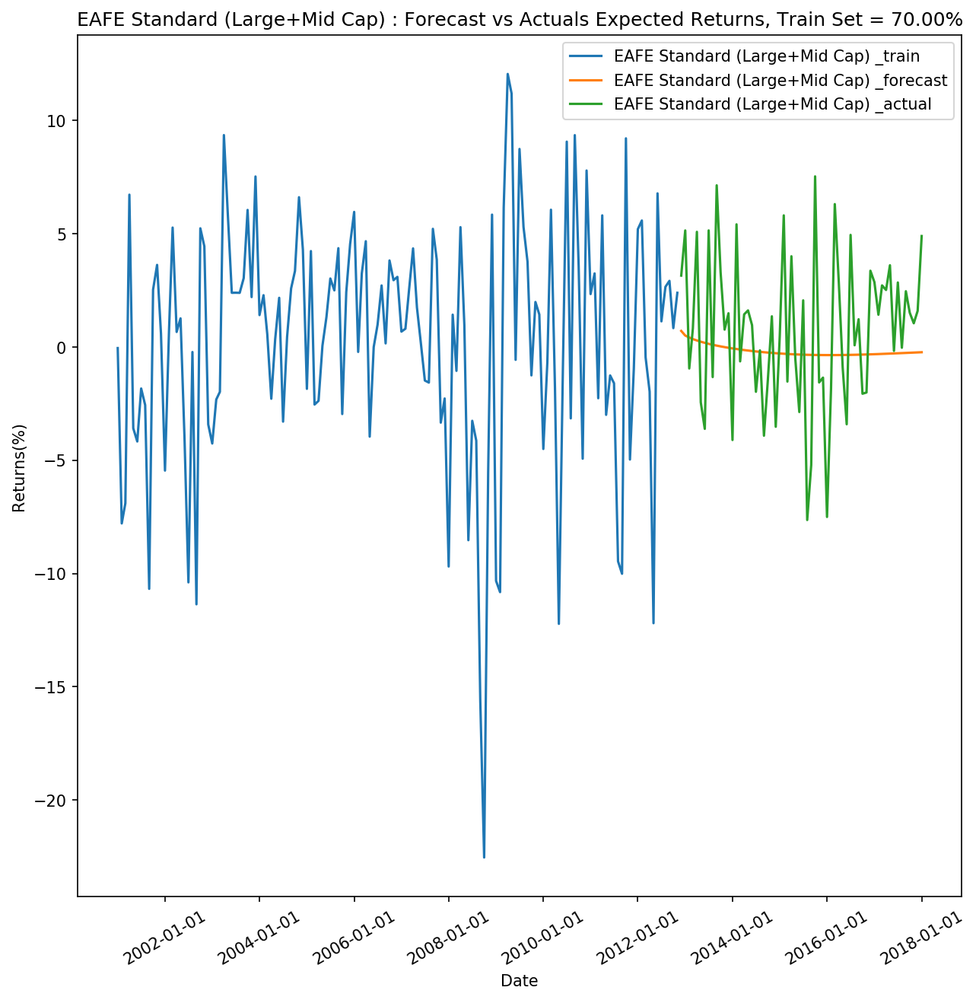

Forecast Accuracy of: EAFE
mape   :  1.1523
me     :  -0.9224
mae    :  2.7839
mpe    :  -0.9168
rmse   :  3.4238
corr   :  0.1705

Forecast values are:  [0.70553485]
Actual values are:  [3.14681718]


In [133]:
# Train Size = 70%
[model6_fitted,df6,df6_train,df6_test,date6] = VAR_Model(merge6_tested,3,4,0.3)
[df6_forecast,lag_order6] = forecast_plot(model6_fitted,df6,df6_train,df6_test,date6,70)
print('Forecast Accuracy of: EAFE')
accuracy_prod = forecast_accuracy(df6_forecast.iloc[:,0].values, df6_test.iloc[:,0])
for k, v in accuracy_prod.items():
    print(adjust(k), ': ', round(v,4))

print('\nForecast values are: ',df6_forecast.iloc[:lag_order6,0].values)
print('Actual values are: ',df6_test.iloc[:lag_order6,0].values)

#### 4.3.2 Forecast the returns for ACWI

     ACWI Standard (Large+Mid Cap)   y_unemployment  \
0                          2.482919        9.218007   
1                         -8.809918        9.218007   
2                         -7.007856        9.218007   
3                          6.990809        9.218007   
4                         -1.182203        9.218007   
5                         -3.141000        9.218007   
6                         -1.609420        9.218007   
7                         -4.740498        9.218007   
8                         -9.607513        9.218007   
9                          2.088319        9.218007   
10                         5.940744        9.218007   
11                         0.911157        9.218007   
12                        -2.799256        9.942034   
13                        -0.767562        9.942034   
14                         4.382188        9.942034   
15                        -3.256888        9.942034   
16                         0.077016        9.942034   
17        

,ACWI Standard (Large+Mid Cap) _x,y_unemployment_x,Real GDP growth (Annual percent change)_Emerging_x,Real GDP growth (Annual percent change)_Advanced_x,Inflation rate (Annual % change)_Emerging_x,Inflation rate (Annual % change)_Advanced_x,"Current account balance, percent of GDP (Percent of GDP)_Emerging_x","Current account balance, percent of GDP (Percent of GDP)_Advanced_x",Government net lending/borrowing (% of GDP)_Emerging_x,Government net lending/borrowing (% of GDP)_Advanced_x,Government gross debt (% of GDP)_Emerging_x,Government gross debt (% of GDP)_Advanced_x
ACWI Standard (Large+Mid Cap) _y,1.0000,0.0014,0.0261,0.0062,0.0032,0.0388,0.1140,0.0040,0.0139,0.0003,0.2908,0.0532
y_unemployment_y,0.0638,1.0000,0.4720,0.1369,0.5567,0.6813,0.8957,0.6103,0.9190,0.1443,0.1251,0.2688
Real GDP growth (Annual percent change)_Emerging_y,0.0097,0.2677,1.0000,0.3957,0.6316,0.7915,0.3169,0.3545,0.5193,0.3506,0.0086,0.1953
Real GDP growth (Annual percent change)_Advanced_y,0.0000,0.5359,0.5558,1.0000,0.0745,0.5764,0.4650,0.3466,0.1660,0.1689,0.1133,0.1128
Inflation rate (Annual % change)_Emerging_y,0.0001,0.3974,0.2689,0.9580,1.0000,0.1588,0.0768,0.1445,0.6015,0.9010,0.9109,0.0618
Inflation rate (Annual % change)_Advanced_y,0.3189,0.6401,0.2565,0.5494,0.6773,1.0000,0.3734,0.3295,0.7447,0.7379,0.3679,0.2038
"Current account balance, percent of GDP (Percent of GDP)_Emerging_y",0.0039,0.6948,0.2140,0.2010,0.9738,0.0596,1.0000,0.4198,0.1432,0.8640,0.0068,0.0564
"Current account balance, percent of GDP (Percent of GDP)_Advanced_y",0.0000,0.8780,0.0744,0.0617,0.9113,0.0366,0.4965,1.0000,0.9404,0.3783,0.1775,0.0107
Government net lending/borrowing (% of GDP)_Emerging_y,0.0000,0.3910,0.0141,0.3894,0.9794,0.0149,0.0765,0.4795,1.0000,0.3963,0.1423,0.2383
Government net lending/borrowing (% of GDP)_Advanced_y,0.0000,0.3853,0.6502,0.0856,0.0199,0.8688,0.4077,0.0901,0.3748,1.0000,0.2212,0.1829


[9, 13, 14]

,Date,ACWI Standard (Large+Mid Cap),ACWI ex USA Standard (Large+Mid Cap),EAFE Standard (Large+Mid Cap),y_unemployment,Real GDP growth (Annual percent change)_Emerging,Real GDP growth (Annual percent change)_Advanced,Inflation rate (Annual % change)_Emerging,Inflation rate (Annual % change)_Advanced,"Current account balance, percent of GDP (Percent of GDP)_Advanced",Government net lending/borrowing (% of GDP)_Emerging,Government net lending/borrowing (% of GDP)_Advanced
0,2001-01-01,2.482919,1.482950,-0.051589,9.218007,3.6,1.6,7.6,1.4,-0.8,-3.0,-1.5
1,2001-02-01,-8.809918,-8.251965,-7.792647,9.218007,3.6,1.6,7.6,1.4,-0.8,-3.0,-1.5
2,2001-03-01,-7.007856,-7.379277,-6.898659,9.218007,3.6,1.6,7.6,1.4,-0.8,-3.0,-1.5
3,2001-04-01,6.990809,6.526041,6.718359,9.218007,3.6,1.6,7.6,1.4,-0.8,-3.0,-1.5
4,2001-05-01,-1.182203,-2.876030,-3.593168,9.218007,3.6,1.6,7.6,1.4,-0.8,-3.0,-1.5
5,2001-06-01,-3.141000,-3.949976,-4.175518,9.218007,3.6,1.6,7.6,1.4,-0.8,-3.0,-1.5
6,2001-07-01,-1.609420,-2.262334,-1.836245,9.218007,3.6,1.6,7.6,1.4,-0.8,-3.0,-1.5
7,2001-08-01,-4.740498,-2.537509,-2.566816,9.218007,3.6,1.6,7.6,1.4,-0.8,-3.0,-1.5
8,2001-09-01,-9.607513,-11.240150,-10.679162,9.218007,3.6,1.6,7.6,1.4,-0.8,-3.0,-1.5
9,2001-10-01,2.088319,2.765227,2.528992,9.218007,3.6,1.6,7.6,1.4,-0.8,-3.0,-1.5


  Summary of Regression Results   
Model:                         VAR
Method:                        OLS
Date:           Wed, 28, Aug, 2019
Time:                     11:10:00
--------------------------------------------------------------------
No. of Equations:         9.00000    BIC:                   -21.7071
Nobs:                     193.000    HQIC:                  -22.6124
Log likelihood:          -133.140    FPE:                8.17193e-11
AIC:                     -23.2286    Det(Omega_mle):     5.18652e-11
--------------------------------------------------------------------
Results for equation ACWI Standard (Large+Mid Cap) 
                                                                          coefficient       std. error           t-stat            prob
---------------------------------------------------------------------------------------------------------------------------------------
const                                                                       59.548784  

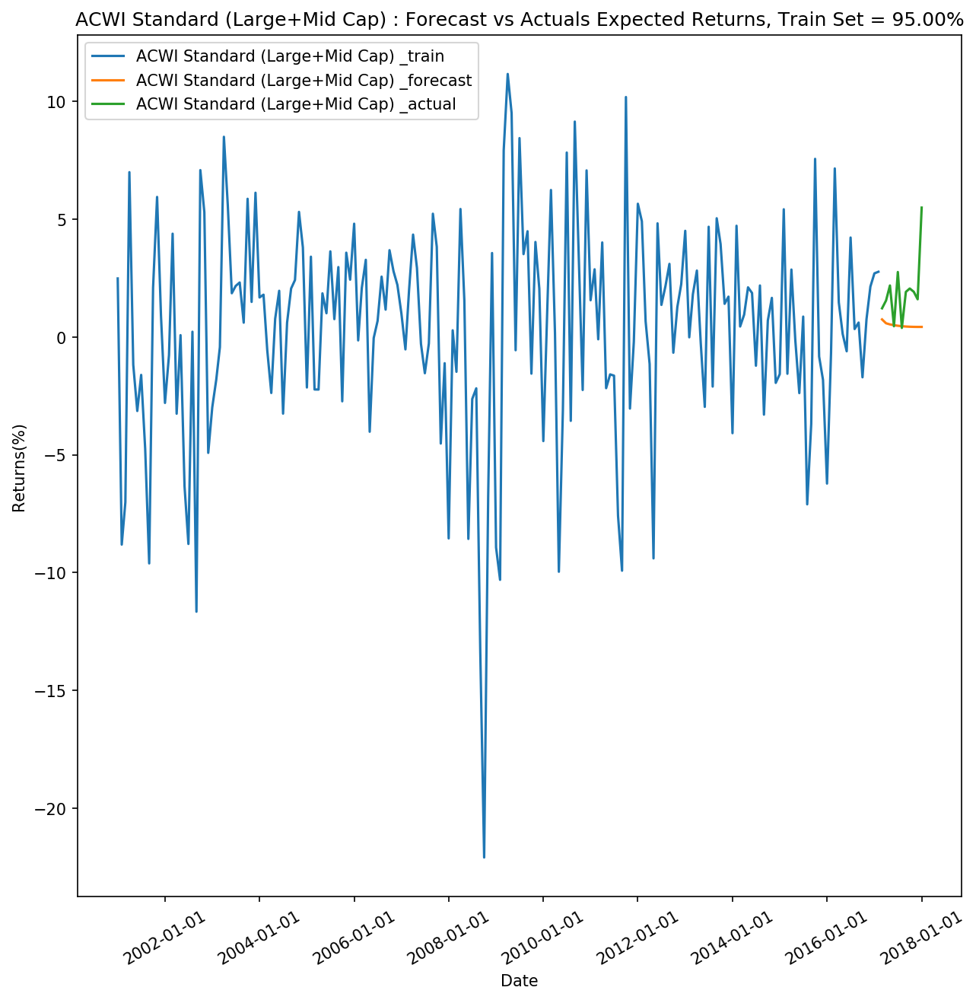

Forecast Accuracy of: ACWI
mape   :  0.6256
me     :  -1.4604
mae    :  1.4824
mpe    :  -0.5718
rmse   :  1.9794
corr   :  -0.2967


In [61]:
[causation_matrix,index_remove,merge6_tested_ACWI] = causation_test(merge6,1,4)
causation_matrix
index_remove
merge6_tested_ACWI

# Train Size = 95%
[model6_fitted_ACWI,df6_ACWI,df6_train_ACWI,df6_test_ACWI,date6] = VAR_Model(merge6_tested_ACWI,1,4,0.05)
[df6_forecast_ACWI,lag_order6_ACWI] = forecast_plot(model6_fitted_ACWI,df6_ACWI,df6_train_ACWI,df6_test_ACWI,date6,95)

print('Forecast Accuracy of: ACWI')
accuracy_prod = forecast_accuracy(df6_forecast_ACWI.iloc[:,0].values, df6_test_ACWI.iloc[:,0])

for k, v in accuracy_prod.items():
    print(adjust(k), ': ', round(v,4)) 

  Summary of Regression Results   
Model:                         VAR
Method:                        OLS
Date:           Wed, 28, Aug, 2019
Time:                     11:10:43
--------------------------------------------------------------------
No. of Equations:         9.00000    BIC:                   -21.4254
Nobs:                     183.000    HQIC:                  -22.3640
Log likelihood:          -142.143    FPE:                1.02329e-10
AIC:                     -23.0038    Det(Omega_mle):     6.33930e-11
--------------------------------------------------------------------
Results for equation ACWI Standard (Large+Mid Cap) 
                                                                          coefficient       std. error           t-stat            prob
---------------------------------------------------------------------------------------------------------------------------------------
const                                                                       63.302731  

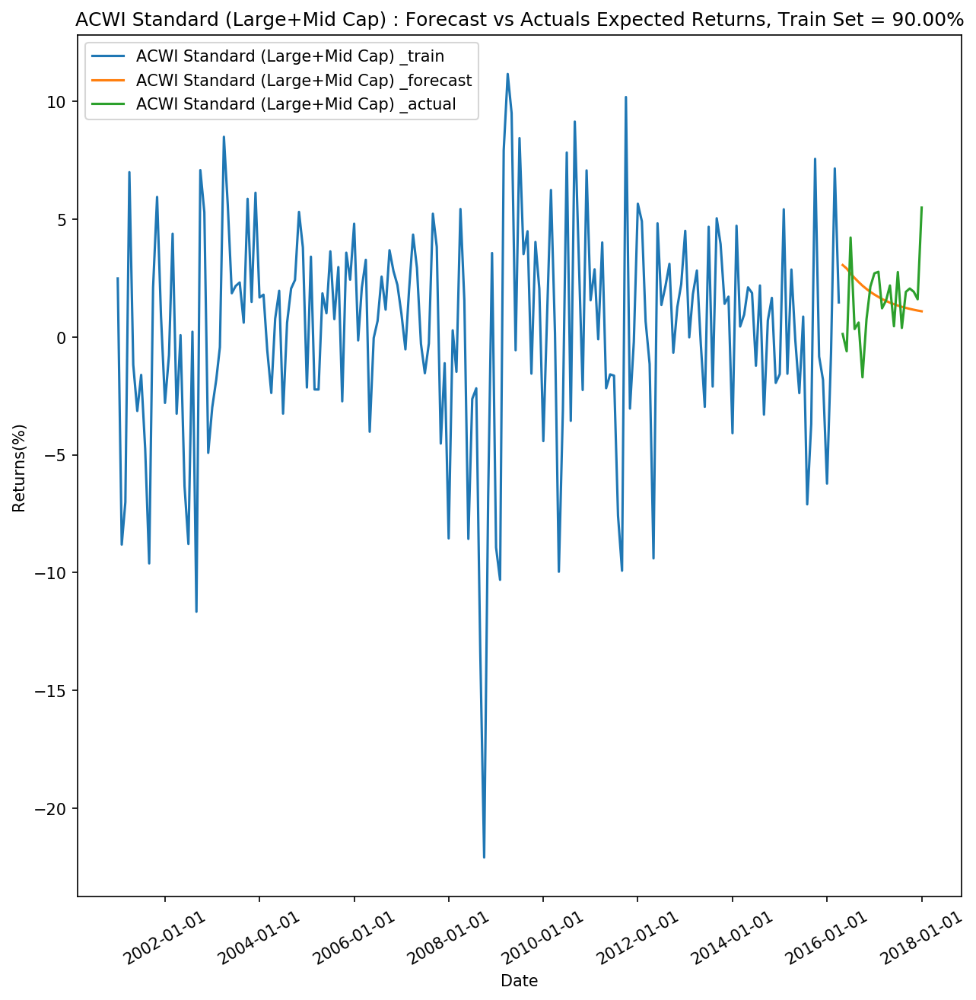

Forecast Accuracy of: ACWI
mape   :  2.4426
me     :  0.2211
mae    :  1.4662
mpe    :  1.264
rmse   :  1.8945
corr   :  -0.3992


In [63]:
# Train Size = 90%
[model6_fitted_ACWI,df6_ACWI,df6_train_ACWI,df6_test_ACWI,date6] = VAR_Model(merge6_tested_ACWI,1,4,0.1)
[df6_forecast_ACWI,lag_order6_ACWI] = forecast_plot(model6_fitted_ACWI,df6_ACWI,df6_train_ACWI,df6_test_ACWI,date6,90)

print('Forecast Accuracy of: ACWI')
accuracy_prod = forecast_accuracy(df6_forecast_ACWI.iloc[:,0].values, df6_test_ACWI.iloc[:,0])

for k, v in accuracy_prod.items():
    print(adjust(k), ': ', round(v,4))

  Summary of Regression Results   
Model:                         VAR
Method:                        OLS
Date:           Wed, 28, Aug, 2019
Time:                     15:21:17
--------------------------------------------------------------------
No. of Equations:         9.00000    BIC:                   -21.9971
Nobs:                     163.000    HQIC:                  -23.0118
Log likelihood:          -59.5995    FPE:                5.07592e-11
AIC:                     -23.7053    Det(Omega_mle):     2.97022e-11
--------------------------------------------------------------------
Results for equation ACWI Standard (Large+Mid Cap) 
                                                                          coefficient       std. error           t-stat            prob
---------------------------------------------------------------------------------------------------------------------------------------
const                                                                       68.251176  

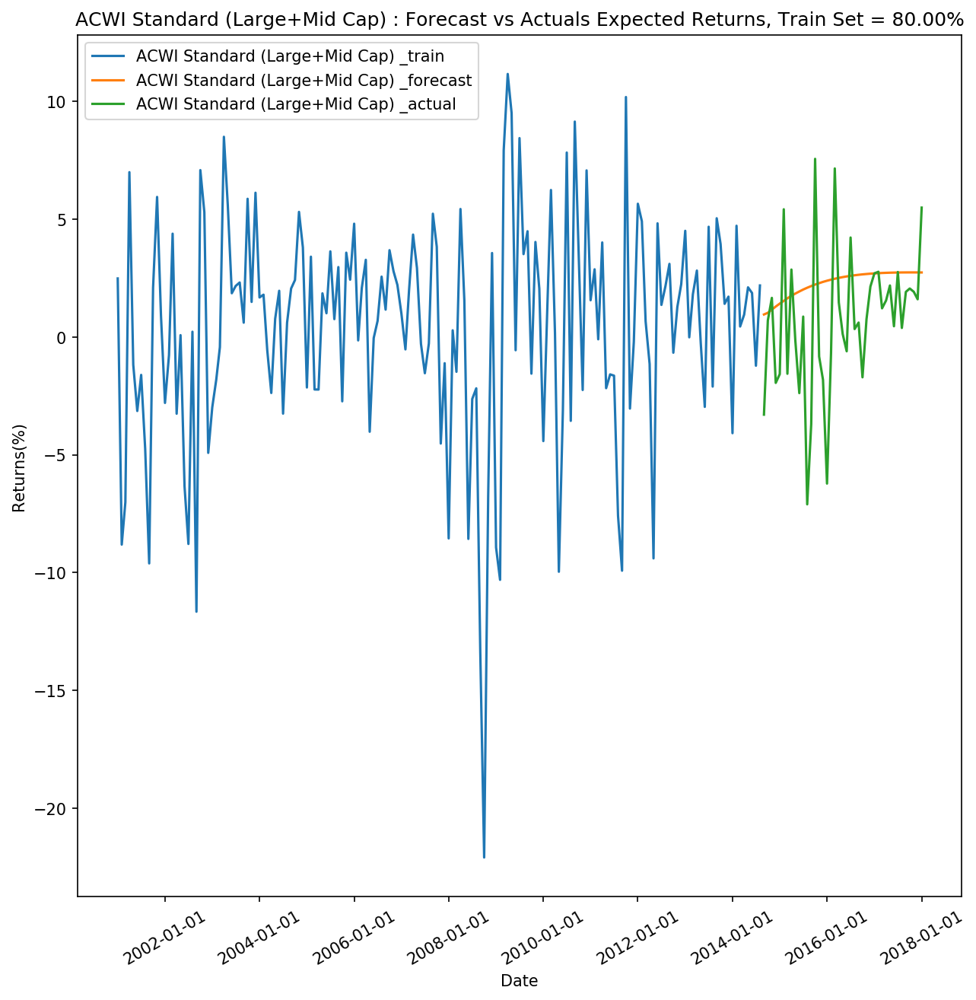

Forecast Accuracy of: ACWI
mape   :  2.4382
me     :  1.5751
mae    :  2.5494
mpe    :  -0.0052
rmse   :  3.2957
corr   :  0.2603


In [134]:
# Train Size = 80%
[model6_fitted_ACWI,df6_ACWI,df6_train_ACWI,df6_test_ACWI,date6] = VAR_Model(merge6_tested_ACWI,1,4,0.2)
[df6_forecast_ACWI,lag_order6_ACWI] = forecast_plot(model6_fitted_ACWI,df6_ACWI,df6_train_ACWI,df6_test_ACWI,date6,80)

print('Forecast Accuracy of: ACWI')
accuracy_prod = forecast_accuracy(df6_forecast_ACWI.iloc[:,0].values, df6_test_ACWI.iloc[:,0])

for k, v in accuracy_prod.items():
    print(adjust(k), ': ', round(v,4))

  Summary of Regression Results   
Model:                         VAR
Method:                        OLS
Date:           Wed, 28, Aug, 2019
Time:                     15:21:18
--------------------------------------------------------------------
No. of Equations:         9.00000    BIC:                   -22.4766
Nobs:                     142.000    HQIC:                  -23.5887
Log likelihood:           5.44455    FPE:                2.66596e-11
AIC:                     -24.3500    Det(Omega_mle):     1.44496e-11
--------------------------------------------------------------------
Results for equation ACWI Standard (Large+Mid Cap) 
                                                                          coefficient       std. error           t-stat            prob
---------------------------------------------------------------------------------------------------------------------------------------
const                                                                       63.688119  

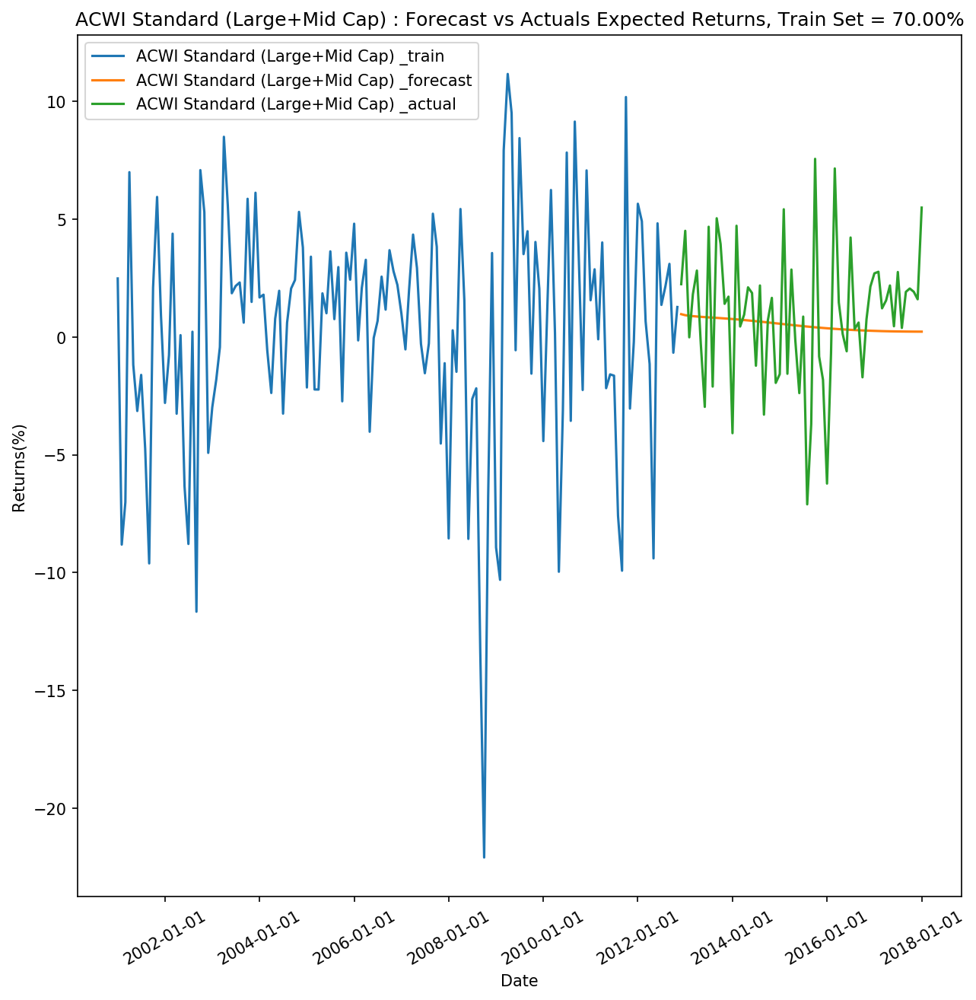

Forecast Accuracy of: ACWI
mape   :  1.9406
me     :  -0.4425
mae    :  2.2422
mpe    :  -1.8694
rmse   :  2.8897
corr   :  0.0027


In [135]:
# Train Size = 70%
[model6_fitted_ACWI,df6_ACWI,df6_train_ACWI,df6_test_ACWI,date6] = VAR_Model(merge6_tested_ACWI,1,4,0.3)
[df6_forecast_ACWI,lag_order6_ACWI] = forecast_plot(model6_fitted_ACWI,df6_ACWI,df6_train_ACWI,df6_test_ACWI,date6,70)

print('Forecast Accuracy of: ACWI')
accuracy_prod = forecast_accuracy(df6_forecast_ACWI.iloc[:,0].values, df6_test_ACWI.iloc[:,0])

for k, v in accuracy_prod.items():
    print(adjust(k), ': ', round(v,4))

#### 4.3.3 Forecast the returns for ACWI ex USA

     ACWI ex USA Standard (Large+Mid Cap)   y_unemployment  \
0                                 1.482950        9.218007   
1                                -8.251965        9.218007   
2                                -7.379277        9.218007   
3                                 6.526041        9.218007   
4                                -2.876030        9.218007   
5                                -3.949976        9.218007   
6                                -2.262334        9.218007   
7                                -2.537509        9.218007   
8                               -11.240150        9.218007   
9                                 2.765227        9.218007   
10                                4.464221        9.218007   
11                                1.276394        9.218007   
12                               -4.386808        9.942034   
13                                0.709522        9.942034   
14                                5.244685        9.942034   
15      

,ACWI ex USA Standard (Large+Mid Cap) _x,y_unemployment_x,Real GDP growth (Annual percent change)_Emerging_x,Real GDP growth (Annual percent change)_Advanced_x,Inflation rate (Annual % change)_Emerging_x,Inflation rate (Annual % change)_Advanced_x,"Current account balance, percent of GDP (Percent of GDP)_Emerging_x","Current account balance, percent of GDP (Percent of GDP)_Advanced_x",Government net lending/borrowing (% of GDP)_Emerging_x,Government net lending/borrowing (% of GDP)_Advanced_x,Government gross debt (% of GDP)_Emerging_x,Government gross debt (% of GDP)_Advanced_x
ACWI ex USA Standard (Large+Mid Cap) _y,1.0000,0.0057,0.0226,0.0111,0.0159,0.0315,0.1834,0.0030,0.0154,0.0001,0.2269,0.1493
y_unemployment_y,0.1212,1.0000,0.4720,0.1369,0.5567,0.6813,0.8957,0.6103,0.9190,0.1443,0.1251,0.2688
Real GDP growth (Annual percent change)_Emerging_y,0.0050,0.2677,1.0000,0.3957,0.6316,0.7915,0.3169,0.3545,0.5193,0.3506,0.0086,0.1953
Real GDP growth (Annual percent change)_Advanced_y,0.0000,0.5359,0.5558,1.0000,0.0745,0.5764,0.4650,0.3466,0.1660,0.1689,0.1133,0.1128
Inflation rate (Annual % change)_Emerging_y,0.0000,0.3974,0.2689,0.9580,1.0000,0.1588,0.0768,0.1445,0.6015,0.9010,0.9109,0.0618
Inflation rate (Annual % change)_Advanced_y,0.2809,0.6401,0.2565,0.5494,0.6773,1.0000,0.3734,0.3295,0.7447,0.7379,0.3679,0.2038
"Current account balance, percent of GDP (Percent of GDP)_Emerging_y",0.0034,0.6948,0.2140,0.2010,0.9738,0.0596,1.0000,0.4198,0.1432,0.8640,0.0068,0.0564
"Current account balance, percent of GDP (Percent of GDP)_Advanced_y",0.0000,0.8780,0.0744,0.0617,0.9113,0.0366,0.4965,1.0000,0.9404,0.3783,0.1775,0.0107
Government net lending/borrowing (% of GDP)_Emerging_y,0.0000,0.3910,0.0141,0.3894,0.9794,0.0149,0.0765,0.4795,1.0000,0.3963,0.1423,0.2383
Government net lending/borrowing (% of GDP)_Advanced_y,0.0000,0.3853,0.6502,0.0856,0.0199,0.8688,0.4077,0.0901,0.3748,1.0000,0.2212,0.1829


[9, 13, 14]

,Date,ACWI Standard (Large+Mid Cap),ACWI ex USA Standard (Large+Mid Cap),EAFE Standard (Large+Mid Cap),y_unemployment,Real GDP growth (Annual percent change)_Emerging,Real GDP growth (Annual percent change)_Advanced,Inflation rate (Annual % change)_Emerging,Inflation rate (Annual % change)_Advanced,"Current account balance, percent of GDP (Percent of GDP)_Advanced",Government net lending/borrowing (% of GDP)_Emerging,Government net lending/borrowing (% of GDP)_Advanced
0,2001-01-01,2.482919,1.482950,-0.051589,9.218007,3.6,1.6,7.6,1.4,-0.8,-3.0,-1.5
1,2001-02-01,-8.809918,-8.251965,-7.792647,9.218007,3.6,1.6,7.6,1.4,-0.8,-3.0,-1.5
2,2001-03-01,-7.007856,-7.379277,-6.898659,9.218007,3.6,1.6,7.6,1.4,-0.8,-3.0,-1.5
3,2001-04-01,6.990809,6.526041,6.718359,9.218007,3.6,1.6,7.6,1.4,-0.8,-3.0,-1.5
4,2001-05-01,-1.182203,-2.876030,-3.593168,9.218007,3.6,1.6,7.6,1.4,-0.8,-3.0,-1.5
5,2001-06-01,-3.141000,-3.949976,-4.175518,9.218007,3.6,1.6,7.6,1.4,-0.8,-3.0,-1.5
6,2001-07-01,-1.609420,-2.262334,-1.836245,9.218007,3.6,1.6,7.6,1.4,-0.8,-3.0,-1.5
7,2001-08-01,-4.740498,-2.537509,-2.566816,9.218007,3.6,1.6,7.6,1.4,-0.8,-3.0,-1.5
8,2001-09-01,-9.607513,-11.240150,-10.679162,9.218007,3.6,1.6,7.6,1.4,-0.8,-3.0,-1.5
9,2001-10-01,2.088319,2.765227,2.528992,9.218007,3.6,1.6,7.6,1.4,-0.8,-3.0,-1.5


  Summary of Regression Results   
Model:                         VAR
Method:                        OLS
Date:           Wed, 28, Aug, 2019
Time:                     11:20:55
--------------------------------------------------------------------
No. of Equations:         9.00000    BIC:                   -21.4999
Nobs:                     193.000    HQIC:                  -22.4052
Log likelihood:          -153.138    FPE:                1.00537e-10
AIC:                     -23.0213    Det(Omega_mle):     6.38085e-11
--------------------------------------------------------------------
Results for equation ACWI ex USA Standard (Large+Mid Cap) 
                                                                          coefficient       std. error           t-stat            prob
---------------------------------------------------------------------------------------------------------------------------------------
const                                                                       61.0

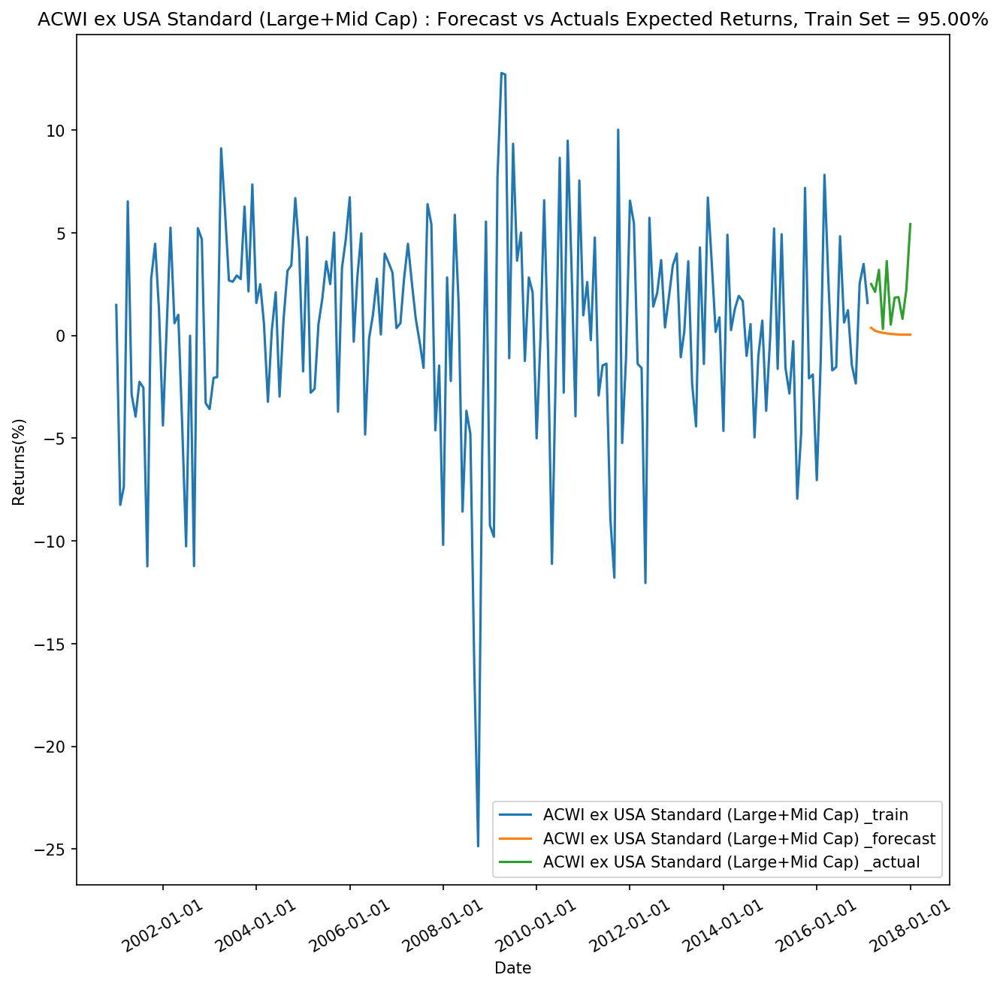

Forecast Accuracy of: ACWI_exUSA
mape   :  0.9079
me     :  -2.1027
mae    :  2.1027
mpe    :  -0.9079
rmse   :  2.5349
corr   :  0.0295


In [64]:
[causation_matrix,index_remove,merge6_tested_ACWI_exUSA] = causation_test(merge6,2,4)
causation_matrix
index_remove
merge6_tested_ACWI_exUSA

# Train Size = 95%
[model6_fitted_ACWI_exUSA,df6_ACWI_exUSA,df6_train_ACWI_exUSA,df6_test_ACWI_exUSA,date6] = VAR_Model(merge6_tested_ACWI_exUSA,2,4,0.05)
[df6_forecast_ACWI_exUSA,lag_order6_ACWI_exUSA] = forecast_plot(model6_fitted_ACWI_exUSA,df6_ACWI_exUSA,df6_train_ACWI_exUSA,df6_test_ACWI_exUSA,date6,95)

print('Forecast Accuracy of: ACWI_exUSA')
accuracy_prod = forecast_accuracy(df6_forecast_ACWI_exUSA.iloc[:,0].values, df6_test_ACWI_exUSA.iloc[:,0])

for k, v in accuracy_prod.items():
    print(adjust(k), ': ', round(v,4)) 

  Summary of Regression Results   
Model:                         VAR
Method:                        OLS
Date:           Wed, 28, Aug, 2019
Time:                     11:21:10
--------------------------------------------------------------------
No. of Equations:         9.00000    BIC:                   -21.2252
Nobs:                     183.000    HQIC:                  -22.1639
Log likelihood:          -160.455    FPE:                1.25000e-10
AIC:                     -22.8037    Det(Omega_mle):     7.74382e-11
--------------------------------------------------------------------
Results for equation ACWI ex USA Standard (Large+Mid Cap) 
                                                                          coefficient       std. error           t-stat            prob
---------------------------------------------------------------------------------------------------------------------------------------
const                                                                       65.2

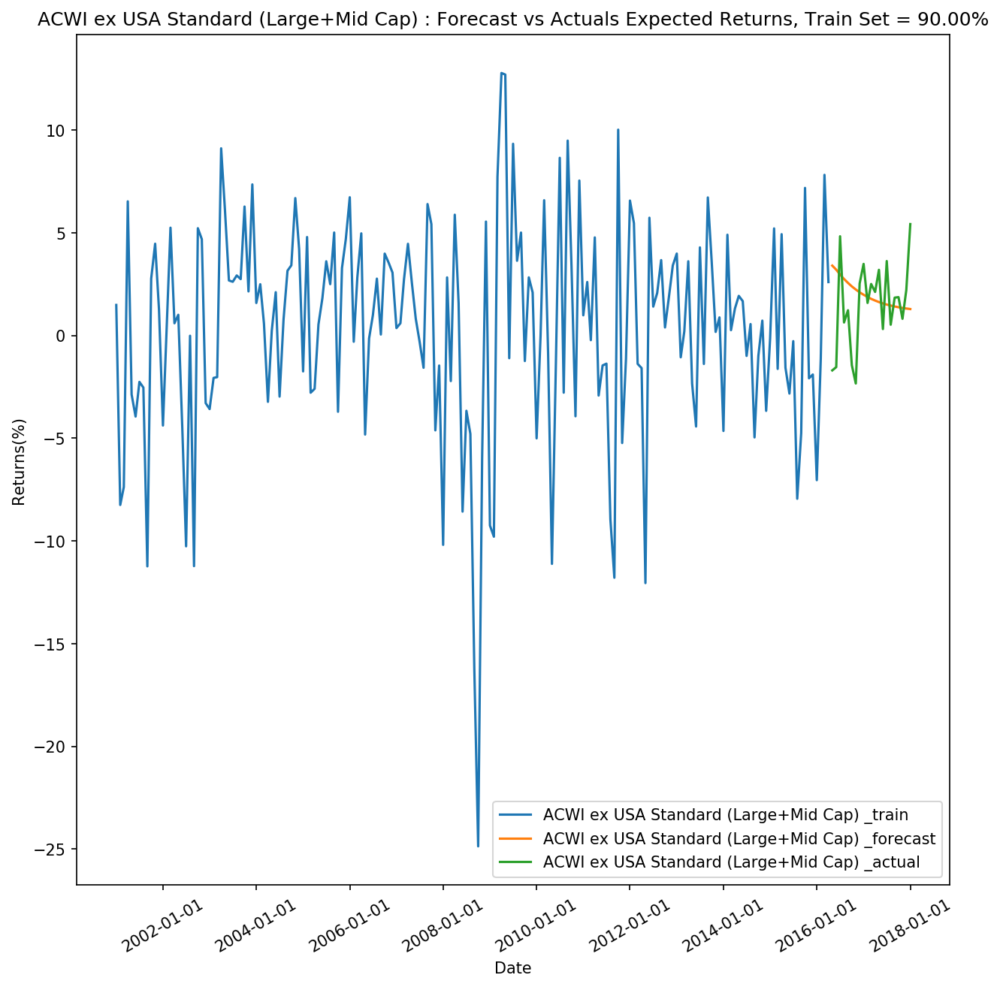

Forecast Accuracy of: ACWI_exUSA
mape   :  1.2379
me     :  0.4821
mae    :  1.8706
mpe    :  -0.1803
rmse   :  2.4404
corr   :  -0.4378


In [65]:
# Train Size = 90%
[model6_fitted_ACWI_exUSA,df6_ACWI_exUSA,df6_train_ACWI_exUSA,df6_test_ACWI_exUSA,date6] = VAR_Model(merge6_tested_ACWI_exUSA,2,4,0.1)
[df6_forecast_ACWI_exUSA,lag_order6_ACWI_exUSA] = forecast_plot(model6_fitted_ACWI_exUSA,df6_ACWI_exUSA,df6_train_ACWI_exUSA,df6_test_ACWI_exUSA,date6,90)

print('Forecast Accuracy of: ACWI_exUSA')
accuracy_prod = forecast_accuracy(df6_forecast_ACWI_exUSA.iloc[:,0].values, df6_test_ACWI_exUSA.iloc[:,0])

for k, v in accuracy_prod.items():
    print(adjust(k), ': ', round(v,4))

  Summary of Regression Results   
Model:                         VAR
Method:                        OLS
Date:           Wed, 28, Aug, 2019
Time:                     11:21:12
--------------------------------------------------------------------
No. of Equations:         9.00000    BIC:                   -21.8006
Nobs:                     163.000    HQIC:                  -22.8153
Log likelihood:          -75.6132    FPE:                6.17800e-11
AIC:                     -23.5088    Det(Omega_mle):     3.61511e-11
--------------------------------------------------------------------
Results for equation ACWI ex USA Standard (Large+Mid Cap) 
                                                                          coefficient       std. error           t-stat            prob
---------------------------------------------------------------------------------------------------------------------------------------
const                                                                       65.6

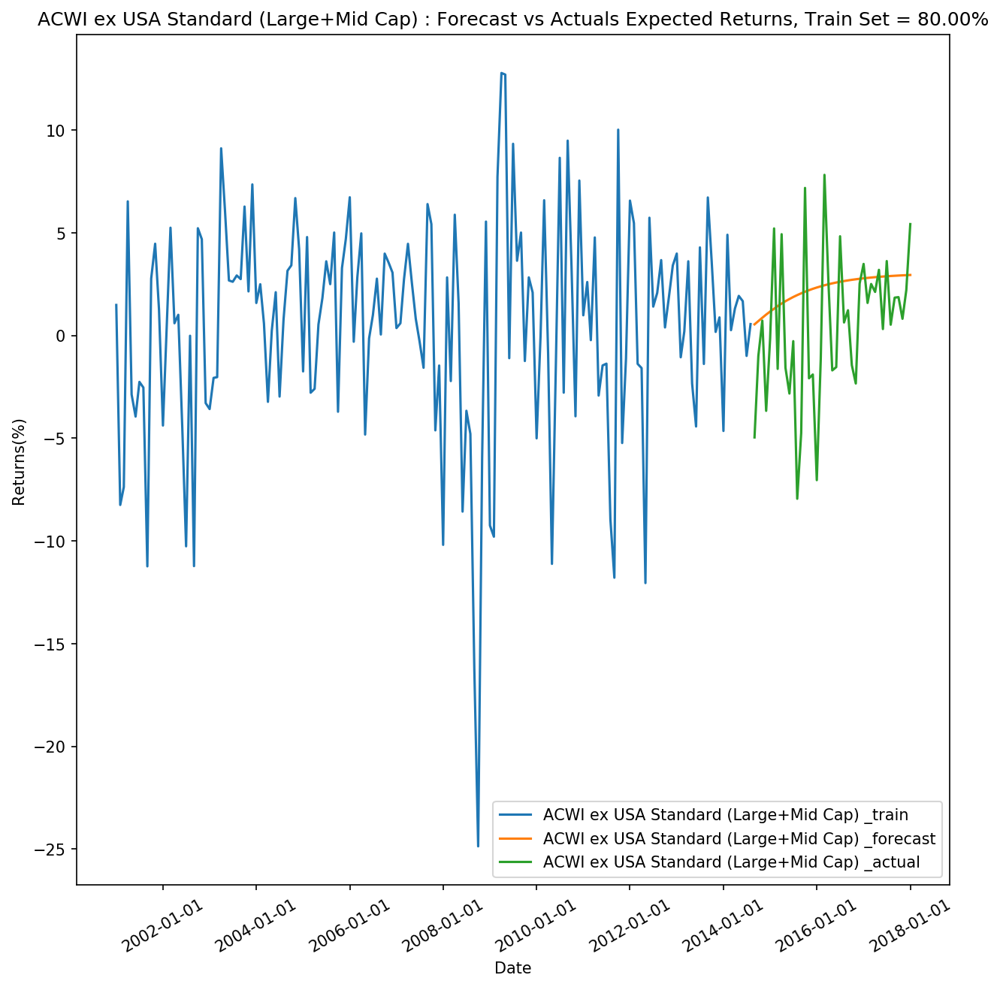

Forecast Accuracy of: ACWI_exUSA
mape   :  1.8251
me     :  1.7951
mae    :  2.9801
mpe    :  -0.7134
rmse   :  3.7683
corr   :  0.3266


In [66]:
# Train Size = 80%
[model6_fitted_ACWI_exUSA,df6_ACWI_exUSA,df6_train_ACWI_exUSA,df6_test_ACWI_exUSA,date6] = VAR_Model(merge6_tested_ACWI_exUSA,2,4,0.2)
[df6_forecast_ACWI_exUSA,lag_order6_ACWI_exUSA] = forecast_plot(model6_fitted_ACWI_exUSA,df6_ACWI_exUSA,df6_train_ACWI_exUSA,df6_test_ACWI_exUSA,date6,80)

print('Forecast Accuracy of: ACWI_exUSA')
accuracy_prod = forecast_accuracy(df6_forecast_ACWI_exUSA.iloc[:,0].values, df6_test_ACWI_exUSA.iloc[:,0])

for k, v in accuracy_prod.items():
    print(adjust(k), ': ', round(v,4))

  Summary of Regression Results   
Model:                         VAR
Method:                        OLS
Date:           Wed, 28, Aug, 2019
Time:                     15:29:48
--------------------------------------------------------------------
No. of Equations:         9.00000    BIC:                   -22.2926
Nobs:                     142.000    HQIC:                  -23.4047
Log likelihood:          -7.61996    FPE:                3.20455e-11
AIC:                     -24.1660    Det(Omega_mle):     1.73688e-11
--------------------------------------------------------------------
Results for equation ACWI ex USA Standard (Large+Mid Cap) 
                                                                          coefficient       std. error           t-stat            prob
---------------------------------------------------------------------------------------------------------------------------------------
const                                                                       59.6

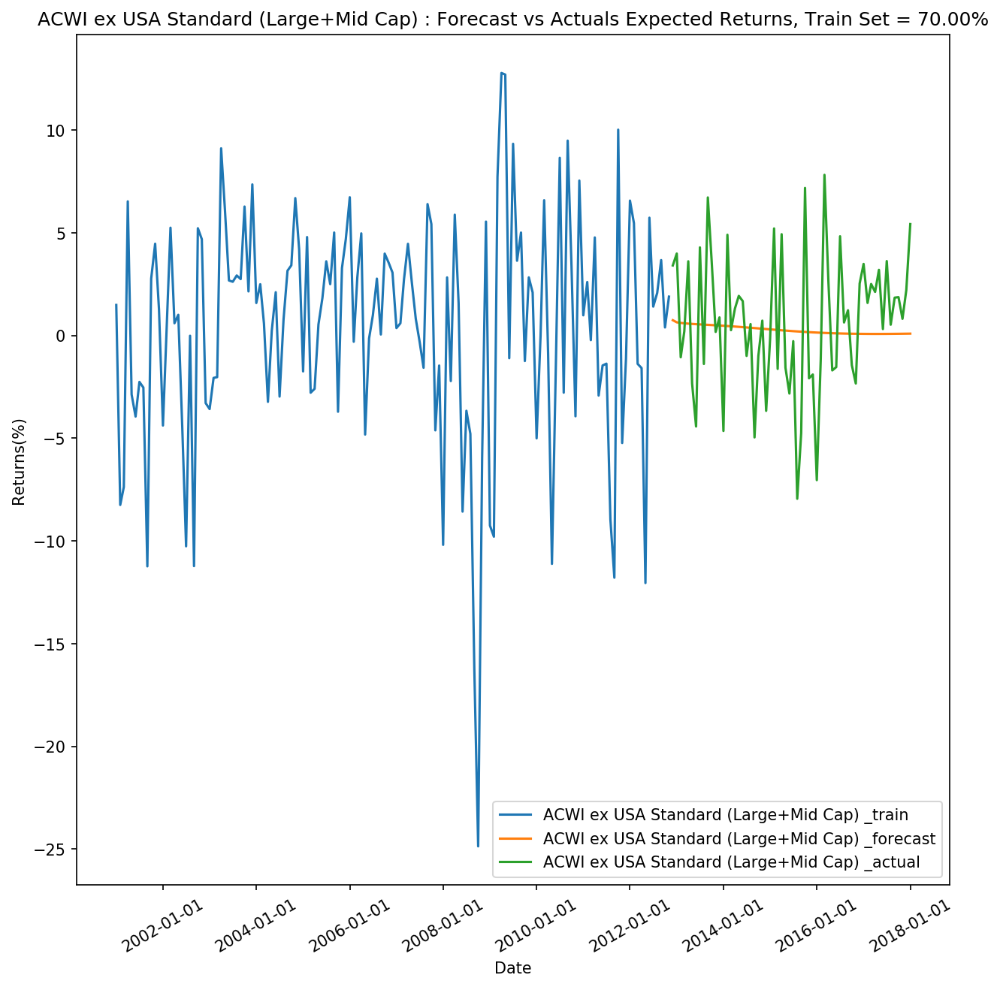

Forecast Accuracy of: ACWI_exUSA
mape   :  1.0468
me     :  -0.4007
mae    :  2.6733
mpe    :  -0.8991
rmse   :  3.3347
corr   :  -0.0049


In [136]:
# Train Size = 70%
[model6_fitted_ACWI_exUSA,df6_ACWI_exUSA,df6_train_ACWI_exUSA,df6_test_ACWI_exUSA,date6] = VAR_Model(merge6_tested_ACWI_exUSA,2,4,0.3)
[df6_forecast_ACWI_exUSA,lag_order6_ACWI_exUSA] = forecast_plot(model6_fitted_ACWI_exUSA,df6_ACWI_exUSA,df6_train_ACWI_exUSA,df6_test_ACWI_exUSA,date6,70)

print('Forecast Accuracy of: ACWI_exUSA')
accuracy_prod = forecast_accuracy(df6_forecast_ACWI_exUSA.iloc[:,0].values, df6_test_ACWI_exUSA.iloc[:,0])

for k, v in accuracy_prod.items():
    print(adjust(k), ': ', round(v,4))